In [1]:
import numpy as np
import pandas as pd
pd.get_option("display.max_columns")
pd.set_option('display.max_columns', 1000)
pd.get_option("display.max_rows")
pd.set_option('display.max_rows', 1000)

f=open('aaindex1.dat', 'r')

fragI=0
raw=''
ID=''
ID_array=[]
AAall=[[]]

while True:
    data = f.readline()
    data = data.rstrip()
    if data == '':
        break    
    elif data.startswith('I'):
        fragI = 1
    elif data.startswith('H'):
        ID=data[2:]
    elif fragI==1 and not data.startswith('//'):
        raw+=data
    elif data.startswith('//'):
        if not 'NA' in raw:
            para = raw.split()
            AAall.append(para)
            ID_array.append(ID)
            raw=''
            fragI=0
        else:
            raw=''
            fragI=0
            
AAall.remove([])

columns=['A','R','N','D','C','Q','E','G','H','I','L','K','M','F','P','S','T','W','Y','V']

df_index=pd.DataFrame(AAall,index=ID_array,columns=columns)

df_index


,A,R,N,D,C,Q,E,G,H,I,L,K,M,F,P,S,T,W,Y,V
ORIGINAL001,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00
ANDN920101,4.35,4.38,4.75,4.76,4.65,4.37,4.29,3.97,4.63,3.95,4.17,4.36,4.52,4.66,4.44,4.50,4.35,4.70,4.60,3.95
ARGP820101,0.61,0.60,0.06,0.46,1.07,0.,0.47,0.07,0.61,2.22,1.53,1.15,1.18,2.02,1.95,0.05,0.05,2.65,1.88,1.32
ARGP820102,1.18,0.20,0.23,0.05,1.89,0.72,0.11,0.49,0.31,1.45,3.23,0.06,2.67,1.96,0.76,0.97,0.84,0.77,0.39,1.08
ARGP820103,1.56,0.45,0.27,0.14,1.23,0.51,0.23,0.62,0.29,1.67,2.93,0.15,2.96,2.03,0.76,0.81,0.91,1.08,0.68,1.14
BEGF750101,1.,0.52,0.35,0.44,0.06,0.44,0.73,0.35,0.60,0.73,1.,0.60,1.,0.60,0.06,0.35,0.44,0.73,0.44,0.82
BEGF750102,0.77,0.72,0.55,0.65,0.65,0.72,0.55,0.65,0.83,0.98,0.83,0.55,0.98,0.98,0.55,0.55,0.83,0.77,0.83,0.98
BEGF750103,0.37,0.84,0.97,0.97,0.84,0.64,0.53,0.97,0.75,0.37,0.53,0.75,0.64,0.53,0.97,0.84,0.75,0.97,0.84,0.37
BHAR880101,0.357,0.529,0.463,0.511,0.346,0.493,0.497,0.544,0.323,0.462,0.365,0.466,0.295,0.314,0.509,0.507,0.444,0.305,0.420,0.386
BIGC670101,52.6,109.1,75.7,68.4,68.3,89.7,84.7,36.3,91.9,102.0,102.0,105.1,97.7,113.9,73.6,54.9,71.2,135.4,116.2,85.1


In [2]:
pm=open('ppm_98_TMRstart.fas','r')

fas = [[]]

while True:
    reading = pm.readline()
    reading = reading.rstrip()

    if not reading.startswith('>'):
        if reading == '':
            break
        fas.append(list(reading))

fas.remove([])
columns=list(range(-25,26))
df_pm=pd.DataFrame(fas,columns=columns)

df_pm

,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,P,L,E,H,R,P,R,Q,Q,P,G,A,S,V,L,V,R,Y,F,M,I,P,C,N,I,C,L,I,L,L,A,T,S,T,L,G,F,A,V,L,L,F,L,S,N,Y,K,P,G,I,H
1,P,L,E,H,R,P,R,Q,E,P,G,A,S,M,L,V,R,Y,F,M,I,P,C,N,I,C,L,I,L,L,A,T,S,T,L,G,F,A,V,L,L,F,L,S,N,Y,K,P,G,I,H
2,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,P,V,G,I,L,A,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,S,Q,E,K
3,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,S,L,G,I,L,G,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,S,Q,E,K
4,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,T,L,G,I,L,G,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,A,Q,E,K
5,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,A,L,G,I,L,G,I,L,L,G,V,A,A,V,A,T,I,I,A,L,S,V,V,Y,A,Q,E
6,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,T,L,G,I,L,G,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,A,Q,E,K
7,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,N,Q,K,T,I,L,V,L,L,I,L,A,V,I,T,I,F,A,L,V,C,V,L,L,V,G,R,G,G,D,G
8,X,X,X,I,E,T,Y,N,Q,T,S,P,R,S,A,A,T,G,L,P,I,S,M,K,I,F,M,Y,L,L,T,V,F,L,I,T,Q,M,I,G,S,A,L,F,A,V,Y,L,H,R,R
9,T,F,A,F,S,P,E,E,Q,Q,A,Q,R,E,S,Q,K,Q,K,R,H,K,N,T,F,I,C,F,A,I,T,S,F,S,F,F,I,A,L,A,I,I,L,G,I,S,S,K,Y,A,P


In [3]:
ALLave=[[]]


k=0
while k<len(df_index.index):
    l=0
    value=[]
    NAcount=0

    while l<len(df_index.columns):
        if df_index.iat[k,l]=="NA":
            NAcount=1
            value.append('NA')
        else:
            value.append(float(df_index.iat[k,l]))
        l=l+1

    if NAcount==0:
        j=0
        AAnum=[[]]
        while j<len(df_pm.index):
            i=0
            AA=[]
            while i<=50:
                AA.append(df_pm.iat[j,i])
                if AA[i]=="A":
                    AA[i]=value[0]
                elif AA[i]=="R":
                    AA[i]=value[1]
                elif AA[i]=="N":
                    AA[i]=value[2]
                elif AA[i]=="D":
                    AA[i]=value[3]
                elif AA[i]=="C":
                    AA[i]=value[4]
                elif AA[i]=="Q":
                    AA[i]=value[5]
                elif AA[i]=="E":
                    AA[i]=value[6]
                elif AA[i]=="G":
                    AA[i]=value[7]
                elif AA[i]=="H":
                    AA[i]=value[8]
                elif AA[i]=="I":
                    AA[i]=value[9]
                elif AA[i]=="L":
                    AA[i]=value[10]
                elif AA[i]=="K":
                    AA[i]=value[11]
                elif AA[i]=="M":
                    AA[i]=value[12]
                elif AA[i]=="F":
                    AA[i]=value[13]
                elif AA[i]=="P":
                    AA[i]=value[14]
                elif AA[i]=="S":
                    AA[i]=value[15]
                elif AA[i]=="T":
                    AA[i]=value[16]
                elif AA[i]=="W":
                    AA[i]=value[17]
                elif AA[i]=="Y":
                    AA[i]=value[18]
                elif AA[i]=="V":
                    AA[i]=value[19]
                elif AA[i]=="X":
                    AA[i]=np.nan
                i=i+1
            AAnum.append(AA)
            j=j+1
    df_AAnum=pd.DataFrame(AAnum)
    print (df_AAnum)
    ave=df_AAnum.mean()
    ALLave.append(ave)
    k=k+1


     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0   
2   0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
10  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
11  0.0  0.0  0.0  1.0  0.0 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.95  1.53  0.47  0.61  0.60  1.95  0.60  0.00  0.00  1.95  0.07  0.61   
2   1.95  1.53  0.47  0.61  0.60  1.95  0.60  0.00  0.47  1.95  0.07  0.61   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.22  0.47  0.05  1.88  0.06  0.00  0.05  0.05  1.95   
10  0.05  2.02  0.61  2.02  0.05  1.95  0.47  0.47  0.00  0.00  0.61  0.00   
11  1.18  0.47  1.15  2.22  1.95  0.47  2.22  0.07  1.15  2.02  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.76  2.93  0.23  0.29  0.45  0.76  0.45  0.51  0.51  0.76  0.62  1.56   
2   0.76  2.93  0.23  0.29  0.45  0.76  0.45  0.51  0.23  0.76  0.62  1.56   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.67  0.23  0.91  0.68  0.27  0.51  0.91  0.81  0.76   
10  0.91  2.03  1.56  2.03  0.81  0.76  0.23  0.23  0.51  0.51  1.56  0.51   
11  2.96  0.23  0.15  1.67  0.76  0.23  1.67  0.62  0.15  2.03  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.55  0.83  0.55  0.83  0.72  0.55  0.72  0.72  0.72  0.55  0.65  0.77   
2   0.55  0.83  0.55  0.83  0.72  0.55  0.72  0.72  0.55  0.55  0.65  0.77   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.98  0.55  0.83  0.83  0.55  0.72  0.83  0.55  0.55   
10  0.83  0.98  0.77  0.98  0.55  0.55  0.55  0.55  0.72  0.72  0.77  0.72   
11  0.98  0.55  0.55  0.98  0.55  0.55  0.98  0.65  0.55  0.98  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.509  0.365  0.497  0.323  0.529  0.509  0.529  0.493  0.493  0.509   
2   0.509  0.365  0.497  0.323  0.529  0.509  0.529  0.493  0.497  0.509   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.462  0.497  0.444  0.420  0.463  0.493  0.444   
10  0.444  0.314  0.357  0.314  0.507  0.509  0.497  0.497  0.493  0.493   
11  0.295  0.497  0.466  0.462  0.509  0.497  0.462  0.544  0.466  0.314   
12  0.509  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -20.0  145.0 -106.0   50.0  -70.0  -20.0  -70.0  -73.0  -73.0  -20.0   
2   -20.0  145.0 -106.0   50.0  -70.0  -20.0  -70.0  -73.0 -106.0  -20.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  151.0 -106.0  -38.0   53.0  -74.0  -73.0  -38.0   
10  -38.0  189.0   16.0  189.0  -70.0  -20.0 -106.0 -106.0  -73.0  -73.0   
11  124.0 -106.0 -141.0  151.0  -20.0 -106.0  151.0  -13.0 -141.0  189.0   
12  -20.0 -1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    5.1  20.0  -7.1  -2.1  -3.6   5.1  -3.6  -0.3  -0.3   5.1  -1.2   7.3   
2    5.1  20.0  -7.1  -2.1  -3.6   5.1  -3.6  -0.3  -7.1   5.1  -1.2   7.3   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN   6.6  -7.1   0.8   5.9  -5.7  -0.3   0.8  -4.1   5.1   
10   0.8  19.2   7.3  19.2  -4.1   5.1  -7.1  -7.1  -0.3  -0.3   7.3  -0.3   
11   5.6  -7.1  -3.7   6.6   5.1  -7.1   6.6  -1.2  -3.7  19.2  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.98 -2.46 -0.30 -0.12 -0.12 -0.98 -0.12  0.16  0.16 -0.98  0.00 -0.20   
2  -0.98 -2.46 -0.30 -0.12 -0.12 -0.98 -0.12  0.16 -0.30 -0.98  0.00 -0.20   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -2.26 -0.30 -0.52 -2.24  0.08  0.16 -0.52 -0.39 -0.98   
10 -0.52 -2.33 -0.20 -2.33 -0.39 -0.98 -0.30 -0.30  0.16  0.16 -0.20  0.16   
11 -1.47 -0.30 -0.35 -2.26 -0.98 -0.30 -2.26  0.00 -0.35 -2.33  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.000  8.423  8.368  8.415  8.274  0.000  8.274  8.411  8.411  0.000   
2   0.000  8.423  8.368  8.415  8.274  0.000  8.274  8.411  8.368  0.000   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  8.195  8.368  8.236  8.183  8.747  8.411  8.236   
10  8.236  8.228  8.249  8.228  8.380  0.000  8.368  8.368  8.411  8.411   
11  8.418  8.368  8.408  8.195  0.000  8.368  8.195  8.391  8.408  8.228   
12  0.000  8

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  6.5  7.0  8.0  6.9  0.0  6.9  6.0  6.0  0.0  5.6  6.5  6.5  7.0  6.5   
2   0.0  6.5  7.0  8.0  6.9  0.0  6.9  6.0  7.0  0.0  5.6  6.5  6.5  0.0  6.5   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  7.0  7.0  6.9  6.8  7.5  6.0  6.9  6.5  0.0  6.9  6.5  6.5   
10  6.9  9.4  6.5  9.4  6.5  0.0  7.0  7.0  6.0  6.0  6.5  6.0  6.9  7.0  6.5   
11  0.0  7.0  6.5  7.0  0.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.340  0.400  0.262  0.200  0.362  0.340  0.362  0.327  0.327  0.340   
2   0.340  0.400  0.262  0.200  0.362  0.340  0.362  0.327  0.262  0.340   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.411  0.262  0.388  0.429  0.229  0.327  0.388   
10  0.388  0.318  0.288  0.318  0.354  0.340  0.262  0.262  0.327  0.327   
11  0.375  0.262  0.265  0.411  0.340  0.262  0.411  0.312  0.265  0.318   
12  0.340  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.131  0.186  0.151  0.230  0.291  0.131  0.291  0.180  0.180  0.131   
2   0.131  0.186  0.151  0.230  0.291  0.131  0.291  0.180  0.151  0.131   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.186  0.151  0.108  0.298  0.134  0.180  0.108   
10  0.108  0.290  0.046  0.290  0.062  0.131  0.151  0.151  0.180  0.180   
11  0.221  0.151  0.219  0.186  0.131  0.151  0.186  0.000  0.219  0.290   
12  0.131  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.61  0.69  0.84  1.07  1.06  1.61  1.06  0.87  0.87  1.61  1.52  0.71   
2   1.61  0.69  0.84  1.07  1.06  1.61  1.06  0.87  0.84  1.61  1.52  0.71   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.66  0.84  1.08  1.07  1.37  0.87  1.08  1.34  1.61   
10  1.08  0.71  0.71  0.71  1.34  1.61  0.84  0.84  0.87  0.87  0.71  0.87   
11  0.59  0.84  0.99  0.66  1.61  0.84  0.66  1.52  0.99  0.71  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  1.0  1.0  1.0  1.0  0.0  1.0  1.0  1.0  0.0  0.0  0.0  1.0  2.0  1.0   
2   0.0  1.0  1.0  1.0  1.0  0.0  1.0  1.0  1.0  0.0  0.0  0.0  1.0  1.0  1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  2.0  1.0  2.0  1.0  1.0  1.0  2.0  1.0  0.0  1.0  1.0  0.0   
10  2.0  1.0  0.0  1.0  1.0  0.0  1.0  1.0  1.0  1.0  0.0  1.0  1.0  1.0  1.0   
11  1.0  1.0  1.0  2.0  0.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.0  1.0  1.0  1.0  0.0  1.0  1.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0   
2   0.0  0.0  1.0  1.0  1.0  0.0  1.0  1.0  1.0  0.0  0.0  0.0  0.0  1.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.0  1.0  0.0  1.0  0.0  1.0  0.0  0.0  0.0  1.0  0.0  0.0   
10  0.0  1.0  0.0  1.0  0.0  0.0  1.0  1.0  1.0  1.0  0.0  1.0  1.0  1.0  0.0   
11  1.0  1.0  1.0  0.0  0.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  0.0  0.0  0.0   
2   0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  1.0  0.0  0.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.0  1.0  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
10  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0   
11  0.0  1.0  0.0  0.0  0.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   129.3  167.9  155.1  167.3  202.0  129.3  202.0  161.1  161.1  129.3   
2   129.3  167.9  155.1  167.3  202.0  129.3  202.0  161.1  155.1  129.3   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  168.8  155.1  122.1  203.6  135.2  161.1  122.1   
10  122.1  203.4   91.5  203.4   99.1  129.3  155.1  155.1  161.1  161.1   
11  170.8  155.1  171.3  168.8  129.3  155.1  168.8   66.4  171.3  203.4   
12  129.3  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   50.0  23.0  49.0  43.0  90.0  50.0  90.0  71.0  71.0  50.0  23.0  25.0   
2   50.0  23.0  49.0  43.0  90.0  50.0  90.0  71.0  49.0  50.0  23.0  25.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  18.0  49.0  47.0  60.0  63.0  71.0  47.0  44.0  50.0   
10  47.0  24.0  25.0  24.0  44.0  50.0  49.0  49.0  71.0  71.0  25.0  71.0   
11  31.0  49.0  97.0  18.0  50.0  49.0  18.0  23.0  97.0  24.0  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.04  0.16  0.03  0.02  0.00  0.04  0.00  0.01  0.01  0.04  0.18  0.20   
2   0.04  0.16  0.03  0.02  0.00  0.04  0.00  0.01  0.03  0.04  0.18  0.20   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.19  0.03  0.08  0.03  0.03  0.01  0.08  0.08  0.04   
10  0.08  0.14  0.20  0.14  0.08  0.04  0.03  0.03  0.01  0.01  0.20  0.01   
11  0.11  0.03  0.00  0.19  0.04  0.03  0.19  0.18  0.00  0.14  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.57  1.21  1.51  1.00  0.98  0.57  0.98  1.11  1.11  0.57  0.57  1.42   
2   0.57  1.21  1.51  1.00  0.98  0.57  0.98  1.11  1.51  0.57  0.57  1.42   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.08  1.51  0.83  0.69  0.67  1.11  0.83  0.77  0.57   
10  0.83  1.13  1.42  1.13  0.77  0.57  1.51  1.51  1.11  1.11  1.42  1.11   
11  1.45  1.51  1.16  1.08  0.57  1.51  1.08  0.57  1.16  1.13  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.56  0.50  0.95  0.95  1.01  1.56  1.01  0.96  0.96  1.56  1.56  0.74   
2   1.56  0.50  0.95  0.95  1.01  1.56  1.01  0.96  0.95  1.56  1.56  0.74   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.47  0.95  0.98  1.14  1.46  0.96  0.98  1.43  1.56   
10  0.98  0.66  0.74  0.66  1.43  1.56  0.95  0.95  0.96  0.96  0.74  0.96   
11  0.60  0.95  1.19  0.47  1.56  0.95  0.47  1.56  1.19  0.66  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  1.13  1.24  1.77  1.25  0.00  1.25  1.22  1.22  0.00  0.42  1.20   
2   0.00  1.13  1.24  1.77  1.25  0.00  1.25  1.22  1.24  0.00  0.42  1.20   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.98  1.24  0.75  0.73  0.59  1.22  0.75  0.96  0.00   
10  0.75  1.10  1.20  1.10  0.96  0.00  1.24  1.24  1.22  1.22  1.20  1.22   
11  1.57  1.24  1.83  0.98  0.00  1.24  0.98  0.42  1.83  1.10  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.58  0.84  0.59  1.86  1.24  1.58  1.24  0.70  0.70  1.58  1.64  0.52   
2   1.58  0.84  0.59  1.86  1.24  1.58  1.24  0.70  0.59  1.58  1.64  0.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.87  0.59  0.86  0.96  1.64  0.70  0.86  0.93  1.58   
10  0.86  1.04  0.52  1.04  0.93  1.58  0.59  0.59  0.70  0.70  0.52  0.70   
11  0.52  0.59  1.49  0.87  1.58  0.59  0.87  1.64  1.49  1.04  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.40  1.27  0.55  0.90  0.90  0.40  0.90  0.65  0.65  0.40  0.74  0.75   
2   0.40  1.27  0.55  0.90  0.90  0.40  0.90  0.65  0.55  0.40  0.74  0.75   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.35  0.55  0.75  1.96  1.21  0.65  0.75  0.79  0.40   
10  0.75  1.50  0.75  1.50  0.79  0.40  0.55  0.55  0.65  0.65  0.75  0.65   
11  0.95  0.55  0.74  1.35  0.40  0.55  1.35  0.74  0.74  1.50  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.69  0.59  0.85  0.96  1.05  1.69  1.05  0.77  0.77  1.69  1.68  0.74   
2   1.69  0.59  0.85  0.96  1.05  1.69  1.05  0.77  0.85  1.69  1.68  0.74   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.53  0.85  1.16  1.01  1.13  0.77  1.16  1.49  1.69   
10  1.16  0.44  0.74  0.44  1.49  1.69  0.85  0.85  0.77  0.77  0.74  0.77   
11  0.85  0.85  0.82  0.53  1.69  0.85  0.53  1.68  0.82  0.44  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.301  0.025  0.060  0.047  0.106  0.301  0.106  0.098  0.098  0.301   
2   0.301  0.025  0.060  0.047  0.106  0.301  0.106  0.098  0.060  0.301   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.034  0.060  0.108  0.065  0.083  0.098  0.108   
10  0.108  0.041  0.076  0.041  0.139  0.301  0.060  0.060  0.098  0.098   
11  0.082  0.060  0.115  0.034  0.301  0.060  0.034  0.085  0.115  0.041   
12  0.301  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.068  0.070  0.064  0.054  0.085  0.068  0.085  0.098  0.098  0.068   
2   0.068  0.070  0.064  0.054  0.085  0.068  0.085  0.098  0.064  0.068   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.056  0.064  0.079  0.125  0.091  0.098  0.079   
10  0.079  0.065  0.058  0.065  0.106  0.068  0.064  0.064  0.098  0.098   
11  0.055  0.064  0.095  0.056  0.068  0.064  0.056  0.152  0.095  0.065   
12  0.068  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.12  1.29 -0.80  1.07 -0.24 -0.12 -0.24 -0.99 -0.99 -0.12 -1.00 -0.45   
2  -0.12  1.29 -0.80  1.07 -0.24 -0.12 -0.24 -0.99 -0.80 -0.12 -1.00 -0.45   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.76 -0.80 -0.70  1.49 -0.20 -0.99 -0.70 -0.98 -0.12   
10 -0.70  1.48 -0.45  1.48 -0.98 -0.12 -0.80 -0.80 -0.99 -0.99 -0.45 -0.99   
11  1.37 -0.80 -0.36  0.76 -0.12 -0.80  0.76 -1.00 -0.36  1.48 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.06  1.18 -0.83  0.16 -0.52 -0.06 -0.52 -1.05 -1.05 -0.06 -0.82  0.36   
2  -0.06  1.18 -0.83  0.16 -0.52 -0.06 -0.52 -1.05 -0.83 -0.06 -0.82  0.36   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.17 -0.83 -1.20  1.05 -0.90 -1.05 -1.20 -0.60 -0.06   
10 -1.20  1.01  0.36  1.01 -0.60 -0.06 -0.83 -0.83 -1.05 -1.05  0.36 -1.05   
11  1.21 -0.83 -0.56  2.17 -0.06 -0.83  2.17 -0.82 -0.56  1.01 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.09  1.14 -1.14  0.26 -0.42 -0.09 -0.42 -1.10 -1.10 -0.09 -0.80  0.02   
2  -0.09  1.14 -1.14  0.26 -0.42 -0.09 -0.42 -1.10 -1.14 -0.09 -0.80  0.02   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.81 -1.14 -0.77  1.11 -0.77 -1.10 -0.77 -0.97 -0.09   
10 -0.77  1.35  0.02  1.35 -0.97 -0.09 -1.14 -1.14 -1.10 -1.10  0.02 -1.10   
11  1.00 -1.14 -0.41  1.81 -0.09 -1.14  1.81 -0.80 -0.41  1.35 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.49  1.29  1.66  1.49  0.79  0.49  0.79  1.42  1.42  0.49  0.58  1.33   
2   0.49  1.29  1.66  1.49  0.79  0.49  0.79  1.42  1.66  0.49  0.58  1.33   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.99  1.66  0.94  0.49  0.72  1.42  0.94  0.83  0.49   
10  0.94  1.15  1.33  1.15  0.83  0.49  1.66  1.66  1.42  1.42  1.33  1.42   
11  1.40  1.66  1.03  0.99  0.49  1.66  0.99  0.58  1.03  1.15  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.47  0.70  0.64  0.95  0.79  1.47  0.79  0.92  0.92  1.47  1.38  0.60   
2   1.47  0.70  0.64  0.95  0.79  1.47  0.79  0.92  0.64  1.47  1.38  0.60   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.67  0.64  1.05  1.35  1.42  0.92  1.05  1.26  1.47   
10  1.05  1.05  0.60  1.05  1.26  1.47  0.64  0.64  0.92  0.92  0.60  0.92   
11  0.67  0.64  1.10  0.67  1.47  0.64  0.67  1.38  1.10  1.05  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   5.2  7.4  6.0  2.0  4.9  5.2  4.9  3.9  3.9  5.2  8.4  8.6  7.0  6.6  7.4   
2   5.2  7.4  6.0  2.0  4.9  5.2  4.9  3.9  6.0  5.2  8.4  8.6  7.0  1.7  7.4   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  4.5  6.0  6.1  3.4  4.3  3.9  6.1  7.0  5.2  4.9  7.0  8.6   
10  6.1  3.6  8.6  3.6  7.0  5.2  6.0  6.0  3.9  3.9  8.6  3.9  4.9  6.0  7.0   
11  1.7  6.0  6.6  4.5  5.2 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.27  1.38  0.19  1.00  0.59  0.27  0.59  0.39  0.39  0.27  1.03  1.56   
2   0.27  1.38  0.19  1.00  0.59  0.27  0.59  0.39  0.19  0.27  1.03  1.56   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.27  0.19  1.11  1.10  0.51  0.39  1.11  0.96  0.27   
10  1.11  1.42  1.56  1.42  0.96  0.27  0.19  0.19  0.39  0.39  1.56  0.39   
11  1.93  0.19  0.15  1.27  0.27  0.19  1.27  1.03  0.15  1.42  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.07  0.53 -0.62 -0.40 -1.76 -0.07 -1.76 -0.69 -0.69 -0.07  0.16  0.25   
2  -0.07  0.53 -0.62 -0.40 -1.76 -0.07 -1.76 -0.69 -0.62 -0.07  0.16  0.25   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.73 -0.62 -0.18  0.02 -0.64 -0.69 -0.18 -0.26 -0.07   
10 -0.18  0.61  0.25  0.61 -0.26 -0.07 -0.62 -0.62 -0.69 -0.69  0.25 -0.69   
11  0.26 -0.62 -1.10  0.73 -0.07 -0.62  0.73  0.16 -1.10  0.61  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    0.18   1.00   3.00   0.99  10.00   0.18  10.00   1.90   1.90   0.18   
2    0.18   1.00   3.00   0.99  10.00   0.18  10.00   1.90   3.00   0.18   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   1.20   3.00   1.50   1.80   1.30   1.90   1.50   
10   1.50   1.10   0.00   1.10   0.73   0.18   3.00   3.00   1.90   1.90   
11   1.90   3.00   5.70   1.20   0.18   3.00   1.20   0.00   5.70   1.10   
12   0.18   

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   115.13  131.17  147.13  155.16  174.20  115.13  174.20  146.15  146.15   
2   115.13  131.17  147.13  155.16  174.20  115.13  174.20  146.15  147.13   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9      NaN     NaN     NaN  131.17  147.13  119.12  181.19  132.12  146.15   
10  119.12  165.19   89.09  165.19  105.09  115.13  147.13  147.13  146.15   
11  149.21  147.13  146.19  131.17  115.13  147.13  131.17   75.

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -86.20 -11.00  12.00 -38.50  12.50 -86.20  12.50   6.30   6.30 -86.20   
2  -86.20 -11.00  12.00 -38.50  12.50 -86.20  12.50   6.30  12.00 -86.20   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  12.40  12.00 -28.00 -10.00  -5.60   6.30 -28.00   
10 -28.00 -34.50   1.80 -34.50  -7.50 -86.20  12.00  12.00   6.30   6.30   
11 -10.00  12.00  14.60  12.40 -86.20  12.00  12.40   0.00  14.60 -34.50   
12 -86.20  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.95  2.36  2.10  1.82  1.82  1.95  1.82  2.17  2.17  1.95  2.35  2.34   
2   1.95  2.36  2.10  1.82  1.82  1.95  1.82  2.17  2.10  1.95  2.35  2.34   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.36  2.10  2.09  2.20  2.02  2.17  2.09  2.19  1.95   
10  2.09  2.16  2.34  2.16  2.19  1.95  2.10  2.10  2.17  2.17  2.34  2.17   
11  2.28  2.10  2.16  2.36  1.95  2.10  2.36  2.35  2.16  2.16  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.67  2.59  1.56  2.99  2.34  2.67  2.34  1.56  1.56  2.67  0.00  1.28   
2   2.67  2.59  1.56  2.99  2.34  2.67  2.34  1.56  1.56  2.67  0.00  1.28   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.19  1.56  3.03  2.94  1.60  1.56  3.03  1.31  2.67   
10  3.03  2.94  1.28  2.94  1.31  2.67  1.56  1.56  1.56  1.56  1.28  1.56   
11  2.35  1.56  1.89  4.19  2.67  1.56  4.19  0.00  1.89  2.94  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.72  4.00  3.78  4.66  6.13  2.72  6.13  3.95  3.95  2.72  0.00  1.00   
2   2.72  4.00  3.78  4.66  6.13  2.72  6.13  3.95  3.78  2.72  0.00  1.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.00  3.78  2.60  6.47  2.95  3.95  2.60  1.60  2.72   
10  2.60  5.89  1.00  5.89  1.60  2.72  3.78  3.78  3.95  3.95  1.00  3.95   
11  4.43  3.78  4.77  4.00  2.72  3.78  4.00  0.00  4.77  5.89  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.00  1.52   
2   1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.00  1.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.90  1.52  1.73  1.52  1.52  1.52  1.73  1.52  1.52   
10  1.73  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52  1.52   
11  1.52  1.52  1.52  1.90  1.52  1.52  1.90  1.00  1.52  1.52  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   17.8  10.1  11.4  10.2  11.1  17.8  11.1  10.6  10.6  17.8   0.0   7.3   
2   17.8  10.1  11.4  10.2  11.1  17.8  11.1  10.6  11.4  17.8   0.0   7.3   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  16.1  11.4  16.7  13.9   8.0  10.6  16.7  13.1  17.8   
10  16.7  13.9   7.3  13.9  13.1  17.8  11.4  11.4  10.6  10.6   7.3  10.6   
11  10.4  11.4  10.9  16.1  17.8  11.4  16.1   0.0  10.9  13.9  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.0  1.0  1.0  4.0  0.0  4.0  2.0  2.0  0.0  0.0  0.0  1.0  0.0  0.0   
2   0.0  0.0  1.0  1.0  4.0  0.0  4.0  2.0  1.0  0.0  0.0  0.0  1.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.0  1.0  1.0  1.0  2.0  2.0  1.0  1.0  0.0  4.0  1.0  0.0   
10  1.0  0.0  0.0  0.0  1.0  0.0  1.0  1.0  2.0  2.0  0.0  2.0  4.0  1.0  1.0   
11  0.0  1.0  2.0  0.0  0.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.0  0.0  1.0  1.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2   0.0  0.0  0.0  1.0  1.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  0.0   
10  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  0.0   
11  0.0  0.0  1.0  0.0  0.0 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  4.79  5.48  2.84  4.30  0.00  4.30  4.54  4.54  0.00  3.77  4.76   
2   0.00  4.79  5.48  2.84  4.30  0.00  4.30  4.54  5.48  0.00  3.77  4.76   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.81  5.48  3.87  4.30  3.64  4.54  3.87  3.83  0.00   
10  3.87  4.31  4.76  4.31  3.83  0.00  5.48  5.48  4.54  4.54  4.76  4.54   
11  4.25  5.48  4.27  4.81  0.00  5.48  4.81  3.77  4.27  4.31  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.0  1.0  1.7  1.0  0.7  1.0  0.7  1.0  1.0  1.0  1.0  1.0  1.7  0.6  1.0   
2   1.0  1.0  1.7  1.0  0.7  1.0  0.7  1.0  1.7  1.0  1.0  1.0  1.7  1.0  1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.6  1.7  1.7  1.0  1.7  1.0  1.7  1.7  1.0  0.7  1.7  1.0   
10  1.7  1.0  1.0  1.0  1.7  1.0  1.7  1.7  1.0  1.0  1.0  1.0  0.7  1.7  1.7   
11  1.0  1.7  0.7  0.6  1.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.0  1.0  0.7  1.2  1.7  1.0  1.7  1.0  1.0  1.0  0.8  1.2  1.5  0.8  1.0   
2   1.0  1.0  0.7  1.2  1.7  1.0  1.7  1.0  0.7  1.0  0.8  1.2  1.5  1.0  1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.8  0.7  1.0  1.0  1.2  1.0  1.0  1.5  1.0  1.7  1.5  1.2   
10  1.0  1.0  1.2  1.0  1.5  1.0  0.7  0.7  1.0  1.0  1.2  1.0  1.7  0.7  1.5   
11  1.0  0.7  1.7  0.8  1.0 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.39  1.00  0.33  0.21  0.10  0.39  0.10  0.35  0.35  0.39  0.17  0.28   
2   0.39  1.00  0.33  0.21  0.10  0.39  0.10  0.35  0.33  0.39  0.17  0.28   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.82  0.33  0.21  1.26  0.25  0.35  0.21  0.12  0.39   
10  0.21  2.18  0.28  2.18  0.12  0.39  0.33  0.33  0.35  0.35  0.28  0.35   
11  0.74  0.33  0.09  0.82  0.39  0.33  0.82  0.17  0.09  2.18  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.82  1.13  1.20  1.09  1.09  0.82  1.09  0.93  0.93  0.82  0.83  1.13   
2   0.82  1.13  1.20  1.09  1.09  0.82  1.09  0.93  1.20  0.82  0.83  1.13   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.05  1.20  1.17  0.88  1.06  0.93  1.17  1.01  0.82   
10  1.17  1.01  1.13  1.01  1.01  0.82  1.20  1.20  0.93  0.93  1.13  0.93   
11  1.23  1.20  1.08  1.05  0.82  1.20  1.05  0.83  1.08  1.01  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.68  1.18  1.64  1.03  1.00  0.68  1.00  1.32  1.32  0.68  0.60  1.19   
2   0.68  1.18  1.64  1.03  1.00  0.68  1.00  1.32  1.64  0.68  0.60  1.19   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.12  1.64  0.85  0.77  0.94  1.32  0.85  0.81  0.68   
10  0.85  1.02  1.19  1.02  0.81  0.68  1.64  1.64  1.32  1.32  1.19  1.32   
11  1.49  1.64  1.27  1.12  0.68  1.64  1.12  0.60  1.27  1.02  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.61  1.28  0.37  1.07  1.15  0.61  1.15  1.11  1.11  0.61  0.86  0.86   
2   0.61  1.28  0.37  1.07  1.15  0.61  1.15  1.11  0.37  0.61  0.86  0.86   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.17  0.37  1.14  1.37  0.60  1.11  1.14  0.91  0.61   
10  1.14  1.34  0.86  1.34  0.91  0.61  0.37  0.37  1.11  1.11  0.86  1.11   
11  1.15  0.37  1.01  1.17  0.61  0.37  1.17  0.86  1.01  1.34  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.66  0.59  0.97  0.90  1.00  1.66  1.00  0.94  0.94  1.66  1.51  0.91   
2   1.66  0.59  0.97  0.90  1.00  1.66  1.00  0.94  0.97  1.66  1.51  0.91   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.65  0.97  1.04  0.92  1.64  0.94  1.04  1.23  1.66   
10  1.04  0.72  0.91  0.72  1.23  1.66  0.97  0.97  0.94  0.94  0.91  0.94   
11  0.58  0.97  0.82  0.65  1.66  0.97  0.65  1.51  0.82  0.72  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.77  0.52  1.40  0.85  0.93  1.77  0.93  0.81  0.81  1.77  1.30  1.10   
2   1.77  0.52  1.40  0.85  0.93  1.77  0.93  0.81  1.40  1.77  1.30  1.10   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.67  1.40  0.88  0.41  1.57  0.81  0.88  1.13  1.77   
10  0.88  0.60  1.10  0.60  1.13  1.77  1.40  1.40  0.81  0.81  1.10  0.81   
11  0.69  1.40  0.94  0.67  1.77  1.40  0.67  1.30  0.94  0.60  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.60  2.40  0.00  0.00  0.75  2.60  0.75  0.59  0.59  2.60  0.00  0.75   
2   2.60  2.40  0.00  0.00  0.75  2.60  0.75  0.59  0.00  2.60  0.00  0.75   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.95  0.00  0.45  2.85  0.69  0.59  0.45  0.00  2.60   
10  0.45  2.65  0.75  2.65  0.00  2.60  0.00  0.00  0.59  0.59  0.75  0.59   
11  1.30  0.00  1.50  2.95  2.60  0.00  2.95  0.00  1.50  2.65  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.39  0.00  0.92  0.58  0.65  0.39  0.65  0.89  0.89  0.39  0.74  0.00   
2   0.39  0.00  0.92  0.58  0.65  0.39  0.65  0.89  0.92  0.39  0.74  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.00  0.92  0.71  0.20  1.33  0.89  0.71  1.42  0.39   
10  0.71  0.00  0.00  0.00  1.42  0.39  0.92  0.92  0.89  0.89  0.00  0.89   
11  0.00  0.92  0.33  0.00  0.39  0.92  0.00  0.74  0.33  0.00  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.73 -1.18  0.83 -0.50  1.91  0.73  1.91  0.95  0.95  0.73  0.33  0.10   
2   0.73 -1.18  0.83 -0.50  1.91  0.73  1.91  0.95  0.83  0.73  0.33  0.10   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -1.13  0.83  0.07 -0.21  0.48  0.95  0.07  0.52  0.73   
10  0.07 -2.12  0.10 -2.12  0.52  0.73  0.83  0.83  0.95  0.95  0.10  0.95   
11 -1.59  0.83  1.40 -1.13  0.73  0.83 -1.13  0.33  1.40 -2.12  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0 -1.8  3.0 -0.5  3.0  0.0  3.0  0.2  0.2  0.0  0.0 -0.5  0.3 -1.5 -1.8   
2   0.0 -1.8  3.0 -0.5  3.0  0.0  3.0  0.2  3.0  0.0  0.0 -0.5  0.3 -1.3 -1.8   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN -1.8  3.0 -0.4 -2.3  0.2  0.2 -0.4  0.3  0.0  3.0  0.3 -0.5   
10 -0.4 -2.5 -0.5 -2.5  0.3  0.0  3.0  3.0  0.2  0.2 -0.5  0.2  3.0  3.0  0.3   
11 -1.3  3.0  3.0 -1.8  0.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   39.21  50.62  44.98  65.99  68.43  39.21  68.43  46.62  46.62  39.21   
2   39.21  50.62  44.98  65.99  68.43  39.21  68.43  46.62  44.98  39.21   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  49.71  44.98  36.50  51.15  41.70  46.62  36.50   
10  36.50  51.06  30.88  51.06  35.65  39.21  44.98  44.98  46.62  46.62   
11  55.32  44.98  63.21  49.71  39.21  44.98  49.71  24.74  63.21  51.06   
12  39.21  4

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.25  1.32  1.63  1.03  1.17  0.25  1.17  1.27  1.27  0.25  0.44  1.53   
2   0.25  1.32  1.63  1.03  1.17  0.25  1.17  1.27  1.63  0.25  0.44  1.53   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.07  1.63  0.86  0.70  0.60  1.27  0.86  0.65  0.25   
10  0.86  1.22  1.53  1.22  0.65  0.25  1.63  1.63  1.27  1.27  1.53  1.27   
11  1.66  1.63  1.26  1.07  0.25  1.63  1.07  0.44  1.26  1.22  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.55  0.57  0.97  0.83  1.06  1.55  1.06  0.78  0.78  1.55  1.73  0.78   
2   1.55  0.57  0.97  0.83  1.06  1.55  1.06  0.78  0.97  1.55  1.73  0.78   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.40  0.97  1.09  1.14  1.56  0.78  1.09  1.19  1.55   
10  1.09  0.67  0.78  0.67  1.19  1.55  0.97  0.97  0.78  0.78  0.78  0.78   
11  0.30  0.97  1.01  0.40  1.55  0.97  0.40  1.73  1.01  0.67  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.43  0.58  0.65  1.19  0.75  0.43  0.75  0.73  0.73  0.43  2.40  0.35   
2   0.43  0.58  0.65  1.19  0.75  0.43  0.75  0.73  0.65  0.43  2.40  0.35   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.12  0.65  0.85  1.44  2.12  0.73  0.85  1.24  0.43   
10  0.85  0.89  0.35  0.89  1.24  0.43  0.65  0.65  0.73  0.73  0.35  0.73   
11  0.22  0.65  0.83  0.12  0.43  0.65  0.12  2.40  0.83  0.89  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.37  1.05  2.54  0.00  2.78  0.37  2.78  0.79  0.79  0.37  0.95  1.34   
2   0.37  1.05  2.54  0.00  2.78  0.37  2.78  0.79  2.54  0.37  0.95  1.34   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.52  2.54  1.14  0.73  0.92  0.79  1.14  0.87  0.37   
10  1.14  0.43  1.34  0.43  0.87  0.37  2.54  2.54  0.79  0.79  1.34  0.79   
11  0.00  2.54  0.79  0.52  0.37  2.54  0.52  0.95  0.79  0.43  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    51.5   27.6   68.2   50.7   94.7   51.5   94.7   68.7   68.7   51.5   
2    51.5   27.6   68.2   50.7   94.7   51.5   94.7   68.7   68.2   51.5   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   22.8   68.2   45.0   55.2   60.1   68.7   45.0   
10   45.0   25.5   27.8   25.5   42.0   51.5   68.2   68.2   68.7   68.7   
11   33.5   68.2  103.0   22.8   51.5   68.2   22.8   24.5  103.0   25.5   
12   51.5   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   45.0  16.0  55.0  34.0  67.0  45.0  67.0  56.0  56.0  45.0  10.0  15.0   
2   45.0  16.0  55.0  34.0  67.0  45.0  67.0  56.0  55.0  45.0  10.0  15.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  13.0  55.0  32.0  41.0  49.0  56.0  32.0  32.0  45.0   
10  32.0  10.0  15.0  10.0  32.0  45.0  55.0  55.0  56.0  56.0  15.0  56.0   
11  20.0  55.0  85.0  13.0  45.0  55.0  13.0  10.0  85.0  10.0  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -0.3  0.5 -0.7 -0.1 -1.4 -0.3 -1.4 -0.7 -0.7 -0.3  0.3  0.3 -0.1  0.6  0.5   
2  -0.3  0.5 -0.7 -0.1 -1.4 -0.3 -1.4 -0.7 -0.7 -0.3  0.3  0.3 -0.1  0.4  0.5   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.7 -0.7 -0.2 -0.4 -0.5 -0.7 -0.2 -0.1 -0.3 -1.4 -0.1  0.3   
10 -0.2  0.5  0.3  0.5 -0.1 -0.3 -0.7 -0.7 -0.7 -0.7  0.3 -0.7 -1.4 -0.7 -0.1   
11  0.4 -0.7 -1.8  0.7 -0.3 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.99  2.36  2.19  1.82  1.18  1.99  1.18  2.17  2.17  1.99  2.34  2.34   
2   1.99  2.36  2.19  1.82  1.18  1.99  1.18  2.17  2.19  1.99  2.34  2.34   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.36  2.19  2.10  2.20  2.02  2.17  2.10  2.21  1.99   
10  2.10  1.83  2.34  1.83  2.21  1.99  2.19  2.19  2.17  2.17  2.34  2.17   
11  2.28  2.19  2.18  2.36  1.99  2.19  2.36  2.34  2.18  1.83  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    58.0   54.0   77.0   91.0   83.0   58.0   83.0   84.0   84.0   58.0   
2    58.0   54.0   77.0   91.0   83.0   58.0   83.0   84.0   77.0   58.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  103.0   77.0  107.0   50.0  104.0   84.0  107.0   
10  107.0   51.0  100.0   51.0  117.0   58.0   77.0   77.0   84.0   84.0   
11   93.0   77.0   72.0  103.0   58.0   77.0  103.0   50.0   72.0   51.0   
12   58.0   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   366.0  581.0  427.0  155.0  382.0  366.0  382.0  313.0  313.0  366.0   
2   366.0  581.0  427.0  155.0  382.0  366.0  382.0  313.0  427.0  366.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  394.0  427.0  490.0  292.0  397.0  313.0  490.0   
10  490.0  303.0  685.0  303.0  593.0  366.0  427.0  427.0  313.0  313.0   
11  132.0  427.0  575.0  394.0  366.0  427.0  394.0  707.0  575.0  303.0   
12  366.0  4

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.61  1.24  0.53  0.92  0.85  0.61  0.85  0.98  0.98  0.61  0.88  0.81   
2   0.61  1.24  0.53  0.92  0.85  0.61  0.85  0.98  0.53  0.61  0.88  0.81   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.48  0.53  1.18  1.23  0.62  0.98  1.18  0.92  0.61   
10  1.18  1.20  0.81  1.20  0.92  0.61  0.53  0.53  0.98  0.98  0.81  0.98   
11  1.05  0.53  0.77  1.48  0.61  0.53  1.48  0.88  0.77  1.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.52  1.56  0.46  0.83  0.79  0.52  0.79  0.75  0.75  0.52  0.83  0.75   
2   0.52  1.56  0.46  0.83  0.79  0.52  0.79  0.75  0.46  0.52  0.83  0.75   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.87  0.46  1.36  1.08  0.33  0.75  1.36  0.82  0.52   
10  1.36  1.37  0.75  1.37  0.82  0.52  0.46  0.46  0.75  0.75  0.75  0.75   
11  0.86  0.46  0.66  1.87  0.52  0.46  1.87  0.83  0.66  1.37  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.085  0.961  1.036  0.952  1.028  1.085  1.028  1.025  1.025  1.085   
2   1.085  0.961  1.036  0.952  1.028  1.085  1.028  1.025  1.036  1.085   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.892  1.036  1.051  0.930  1.006  1.025  1.051   
10  1.051  0.912  0.946  0.912  1.048  1.085  1.036  1.036  1.025  1.025   
11  0.862  1.036  1.082  0.892  1.085  1.036  0.892  1.042  1.082  0.912   
12  1.085  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    43.8   15.6    0.0   75.7  133.0   43.8  133.0   20.0   20.0   43.8   
2    43.8   15.6    0.0   75.7  133.0   43.8  133.0   20.0    0.0   43.8   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   18.9    0.0   31.0    0.0   -3.6   20.0   31.0   
10   31.0   54.7   49.1   54.7   44.4   43.8    0.0    0.0   20.0   20.0   
11    6.8    0.0    0.0   18.9   43.8    0.0   18.9   64.6    0.0   54.7   
12   43.8   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   7.00  3.25  5.60  4.50  6.50  7.00  6.50  6.10  6.10  7.00  7.60  4.60   
2   7.00  3.25  5.60  4.50  6.50  7.00  6.50  6.10  5.60  7.00  7.60  4.60   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.60  5.60  4.80  4.35  5.90  6.10  4.80  5.25  7.00   
10  4.80  3.20  4.60  3.20  5.25  7.00  5.60  5.60  6.10  6.10  4.60  6.10   
11  1.40  5.60  7.90  2.60  7.00  5.60  2.60  7.60  7.90  3.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.46  0.16  0.37  0.23  0.34  0.46  0.34  0.39  0.39  0.46  0.28  0.28   
2   0.46  0.16  0.37  0.23  0.34  0.46  0.34  0.39  0.37  0.46  0.28  0.28   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.12  0.37  0.26  0.25  0.31  0.39  0.26  0.27  0.46   
10  0.26  0.10  0.28  0.10  0.27  0.46  0.37  0.37  0.39  0.39  0.28  0.39   
11  0.08  0.37  0.59  0.12  0.46  0.37  0.12  0.28  0.59  0.10  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -1.6  3.8 -3.5 -3.2 -4.5 -1.6 -4.5 -3.5 -3.5 -1.6 -0.4  1.8 -0.8  4.2  3.8   
2  -1.6  3.8 -3.5 -3.2 -4.5 -1.6 -4.5 -3.5 -3.5 -1.6 -0.4  1.8 -0.8  1.9  3.8   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  4.5 -3.5 -0.7 -1.3 -3.5 -3.5 -0.7 -0.8 -1.6 -4.5 -0.8  1.8   
10 -0.7  2.8  1.8  2.8 -0.8 -1.6 -3.5 -3.5 -3.5 -3.5  1.8 -3.5 -4.5 -3.5 -0.8   
11  1.9 -3.5 -3.9  4.5 -1.6 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -1.4 -1.8  2.5 -0.5  3.0 -1.4  3.0  0.2  0.2 -1.4  0.0 -0.5  0.3 -1.5 -1.8   
2  -1.4 -1.8  2.5 -0.5  3.0 -1.4  3.0  0.2  2.5 -1.4  0.0 -0.5  0.3 -1.3 -1.8   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN -1.8  2.5 -0.4 -2.3  0.2  0.2 -0.4  0.3 -1.4  3.0  0.3 -0.5   
10 -0.4 -2.5 -0.5 -2.5  0.3 -1.4  2.5  2.5  0.2  0.2 -0.5  0.2  3.0  2.5  0.3   
11 -1.3  2.5  3.0 -1.8 -1.4 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    81.9  118.1  118.2  118.2  121.4   81.9  121.4  118.0  118.0   81.9   
2    81.9  118.1  118.2  118.2  121.4   81.9  121.4  118.0  118.2   81.9   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  118.9  118.2  117.1  110.0  117.5  118.0  117.1   
10  117.1  118.2  121.9  118.2  117.9   81.9  118.2  118.2  118.0  118.0   
11  113.1  118.2  122.0  118.9   81.9  118.2  118.9    0.0  122.0  118.2   
12   81.9  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.25  1.54  1.77  1.78  2.38  1.25  2.38  1.75  1.75  1.25  0.58  0.77   
2   1.25  1.54  1.77  1.78  2.38  1.25  2.38  1.75  1.77  1.25  0.58  0.77   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.56  1.77  1.24  2.13  1.45  1.75  1.24  1.08  1.25   
10  1.24  1.90  0.77  1.90  1.08  1.25  1.77  1.77  1.75  1.75  0.77  1.75   
11  1.80  1.77  2.08  1.56  1.25  1.77  1.56  0.58  2.08  1.90  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.170  0.190  0.100  0.100  0.200  0.170  0.200  0.100  0.100  0.170   
2   0.170  0.190  0.100  0.100  0.200  0.170  0.200  0.100  0.100  0.170   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.190  0.100  0.100  0.390  0.100  0.100  0.100   
10  0.100  0.390  0.025  0.390  0.025  0.170  0.100  0.100  0.100  0.100   
11  0.190  0.100  0.200  0.190  0.170  0.100  0.190  0.025  0.200  0.390   
12  0.170  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.64  1.02  0.75  1.08  0.99  0.64  0.99  0.80  0.80  0.64  0.92  0.90   
2   0.64  1.02  0.75  1.08  0.99  0.64  0.99  0.80  0.75  0.64  0.92  0.90   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.45  0.75  1.21  1.25  0.76  0.80  1.21  0.95  0.64   
10  1.21  1.32  0.90  1.32  0.95  0.64  0.75  0.75  0.80  0.80  0.90  0.80   
11  0.97  0.75  0.77  1.45  0.64  0.75  1.45  0.92  0.77  1.32  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.58  1.31  1.44  1.31  0.98  0.58  0.98  1.10  1.10  0.58  0.61  1.32   
2   0.58  1.31  1.44  1.31  0.98  0.58  0.98  1.10  1.44  0.58  0.61  1.32   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.93  1.44  0.79  0.73  0.95  1.10  0.79  0.76  0.58   
10  0.79  1.02  1.32  1.02  0.76  0.58  1.44  1.44  1.10  1.10  1.32  1.10   
11  1.39  1.44  1.25  0.93  0.58  1.44  0.93  0.61  1.25  1.02  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.78  0.57  1.02  0.81  0.90  1.78  0.90  0.92  0.92  1.78  1.67  0.79   
2   1.78  0.57  1.02  0.81  0.90  1.78  0.90  0.92  1.02  1.78  1.67  0.79   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.50  1.02  0.97  0.93  1.25  0.92  0.97  1.30  1.78   
10  0.97  0.77  0.79  0.77  1.30  1.78  1.02  1.02  0.92  0.92  0.79  0.92   
11  0.51  1.02  0.99  0.50  1.78  1.02  0.50  1.67  0.99  0.77  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.40  1.30  0.61  0.93  0.93  0.40  0.93  0.95  0.95  0.40  0.61  0.92   
2   0.40  1.30  0.61  0.93  0.93  0.40  0.93  0.95  0.61  0.40  0.61  0.92   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.81  0.61  1.12  1.53  0.60  0.95  1.12  0.82  0.40   
10  1.12  1.25  0.92  1.25  0.82  0.40  0.61  0.61  0.95  0.95  0.92  0.95   
11  1.19  0.61  0.70  1.81  0.40  0.61  1.81  0.61  0.70  1.25  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.42  1.26  0.62  1.12  1.02  0.42  1.02  1.18  1.18  0.42  0.56  0.90   
2   0.42  1.26  0.62  1.12  1.02  0.42  1.02  1.18  0.62  0.42  0.56  0.90   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.54  0.62  1.30  1.68  0.62  1.18  1.30  0.87  0.42   
10  1.30  1.23  0.90  1.23  0.87  0.42  0.62  0.62  1.18  1.18  0.90  1.18   
11  1.09  0.62  0.74  1.54  0.42  0.62  1.54  0.56  0.74  1.23  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.49  1.36  1.67  0.98  1.18  0.49  1.18  1.22  1.22  0.49  0.46  1.43   
2   0.49  1.36  1.67  0.98  1.18  0.49  1.18  1.22  1.67  0.49  0.46  1.43   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.04  1.67  0.78  0.69  0.64  1.22  0.78  0.70  0.49   
10  0.78  1.19  1.43  1.19  0.70  0.49  1.67  1.67  1.22  1.22  1.43  1.22   
11  1.53  1.67  1.27  1.04  0.49  1.67  1.04  0.46  1.27  1.19  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.50  0.37  1.01  2.05  0.62  0.50  0.62  0.80  0.80  0.50  0.63  0.64   
2   0.50  0.37  1.01  2.05  0.62  0.50  0.62  0.80  1.01  0.50  0.63  0.64   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.92  1.01  0.92  1.31  3.14  0.80  0.92  1.01  0.50   
10  0.92  0.86  0.64  0.86  1.01  0.50  1.01  1.01  0.80  0.80  0.64  0.80   
11  1.07  1.01  0.89  0.92  0.50  1.01  0.92  0.63  0.89  0.86  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  0.65  1.02  0.30  0.48  0.00  0.48  0.41  0.41  0.00  3.84  1.13   
2   0.00  0.65  1.02  0.30  0.48  0.00  0.48  0.41  1.02  0.00  3.84  1.13   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.40  1.02  0.71  0.38  1.11  0.41  0.71  0.81  0.00   
10  0.71  0.45  1.13  0.45  0.81  0.00  1.02  1.02  0.41  0.41  1.13  0.41   
11  0.00  1.02  1.13  0.40  0.00  1.02  0.40  3.84  1.13  0.45  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   10.93  18.78  17.26  21.81  26.66  10.93  26.66  17.56  17.56  10.93   
2   10.93  18.78  17.26  21.81  26.66  10.93  26.66  17.56  17.26  10.93   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  19.06  17.26  11.01  31.53  13.28  17.56  11.01   
10  11.01  29.40   4.34  29.40   6.35  10.93  17.26  17.26  17.56  17.56   
11  21.64  17.26  21.29  19.06  10.93  17.26  19.06   0.00  21.29  29.40   
12  10.93  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    8.0  10.0  -7.5   0.8  -4.5   8.0  -4.5  -2.5  -2.5   8.0  -0.5  -0.1   
2    8.0  10.0  -7.5   0.8  -4.5   8.0  -4.5  -2.5  -7.5   8.0  -0.5  -0.1   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  11.8  -7.5   1.5   8.2  -1.6  -2.5   1.5  -3.7   8.0   
10   1.5  13.9  -0.1  13.9  -3.7   8.0  -7.5  -7.5  -2.5  -2.5  -0.1  -2.5   
11   7.1  -7.5  -3.2  11.8   8.0  -7.5  11.8  -0.5  -3.2  13.9  

      0     1    2     3     4     5     6    7     8     9     10    11  \
0    NaN   NaN  NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
1    3.1   9.6  1.1  -2.2  -2.0   3.1  -2.0 -2.0  -2.0   3.1   0.2   1.0   
2    3.1   9.6  1.1  -2.2  -2.0   3.1  -2.0 -2.0   1.1   3.1   0.2   1.0   
3    NaN   NaN  NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN  NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN  NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN  NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN  NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN  NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN  NaN   7.0   1.1  -0.6   6.7 -3.0  -2.0  -0.6  -2.9   3.1   
10  -0.6  12.6  1.0  12.6  -2.9   3.1   1.1  1.1  -2.0  -2.0   1.0  -2.0   
11   4.0   1.1 -3.0   7.0   3.1   1.1   7.0  0.2  -3.0  12.6   0.2   1.1   
12   3.1   1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.04  0.82  1.12  0.92  1.09  1.04  1.09  1.11  1.11  1.04  1.01  0.94   
2   1.04  0.82  1.12  0.92  1.09  1.04  1.09  1.11  1.12  1.04  1.01  0.94   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.76  1.12  1.02  1.03  1.04  1.11  1.02  1.04  1.04   
10  1.02  0.73  0.94  0.73  1.04  1.04  1.12  1.12  1.11  1.11  0.94  1.11   
11  0.83  1.12  1.23  0.76  1.04  1.12  0.76  1.01  1.23  0.73  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.89  3.93  1.74  2.41  1.92  1.89  1.92  1.75  1.75  1.89  2.06  2.36   
2   1.89  3.93  1.74  2.41  1.92  1.89  1.92  1.75  1.74  1.89  2.06  2.36   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.17  1.74  2.04  2.91  1.70  1.75  2.04  1.81  1.89   
10  2.04  4.37  2.36  4.37  1.81  1.89  1.74  1.74  1.75  1.75  2.36  1.75   
11  4.22  1.74  1.23  4.17  1.89  1.74  4.17  2.06  1.23  4.37  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.75  1.26  0.33  0.87  0.67  0.75  0.67  1.18  1.18  0.75  0.90  0.96   
2   0.75  1.26  0.33  0.87  0.67  0.75  0.67  1.18  0.33  0.75  0.90  0.96   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.54  0.33  1.23  1.07  0.72  1.18  1.23  0.77  0.75   
10  1.23  1.37  0.96  1.37  0.77  0.75  0.33  0.33  1.18  1.18  0.96  1.18   
11  1.29  0.33  0.81  1.54  0.75  0.33  1.54  0.90  0.81  1.37  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   4.95  9.16  6.10  2.17  5.86  4.95  5.86  3.98  3.98  4.95  6.91  7.99   
2   4.95  9.16  6.10  2.17  5.86  4.95  5.86  3.98  6.10  4.95  6.91  7.99   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  5.48  6.10  5.77  3.15  4.33  3.98  5.77  6.84  4.95   
10  5.77  3.83  7.99  3.83  6.84  4.95  6.10  6.10  3.98  3.98  7.99  3.98   
11  2.50  6.10  6.01  5.48  4.95  6.10  5.48  6.91  6.01  3.83  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    4.79  15.36   2.63   2.30   1.92   4.79   1.92   2.30   2.30   4.79   
2    4.79  15.36   2.63   2.30   1.92   4.79   1.92   2.30   2.63   4.79   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   9.12   2.63   7.51   4.08   5.25   2.30   7.51   
10   7.51   6.51   5.74   6.51   7.55   4.79   2.63   2.63   2.30   2.30   
11   5.30   2.63   3.20   9.12   4.79   2.63   9.12   5.66   3.20   6.51   
12   4.79   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    5.29  16.52   2.60   2.33   1.54   5.29   1.54   2.30   2.30   5.29   
2    5.29  16.52   2.60   2.33   1.54   5.29   1.54   2.30   2.60   5.29   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   8.78   2.60   8.38   3.51   4.38   2.30   8.38   
10   8.38   6.58   5.88   6.58   7.68   5.29   2.60   2.60   2.30   2.30   
11   6.00   2.60   2.58   8.78   5.29   2.60   8.78   5.29   2.58   6.58   
12   5.29   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    3.62  12.64   2.70   2.23   2.81   3.62   2.81   2.31   2.31   3.62   
2    3.62  12.64   2.70   2.23   2.81   3.62   2.81   2.31   2.70   3.62   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   9.94   2.70   5.44   5.42   7.31   2.31   5.44   
10   5.44   6.34   5.39   6.34   7.24   3.62   2.70   2.70   2.31   2.31   
11   3.68   2.70   4.67   9.94   3.62   2.70   9.94   6.52   4.67   6.34   
12   3.62   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    4.36  10.94   4.80   1.88   3.96   4.36   3.96   3.17   3.17   4.36   
2    4.36  10.94   4.80   1.88   3.96   4.36   3.96   3.17   4.80   4.36   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   6.47   4.80   5.66   3.28   3.71   3.17   5.66   
10   5.66   6.36   9.25   6.36   6.26   4.36   4.80   4.80   3.17   3.17   
11   3.14   4.80   3.50   6.47   4.36   4.80   6.47   8.51   3.50   6.36   
12   4.36   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    2.24  16.22   1.15   1.07   1.21   2.24   1.21   1.57   1.57   2.24   
2    2.24  16.22   1.15   1.07   1.21   2.24   1.21   1.57   1.15   2.24   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  10.91   1.15   5.61   2.68   1.36   1.57   5.61   
10   5.61   9.60  10.17   9.60   5.38   2.24   1.15   1.15   1.57   1.57   
11   4.12   1.15   1.04  10.91   2.24   1.15  10.91   8.87   1.04   9.60   
12   2.24   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.67  1.37  1.50  0.46  0.40  0.67  0.40  0.61  0.61  0.67  3.12  1.61   
2   0.67  1.37  1.50  0.46  0.40  0.67  0.40  0.61  1.50  0.67  3.12  1.61   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.61  1.50  0.92  0.67  0.73  0.61  0.92  0.68  0.67   
10  0.92  1.24  1.61  1.24  0.68  0.67  1.50  1.50  0.61  0.61  1.61  0.61   
11  1.59  1.50  0.62  1.61  0.67  1.50  1.61  3.12  0.62  1.24  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    7.21   8.03   9.34   2.15   6.01   7.21   6.01   4.68   4.68   7.21   
2    7.21   8.03   9.34   2.15   6.01   7.21   6.01   4.68   9.34   7.21   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   1.80   9.34   3.51   1.01   5.75   4.68   3.51   
10   3.51   2.93  10.88   2.93   7.25   7.21   9.34   9.34   4.68   4.68   
11   3.79   9.34   6.11   1.80   7.21   9.34   1.80   7.72   6.11   2.93   
12   7.21   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   6.22  9.88  6.07  2.99  3.73  6.22  3.73  4.50  4.50  6.22  7.09  5.04   
2   6.22  9.88  6.07  2.99  3.73  6.22  3.73  4.50  6.07  6.22  7.09  5.04   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.32  6.07  5.20  3.32  5.94  4.50  5.20  8.05  6.22   
10  5.20  3.72  5.04  3.72  8.05  6.22  6.07  6.07  4.50  4.50  5.04  4.50   
11  1.85  6.07  6.31  4.32  6.22  6.07  4.32  7.09  6.31  3.72  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   5.20  8.23  7.76  2.11  6.65  5.20  6.65  5.39  5.39  5.20  6.32  6.69   
2   5.20  8.23  7.76  2.11  6.65  5.20  6.65  5.39  7.76  5.20  6.32  6.69   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.51  7.76  5.18  2.75  4.49  5.39  5.18  7.40  5.20   
10  5.18  3.59  6.69  3.59  7.40  5.20  7.76  7.76  5.39  5.39  6.69  5.39   
11  2.46  7.76  8.36  4.51  5.20  7.76  4.51  6.32  8.36  3.59  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    1.96  16.64   0.94   0.47   0.27   1.96   0.27   1.14   1.14   1.96   
2    1.96  16.64   0.94   0.47   0.27   1.96   0.27   1.14   0.94   1.96   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  13.73   0.94   4.68   3.13   2.31   1.14   4.68   
10   4.68  10.99   9.36  10.99   5.58   1.96   0.94   0.94   1.14   1.14   
11   3.93   0.94   0.58  13.73   1.96   0.94  13.73   6.17   0.58  10.99   
12   1.96   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -3.03  5.01 -3.64  1.28 -0.93 -3.03 -0.93 -2.76 -2.76 -3.03 -1.62 -0.22   
2  -3.03  5.01 -3.64  1.28 -0.93 -3.03 -0.93 -2.76 -3.64 -3.03 -1.62 -0.22   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  5.58 -3.64 -1.20  2.15 -2.65 -2.76 -1.20 -2.84 -3.03   
10 -1.20  5.27 -0.22  5.27 -2.84 -3.03 -3.64 -3.64 -2.76 -2.76 -0.22 -2.76   
11  3.51 -3.64 -4.18  5.58 -3.03 -3.64  5.58 -1.62 -4.18  5.27 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -1.699 -1.966 -1.535 -1.755 -1.475 -1.699 -1.475 -1.521 -1.521 -1.699   
2  -1.699 -1.966 -1.535 -1.755 -1.475 -1.699 -1.475 -1.521 -1.535 -1.699   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN -1.951 -1.535 -1.767 -1.686 -1.560 -1.521 -1.767   
10 -1.767 -1.864 -1.895 -1.864 -1.753 -1.699 -1.535 -1.535 -1.521 -1.521   
11 -1.963 -1.535 -1.374 -1.951 -1.699 -1.535 -1.951 -1.898 -1.374 -1.864   
12 -1.699 -1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -0.463 -0.650 -0.371 -0.540 -0.554 -0.463 -0.554 -0.405 -0.405 -0.463   
2  -0.463 -0.650 -0.371 -0.540 -0.554 -0.463 -0.554 -0.405 -0.371 -0.463   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN -0.762 -0.371 -0.515 -0.656 -0.382 -0.405 -0.515   
10 -0.515 -0.729 -0.491 -0.729 -0.455 -0.463 -0.371 -0.371 -0.405 -0.405   
11 -0.659 -0.371 -0.300 -0.762 -0.463 -0.371 -0.762 -0.534 -0.300 -0.729   
12 -0.463 -0

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   -8.652 -10.520 -10.467 -12.150 -10.131  -8.652 -10.131 -10.044 -10.044   
2   -8.652 -10.520 -10.467 -12.150 -10.131  -8.652 -10.131 -10.044 -10.467   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9      NaN     NaN     NaN  -9.512 -10.467  -8.764 -12.360  -9.424 -10.044   
10  -8.764 -12.485  -7.020 -12.485  -7.782  -8.652 -10.467 -10.467 -10.044   
11 -10.424 -10.467  -9.666  -9.512  -8.652 -10.467  -9.512  -5.4

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.12  0.54  2.20  1.27  0.95  2.12  0.95  1.49  1.49  2.12  2.07  1.34   
2   2.12  0.54  2.20  1.27  0.95  2.12  0.95  1.49  2.20  2.12  2.07  1.34   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.66  2.20  1.09 -0.17  2.49  1.49  1.09  0.94  2.12   
10  1.09  0.80  1.34  0.80  0.94  2.12  2.20  2.20  1.49  1.49  1.34  1.49   
11  0.70  2.20  0.61  0.66  2.12  2.20  0.66  2.07  0.61  0.80  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    5.19  -7.16   4.04   4.22   2.55   5.19   2.55   1.79   1.79   5.19   
2    5.19  -7.16   4.04   4.22   2.55   5.19   2.55   1.79   4.04   5.19   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN -10.87   4.04  -4.75   9.25   2.27   1.79  -4.75   
10  -4.75  -6.64  -2.49  -6.64  -1.60   5.19   4.04   4.04   1.79   1.79   
11  -4.96   4.04  -9.97 -10.87   5.19   4.04 -10.87  -0.56  -9.97  -6.64   
12   5.19   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.63  1.30  1.43  1.33  0.93  0.63  0.93  1.04  1.04  0.63  0.63  1.30   
2   0.63  1.30  1.43  1.33  0.93  0.63  0.93  1.04  1.43  0.63  0.63  1.30   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.87  1.43  0.80  0.71  0.90  1.04  0.80  0.78  0.63   
10  0.80  1.09  1.30  1.09  0.78  0.63  1.43  1.43  1.04  1.04  1.30  1.04   
11  1.32  1.43  1.23  0.87  0.63  1.43  0.87  0.63  1.23  1.09  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.75  1.03  0.59  0.85  1.03  0.75  1.03  1.03  1.03  0.75  0.94  0.81   
2   0.75  1.03  0.59  0.85  1.03  0.75  1.03  1.03  0.59  0.75  0.94  0.81   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.47  0.59  1.19  1.35  0.81  1.03  1.19  1.02  0.75   
10  1.19  1.13  0.81  1.13  1.02  0.75  0.59  0.59  1.03  1.03  0.81  1.03   
11  0.96  0.59  0.77  1.47  0.75  0.59  1.47  0.94  0.77  1.13  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.47  0.49  0.78  0.53  0.91  1.47  0.91  1.00  1.00  1.47  1.76  0.84   
2   1.47  0.49  0.78  0.53  0.91  1.47  0.91  1.00  0.78  1.47  1.76  0.84   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.55  0.78  1.05  1.28  1.48  1.00  1.05  1.29  1.47   
10  1.05  0.88  0.84  0.88  1.29  1.47  0.78  0.78  1.00  1.00  0.84  1.00   
11  0.52  0.78  0.95  0.55  1.47  0.78  0.55  1.76  0.95  0.88  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.91  1.04  1.09  1.02  0.93  0.91  0.93  0.95  0.95  0.91  0.85  1.08   
2   0.91  1.04  1.09  1.02  0.93  0.91  0.93  0.95  1.09  0.91  0.85  1.08   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.98  1.09  1.15  0.80  1.05  0.95  1.15  0.95  0.91   
10  1.15  0.96  1.08  0.96  0.95  0.91  1.09  1.09  0.95  0.95  1.08  0.95   
11  1.11  1.09  1.01  0.98  0.91  1.09  0.98  0.85  1.01  0.96  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.72  1.22  1.37  0.95  1.06  0.72  1.06  1.43  1.43  0.72  0.64  1.15   
2   0.72  1.22  1.37  0.95  1.06  0.72  1.06  1.43  1.37  0.72  0.64  1.15   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.99  1.37  0.97  0.72  0.87  1.43  0.97  0.84  0.72   
10  0.97  0.92  1.15  0.92  0.84  0.72  1.37  1.37  1.43  1.43  1.15  1.43   
11  1.45  1.37  1.20  0.99  0.72  1.37  0.99  0.64  1.20  0.92  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.69  0.94  0.54  1.26  0.99  0.69  0.99  1.01  1.01  0.69  0.94  0.82   
2   0.69  0.94  0.54  1.26  0.99  0.69  0.99  1.01  0.54  0.69  0.94  0.82   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.67  0.54  0.98  1.26  1.27  1.01  0.98  0.65  0.69   
10  0.98  1.56  0.82  1.56  0.65  0.69  0.54  0.54  1.01  1.01  0.82  1.01   
11  1.30  0.54  0.73  1.67  0.69  0.54  1.67  0.94  0.73  1.56  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.34  0.00  0.63  0.22  0.00  1.34  0.00  1.44  1.44  1.34  2.64  0.69   
2   1.34  0.00  0.63  0.22  0.00  1.34  0.00  1.44  0.63  1.34  2.64  0.69   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.43  0.63  0.28  1.53  1.52  1.44  0.28  1.43  1.34   
10  0.28  2.20  0.69  2.20  1.43  1.34  0.63  0.63  1.44  1.44  0.69  1.44   
11  0.88  0.63  1.18  0.43  1.34  0.63  0.43  2.64  1.18  2.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.62  0.77  0.53  1.08  0.77  1.62  0.77  1.06  1.06  1.62  1.61  0.91   
2   1.62  0.77  0.53  1.08  0.77  1.62  0.77  1.06  0.53  1.62  1.61  0.91   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.36  0.53  0.87  1.24  1.32  1.06  0.87  1.34  1.62   
10  0.87  0.37  0.91  0.37  1.34  1.62  0.53  0.53  1.06  1.06  0.91  1.06   
11  0.76  0.53  1.27  0.36  1.62  0.53  0.36  1.61  1.27  0.37  

      0    1     2     3     4     5     6    7     8     9     10    11  \
0    NaN  NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
1    2.1 -9.2   7.8   2.1   4.2   2.1   4.2  6.0   6.0   2.1   5.7   2.1   
2    2.1 -9.2   7.8   2.1   4.2   2.1   4.2  6.0   7.8   2.1   5.7   2.1   
3    NaN  NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
4    NaN  NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
5    NaN  NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
6    NaN  NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
7    NaN  NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
8    NaN  NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN   NaN   NaN   NaN   
9    NaN  NaN   NaN  -8.0   7.8   5.2  -1.9  7.0   6.0   5.2   6.5   2.1   
10   5.2 -9.2   2.1  -9.2   6.5   2.1   7.8  7.8   6.0   6.0   2.1   6.0   
11  -4.2  7.8   5.7  -8.0   2.1   7.8  -8.0  5.7   5.7  -9.2   5.7   7.8   
12   2.1  7.

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   11.19  14.10  11.19  12.84  11.49  11.19  11.49  11.28  11.28  11.19   
2   11.19  14.10  11.19  12.84  11.49  11.19  11.49  11.28  11.19  11.19   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  14.77  11.19  11.65  13.29  11.00  11.28  11.65   
10  11.65  13.43  12.28  13.43  11.26  11.19  11.19  11.19  11.28  11.28   
11  14.33  11.19  10.80  14.77  11.19  11.19  14.77  12.01  10.80  13.43   
12  11.19  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.46  2.98  2.31  2.57  2.45  2.46  2.45  2.45  2.45  2.46  2.55  2.63   
2   2.46  2.98  2.31  2.57  2.45  2.46  2.45  2.45  2.31  2.46  2.55  2.63   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  3.08  2.31  2.55  2.79  2.27  2.45  2.55  2.60  2.46   
10  2.55  3.02  2.63  3.02  2.60  2.46  2.31  2.31  2.45  2.45  2.63  2.45   
11  3.18  2.31  2.12  3.08  2.46  2.31  3.08  2.55  2.12  3.02  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   14.10  16.49  13.59  15.35  13.24  14.10  13.24  12.02  12.02  14.10   
2   14.10  16.49  13.59  15.35  13.24  14.10  13.24  12.02  13.59  14.10   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  14.10  13.59  14.50  14.76  11.79  12.02  14.50   
10  14.50  14.18  14.60  14.18  13.36  14.10  13.59  13.59  12.02  12.02   
11  16.23  13.59  13.28  14.10  14.10  13.59  14.10  14.18  13.28  14.18   
12  14.10  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.12  5.88  3.30  3.57  2.53  2.12  2.53  2.70  2.70  2.12  3.13  3.70   
2   2.12  5.88  3.30  3.57  2.53  2.12  2.53  2.70  3.30  2.12  3.13  3.70   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  7.69  3.30  2.60  3.03  2.12  2.70  2.60  2.43  2.12   
10  2.60  6.60  3.70  6.60  2.43  2.12  3.30  3.30  2.70  2.70  3.70  2.70   
11  5.21  3.30  1.79  7.69  2.12  3.30  7.69  3.13  1.79  6.60  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.346  0.262  0.282  0.215  0.227  0.346  0.227  0.306  0.306  0.346   
2   0.346  0.262  0.282  0.215  0.227  0.346  0.227  0.306  0.282  0.346   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.278  0.282  0.251  0.293  0.322  0.306  0.251   
10  0.251  0.195  0.305  0.195  0.326  0.346  0.282  0.282  0.306  0.306   
11  0.280  0.282  0.391  0.278  0.346  0.282  0.278  0.352  0.391  0.195   
12  0.346  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.600  0.541  0.669  0.594  0.590  0.600  0.590  0.527  0.527  0.600   
2   0.600  0.541  0.669  0.594  0.590  0.600  0.590  0.527  0.669  0.600   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.564  0.669  0.713  0.495  0.489  0.527  0.713   
10  0.713  0.577  0.687  0.577  0.692  0.600  0.669  0.669  0.527  0.527   
11  0.328  0.669  0.407  0.564  0.600  0.669  0.564  0.670  0.407  0.577   
12  0.600  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.52  1.30  1.44  1.22  0.96  0.52  0.96  1.27  1.27  0.52  0.56  1.29   
2   0.52  1.30  1.44  1.22  0.96  0.52  0.96  1.27  1.44  0.52  0.56  1.29   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.97  1.44  0.82  0.72  0.90  1.27  0.82  0.82  0.52   
10  0.82  1.07  1.29  1.07  0.82  0.52  1.44  1.44  1.27  1.27  1.29  1.27   
11  1.47  1.44  1.23  0.97  0.52  1.44  0.97  0.56  1.23  1.07  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.91  0.59  1.00  0.69  0.88  1.91  0.88  0.97  0.97  1.91  1.64  0.78   
2   1.91  0.59  1.00  0.69  0.88  1.91  0.88  0.97  1.00  1.91  1.64  0.78   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.51  1.00  1.03  1.05  1.28  0.97  1.03  1.33  1.91   
10  1.03  0.58  0.78  0.58  1.33  1.91  1.00  1.00  0.97  0.97  0.78  0.97   
11  0.39  1.00  0.96  0.51  1.91  1.00  0.51  1.64  0.96  0.58  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.2  2.0  0.7  0.8  0.7  0.2  0.7  1.0  1.0  0.2  0.3  1.0  0.9  4.0  2.0   
2   0.2  2.0  0.7  0.8  0.7  0.2  0.7  1.0  0.7  0.2  0.3  1.0  0.9  1.9  2.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  4.0  0.7  1.7  2.8  0.6  1.0  1.7  0.9  0.2  0.7  0.9  1.0   
10  1.7  3.1  1.0  3.1  0.9  0.2  0.7  0.7  1.0  1.0  1.0  1.0  0.7  0.7  0.9   
11  1.9  0.7  0.7  4.0  0.2 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.08 -0.02  0.21  0.10 -0.14 -0.08 -0.14 -0.13 -0.13 -0.08 -0.37  0.26   
2  -0.08 -0.02  0.21  0.10 -0.14 -0.08 -0.14 -0.13  0.21 -0.08 -0.37  0.26   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.03  0.21 -0.34 -0.29 -0.03 -0.13 -0.34  0.01 -0.08   
10 -0.34  0.12  0.26  0.12  0.01 -0.08  0.21  0.21 -0.13 -0.13  0.26 -0.13   
11  0.00  0.21  0.12 -0.03 -0.08  0.21 -0.03 -0.37  0.12  0.12 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.34  0.47  0.28 -0.26 -0.03 -0.34 -0.03  0.26  0.26 -0.34 -0.67  0.29   
2  -0.34  0.47  0.28 -0.26 -0.03 -0.34 -0.03  0.26  0.28 -0.34 -0.67  0.29   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.00  0.28 -0.20 -0.30 -0.04  0.26 -0.20 -0.17 -0.34   
10 -0.20  0.24  0.29  0.24 -0.17 -0.34  0.28  0.28  0.26  0.26  0.29  0.26   
11  0.27  0.28 -0.19  0.00 -0.34  0.28  0.00 -0.67 -0.19  0.24 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.81  0.20  0.20 -0.09  0.22 -0.81  0.22  0.01  0.01 -0.81 -0.88  0.34   
2  -0.81  0.20  0.20 -0.09  0.22 -0.81  0.22  0.01  0.20 -0.81 -0.88  0.34   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.03  0.20 -0.37 -0.31 -0.33  0.01 -0.37 -0.35 -0.81   
10 -0.37  0.15  0.34  0.15 -0.35 -0.81  0.20  0.20  0.01  0.01  0.34  0.01   
11  0.43  0.20 -0.11 -0.03 -0.81  0.20 -0.03 -0.88 -0.11  0.15 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.86  0.57  0.21  0.27  0.10 -1.86  0.10  0.19  0.19 -1.86 -0.46  0.33   
2  -1.86  0.57  0.21  0.27  0.10 -1.86  0.10  0.19  0.21 -1.86 -0.46  0.33   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.33  0.21 -0.33 -0.19 -0.19  0.19 -0.33 -0.23 -1.86   
10 -0.33  0.48  0.33  0.48 -0.23 -1.86  0.21  0.21  0.19  0.19  0.33  0.19   
11  0.79  0.21  0.23 -0.33 -1.86  0.21 -0.33 -0.46  0.23  0.48 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.33  0.56 -0.06  0.51  0.18 -1.33  0.18  0.41  0.41 -1.33 -0.42  0.31   
2  -1.33  0.56 -0.06  0.51  0.18 -1.33  0.18  0.41 -0.06 -1.33 -0.42  0.31   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.15 -0.06 -0.44 -0.08 -0.10  0.41 -0.44 -0.49 -1.33   
10 -0.44  0.10  0.31  0.10 -0.49 -1.33 -0.06 -0.06  0.41  0.41  0.31  0.41   
11  0.58 -0.06  0.47 -0.15 -1.33 -0.06 -0.15 -0.42  0.47  0.10 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.84  0.62 -0.25  0.28  0.21 -0.84  0.21 -0.27 -0.27 -0.84 -0.40  0.18   
2  -0.84  0.62 -0.25  0.28  0.21 -0.84  0.21 -0.27 -0.25 -0.84 -0.40  0.18   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.03 -0.25 -0.16  0.11 -0.03 -0.27 -0.16 -0.05 -0.84   
10 -0.16  0.05  0.18  0.05 -0.05 -0.84 -0.25 -0.25 -0.27 -0.27  0.18 -0.27   
11  0.21 -0.25  0.41 -0.03 -0.84 -0.25 -0.03 -0.40  0.41  0.05 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.13 -0.23 -0.06  0.24 -0.13 -0.13 -0.13  0.21  0.21 -0.13  0.23 -0.18   
2  -0.13 -0.23 -0.06  0.24 -0.13 -0.13 -0.13  0.21 -0.06 -0.13  0.23 -0.18   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.42 -0.06  0.33 -0.10  0.28  0.21  0.33  0.41 -0.13   
10  0.33 -0.18 -0.18 -0.18  0.41 -0.13 -0.06 -0.06  0.21  0.21 -0.18  0.21   
11 -0.42 -0.06  0.03 -0.42 -0.13 -0.06 -0.42  0.23  0.03 -0.18  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.05 -0.42 -0.10 -0.16  0.03  0.05  0.03  0.02  0.02  0.05  0.19 -0.19   
2   0.05 -0.42 -0.10 -0.16  0.03  0.05  0.03  0.02 -0.10  0.05  0.19 -0.19   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.08 -0.10  0.22  0.05  0.02  0.02  0.22  0.25  0.05   
10  0.22 -0.32 -0.19 -0.32  0.25  0.05 -0.10 -0.10  0.02  0.02 -0.19  0.02   
11 -0.38 -0.10 -0.09 -0.08  0.05 -0.10 -0.08  0.19 -0.09 -0.32  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.31  0.09 -0.52 -0.32  0.25 -0.31  0.25  0.07  0.07 -0.31  0.37 -0.31   
2  -0.31  0.09 -0.52 -0.32  0.25 -0.31  0.25  0.07 -0.52 -0.31  0.37 -0.31   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.57 -0.52  0.03  0.29 -0.53  0.07  0.03  0.11 -0.31   
10  0.03  0.24 -0.31  0.24  0.11 -0.31 -0.52 -0.52  0.07  0.07 -0.31  0.07   
11  0.29 -0.52 -0.29  0.57 -0.31 -0.52  0.57  0.37 -0.29  0.24  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.24  0.23 -0.62 -0.16 -0.02 -1.24 -0.02 -0.12 -0.12 -1.24 -0.72 -0.25   
2  -1.24  0.23 -0.62 -0.16 -0.02 -1.24 -0.02 -0.12 -0.62 -1.24 -0.72 -0.25   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.10 -0.62  0.17  0.77 -0.77 -0.12  0.17 -0.31 -1.24   
10  0.17  0.48 -0.25  0.48 -0.31 -1.24 -0.62 -0.62 -0.12 -0.12 -0.25 -0.12   
11  0.32 -0.62 -0.59  1.10 -1.24 -0.62  1.10 -0.72 -0.59  0.48 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.79  0.32 -0.35  0.02 -0.11 -0.79 -0.11 -0.67 -0.67 -0.79  0.14  0.05   
2  -0.79  0.32 -0.35  0.02 -0.11 -0.79 -0.11 -0.67 -0.35 -0.79  0.14  0.05   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.47 -0.35 -0.15  0.34 -0.40 -0.67 -0.15  0.03 -0.79   
10 -0.15  0.20  0.05  0.20  0.03 -0.79 -0.35 -0.35 -0.67 -0.67  0.05 -0.67   
11 -0.10 -0.35 -0.51  0.47 -0.79 -0.35  0.47  0.14 -0.51  0.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.04 -0.26  0.10 -0.09  0.04 -0.04  0.04 -0.17 -0.17 -0.04  0.38 -0.02   
2  -0.04 -0.26  0.10 -0.09  0.04 -0.04  0.04 -0.17  0.10 -0.04  0.38 -0.02   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.48  0.10  0.36 -0.08  0.03 -0.17  0.36  0.41 -0.04   
10  0.36 -0.03 -0.02 -0.03  0.41 -0.04  0.10  0.10 -0.17 -0.17 -0.02 -0.17   
11 -0.14  0.10 -0.39 -0.48 -0.04  0.10 -0.48  0.38 -0.39 -0.03  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.31  0.04 -0.02 -0.07  0.06  0.31  0.06 -0.08 -0.08  0.31 -0.14 -0.05   
2   0.31  0.04 -0.02 -0.07  0.06  0.31  0.06 -0.08 -0.02  0.31 -0.14 -0.05   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.26 -0.02 -0.06  0.33  0.00 -0.08 -0.06 -0.11  0.31   
10 -0.06  0.09 -0.05  0.09 -0.11  0.31 -0.02 -0.02 -0.08 -0.08 -0.05 -0.08   
11  0.25 -0.02 -0.42  0.26  0.31 -0.02  0.26 -0.14 -0.42  0.09 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.28 -0.10 -0.41  0.21  0.06  0.28  0.06  0.14  0.14  0.28 -0.21 -0.43   
2   0.28 -0.10 -0.41  0.21  0.06  0.28  0.06  0.14 -0.41  0.28 -0.21 -0.43   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.29 -0.41 -0.26  0.09  0.00  0.14 -0.26 -0.23  0.28   
10 -0.26  0.25 -0.43  0.25 -0.23  0.28 -0.41 -0.41  0.14  0.14 -0.43  0.14   
11 -0.01 -0.41  0.33  0.29  0.28 -0.41  0.29 -0.21  0.33  0.25 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.89 -0.55 -0.12  0.42  0.12  0.89  0.12  0.09  0.09  0.89  0.09 -0.25   
2   0.89 -0.55 -0.12  0.42  0.12  0.89  0.12  0.09 -0.12  0.89  0.09 -0.25   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.54 -0.12  0.16 -0.19  0.61  0.09  0.16  0.24  0.89   
10  0.16 -0.29 -0.25 -0.29  0.24  0.89 -0.12 -0.12  0.09  0.09 -0.25  0.09   
11 -0.47 -0.12  0.14 -0.54  0.89 -0.12 -0.54  0.09  0.14 -0.29  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.77 -0.69 -0.09  0.05 -0.23  1.77 -0.23 -0.01 -0.01  1.77  1.24 -0.42   
2   1.77 -0.69 -0.09  0.05 -0.23  1.77 -0.23 -0.01 -0.09  1.77  1.24 -0.42   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -1.17 -0.09  0.29 -0.41  0.81 -0.01  0.29  0.63  1.77   
10  0.29 -0.39 -0.42 -0.39  0.63  1.77 -0.09 -0.09 -0.01 -0.01 -0.42 -0.01   
11 -0.86 -0.09  0.09 -1.17  1.77 -0.09 -1.17  1.24  0.09 -0.39  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.59 -0.80  0.06 -0.31  0.21  1.59  0.21  0.11  0.11  1.59  0.36 -0.14   
2   1.59 -0.80  0.06 -0.31  0.21  1.59  0.21  0.11  0.06  1.59  0.36 -0.14   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.51  0.06  0.21 -0.35  0.35  0.11  0.21  0.32  1.59   
10  0.21 -0.25 -0.14 -0.25  0.32  1.59  0.06  0.06  0.11  0.11 -0.14  0.11   
11 -0.56  0.06 -0.14 -0.51  1.59  0.06 -0.51  0.36 -0.14 -0.25  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.77 -0.18  0.18 -0.20 -0.09  0.77 -0.09  0.24  0.24  0.77 -0.12 -0.30   
2   0.77 -0.18  0.18 -0.20 -0.09  0.77 -0.09  0.24  0.18  0.77 -0.12 -0.30   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.07  0.18 -0.27 -0.25 -0.12  0.24 -0.27 -0.09  0.77   
10 -0.27  0.11 -0.30  0.11 -0.09  0.77  0.18  0.18  0.24  0.24 -0.30  0.24   
11 -0.44  0.18  0.06 -0.07  0.77  0.18 -0.07 -0.12  0.06  0.11 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.047  0.825  0.986  0.882  0.962  1.047  0.962  1.047  1.047  1.047   
2   1.047  0.825  0.986  0.882  0.962  1.047  0.962  1.047  0.986  1.047   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.766  0.986  1.008  0.931  0.986  1.047  1.008   
10  1.008  0.773  0.934  0.773  1.056  1.047  0.986  0.986  1.047  1.047   
11  0.804  0.986  1.040  0.766  1.047  0.986  0.766  1.015  1.040  0.773   
12  1.047  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.04  0.51  2.40  0.86  1.72  2.04  1.72  3.87  3.87  2.04  1.63  1.16   
2   2.04  0.51  2.40  0.86  1.72  2.04  1.72  3.87  2.40  2.04  1.63  1.16   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.57  2.40  1.48  1.72  1.97  3.87  1.48  1.61  2.04   
10  1.48  0.43  1.16  0.43  1.61  2.04  2.40  2.40  3.87  3.87  1.16  3.87   
11  0.40  2.40  3.90  0.57  2.04  2.40  0.57  1.63  3.90  0.43  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.46  1.21  1.49  0.99  1.14  1.46  1.14  1.24  1.24  1.46  0.66  1.58   
2   1.46  1.21  1.49  0.99  1.14  1.46  1.14  1.24  1.49  1.46  0.66  1.58   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.09  1.49  0.87  0.68  0.77  1.24  0.87  1.05  1.46   
10  0.87  1.00  1.58  1.00  1.05  1.46  1.49  1.49  1.24  1.24  1.58  1.24   
11  1.41  1.49  1.27  1.09  1.46  1.49  1.09  0.66  1.27  1.00  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.73  0.91  0.94  1.03  1.75  1.73  1.75  0.93  0.93  1.73  1.13  0.78   
2   1.73  0.91  0.94  1.03  1.75  1.73  1.75  0.93  0.94  1.73  1.13  0.78   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.26  0.94  1.57  1.31  1.32  0.93  1.57  1.31  1.73   
10  1.57  1.07  0.78  1.07  1.31  1.73  0.94  0.94  0.93  0.93  0.78  0.93   
11  0.41  0.94  0.85  1.26  1.73  0.94  1.26  1.13  0.85  1.07  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.83  0.96  1.33  1.33  0.90  0.83  0.90  0.97  0.97  0.83  3.09  0.30   
2   0.83  0.96  1.33  1.33  0.90  0.83  0.90  0.97  1.33  0.83  3.09  0.30   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.45  1.33  0.97  0.86  2.73  0.97  0.97  1.16  0.83   
10  0.97  1.20  0.30  1.20  1.16  0.83  1.33  1.33  0.97  0.97  0.30  0.97   
11  1.89  1.33  0.71  0.45  0.83  1.33  0.45  3.09  0.71  1.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.25  1.33  1.43  1.27  1.02  0.25  1.02  1.42  1.42  0.25  0.46  1.48   
2   0.25  1.33  1.43  1.27  1.02  0.25  1.02  1.42  1.43  0.25  0.46  1.48   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.12  1.43  0.81  0.91  0.99  1.42  0.81  0.89  0.25   
10  0.81  1.30  1.48  1.30  0.89  0.25  1.43  1.43  1.42  1.42  1.48  1.42   
11  1.41  1.43  1.36  1.12  0.25  1.43  1.12  0.46  1.36  1.30  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.73  1.06  0.83  0.40  1.00  2.73  1.00  1.05  1.05  2.73  2.39  1.02   
2   2.73  1.06  0.83  0.40  1.00  2.73  1.00  1.05  0.83  2.73  2.39  1.02   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.83  0.83  0.77  1.09  1.31  1.05  0.77  1.18  2.73   
10  0.77  0.41  1.02  0.41  1.18  2.73  0.83  0.83  1.05  1.05  1.02  1.05   
11  1.33  0.83  0.94  0.83  2.73  0.83  0.83  2.39  0.94  0.41  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  1.26  1.36  1.06  1.19  0.00  1.19  1.52  1.52  0.00  1.40  0.99   
2   0.00  1.26  1.36  1.06  1.19  0.00  1.19  1.52  1.36  0.00  1.40  0.99   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.81  1.36  1.18  1.09  1.15  1.52  1.18  1.50  0.00   
10  1.18  1.25  0.99  1.25  1.50  0.00  1.36  1.36  1.52  1.52  0.99  1.52   
11  1.00  1.36  0.91  0.81  0.00  1.36  0.81  1.40  0.91  1.25  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   52.63  14.30  18.19  22.63  17.82  52.63  17.82  22.18  22.18  52.63   
2   52.63  14.30  18.19  22.63  17.82  52.63  17.82  22.18  18.19  52.63   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  20.28  18.19  21.09  26.36  13.59  22.18  21.09   
10  21.09  19.61  14.53  19.61  18.56  52.63  18.19  18.19  22.18  22.18   
11  20.61  18.19  14.07  20.28  52.63  18.19  20.28  37.16  14.07  19.61   
12  52.63  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  1.76 -0.79  0.95 -1.32  0.00 -1.32 -0.07 -0.07  0.00  0.00  0.52   
2   0.00  1.76 -0.79  0.95 -1.32  0.00 -1.32 -0.07 -0.79  0.00  0.00  0.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.04 -0.79  0.27  1.63 -0.01 -0.07  0.27  0.04  0.00   
10  0.27  2.09  0.52  2.09  0.04  0.00 -0.79 -0.79 -0.07 -0.07  0.52 -0.07   
11  1.32 -0.79  0.08  2.04  0.00 -0.79  2.04  0.00  0.08  2.09  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    0.00   3.16  -6.02  -5.61 -13.60   0.00 -13.60  -5.47  -5.47   0.00   
2    0.00   3.16  -6.02  -5.61 -13.60   0.00 -13.60  -5.47  -6.02   0.00   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   2.88  -6.02  -2.84  -1.77  -6.63  -5.47  -2.84   
10  -2.84   0.89   1.29   0.89  -3.44   0.00  -6.02  -6.02  -5.47  -5.47   
11   1.03  -6.02  -5.63   2.88   0.00  -6.02   2.88   0.94  -5.63   0.89   
12   0.00  -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1     0.0  173.7  182.9  188.1  250.4    0.0  250.4  177.7  177.7    0.0   
2     0.0  173.7  182.9  188.1  250.4    0.0  250.4  177.7  182.9    0.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  182.2  182.9  142.1  239.9  146.3  177.7  142.1   
10  142.1  228.6   93.7  228.6  109.5    0.0  182.9  182.9  177.7  177.7   
11  197.6  182.9  215.2  182.2    0.0  182.9  182.2   52.6  215.2  228.6   
12    0.0  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  1.21 -0.77  0.49 -0.84  0.00 -0.84 -0.73 -0.73  0.00 -0.41 -0.06   
2   0.00  1.21 -0.77  0.49 -0.84  0.00 -0.84 -0.73 -0.77  0.00 -0.41 -0.06   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.31 -0.77 -0.27  0.33 -0.48 -0.73 -0.27 -0.50  0.00   
10 -0.27  1.27 -0.06  1.27 -0.50  0.00 -0.77 -0.77 -0.73 -0.73 -0.06 -0.73   
11  1.27 -0.77 -1.18  1.31  0.00 -0.77  1.31 -0.41 -1.18  1.27 -

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.7  0.9  1.0  1.2  0.4  0.7  0.4  1.0  1.0  0.7  1.6  0.7  1.6  0.7  0.9   
2   0.7  0.9  1.0  1.2  0.4  0.7  0.4  1.0  1.0  0.7  1.6  0.7  1.6  0.3  0.9   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.9  1.0  0.3  1.9  1.2  1.0  0.3  1.6  0.7  0.4  1.6  0.7   
10  0.3  1.2  0.7  1.2  1.6  0.7  1.0  1.0  1.0  1.0  0.7  1.0  0.4  1.0  1.6   
11  0.3  1.0  1.0  0.9  0.7 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   2.6  0.9  2.2  0.7  0.7  2.6  0.7  0.7  0.7  2.6  0.3  1.2  0.7  1.1  0.9   
2   2.6  0.9  2.2  0.7  0.7  2.6  0.7  0.7  2.2  2.6  0.3  1.2  0.7  0.3  0.9   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.9  2.2  0.8  1.8  0.7  0.7  0.8  0.7  2.6  0.7  0.7  1.2   
10  0.8  0.5  1.2  0.5  0.7  2.6  2.2  2.2  0.7  0.7  1.2  0.7  0.7  2.2  0.7   
11  0.3  2.2  0.6  0.9  2.6 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.4  0.6  3.3  0.7  0.4  0.4  0.4  1.5  1.5  0.4  0.6  1.0  0.4  1.1  0.6   
2   0.4  0.6  3.3  0.7  0.4  0.4  0.4  1.5  3.3  0.4  0.6  1.0  0.4  1.0  0.6   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.4  3.3  1.0  1.2  0.7  1.5  1.0  0.4  0.4  0.4  0.4  1.0   
10  1.0  0.6  1.0  0.6  0.4  0.4  3.3  3.3  1.5  1.5  1.0  1.5  0.4  3.3  0.4   
11  1.0  3.3  0.8  0.4  0.4 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.3  1.1  0.9  0.9  1.2  0.3  1.2  1.4  1.4  0.3  0.6  1.4  1.1  0.8  1.1   
2   0.3  1.1  0.9  0.9  1.2  0.3  1.2  1.4  0.9  0.3  0.6  1.4  1.1  1.7  1.1   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.9  0.9  0.6  0.2  1.2  1.4  0.6  1.1  0.3  1.2  1.1  1.4   
10  0.6  1.0  1.4  1.0  1.1  0.3  0.9  0.9  1.4  1.4  1.4  1.4  1.2  0.9  1.1   
11  1.7  0.9  1.9  0.9  0.3 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.3  1.2  1.1  2.4  1.0  0.3  1.0  1.0  1.0  0.3  0.5  1.8  0.5  0.4  1.2   
2   0.3  1.2  1.1  2.4  1.0  0.3  1.0  1.0  1.1  0.3  0.5  1.8  0.5  2.7  1.2   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  1.3  1.1  0.5  1.3  0.6  1.0  0.5  0.5  0.3  1.0  0.5  1.8   
10  0.5  1.9  1.8  1.9  0.5  0.3  1.1  1.1  1.0  1.0  1.8  1.0  1.0  1.1  0.5   
11  2.7  1.1  1.4  1.3  0.3 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  1.9  1.6  1.1  0.8  0.0  0.8  1.3  1.3  0.0  0.1  0.7  0.6  1.3  1.9   
2   0.0  1.9  1.6  1.1  0.8  0.0  0.8  1.3  1.6  0.0  0.1  0.7  0.6  1.0  1.9   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  1.4  1.6  0.7  1.1  0.8  1.3  0.7  0.6  0.0  0.8  0.6  0.7   
10  0.7  1.8  0.7  1.8  0.6  0.0  1.6  1.6  1.3  1.3  0.7  1.3  0.8  1.6  0.6   
11  1.0  1.6  2.2  1.4  0.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.7  0.8  3.4  1.0  0.0  1.0  2.1  2.1  0.0  0.2  1.1  1.7  0.7  0.7   
2   0.0  0.7  0.8  3.4  1.0  0.0  1.0  2.1  0.8  0.0  0.2  1.1  1.7  1.0  0.7   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.7  0.8  1.0  1.2  1.2  2.1  1.0  1.7  0.0  1.0  1.7  1.1   
10  1.0  0.7  1.1  0.7  1.7  0.0  0.8  0.8  2.1  2.1  1.1  2.1  1.0  0.8  1.7   
11  1.0  0.8  2.0  0.7  0.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.9  0.9  0.8  1.2  1.4  1.9  1.4  1.4  1.4  1.9  1.2  1.0  0.7  0.6  0.9   
2   1.9  0.9  0.8  1.2  1.4  1.9  1.4  1.4  0.8  1.9  1.2  1.0  0.7  0.8  0.9   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  1.1  0.8  0.8  0.9  0.9  1.4  0.8  0.7  1.9  1.4  0.7  1.0   
10  0.8  0.1  1.0  0.1  0.7  1.9  0.8  0.8  1.4  1.4  1.0  1.4  1.4  0.8  0.7   
11  0.8  0.8  1.2  1.1  1.9 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -7.7  3.2  7.8  1.2 -0.9 -7.7 -0.9  1.0  1.0 -7.7 -8.6  6.5 -3.9  1.4  3.2   
2  -7.7  3.2  7.8  1.2 -0.9 -7.7 -0.9  1.0  7.8 -7.7 -8.6  6.5 -3.9  5.3  3.2   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.6  7.8 -2.6 -4.5 -5.1  1.0 -2.6 -3.9 -7.7 -0.9 -3.9  6.5   
10 -2.6  1.6  6.5  1.6 -3.9 -7.7  7.8  7.8  1.0  1.0  6.5  1.0 -0.9  7.8 -3.9   
11  5.3  7.8  2.3  0.6 -7.7 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -22.8   5.5   2.2  -1.0   0.3 -22.8   0.3   0.6   0.6 -22.8  -6.8   6.7   
2  -22.8   5.5   2.2  -1.0   0.3 -22.8   0.3   0.6   2.2 -22.8  -6.8   6.7   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN   3.2   2.2  -4.0  -4.6  -6.1   0.6  -4.0  -3.0 -22.8   
10  -4.0   2.8   6.7   2.8  -3.0 -22.8   2.2   2.2   0.6   0.6   6.7   0.6   
11   7.2   2.2   0.5   3.2 -22.8   2.2   3.2  -6.8   0.5   2.8  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -1.8  2.3 -5.0 -2.5  0.4 -1.8  0.4  1.2  1.2 -1.8 -4.2 -2.3 -1.7  6.8  2.3   
2  -1.8  2.3 -5.0 -2.5  0.4 -1.8  0.4  1.2 -5.0 -1.8 -4.2 -2.3 -1.7  2.3  2.3   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  6.7 -5.0  1.3  4.0 -4.1  1.2  1.3 -1.7 -1.8  0.4 -1.7 -2.3   
10  1.3  2.6 -2.3  2.6 -1.7 -1.8 -5.0 -5.0  1.2  1.2 -2.3  1.2  0.4 -5.0 -1.7   
11  2.3 -5.0 -3.3  6.7 -1.8 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   7.4 -3.7  3.1  0.8  1.1  7.4  1.1  2.4  2.4  7.4 -3.4  0.0  1.3  2.7 -3.7   
2   7.4 -3.7  3.1  0.8  1.1  7.4  1.1  2.4  3.1  7.4 -3.4  0.0  1.3 -2.1 -3.7   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN -0.1  3.1  0.0  4.8 -2.0  2.4  0.0  1.3  7.4  1.1  1.3  0.0   
10  0.0  0.7  0.0  0.7  1.3  7.4  3.1  3.1  2.4  2.4  0.0  2.4  1.1  3.1  1.3   
11 -2.1  3.1 -3.1 -0.1  7.4 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   6.5 -2.3 -1.8  3.0  0.0  6.5  0.0 -0.4 -0.4  6.5 -1.2 -3.3  1.8 -3.5 -2.3   
2   6.5 -2.3 -1.8  3.0  0.0  6.5  0.0 -0.4 -1.8  6.5 -1.2 -3.3  1.8 -4.3 -2.3   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN -0.5 -1.8 -0.7  3.1  5.4 -0.4 -0.7  1.8  6.5  0.0  1.8 -3.3   
10 -0.7  0.8 -3.3  0.8  1.8  6.5 -1.8 -1.8 -0.4 -0.4 -3.3 -0.4  0.0 -1.8  1.8   
11 -4.3 -1.8 -1.2 -0.5  6.5 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -6.0 -2.8 -4.3 -0.8  1.0 -6.0  1.0  3.4  3.4 -6.0  5.9 -3.7  1.5 -4.6 -2.8   
2  -6.0 -2.8 -4.3 -0.8  1.0 -6.0  1.0  3.4 -4.3 -6.0  5.9 -3.7  1.5 -1.6 -2.8   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN -0.5 -4.3  1.2  1.3 -0.6  3.4  1.2  1.5 -6.0  1.0  1.5 -3.7   
10  1.2  1.6 -3.7  1.6  1.5 -6.0 -4.3 -4.3  3.4  3.4 -3.7  3.4  1.0 -4.3  1.5   
11 -1.6 -4.3  1.3 -0.5 -6.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   3.5 -5.4 -5.2 -0.9  2.6  3.5  2.6  0.2  0.2  3.5  5.6 -5.1  3.2 -6.3 -5.4   
2   3.5 -5.4 -5.2 -0.9  2.6  3.5  2.6  0.2 -5.2  3.5  5.6 -5.1  3.2 -5.3 -5.4   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN -4.5 -5.2  0.0  3.2  4.7  0.2  0.0  3.2  3.5  2.6  3.2 -5.1   
10  0.0 -2.4 -5.1 -2.4  3.2  3.5 -5.2 -5.2  0.2  0.2 -5.1  0.2  2.6 -5.2  3.2   
11 -5.3 -5.2  1.0 -4.5  3.5 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    92.9  164.1  113.9  155.8  162.2   92.9  162.2  119.2  119.2   92.9   
2    92.9  164.1  113.9  155.8  162.2   92.9  162.2  119.2  113.9   92.9   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  158.0  113.9  106.5  177.7  103.3  119.2  106.5   
10  106.5  194.1   86.6  194.1   85.6   92.9  113.9  113.9  119.2  119.2   
11  172.9  113.9  115.5  158.0   92.9  113.9  158.0   62.9  115.5  194.1   
12   92.9  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -1.75  -3.02   7.35   3.82  12.10  -1.75  12.10   6.39   6.39  -1.75   
2   -1.75  -3.02   7.35   3.82  12.10  -1.75  12.10   6.39   7.35  -1.75   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  -3.02   7.35   3.86   0.98   7.23   6.39   3.86   
10   3.86  -3.24  -0.67  -3.24   4.35  -1.75   7.35   7.35   6.39   6.39   
11  -1.30   7.35   6.13  -3.02  -1.75   7.35  -3.02   0.00   6.13  -3.24   
12  -1.75   

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.9  0.6  1.3  1.0  0.3  0.9  0.3  0.7  0.7  0.9  0.0  0.4  0.4  0.4  0.6   
2   0.9  0.6  1.3  1.0  0.3  0.9  0.3  0.7  1.3  0.9  0.0  0.4  0.4  0.3  0.6   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.4  1.3  0.4  1.2  0.9  0.7  0.4  0.4  0.9  0.3  0.4  0.4   
10  0.4  0.7  0.4  0.7  0.4  0.9  1.3  1.3  0.7  0.7  0.4  0.7  0.3  1.3  0.4   
11  0.3  1.3  0.4  0.4  0.9 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.165  0.281  0.187  0.205  0.211  0.165  0.211  0.260  0.260  0.165   
2   0.165  0.281  0.187  0.205  0.211  0.165  0.211  0.260  0.187  0.165   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.273  0.187  0.213  0.193  0.249  0.260  0.213   
10  0.213  0.234  0.239  0.234  0.236  0.165  0.187  0.187  0.260  0.260   
11  0.253  0.187  0.228  0.273  0.165  0.187  0.273  0.160  0.228  0.234   
12  0.165  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -0.016 -0.008 -0.246  0.320  0.079 -0.016  0.079 -0.067 -0.067 -0.016   
2  -0.016 -0.008 -0.246  0.320  0.079 -0.016  0.079 -0.067 -0.246 -0.016   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.001 -0.246 -0.208  0.381 -0.136 -0.067 -0.208   
10 -0.208  0.438 -0.110  0.438 -0.153 -0.016 -0.246 -0.246 -0.067 -0.067   
11 -0.041 -0.246  0.049  0.001 -0.016 -0.246  0.001 -0.073  0.049  0.438   
12 -0.016 -0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.659  1.140  0.970  0.850  1.033  0.659  1.033  0.977  0.977  0.659   
2   0.659  1.140  0.970  0.850  1.033  0.659  1.033  0.977  0.970  0.659   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  1.140  0.970  0.817  1.020  0.784  0.977  0.817   
10  0.817  1.086  1.071  1.086  0.760  0.659  0.970  0.970  0.977  0.977   
11  1.200  0.970  0.939  1.140  0.659  0.970  1.140  0.591  0.939  1.086   
12  0.659  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.49  1.22 -1.22 -0.64 -0.59 -0.49 -0.59 -0.91 -0.91 -0.49 -0.67 -0.40   
2  -0.49  1.22 -1.22 -0.64 -0.59 -0.49 -0.59 -0.91 -1.22 -0.49 -0.67 -0.40   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.25 -1.22 -0.28  1.67 -0.92 -0.91 -0.28 -0.55 -0.49   
10 -0.28  1.92 -0.40  1.92 -0.55 -0.49 -1.22 -1.22 -0.91 -0.91 -0.40 -0.91   
11  1.02 -1.22 -0.67  1.25 -0.49 -1.22  1.25 -0.67 -0.67  1.92 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   2.093  1.192  0.698  2.168  1.128  2.093  1.128  1.615  1.615  2.093   
2   2.093  1.192  0.698  2.168  1.128  2.093  1.128  1.615  0.698  2.093   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  1.283  0.698  1.961  0.802  0.432  1.615  1.961   
10  1.961  0.963  0.946  0.963  0.523  2.093  0.698  0.698  1.615  1.615   
11  0.000  0.698  1.203  1.283  2.093  0.698  1.283  0.360  1.203  0.963   
12  2.093  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   3.159  0.595  0.928  0.611  0.795  3.159  0.795  1.290  1.290  3.159   
2   3.159  0.595  0.928  0.611  0.795  3.159  0.795  1.290  0.928  3.159   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.603  0.928  1.172  0.816  0.659  1.290  1.172   
10  1.172  0.377  1.194  0.377  1.444  3.159  0.928  0.928  1.290  1.290   
11  0.831  0.928  1.060  0.603  3.159  0.928  0.603  1.015  1.060  0.377   
12  3.159  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.748  0.808  0.679  1.085  1.725  0.748  1.725  1.078  1.078  0.748   
2   0.748  0.808  0.679  1.085  1.725  0.748  1.725  1.078  0.679  0.748   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.178  0.679  1.487  1.227  1.080  1.078  1.487   
10  1.487  0.803  0.937  0.803  1.145  0.748  0.679  0.679  1.078  1.078   
11  0.886  0.679  1.254  0.178  0.748  0.679  0.178  0.901  1.254  0.803   
12  0.748  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.579  0.758  1.014  0.525  0.364  0.579  0.364  0.704  0.704  0.579   
2   0.579  0.758  1.014  0.525  0.364  0.579  0.364  0.704  1.014  0.579   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.673  1.014  0.863  0.907  1.202  0.704  0.863   
10  0.863  0.622  0.945  0.622  1.140  0.579  1.014  1.014  0.704  0.704   
11  1.028  1.014  0.947  0.673  0.579  1.014  0.673  2.355  0.947  0.622   
12  0.579  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.151  0.215  0.184  0.223  0.296  0.151  0.296  0.236  0.236  0.151   
2   0.151  0.215  0.184  0.223  0.296  0.151  0.296  0.236  0.184  0.151   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.173  0.184  0.100  0.066  0.196  0.236  0.100   
10  0.100  0.087  0.135  0.087  0.010  0.151  0.184  0.184  0.236  0.236   
11  0.239  0.184  0.170  0.173  0.151  0.184  0.173  0.051  0.170  0.087   
12  0.151  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.366  0.083  0.206  0.233  0.194  0.366  0.194  0.236  0.236  0.366   
2   0.366  0.083  0.206  0.233  0.194  0.366  0.194  0.236  0.206  0.366   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.581  0.206  0.074  0.737  0.385  0.236  0.074   
10  0.074  0.682  0.159  0.682  0.150  0.366  0.206  0.206  0.236  0.236   
11  0.198  0.206  0.159  0.581  0.366  0.206  0.581  0.049  0.159  0.682   
12  0.366  0

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0   
2   0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  1.0  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
10  0.0  1.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
11  0.0  0.0  0.0  1.0  0.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    7.79   8.79   5.37   7.49   6.18   7.79   6.18   5.41   5.41   7.79   
2    7.79   8.79   5.37   7.49   6.18   7.79   6.18   5.41   5.37   7.79   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   8.72   5.37   7.00   6.90   5.63   5.41   7.00   
10   7.00   7.98  10.04   7.98   7.08   7.79   5.37   5.37   5.41   5.41   
11   9.15   5.37   4.40   8.72   7.79   5.37   8.72   7.99   4.40   7.98   
12   7.79   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.35  0.77  0.38  0.70  0.49  0.35  0.49  0.35  0.35  0.35  0.41  0.52   
2   0.35  0.77  0.38  0.70  0.49  0.35  0.49  0.35  0.38  0.35  0.41  0.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.79  0.38  0.38  0.64  0.42  0.35  0.38  0.49  0.35   
10  0.38  0.87  0.52  0.87  0.49  0.35  0.38  0.38  0.35  0.35  0.52  0.35   
11  0.76  0.38  0.31  0.79  0.35  0.38  0.79  0.41  0.31  0.87  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.11  0.06  0.14 -0.25 -0.37  0.11 -0.37 -0.06 -0.06  0.11  0.36  0.15   
2   0.11  0.06  0.14 -0.25 -0.37  0.11 -0.37 -0.06  0.14  0.11  0.36  0.15   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.02  0.14  0.28  0.19  0.69 -0.06  0.28  0.13  0.11   
10  0.28  1.18  0.15  1.18  0.13  0.11  0.14  0.14 -0.06 -0.06  0.15 -0.06   
11  0.11  0.14 -0.16  0.02  0.11  0.14  0.02  0.36 -0.16  1.18  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    6.6   4.9  12.5   8.4   9.1   6.6   9.1   8.6   8.6   6.6   7.9   7.0   
2    6.6   4.9  12.5   8.4   9.1   6.6   9.1   8.6  12.5   6.6   7.9   7.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN   4.9  12.5   6.6   5.7  10.0   8.6   6.6   7.5   6.6   
10   6.6   5.0   7.0   5.0   7.5   6.6  12.5  12.5   8.6   8.6   7.0   8.6   
11   5.3  12.5  10.1   4.9   6.6  12.5   4.9   7.9  10.1   5.0  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.22 -4.19  3.08  2.41  2.88 -1.22  2.88  2.18  2.18 -1.22  2.23  0.07   
2  -1.22 -4.19  3.08  2.41  2.88 -1.22  2.88  2.18  3.08 -1.22  2.23  0.07   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -4.44  3.08  0.92 -1.39  3.22  2.18  0.92  1.96 -1.22   
10  0.92 -4.92  0.07 -4.92  1.96 -1.22  3.08  3.08  2.18  2.18  0.07  2.18   
11 -2.49  3.08  2.84 -4.44 -1.22  3.08 -4.44  2.23  2.84 -4.92  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.23 -0.98 -0.07  1.11 -3.44  2.23 -3.44 -1.14 -1.14  2.23  0.30  0.09   
2   2.23 -0.98 -0.07  1.11 -3.44  2.23 -3.44 -1.14 -0.07  2.23  0.30  0.09   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -1.03 -0.07 -1.40  0.01  0.84 -1.14 -1.40  0.57  2.23   
10 -1.40  0.45  0.09  0.45  0.57  2.23 -0.07 -0.07 -1.14 -1.14  0.09 -1.14   
11 -0.41 -0.07 -3.14 -1.03  2.23 -0.07 -1.03  0.30 -3.14  0.45  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    6.9  12.2   4.9   9.2   0.0   6.9   0.0   8.5   8.5   6.9   6.4   6.8   
2    6.9  12.2   4.9   9.2   0.0   6.9   0.0   8.5   4.9   6.9   6.4   6.8   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  10.0   4.9   7.0   6.8   6.2   8.5   7.0   8.0   6.9   
10   7.0   8.3   6.8   8.3   8.0   6.9   4.9   4.9   8.5   8.5   6.8   8.5   
11   8.4   4.9   7.5  10.0   6.9   4.9  10.0   6.4   7.5   8.3  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   18.77  19.01  17.97  18.64   0.00  18.77   0.00  18.51  18.51  18.77   
2   18.77  19.01  17.97  18.64   0.00  18.77   0.00  18.51  17.97  18.77   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  19.21  17.97  17.71  18.23  18.24  18.51  17.71   
10  17.71  17.95  18.56  17.95  18.06  18.77  17.97  17.97  18.51  18.51   
11  18.49  17.97  18.36  19.21  18.77  17.97  19.21  18.57  18.36  17.95   
12  18.77  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.70  2.52  0.65  1.10  0.83  2.70  0.83  0.00  0.00  2.70  0.10  0.83   
2   2.70  2.52  0.65  1.10  0.83  2.70  0.83  0.00  0.65  2.70  0.10  0.83   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  3.07  0.65  0.54  2.97  0.09  0.00  0.54  0.14  2.70   
10  0.54  2.75  0.83  2.75  0.14  2.70  0.65  0.65  0.00  0.00  0.83  0.00   
11  1.40  0.65  1.60  3.07  2.70  0.65  3.07  0.10  1.60  2.75  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    1.58   0.13  49.90  51.60  52.00   1.58  52.00   3.53   3.53   1.58   
2    1.58   0.13  49.90  51.60  52.00   1.58  52.00   3.53  49.90   1.58   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   0.13  49.90   1.66   1.61   3.38   3.53   1.66   
10   1.66   0.35   0.00   0.35   1.67   1.58  49.90  49.90   3.53   3.53   
11   1.43  49.90  49.50   0.13   1.58  49.90   0.13   0.00  49.50   0.35   
12   1.58  4

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   14.8  17.6   3.2   8.2   4.6  14.8   4.6   9.0   9.0  14.8   5.6   9.9   
2   14.8  17.6   3.2   8.2   4.6  14.8   4.6   9.0   3.2  14.8   5.6   9.9   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  17.1   3.2   9.5  15.0   5.4   9.0   9.5   6.9  14.8   
10   9.5  18.8   9.9  18.8   6.9  14.8   3.2   3.2   9.0   9.0   9.9   9.0   
11  14.9   3.2   3.5  17.1  14.8   3.2  17.1   5.6   3.5  18.8  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.31  0.80  1.04  1.01  1.14  1.31  1.14  0.90  0.90  1.31  1.25  0.98   
2   1.31  0.80  1.04  1.01  1.14  1.31  1.14  0.90  1.04  1.31  1.25  0.98   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.88  1.04  0.80  1.12  1.05  0.90  0.80  1.02  1.31   
10  0.80  1.12  0.98  1.12  1.02  1.31  1.04  1.04  0.90  0.90  0.98  0.90   
11  1.12  1.04  1.06  0.88  1.31  1.04  0.88  1.25  1.06  1.12  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.33  1.01  1.10  0.96  0.90  1.33  0.90  1.08  1.08  1.33  1.14  0.75   
2   1.33  1.01  1.10  0.96  0.90  1.33  0.90  1.08  1.10  1.33  1.14  0.75   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.80  1.10  1.13  0.80  1.24  1.08  1.13  1.20  1.33   
10  1.13  0.88  0.75  0.88  1.20  1.33  1.10  1.10  1.08  1.08  0.75  1.08   
11  1.02  1.10  0.66  0.80  1.33  1.10  0.80  1.14  0.66  0.88  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.67  0.84  2.30  0.83  1.05  1.67  1.05  1.31  1.31  1.67  0.55  1.10   
2   1.67  0.84  2.30  0.83  1.05  1.67  1.05  1.31  2.30  1.67  0.55  1.10   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.06  2.30  0.77  0.99  0.72  1.31  0.77  0.81  1.67   
10  0.77  0.90  1.10  0.90  0.81  1.67  2.30  2.30  1.31  1.31  1.10  1.31   
11  0.90  2.30  1.08  1.06  1.67  2.30  1.06  0.55  1.08  0.90  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.15  1.52  1.70  0.66  1.33  0.15  1.33  1.43  1.43  0.15  0.56  1.43   
2   0.15  1.52  1.70  0.66  1.33  0.15  1.33  1.43  1.70  0.15  0.56  1.43   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.18  1.70  0.75  0.65  0.55  1.43  0.75  0.61  0.15   
10  0.75  1.10  1.43  1.10  0.61  0.15  1.70  1.70  1.43  1.43  1.43  1.43   
11  1.68  1.70  0.82  1.18  0.15  1.70  1.18  0.56  0.82  1.10  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.15  1.47  1.73  0.46  1.73  0.15  1.73  0.97  0.97  0.15  0.32  1.80   
2   0.15  1.47  1.73  0.46  1.73  0.15  1.73  0.97  1.73  0.15  0.32  1.80   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.09  1.73  0.70  0.91  0.73  0.97  0.70  0.67  0.15   
10  0.70  0.96  1.80  0.96  0.67  0.15  1.73  1.73  0.97  0.97  1.80  0.97   
11  1.64  1.73  1.24  1.09  0.15  1.73  1.09  0.32  1.24  0.96  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.20  1.40  1.55  0.96  1.41  0.20  1.41  1.52  1.52  0.20  0.29  1.49   
2   0.20  1.40  1.55  0.96  1.41  0.20  1.41  1.52  1.55  0.20  0.29  1.49   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.04  1.55  0.79  1.06  0.67  1.52  0.79  0.68  0.20   
10  0.79  0.86  1.49  0.86  0.68  0.20  1.55  1.55  1.52  1.52  1.49  1.52   
11  1.84  1.55  1.17  1.04  0.20  1.55  1.04  0.29  1.17  0.86  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.03  1.65  1.88  0.89  1.66  0.03  1.66  1.24  1.24  0.03  0.33  1.87   
2   0.03  1.65  1.88  0.89  1.66  0.03  1.66  1.24  1.88  0.03  0.33  1.87   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.90  1.88  0.50  0.73  0.70  1.24  0.50  0.71  0.03   
10  0.50  0.67  1.87  0.67  0.71  0.03  1.88  1.88  1.24  1.24  1.87  1.24   
11  1.35  1.88  1.63  0.90  0.03  1.88  0.90  0.33  1.63  0.67  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.66  0.66  0.92  1.65  1.11  0.66  1.11  0.95  0.95  0.66  2.74  0.77   
2   0.66  0.66  0.92  1.65  1.11  0.66  1.11  0.95  0.92  0.66  2.74  0.77   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.64  0.92  0.82  0.93  1.39  0.95  0.82  0.64  0.66   
10  0.82  1.04  0.77  1.04  0.64  0.66  0.92  0.92  0.95  0.95  0.77  0.95   
11  0.74  0.92  1.19  0.64  0.66  0.92  0.64  2.74  1.19  1.04  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.01  0.87  1.31  0.88  1.29  2.01  1.29  1.08  1.08  2.01  0.97  1.09   
2   2.01  0.87  1.31  0.88  1.29  2.01  1.29  1.08  1.31  2.01  0.97  1.09   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.97  1.31  0.79  0.64  1.03  1.08  0.79  0.76  2.01   
10  0.79  0.84  1.09  0.84  0.76  2.01  1.31  1.31  1.08  1.08  1.09  1.08   
11  0.96  1.31  1.13  0.97  2.01  1.31  0.97  0.97  1.13  0.84  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    6.5  13.0  12.2  11.6  13.3   6.5  13.3  12.8  12.8   6.5  11.3  13.4   
2    6.5  13.0  12.2  11.6  13.3   6.5  13.3  12.8  12.2   6.5  11.3  13.4   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  12.0  12.2  11.7  12.1  12.0  12.8  11.7  12.2   6.5   
10  11.7  12.1  13.4  12.1  12.2   6.5  12.2  12.2  12.8  12.8  13.4  12.8   
11  12.8  12.2  13.0  12.0   6.5  12.2  12.0  11.3  13.0  12.1  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.049  0.935  1.094  0.950  1.008  1.049  1.008  1.037  1.037  1.049   
2   1.049  0.935  1.094  0.950  1.008  1.049  1.008  1.037  1.094  1.049   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.927  1.094  0.997  0.929  1.048  1.037  0.997   
10  0.997  0.915  0.984  0.915  1.046  1.049  1.094  1.094  1.037  1.037   
11  0.952  1.094  1.102  0.927  1.049  1.094  0.927  1.031  1.102  0.915   
12  1.049  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.050  0.982  1.052  0.967  1.026  1.050  1.026  1.041  1.041  1.050   
2   1.050  0.982  1.052  0.967  1.026  1.050  1.026  1.041  1.052  1.050   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.977  1.052  0.998  0.981  1.022  1.041  0.998   
10  0.998  0.934  0.994  0.934  1.025  1.050  1.052  1.052  1.041  1.041   
11  0.963  1.052  1.029  0.977  1.050  1.052  0.977  1.018  1.029  0.934   
12  1.050  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.945  0.494  0.167  0.802  0.503  1.945  0.503  0.594  0.594  1.945   
2   1.945  0.494  0.167  0.802  0.503  1.945  0.503  0.594  0.167  1.945   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.566  0.167  0.884  0.778  0.906  0.594  0.884   
10  0.884  0.706  0.423  0.706  0.928  1.945  0.167  0.167  0.594  0.594   
11  0.444  0.167  0.615  0.566  1.945  0.167  0.566  1.162  0.615  0.706   
12  1.945  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.412  0.789  1.085  0.906  0.976  1.412  0.976  1.050  1.050  1.412   
2   1.412  0.789  1.085  0.906  0.976  1.412  0.976  1.050  1.085  1.412   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.583  1.085  0.784  0.665  1.197  1.050  0.784   
10  0.784  0.685  1.080  0.685  0.987  1.412  1.085  1.085  1.050  1.050   
11  0.812  1.085  1.026  0.583  1.412  1.085  0.583  1.104  1.026  0.685   
12  1.412  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   3.90  1.33  1.42  1.25  1.23  3.90  1.23  1.33  1.33  3.90  2.06  1.40   
2   3.90  1.33  1.42  1.25  1.23  3.90  1.23  1.33  1.42  3.90  2.06  1.40   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.02  1.42  0.99  0.98  1.61  1.33  0.99  1.20  3.90   
10  0.99  1.07  1.40  1.07  1.20  3.90  1.42  1.42  1.33  1.33  1.40  1.33   
11  1.12  1.42  1.34  1.02  3.90  1.42  1.02  2.06  1.34  1.07  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.23 -0.48 -0.41 -0.46 -0.44 -0.23 -0.44 -0.40 -0.40 -0.23  0.00 -0.35   
2  -0.23 -0.48 -0.41 -0.46 -0.44 -0.23 -0.44 -0.40 -0.41 -0.23  0.00 -0.35   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.56 -0.41 -0.48 -0.50 -0.38 -0.40 -0.48 -0.39 -0.23   
10 -0.48 -0.55 -0.35 -0.55 -0.39 -0.23 -0.41 -0.41 -0.40 -0.40 -0.35 -0.40   
11 -0.46 -0.41 -0.41 -0.56 -0.23 -0.41 -0.56  0.00 -0.41 -0.55  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -2.50  0.92  0.53  0.57  0.77 -2.50  0.77  0.80  0.80 -2.50  0.00  0.96   
2  -2.50  0.92  0.53  0.57  0.77 -2.50  0.77  0.80  0.53 -2.50  0.00  0.96   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.84  0.53  0.54  0.72  0.39  0.80  0.54  0.53 -2.50   
10  0.54  0.59  0.96  0.59  0.53 -2.50  0.53  0.53  0.80  0.80  0.96  0.80   
11  0.86  0.53  0.73  0.84 -2.50  0.53  0.84  0.00  0.73  0.59  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.354  0.340  0.514  0.299  0.327  0.354  0.327  0.436  0.436  0.354   
2   0.354  0.340  0.514  0.299  0.327  0.354  0.327  0.436  0.514  0.354   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.306  0.514  0.339  0.287  0.384  0.436  0.339   
10  0.339  0.314  0.320  0.314  0.376  0.354  0.514  0.514  0.436  0.436   
11  0.313  0.514  0.446  0.306  0.354  0.514  0.306  0.374  0.446  0.314   
12  0.354  0

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   4.2  7.7  6.0  2.1  3.6  4.2  3.6  2.9  2.9  4.2  9.4  9.2  5.5  8.2  7.7   
2   4.2  7.7  6.0  2.1  3.6  4.2  3.6  2.9  6.0  4.2  9.4  9.2  5.5  2.4  7.7   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  6.0  6.0  5.7  3.7  5.1  2.9  5.7  5.5  4.2  3.6  5.5  9.2   
10  5.7  3.4  9.2  3.4  5.5  4.2  6.0  6.0  2.9  2.9  9.2  2.9  3.6  6.0  5.5   
11  2.4  6.0  6.5  6.0  4.2 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    1.3  10.6   7.8   3.3   3.9   1.3   3.9   4.8   4.8   1.3   4.6  13.4   
2    1.3  10.6   7.8   3.3   3.9   1.3   3.9   4.8   7.8   1.3   4.6  13.4   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN   6.5   7.8   4.6   3.3   3.7   4.8   4.6   3.8   1.3   
10   4.6   4.5  13.4   4.5   3.8   1.3   7.8   7.8   4.8   4.8  13.4   4.8   
11   3.0   7.8   7.5   6.5   1.3   7.8   6.5   4.6   7.5   4.5  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.12  1.44  0.96  1.39  0.95  0.12  0.95  0.73  0.73  0.12  0.64  0.70   
2   0.12  1.44  0.96  1.39  0.95  0.12  0.95  0.73  0.96  0.12  0.64  0.70   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.29  0.96  0.74  1.68  1.47  0.73  0.74  0.84  0.12   
10  0.74  1.34  0.70  1.34  0.84  0.12  0.96  0.96  0.73  0.73  0.70  0.73   
11  0.91  0.96  0.91  1.29  0.12  0.96  1.29  0.64  0.91  1.34  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -79.0  103.0 -115.0  -55.0 -144.0  -79.0 -144.0 -128.0 -128.0  -79.0   
2   -79.0  103.0 -115.0  -55.0 -144.0  -79.0 -144.0 -128.0 -115.0  -79.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  106.0 -115.0   -3.0   11.0  -84.0 -128.0   -3.0   
10   -3.0  108.0   51.0  108.0  -26.0  -79.0 -115.0 -115.0 -128.0 -128.0   
11   73.0 -115.0 -205.0  106.0  -79.0 -115.0  106.0  -13.0 -205.0  108.0   
12  -79.0 -1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -82.0  104.0  -74.0  -25.0  -95.0  -82.0  -95.0  -95.0  -95.0  -82.0   
2   -82.0  104.0  -74.0  -25.0  -95.0  -82.0  -95.0  -95.0  -74.0  -82.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  106.0  -74.0   20.0   44.0  -73.0  -95.0   20.0   
10   20.0  132.0   32.0  132.0  -34.0  -82.0  -74.0  -74.0  -95.0  -95.0   
11   82.0  -74.0 -124.0  106.0  -82.0  -74.0  106.0  -22.0 -124.0  132.0   
12  -82.0  -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -103.0   82.0   -8.0  -50.0  -57.0 -103.0  -57.0  -67.0  -67.0 -103.0   
2  -103.0   82.0   -8.0  -50.0  -57.0 -103.0  -57.0  -67.0   -8.0 -103.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   83.0   -8.0   79.0   27.0  -77.0  -67.0   79.0   
10   79.0  117.0    5.0  117.0  -41.0 -103.0   -8.0   -8.0  -67.0  -67.0   
11   83.0   -8.0  -38.0   83.0 -103.0   -8.0   83.0  -47.0  -38.0  117.0   
12 -103.0   

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.6  0.3  1.3  1.4  1.5  1.6  1.5  1.4  1.4  1.6  1.1  0.4  0.9  0.4  0.3   
2   1.6  0.3  1.3  1.4  1.5  1.6  1.5  1.4  1.3  1.6  1.1  0.4  0.9  0.5  0.3   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  0.5  1.3  0.7  0.9  1.6  1.4  0.7  0.9  1.6  1.5  0.9  0.4   
10  0.7  0.3  0.4  0.3  0.9  1.6  1.3  1.3  1.4  1.4  0.4  1.4  1.5  1.3  0.9   
11  0.5  1.3  1.4  0.5  1.6 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  0.15  0.91  1.34  0.34  0.00  0.34  1.67  1.67  0.00  0.76 -0.12   
2   0.00  0.15  0.91  1.34  0.34  0.00  0.34  1.67  0.91  0.00  0.76 -0.12   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.77  0.91 -0.70 -0.49  1.05  1.67 -0.70  1.45  0.00   
10 -0.70 -0.67 -0.12 -0.67  1.45  0.00  0.91  0.91  1.67  1.67 -0.12  1.67   
11 -0.71  0.91  0.29 -0.77  0.00  0.91 -0.77  0.76  0.29 -0.67  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   5.4  9.4  6.2  2.1  5.0  5.4  5.0  4.1  4.1  5.4  6.9  7.6  7.2  6.7  9.4   
2   5.4  9.4  6.2  2.1  5.0  5.4  5.0  4.1  6.2  5.4  6.9  7.6  7.2  2.1  9.4   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  5.1  6.2  6.1  3.2  4.4  4.1  6.1  7.2  5.4  5.0  7.2  7.6   
10  6.1  4.0  7.6  4.0  7.2  5.4  6.2  6.2  4.1  4.1  7.6  4.1  5.0  6.2  7.2   
11  2.1  6.2  5.8  5.1  5.4 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   5.3  8.6  7.1  2.1  4.9  5.3  4.9  4.4  4.4  5.3  7.1  7.9  6.6  6.8  8.6   
2   5.3  8.6  7.1  2.1  4.9  5.3  4.9  4.4  7.1  5.3  7.1  7.9  6.6  2.4  8.6   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  5.2  7.1  5.3  3.1  4.0  4.4  5.3  6.6  5.3  4.9  6.6  7.9   
10  5.3  3.9  7.9  3.9  6.6  5.3  7.1  7.1  4.4  4.4  7.9  4.4  4.9  7.1  6.6   
11  2.4  7.1  6.7  5.2  5.3 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    5.41   5.06  16.56   1.74   8.48   5.41   8.48   2.87   2.87   5.41   
2    5.41   5.06  16.56   1.74   8.48   5.41   8.48   2.87  16.56   5.41   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   3.30  16.56   3.83   2.75   3.89   2.87   3.83   
10   3.83   2.32   4.47   2.32   4.27   5.41  16.56  16.56   2.87   2.87   
11   1.71  16.56  12.98   3.30   5.41  16.56   3.30   8.29  12.98   2.32   
12   5.41  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   5.60  2.74  5.86  1.49  4.51  5.60  4.51  5.42  5.42  5.60  9.40  7.43   
2   5.60  2.74  5.86  1.49  4.51  5.60  4.51  5.42  5.86  5.60  9.40  7.43   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.76  5.86  8.95  3.26  9.12  5.42  8.95  9.60  5.60   
10  8.95  1.18  7.43  1.18  9.60  5.60  5.86  5.86  5.42  5.42  7.43  5.42   
11  0.60  5.86  9.67  1.76  5.60  5.86  1.76  9.40  9.67  1.18  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    3.80  13.21   4.02   1.88   3.71   3.80   3.71   1.66   1.66   3.80   
2    3.80  13.21   4.02   1.88   3.71   3.80   3.71   1.66   4.02   3.80   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  10.08   4.02   4.98   4.07   2.35   1.66   4.98   
10   4.98   5.27   9.88   5.27   4.10   3.80   4.02   4.02   1.66   1.66   
11   2.44   4.02   3.39  10.08   3.80   4.02  10.08   6.88   3.39   5.27   
12   3.80   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   3.20  9.66  2.58  1.99  3.05  3.20  3.05  2.64  2.64  3.20  8.87  9.95   
2   3.20  9.66  2.58  1.99  3.05  3.20  3.05  2.64  2.58  3.20  8.87  9.95   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  7.73  2.58  5.62  6.15  4.84  2.64  5.62  6.03  3.20   
10  5.62  5.41  9.95  5.41  6.03  3.20  2.58  2.58  2.64  2.64  9.95  2.64   
11  2.45  2.58  2.00  7.73  3.20  2.58  7.73  8.87  2.00  5.41  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   4.54  9.45  9.80  1.82  5.91  4.54  5.91  2.22  2.22  4.54  7.53  7.39   
2   4.54  9.45  9.80  1.82  5.91  4.54  5.91  2.22  9.80  4.54  7.53  7.39   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  6.96  9.80  4.45  3.46  3.06  2.22  4.45  4.18  4.54   
10  4.45  3.91  7.39  3.91  4.18  4.54  9.80  9.80  2.22  2.22  7.39  2.22   
11  2.10  9.80  7.81  6.96  4.54  9.80  6.96  7.53  7.81  3.91  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   4.28  6.54  4.05  1.77  3.71  4.28  3.71  3.89  3.89  4.28  9.11  8.82   
2   4.28  6.54  4.05  1.77  3.71  4.28  3.71  3.89  4.05  4.28  9.11  8.82   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  5.05  4.05  7.12  4.85  6.77  3.89  7.12  7.64  4.28   
10  7.12  3.51  8.82  3.51  7.64  4.28  4.05  4.05  3.89  3.89  8.82  3.89   
11  1.62  4.05  5.45  5.05  4.28  4.05  5.05  9.11  5.45  3.51  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  0.00  1.27  1.45  2.45  0.00  2.45  1.25  1.25  0.00  0.00  0.00   
2   0.00  0.00  1.27  1.45  2.45  0.00  2.45  1.25  1.27  0.00  0.00  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  0.00  1.27  0.00  5.06  0.00  1.25  0.00  0.00  0.00   
10  0.00  0.00  0.00  0.00  0.00  0.00  1.27  1.27  1.25  1.25  0.00  1.25   
11  0.00  1.27  3.67  0.00  0.00  1.27  0.00  0.00  3.67  0.00  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   122.9  164.0  142.2  160.0  194.0  122.9  194.0  149.4  149.4  122.9   
2   122.9  164.0  142.2  160.0  194.0  122.9  194.0  149.4  142.2  122.9   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  163.9  142.2  121.5  197.0  124.7  149.4  121.5   
10  121.5  191.9   90.0  191.9   95.4  122.9  142.2  142.2  149.4  149.4   
11  167.0  142.2  167.3  163.9  122.9  142.2  163.9   64.9  167.3  191.9   
12  122.9  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.14  1.99 -0.79  0.22  0.20 -1.14  0.20 -0.42 -0.42 -1.14  0.00  0.85   
2  -1.14  1.99 -0.79  0.22  0.20 -1.14  0.20 -0.42 -0.79 -1.14  0.00  0.85   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  3.14 -0.79 -0.08  1.37 -0.48 -0.42 -0.08 -0.52 -1.14   
10 -0.08  1.69  0.85  1.69 -0.52 -1.14 -0.79 -0.79 -0.42 -0.42  0.85 -0.42   
11  1.42 -0.79 -1.19  3.14 -1.14 -0.79  3.14  0.00 -1.19  1.69  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.12  6.57 -0.45 -0.74  1.26 -0.12  1.26 -1.69 -1.69 -0.12 -1.15  2.62   
2  -0.12  6.57 -0.45 -0.74  1.26 -0.12  1.26 -1.69 -0.45 -0.12 -1.15  2.62   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.38 -0.45  1.81  1.39 -1.27 -1.69  1.81 -1.39 -0.12   
10  1.81  9.14  2.62  9.14 -1.39 -0.12 -0.45 -0.45 -1.69 -1.69  2.62 -1.69   
11 -3.12 -0.45 -2.78  4.38 -0.12 -0.45  4.38 -1.15 -2.78  9.14 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.15  1.09  1.30 -3.00  1.60 -0.15  1.60  0.16  0.16 -0.15 -1.06 -2.34   
2  -0.15  1.09  1.30 -3.00  1.60 -0.15  1.60  0.16  1.30 -0.15 -1.06 -2.34   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  7.26  1.30  0.19 -2.58  2.81  0.16  0.19  1.93 -0.15   
10  0.19  2.57 -2.34  2.57  1.93 -0.15  1.30  1.30  0.16  0.16 -2.34  0.16   
11  0.62  1.30  1.56  7.26 -0.15  1.30  7.26 -1.06  1.56  2.57 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    25.0  100.0   14.0  -26.0   -7.0   25.0   -7.0    0.0    0.0   25.0   
2    25.0  100.0   14.0  -26.0   -7.0   25.0   -7.0    0.0   14.0   25.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN   91.0   14.0    7.0   56.0   -7.0    0.0    7.0   
10    7.0  100.0   25.0  100.0   -2.0   25.0   14.0   14.0    0.0    0.0   
11   68.0   14.0  -26.0   91.0   25.0   14.0   91.0   -2.0  -26.0  100.0   
12   25.0   

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   0.0019  0.4251 -0.0484  0.0549  0.0363  0.0019  0.0363  0.0325  0.0325   
2   0.0019  0.4251 -0.0484  0.0549  0.0363  0.0019  0.0363  0.0325 -0.0484   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9      NaN     NaN     NaN  0.4172 -0.0484  0.0589  0.3167 -0.0345  0.0325   
10  0.0589  0.4076  0.1366  0.4076 -0.0433  0.0019 -0.0484 -0.0484  0.0325   
11  0.1747 -0.0484 -0.0101  0.4172  0.0019 -0.0484  0.4172 -0.04

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   0.0844  0.3926 -0.0639  0.1335 -0.0103  0.0844 -0.0103  0.0246  0.0246   
2   0.0844  0.3926 -0.0639  0.1335 -0.0103  0.0844 -0.0103  0.0246 -0.0639   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9      NaN     NaN     NaN  0.4238 -0.0639  0.1462  0.2998  0.0381  0.0246   
10  0.1462  0.3455  0.1510  0.3455  0.0040  0.0844 -0.0639 -0.0639  0.0246   
11  0.2160 -0.0639 -0.0158  0.4238  0.0844 -0.0639  0.4238  0.02

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.13 -0.28  0.15 -0.02  0.37  0.13  0.37  0.26  0.26  0.13  0.01 -0.17   
2   0.13 -0.28  0.15 -0.02  0.37  0.13  0.37  0.26  0.15  0.13  0.01 -0.17   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.28  0.15  0.02 -0.09  0.18  0.26  0.02  0.05  0.13   
10  0.02 -0.41 -0.17 -0.41  0.05  0.13  0.15  0.15  0.26  0.26 -0.17  0.26   
11 -0.26  0.15  0.32 -0.28  0.13  0.15 -0.28  0.01  0.32 -0.41  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.362  1.110  1.054  0.949  1.129  1.362  1.129  1.092  1.092  1.362   
2   1.362  1.110  1.054  0.949  1.129  1.362  1.129  1.092  1.054  1.362   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.928  1.054  1.023  0.902  0.988  1.092  1.023   
10  1.023  1.122  0.974  1.122  0.932  1.362  1.054  1.054  1.092  1.092   
11  0.923  1.054  0.946  0.928  1.362  1.054  0.928  0.845  0.946  1.122   
12  1.362  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.332  1.193  0.992  1.034  1.069  1.332  1.069  1.111  1.111  1.332   
2   1.332  1.193  0.992  1.034  1.069  1.332  1.069  1.111  0.992  1.332   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.852  0.992  0.992  1.120  0.828  1.111  0.992   
10  0.992  0.981  1.042  0.981  0.984  1.332  0.992  0.992  1.111  1.111   
11  0.998  0.992  0.979  0.852  1.332  0.992  0.852  0.743  0.979  0.981   
12  1.332  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.314  1.106  1.053  1.054  1.132  1.314  1.132  0.999  0.999  1.314   
2   1.314  1.106  1.053  1.054  1.132  1.314  1.132  0.999  1.053  1.314   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.950  1.053  0.988  1.090  0.873  0.999  0.988   
10  0.988  1.121  0.990  1.121  0.911  1.314  1.053  1.053  0.999  0.999   
11  1.093  1.053  1.003  0.950  1.314  1.053  0.950  0.785  1.003  1.121   
12  1.314  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.800  1.276  1.199  1.012  1.239  0.800  1.239  1.124  1.124  0.800   
2   0.800  1.276  1.199  1.012  1.239  0.800  1.239  1.124  1.199  0.800   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.912  1.199  0.832  1.075  0.927  1.124  0.832   
10  0.832  1.090  1.092  1.090  0.886  0.800  1.199  1.199  1.124  1.124   
11  1.171  1.199  1.008  0.912  0.800  1.199  0.912  0.698  1.008  1.090   
12  0.800  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.09  4.71  1.89  2.51  2.71  2.09  2.71  2.16  2.16  2.09  1.17  2.18   
2   2.09  4.71  1.89  2.51  2.71  2.09  2.71  2.16  1.89  2.09  1.17  2.18   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  4.50  1.89  2.18  5.01  1.85  2.16  2.18  1.66  2.09   
10  2.18  5.88  2.18  5.88  1.66  2.09  1.89  1.89  2.16  2.16  2.18  2.16   
11  3.63  1.89  2.12  4.50  2.09  1.89  4.50  1.17  2.12  5.88  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    9.9  20.8   7.3  11.3   8.5   9.9   8.5   8.5   8.5   9.9   7.0  13.4   
2    9.9  20.8   7.3  11.3   8.5   9.9   8.5   8.5   7.3   9.9   7.0  13.4   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  20.3   7.3  10.3  19.5   7.6   8.5  10.3   8.2   9.9   
10  10.3  23.9  13.4  23.9   8.2   9.9   7.3   7.3   8.5   8.5  13.4   8.5   
11  15.7   7.3   6.1  20.3   9.9   7.3  20.3   7.0   6.1  23.9  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   123.1  164.6  140.8  159.3  192.8  123.1  192.8  149.4  149.4  123.1   
2   123.1  164.6  140.8  159.3  192.8  123.1  192.8  149.4  140.8  123.1   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  164.9  140.8  120.0  231.7  127.5  149.4  120.0   
10  120.0  193.5   90.1  193.5   94.2  123.1  140.8  140.8  149.4  149.4   
11  167.7  140.8  170.0  164.9  123.1  140.8  164.9   63.8  170.0  193.5   
12  123.1  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.820  1.054  1.118  0.985  1.361  0.820  1.361  0.729  0.729  0.820   
2   0.820  1.054  1.118  0.985  1.361  0.820  1.361  0.729  1.118  0.820   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  0.926  1.118  0.871  0.531  1.056  0.729  0.871   
10  0.871  0.869  1.076  0.869  1.342  0.820  1.118  1.118  0.729  0.729   
11  0.974  1.118  1.105  0.926  0.820  1.118  0.926  1.346  1.105  0.869   
12  0.820  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.85  1.47  0.71  0.66  0.00  0.85  0.00  0.22  0.22  0.85  1.34  1.38   
2   0.85  1.47  0.71  0.66  0.00  0.85  0.00  0.22  0.71  0.85  1.34  1.38   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  2.32  0.71  0.89  0.47  0.37  0.22  0.89  0.86  0.85   
10  0.89  1.72  1.38  1.72  0.86  0.85  0.71  0.71  0.22  0.22  1.38  0.22   
11  1.78  0.71  0.15  2.32  0.85  0.71  2.32  1.34  0.15  1.72  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.46 -0.62  0.38 -0.41  0.12  0.46  0.12  0.46  0.46  0.46  0.31  0.05   
2   0.46 -0.62  0.38 -0.41  0.12  0.46  0.12  0.46  0.38  0.46  0.31  0.05   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.69  0.38  0.38 -0.25  0.29  0.46  0.38  0.12  0.46   
10  0.38 -0.45  0.05 -0.45  0.12  0.46  0.38  0.38  0.46  0.46  0.05  0.46   
11 -0.38  0.38  0.57 -0.69  0.46  0.38 -0.69  0.31  0.57 -0.45  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.36 -0.44  0.33  0.37  2.00  0.36  2.00  1.00  1.00  0.36 -0.22 -0.27   
2   0.36 -0.44  0.33  0.37  2.00  0.36  2.00  1.00  0.33  0.36 -0.22 -0.27   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.80  0.33  0.18  0.48  0.61  1.00  0.18  0.17  0.36   
10  0.18 -0.55 -0.27 -0.55  0.17  0.36  0.33  0.33  1.00  1.00 -0.27  1.00   
11 -0.31  0.33  1.17 -0.80  0.36  0.33 -0.80 -0.22  1.17 -0.55 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.86  1.80 -0.37 -2.28 -1.56  0.86 -1.56 -0.96 -0.96  0.86  0.00  0.42   
2   0.86  1.80 -0.37 -2.28 -1.56  0.86 -1.56 -0.96 -0.37  0.86  0.00  0.42   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.81 -0.37 -0.26  0.51 -1.03 -0.96 -0.26 -0.64  0.86   
10 -0.26  1.74  0.42  1.74 -0.64  0.86 -0.37 -0.37 -0.96 -0.96  0.42 -0.96   
11  1.18 -0.37 -2.03  1.81  0.86 -0.37  1.81  0.00 -2.03  1.74  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -1.0  0.5 -1.3  0.4 -0.7 -1.0 -0.7 -1.1 -1.1 -1.0 -0.1  0.2 -0.7  0.7  0.5   
2  -1.0  0.5 -1.3  0.4 -0.7 -1.0 -0.7 -1.1 -1.3 -1.0 -0.1  0.2 -0.7  0.5  0.5   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  1.4 -1.3 -0.4  0.5 -0.5 -1.1 -0.4 -0.7 -1.0 -0.7 -0.7  0.2   
10 -0.4  1.0  0.2  1.0 -0.7 -1.0 -1.3 -1.3 -1.1 -1.1  0.2 -1.1 -0.7 -1.3 -0.7   
11  0.5 -1.3 -1.6  1.4 -1.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -0.503  1.215 -1.218 -0.630 -0.584 -0.503 -0.584 -0.905 -0.905 -0.503   
2  -0.503  1.215 -1.218 -0.630 -0.584 -0.503 -0.584 -0.905 -1.218 -0.503   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  1.237 -1.218 -0.289  1.699 -0.916 -0.905 -0.289   
10 -0.289  1.938 -0.414  1.938 -0.563 -0.503 -1.218 -1.218 -0.905 -0.905   
11  1.020 -1.218 -0.670  1.237 -0.503 -1.218  1.237 -0.684 -0.670  1.938   
12 -0.503 -1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.62  1.52 -0.73 -0.18  0.08 -0.62  0.08 -0.83 -0.83 -0.62 -0.40 -0.26   
2  -0.62  1.52 -0.73 -0.18  0.08 -0.62  0.08 -0.83 -0.73 -0.62 -0.40 -0.26   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  1.10 -0.73 -0.71  0.69 -0.46 -0.83 -0.71 -0.55 -0.62   
10 -0.71  1.09 -0.26  1.09 -0.55 -0.62 -0.73 -0.73 -0.83 -0.83 -0.26 -0.83   
11  1.09 -0.73 -1.01  1.10 -0.62 -0.73  1.10 -0.40 -1.01  1.09 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -3.22  4.09 -2.35  0.81 -0.26 -3.22 -0.26 -2.31 -2.31 -3.22 -1.35 -0.56   
2  -3.22  4.09 -2.35  0.81 -0.26 -3.22 -0.26 -2.31 -2.35 -3.22 -1.35 -0.56   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  3.83 -2.35 -1.97  2.17 -2.87 -2.31 -1.97 -1.85 -3.22   
10 -1.97  3.67 -0.56  3.67 -1.85 -3.22 -2.35 -2.35 -2.31 -2.31 -0.56 -2.31   
11  3.11 -2.35 -4.08  3.83 -3.22 -2.35  3.83 -1.35 -4.08  3.67 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.47 -2.29  0.74  0.00  0.44  0.47  0.44  0.56  0.56  0.47  0.38 -0.02   
2   0.47 -2.29  0.74  0.00  0.44  0.47  0.44  0.56  0.74  0.47  0.38 -0.02   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -1.89  0.74  0.25 -0.88  0.63  0.56  0.25  0.55  0.47   
10  0.25 -2.22 -0.02 -2.22  0.55  0.47  0.74  0.74  0.56  0.56 -0.02  0.56   
11 -1.36  0.74  1.01 -1.89  0.47  0.74 -1.89  0.38  1.01 -2.22  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.20 -0.38  0.23 -0.04  0.09  0.20  0.09  0.13  0.13  0.20  0.09 -0.03   
2   0.20 -0.38  0.23 -0.04  0.09  0.20  0.09  0.13  0.23  0.20  0.09 -0.03   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.33  0.23  0.01 -0.23  0.13  0.13  0.01  0.10  0.20   
10  0.01 -0.34 -0.03 -0.34  0.10  0.20  0.23  0.23  0.13  0.13 -0.03  0.13   
11 -0.30  0.23  0.32 -0.33  0.20  0.23 -0.33  0.09  0.32 -0.34  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.11 -0.32  0.21 -0.02  0.08  0.11  0.08  0.15  0.15  0.11 -0.02 -0.02   
2   0.11 -0.32  0.21 -0.02  0.08  0.11  0.08  0.15  0.21  0.11 -0.02 -0.02   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -0.28  0.21  0.05 -0.23  0.10  0.15  0.05  0.11  0.11   
10  0.05 -0.33 -0.02 -0.33  0.11  0.11  0.21  0.21  0.15  0.15 -0.02  0.15   
11 -0.25  0.21  0.30 -0.28  0.11  0.21 -0.28 -0.02  0.30 -0.33 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.75 -4.68  2.30 -1.23  2.11  0.75  2.11  1.52  1.52  0.75  0.00 -0.21   
2   0.75 -4.68  2.30 -1.23  2.11  0.75  2.11  1.52  2.30  0.75  0.00 -0.21   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN -4.81  2.30  0.78 -1.01  0.96  1.52  0.78  1.74  0.75   
10  0.78 -4.65 -0.21 -4.65  1.74  0.75  2.30  2.30  1.52  1.52 -0.21  1.52   
11 -3.66  2.30  3.88 -4.81  0.75  2.30 -4.81  0.00  3.88 -4.65  

     0    1    2     3    4     5    6    7     8    9     10   11   12   13  \
0   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN  NaN   
1   4.0  4.0  5.0   6.0  7.0   4.0  7.0  5.0   5.0  4.0   0.0  1.0  2.0  3.0   
2   4.0  4.0  5.0   6.0  7.0   4.0  7.0  5.0   5.0  4.0   0.0  1.0  2.0  4.0   
3   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN   NaN  NaN   NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN   4.0  5.0   3.0  9.0  4.0   5.0  3.0   2.0  4.0  7.0  2.0   
10  3.0  8.0  1.0   8.0  2.0   4.0  5.0  5.0   5.0  5.0   1.0  5.0  7.0  5.0   
11  4.0  5.0  5.0   4.0  4.0   5.0  4.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   4.0  4.0  5.0  6.0  6.0  4.0  6.0  4.0  4.0  4.0  1.0  1.0  2.0  3.0  4.0   
2   4.0  4.0  5.0  6.0  6.0  4.0  6.0  4.0  5.0  4.0  1.0  1.0  2.0  4.0  4.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  4.0  5.0  3.0  7.0  4.0  4.0  3.0  2.0  4.0  6.0  2.0  1.0   
10  3.0  6.0  1.0  6.0  2.0  4.0  5.0  5.0  4.0  4.0  1.0  4.0  6.0  5.0  2.0   
11  4.0  5.0  4.0  4.0  4.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   4.0  3.0  4.0  6.0  6.0  4.0  6.0  4.0  4.0  4.0  0.0  1.0  2.0  1.0  3.0   
2   4.0  3.0  4.0  6.0  6.0  4.0  6.0  4.0  4.0  4.0  0.0  1.0  2.0  3.0  3.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
9   NaN  NaN  NaN  3.0  4.0  1.0  6.0  3.0  4.0  1.0  2.0  4.0  6.0  2.0  1.0   
10  1.0  6.0  1.0  6.0  2.0  4.0  4.0  4.0  4.0  4.0  1.0  4.0  6.0  4.0  2.0   
11  3.0  4.0  5.0  3.0  4.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   2.000  1.600  1.667  2.000  1.500  2.000  1.500  1.667  1.667  2.000   
2   2.000  1.600  1.667  2.000  1.500  2.000  1.500  1.667  1.667  2.000   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN  1.600  1.667  1.500  2.000  1.600  1.667  1.500   
10  1.500  1.750  1.000  1.750  1.333  2.000  1.667  1.667  1.667  1.667   
11  1.600  1.667  1.667  1.600  2.000  1.667  1.600  0.000  1.667  1.750   
12  2.000  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -4.000 -4.729 -3.425 -3.721 -4.307 -4.000 -4.307 -4.255 -4.255 -4.000   
2  -4.000 -4.729 -3.425 -3.721 -4.307 -4.000 -4.307 -4.255 -3.425 -4.000   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN -6.085 -3.425 -3.928 -4.793 -4.178 -4.255 -3.928   
10 -3.928 -4.801  0.000 -4.801  1.000 -4.000 -3.425 -3.425 -4.255 -4.255   
11 -2.812 -3.425 -3.151 -6.085 -4.000 -3.425 -6.085  0.000 -3.151 -4.801   
12 -4.000 -3

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   4.000  1.052 -0.538 -1.185 -2.590  4.000 -2.590 -1.043 -1.043  4.000   
2   4.000  1.052 -0.538 -1.185 -2.590  4.000 -2.590 -1.043 -0.538  4.000   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN -1.517 -0.538  3.000 -2.054  0.528 -1.043  3.000   
10  3.000 -1.672  2.000 -1.672  2.000  4.000 -0.538 -0.538 -1.043 -1.043   
11  0.678 -0.538 -0.536 -1.517  4.000 -0.538 -1.517  0.000 -0.536 -1.672   
12  4.000 -0

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   12.000  15.600  21.000  23.100  31.444  12.000  31.444  21.167  21.167   
2   12.000  15.600  21.000  23.100  31.444  12.000  31.444  21.167  21.000   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9      NaN     NaN     NaN  15.600  21.000  12.400  27.780  16.500  21.167   
10  12.400  23.250   6.000  23.250  13.330  12.000  21.000  21.000  21.167   
11  27.200  21.000  24.500  15.600  12.000  21.000  15.600   3.5

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   12.0  18.0  26.0  31.0  38.0  12.0  38.0  24.0  24.0  12.0   6.0   6.0   
2   12.0  18.0  26.0  31.0  38.0  12.0  38.0  24.0  26.0  12.0   6.0   6.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    NaN   NaN   NaN  18.0  26.0  14.0  38.0  20.0  24.0  14.0  20.0  12.0   
10  14.0  24.0   6.0  24.0  20.0  12.0  26.0  26.0  24.0  24.0   6.0  24.0   
11  34.0  26.0  31.0  18.0  12.0  26.0  18.0   6.0  31.0  24.0  

      0     1     2      3     4      5     6     7      8     9      10  \
0    NaN   NaN   NaN    NaN   NaN    NaN   NaN   NaN    NaN   NaN    NaN   
1   6.00  6.00  6.67  4.700  5.00  6.000  5.00  6.50  6.500  6.00  3.500   
2   6.00  6.00  6.67  4.700  5.00  6.000  5.00  6.50  6.670  6.00  3.500   
3    NaN   NaN   NaN    NaN   NaN    NaN   NaN   NaN    NaN   NaN    NaN   
4    NaN   NaN   NaN    NaN   NaN    NaN   NaN   NaN    NaN   NaN    NaN   
5    NaN   NaN   NaN    NaN   NaN    NaN   NaN   NaN    NaN   NaN    NaN   
6    NaN   NaN   NaN    NaN   NaN    NaN   NaN   NaN    NaN   NaN    NaN   
7    NaN   NaN   NaN    NaN   NaN    NaN   NaN   NaN    NaN   NaN    NaN   
8    NaN   NaN   NaN    NaN   NaN    NaN   NaN   NaN    NaN   NaN    NaN   
9    NaN   NaN   NaN  6.000  6.67  5.400  6.22  6.60  6.500  5.40  7.330   
10  5.40  6.00  6.00  6.000  7.33  6.000  6.67  6.67  6.500  6.50  6.000   
11  8.00  6.67  6.17  6.000  6.00  6.670  6.00  3.50  6.170  6.00  3.500   
12  6.00  6.

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.000  0.000  0.000 -1.734  0.000  0.000  0.000  0.000  0.000  0.000   
2   0.000  0.000  0.000 -1.734  0.000  0.000  0.000  0.000  0.000  0.000   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     NaN    NaN    NaN -1.641  0.000 -4.227 -0.960  0.000  0.000 -4.227   
10 -4.227  0.000  0.000  0.000  0.000  0.000  0.000  0.000  0.000  0.000   
11  0.000  0.000 -0.179 -1.641  0.000  0.000 -1.641  0.000 -0.179  0.000   
12  0.000  0

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   12.000   3.113   1.822   1.605   4.200  12.000   4.200   1.849   1.849   
2   12.000   3.113   1.822   1.605   4.200  12.000   4.200   1.849   1.822   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9      NaN     NaN     NaN   3.373   1.822   6.000   1.599   3.000   1.849   
10   6.000   2.026   0.000   2.026   6.000  12.000   1.822   1.822   1.849   
11   2.656   1.822   1.372   3.373  12.000   1.822   3.373   0.0

In [4]:

columns=list(range(-25,26))
ID_array.insert(0,'0')
pmave=pd.DataFrame(ALLave,index=ID_array,columns=columns)

pmave


,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ORIGINAL001,0.152174,0.152174,0.145833,0.115385,0.166667,0.103448,0.103448,0.114754,0.142857,0.111111,0.062500,0.109375,1.538462e-01,0.061538,0.230769,0.144928,0.128571,0.085714,0.157143,0.098592,0.205479,0.128205,0.025641,0.000000,0.602564,0.564103,0.551282,0.435897,0.461538,0.641026,0.653846,0.666667,0.500000,0.500000,0.666667,0.448718,0.538462,0.538462,0.512821,0.474359,0.461538,0.371795,0.628205,0.371795,0.435897,0.384615,0.294872,0.217949,0.115385,0.205128,0.207792
ANDN920101,4.384783,4.327826,4.356250,4.389615,4.380926,4.354138,4.390345,4.333443,4.356667,4.327778,4.324063,4.365625,4.354462e+00,4.336000,4.327846,4.355797,4.354429,4.346143,4.368571,4.418028,4.355616,4.427692,4.436538,4.394103,4.217949,4.191282,4.218077,4.272821,4.234231,4.198590,4.156923,4.161923,4.223974,4.232051,4.153333,4.280128,4.247436,4.214103,4.162051,4.207821,4.262692,4.301154,4.186538,4.282051,4.287179,4.329103,4.354487,4.341410,4.376538,4.310769,4.393896
ARGP820101,0.829130,0.871304,0.674583,0.805000,0.807963,0.724828,0.752241,0.784918,0.710476,0.765873,0.532344,0.631719,9.013846e-01,0.678154,0.877385,0.691449,0.998429,0.969000,0.816000,1.044085,1.015068,1.020128,1.000000,0.648846,1.502308,1.207436,1.303205,1.331538,1.043077,1.427051,1.271923,1.258077,1.112436,1.186667,1.321026,1.179231,1.185897,1.152949,1.090128,1.072436,1.142949,1.205897,1.257821,1.042949,1.121923,1.146923,1.289744,1.113846,0.804359,0.870128,0.925584
ARGP820102,0.762609,1.004130,0.937708,0.818269,0.921481,0.825862,0.801552,0.877705,0.792381,0.795556,0.645469,0.944844,8.192308e-01,0.654154,0.982615,0.742029,0.808286,0.830429,1.134429,0.982535,0.826986,0.919872,0.698205,0.459231,1.952564,1.816154,1.711026,1.723718,1.680897,1.959359,1.912692,1.962308,1.744872,1.522308,1.822692,1.599103,1.714872,1.783205,1.388974,1.408974,1.786282,1.638846,1.776026,1.425641,1.506154,1.365385,1.251282,1.044231,0.842179,0.921538,1.062208
ARGP820103,0.821304,1.066087,0.956042,0.874808,0.960741,0.886897,0.870517,0.932623,0.868413,0.859841,0.737187,0.915156,8.812308e-01,0.702154,0.996769,0.811594,0.906571,0.869000,1.153714,1.048310,0.882740,0.974615,0.773077,0.545641,1.968846,1.815000,1.687692,1.768718,1.663846,1.955000,1.893846,1.914359,1.731154,1.566410,1.860769,1.575513,1.706667,1.771538,1.437949,1.480256,1.763590,1.689872,1.762821,1.462692,1.496795,1.352179,1.328846,1.079231,0.912436,0.980000,1.081429
BEGF750101,0.548478,0.628913,0.553542,0.560962,0.548519,0.568793,0.540862,0.525410,0.595397,0.520317,0.587656,0.554531,5.464615e-01,0.491231,0.520615,0.560870,0.564143,0.452429,0.579714,0.486761,0.523425,0.560641,0.519359,0.445641,0.787308,0.796923,0.681410,0.746026,0.716538,0.795256,0.803718,0.788077,0.739744,0.731538,0.829359,0.702308,0.761410,0.760897,0.671923,0.704744,0.701795,0.724744,0.775000,0.669359,0.679487,0.664744,0.622179,0.553462,0.566282,0.614103,0.629221
BEGF750102,0.721087,0.708043,0.700417,0.720962,0.707963,0.692069,0.709310,0.701475,0.721111,0.703333,0.679062,0.672812,7.223077e-01,0.662923,0.715077,0.715942,0.703714,0.676714,0.733143,0.711690,0.706438,0.690769,0.678718,0.660897,0.866026,0.831282,0.824615,0.833974,0.808718,0.873590,0.853462,0.832179,0.819103,0.852308,0.855897,0.811282,0.841923,0.833333,0.830513,0.829103,0.842051,0.838333,0.849872,0.797949,0.802308,0.788077,0.816410,0.718590,0.726282,0.733205,0.723766
BEGF750103,0.709130,0.653696,0.701667,0.688462,0.709444,0.703621,0.747931,0.704918,0.683968,0.748095,0.678281,0.688906,7.263077e-01,0.759846,0.696154,0.708261,0.719571,0.777429,0.699143,0.804366,0.747260,0.770128,0.782564,0.851795,0.509872,0.521154,0.591667,0.548333,0.588590,0.515000,0.521026,0.536538,0.574359,0.5

In [5]:
npm=open('npm_98_TMRstart.fas','r')

fas = [[]]

while True:
    reading = npm.readline()
    reading = reading.rstrip()

    if not reading.startswith('>'):
        if reading == '':
            break
        fas.append(list(reading))

fas.remove([])
columns=list(range(-25,26))
df_npm=pd.DataFrame(fas,columns=columns)

df_npm

,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,X,X,X,X,X,X,X,X,A,L,K,E,G,L,R,A,W,K,R,I,F,W,R,Q,I,L,L,T,L,G,L,L,G,L,F,L,Y,G,L,P,K,F,R,H,L,E,A,L,I,P,M
1,R,E,Q,E,G,Q,R,Q,R,G,P,G,K,P,T,W,G,L,S,R,A,K,K,R,L,L,W,R,F,F,L,S,A,F,G,F,L,G,L,Y,H,Y,R,F,I,I,I,R,L,I,E
2,K,K,R,L,L,W,R,L,F,L,S,A,F,G,L,L,G,L,Y,H,Y,W,F,K,I,F,R,L,F,E,V,F,I,P,M,G,I,C,P,M,A,I,M,P,L,L,K,D,N,F,T
3,X,X,X,X,X,X,S,K,P,P,D,L,L,L,R,L,L,R,G,A,P,R,Q,R,V,C,T,L,F,I,I,G,F,K,F,T,F,F,V,S,I,M,I,Y,W,H,V,V,G,E,P
4,H,L,E,E,T,M,S,K,P,P,D,C,L,L,R,M,L,R,G,T,P,R,Q,R,V,F,T,F,F,I,I,S,F,K,F,M,F,L,I,S,I,L,I,Y,W,H,T,V,G,A,P
5,D,L,E,E,T,M,S,K,P,P,D,C,L,P,R,M,L,R,G,T,P,R,Q,R,V,F,T,L,F,I,I,S,F,K,F,T,F,L,V,S,I,L,I,Y,W,H,T,V,G,A,P
6,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,L,K,E,I,Y,L,S,L,S,L,V,L,V,F,A,C,G,L,L,Y,Q,L,T,M,R,S,Q,C,F,F
7,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,R,K,K,Y,F,G,F,L,I,L,G,V,L,L,A,G,Y,I,Y,V,P,L,P,D,N,V,E,E,P,W
8,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,G,K,T,I,S,L,L,I,S,V,V,L,V,A,Y,Y,L,Y,I,P,L,P,D,A,I,E,E,P,W,K
9,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,G,R,T,I,F,L,L,I,S,V,V,L,V,A,Y,Y,I,Y,I,P,L,P,D,D,I,E,E,P,W,K


In [6]:
ALLave=[[]]


k=0
while k<len(df_index.index):
    l=0
    value=[]
    NAcount=0
    
    while l<len(df_index.columns):
        if df_index.iat[k,l]=="NA":
            NAcount=1
            value.append('NA')
        else:
            value.append(float(df_index.iat[k,l]))
        l=l+1

    if NAcount==0:
        j=0
        AAnum=[[]]
        while j<len(df_npm.index):
            i=0
            AA=[]
            while i<=50:
                AA.append(df_npm.iat[j,i])
                if AA[i]=="A":
                    AA[i]=value[0]
                elif AA[i]=="R":
                    AA[i]=value[1]
                elif AA[i]=="N":
                    AA[i]=value[2]
                elif AA[i]=="D":
                    AA[i]=value[3]
                elif AA[i]=="C":
                    AA[i]=value[4]
                elif AA[i]=="Q":
                    AA[i]=value[5]
                elif AA[i]=="E":
                    AA[i]=value[6]
                elif AA[i]=="G":
                    AA[i]=value[7]
                elif AA[i]=="H":
                    AA[i]=value[8]
                elif AA[i]=="I":
                    AA[i]=value[9]
                elif AA[i]=="L":
                    AA[i]=value[10]
                elif AA[i]=="K":
                    AA[i]=value[11]
                elif AA[i]=="M":
                    AA[i]=value[12]
                elif AA[i]=="F":
                    AA[i]=value[13]
                elif AA[i]=="P":
                    AA[i]=value[14]
                elif AA[i]=="S":
                    AA[i]=value[15]
                elif AA[i]=="T":
                    AA[i]=value[16]
                elif AA[i]=="W":
                    AA[i]=value[17]
                elif AA[i]=="Y":
                    AA[i]=value[18]
                elif AA[i]=="V":
                    AA[i]=value[19]
                elif AA[i]=="X":
                    AA[i]=np.nan
                i=i+1
            AAnum.append(AA)
            j=j+1
    df_AAnum=pd.DataFrame(AAnum)
    ave=df_AAnum.mean()
    ALLave.append(ave)
    k=k+1

In [7]:

columns=list(range(-25,26))
npmave=pd.DataFrame(ALLave,index=ID_array,columns=columns)

npmave


,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ORIGINAL001,0.190476,0.234637,0.187166,0.213904,0.307692,0.145729,0.251185,0.211712,0.123894,0.194915,0.206107,0.197842,0.216949,0.184466,0.153153,0.225000,0.182058,0.217593,0.165254,0.230469,0.181648,0.188510,0.028419,0.005329,0.614565,0.579041,0.490231,0.388988,0.408526,0.525755,0.500888,0.523979,0.486679,0.499112,0.534636,0.404973,0.493783,0.559503,0.442274,0.333925,0.399645,0.346359,0.336299,0.268683,0.241993,0.199288,0.174377,0.174377,0.153025,0.140569,0.193950
ANDN920101,4.348155,4.312291,4.330428,4.307112,4.284667,4.372965,4.338957,4.339595,4.377389,4.350763,4.343473,4.342410,4.365492,4.341165,4.348529,4.357944,4.356860,4.356875,4.342648,4.353379,4.368970,4.349282,4.401101,4.411474,4.244387,4.265027,4.268739,4.275719,4.292433,4.247034,4.260835,4.248313,4.284050,4.258224,4.241829,4.279538,4.259165,4.246128,4.302451,4.356572,4.299929,4.339236,4.352883,4.349413,4.365267,4.383381,4.397313,4.365053,4.366388,4.392028,4.369786
ARGP820101,0.870655,0.870726,0.952406,0.781818,0.919538,0.902513,0.961564,0.980450,0.834602,0.849068,0.915802,0.960000,0.966407,0.897735,0.891982,0.960250,0.906148,1.113356,0.831589,0.963105,0.924850,0.923986,0.786963,0.760107,1.416288,1.361972,1.206643,1.085506,1.139236,1.198153,1.170870,1.233872,1.245240,1.188153,1.235364,1.121741,1.260195,1.328419,1.242753,1.226465,1.117389,1.200710,1.201050,1.075516,1.010587,0.907794,0.862687,0.870445,0.875872,0.918221,0.908078
ARGP820102,1.068750,1.016034,1.009786,1.112995,1.246359,0.918090,1.138815,1.091126,0.900088,0.977924,1.040496,1.066151,1.106780,1.084272,0.943814,1.186167,1.112216,1.149653,0.982119,1.132129,0.998633,1.005530,0.534813,0.479290,2.036980,2.079982,1.752718,1.621190,1.698579,1.945950,1.861172,1.759023,1.938597,1.729041,1.834263,1.664813,1.716483,1.929698,1.689183,1.479840,1.464725,1.360870,1.429609,1.234644,1.163399,1.055854,0.939875,0.974929,0.877705,0.984964,1.045925
ARGP820103,1.095357,1.035419,1.065455,1.141604,1.299128,0.968693,1.181043,1.121261,0.983628,1.023602,1.090382,1.114532,1.108780,1.135858,0.997508,1.219556,1.149763,1.202523,1.021335,1.167031,1.038109,1.064129,0.652078,0.588686,1.974050,1.988828,1.718757,1.656625,1.703837,1.909130,1.819449,1.750746,1.878064,1.710586,1.823286,1.671048,1.710675,1.902593,1.683233,1.505737,1.469343,1.394192,1.421157,1.262295,1.195605,1.075569,0.977705,1.001246,0.926512,1.029431,1.071014
BEGF750101,0.587262,0.589050,0.570374,0.603583,0.669538,0.553116,0.625118,0.555856,0.568407,0.567839,0.595076,0.582878,0.561458,0.592362,0.568559,0.611250,0.593483,0.616412,0.557352,0.594902,0.562584,0.600395,0.518188,0.509947,0.785897,0.763499,0.745400,0.734636,0.726679,0.774139,0.745631,0.767620,0.732380,0.738437,0.777940,0.709290,0.738171,0.776590,0.715950,0.673925,0.669964,0.656057,0.640053,0.600338,0.593950,0.560498,0.564021,0.550285,0.544235,0.558790,0.580267
BEGF750102,0.713095,0.711061,0.726364,0.712995,0.753231,0.715427,0.737725,0.717883,0.729425,0.723559,0.731031,0.723165,0.723051,0.732654,0.713664,0.737556,0.721768,0.735833,0.707458,0.744746,0.719794,0.735153,0.688401,0.674973,0.857922,0.833801,0.799982,0.808792,0.809467,0.819929,0.823481,0.836483,0.826714,0.826714,0.835009,0.813890,0.843037,0.844654,0.819005,0.808028,0.803410,0.788028,0.782651,0.762349,0.748292,0.727989,0.712562,0.717616,0.715801,0.718470,0.718950
BEGF750103,0.696429,0.687430,0.704118,0.692995,0.652769,0.726281,0.692275,0.748153,0.728186,0.706907,0.694924,0.700288,0.715119,0.699709,0.709129,0.689028,0.710871,0.714769,0.723814,0.705039,0.734026,0.720934,0.801226,0.799538,0.520995,0.555755,0.589130,0.585542,0.592682,0.567460,0.577993,0.540426,0.575933,0.565844,0.553304,0.594174,0.571634

0


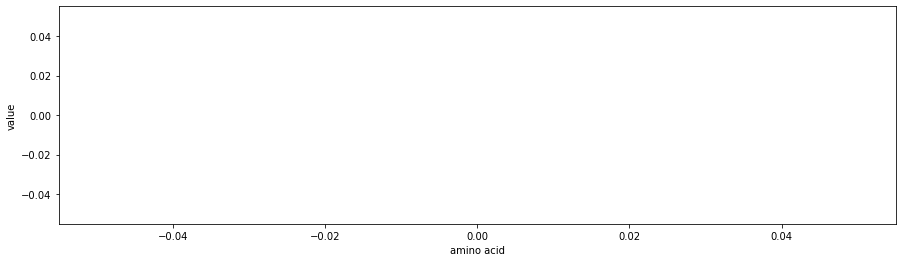

ORIGINAL001


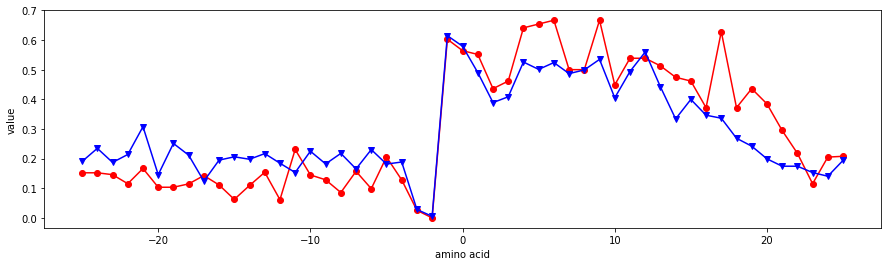

ANDN920101


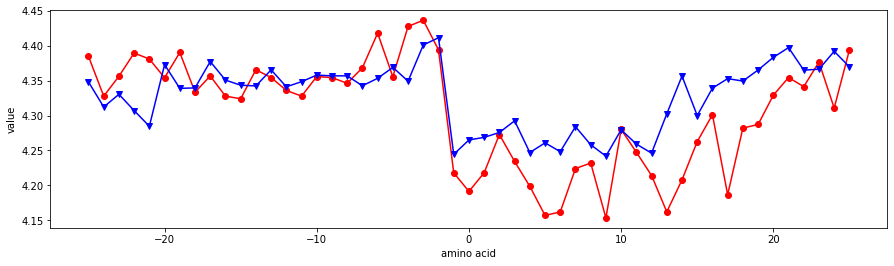

ARGP820101


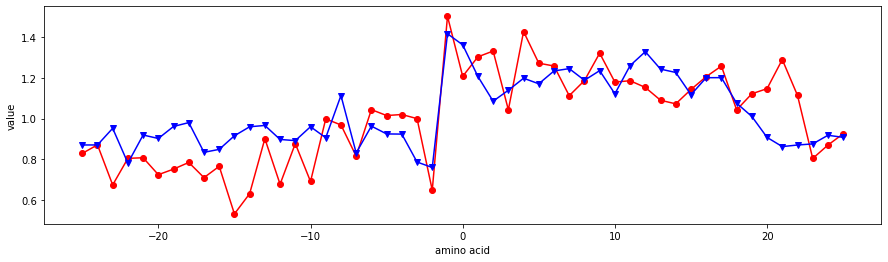

ARGP820102


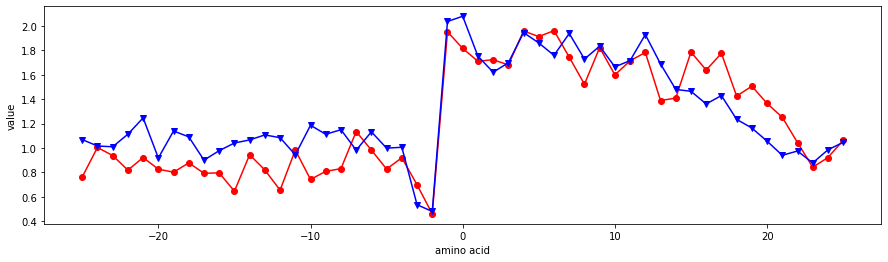

ARGP820103


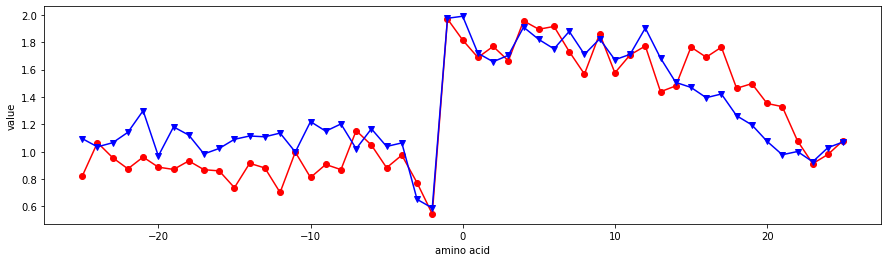

BEGF750101


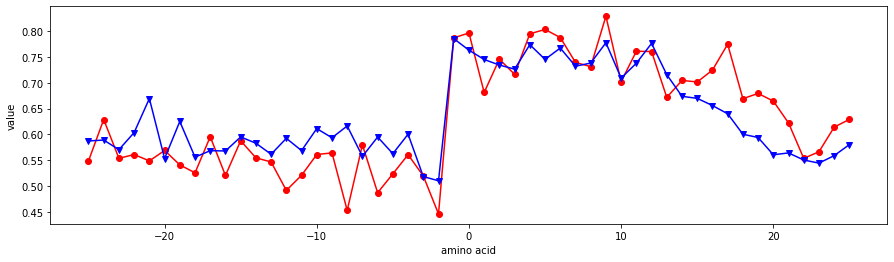

BEGF750102


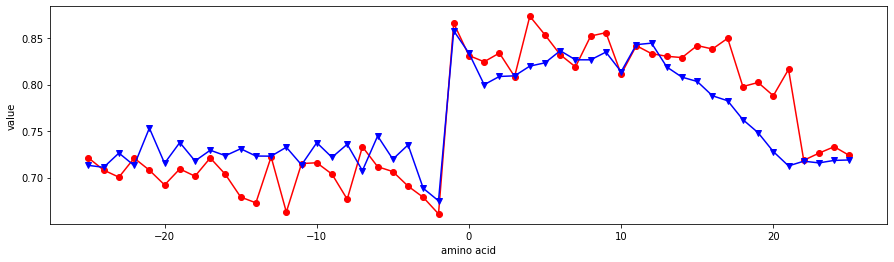

BEGF750103


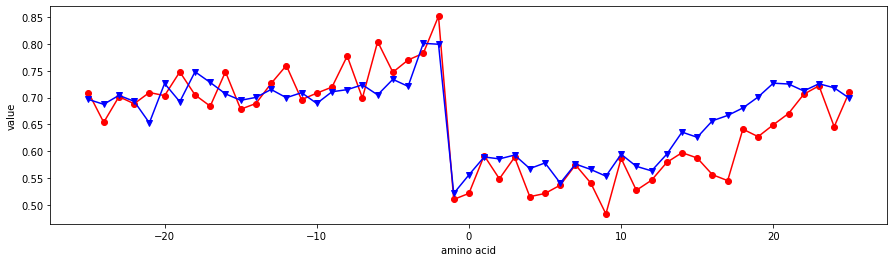

BHAR880101


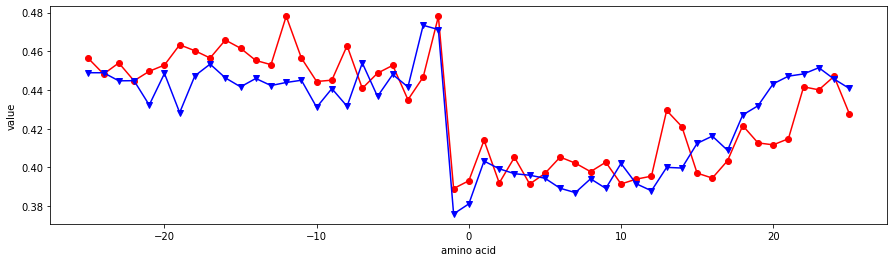

BIGC670101


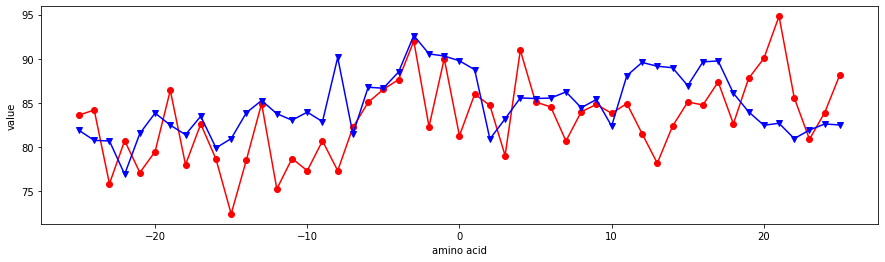

BIOV880101


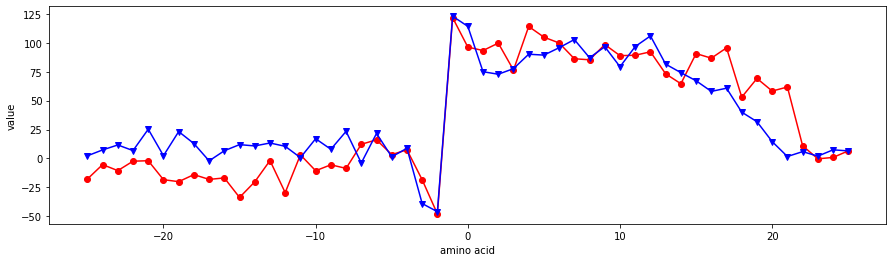

BIOV880102


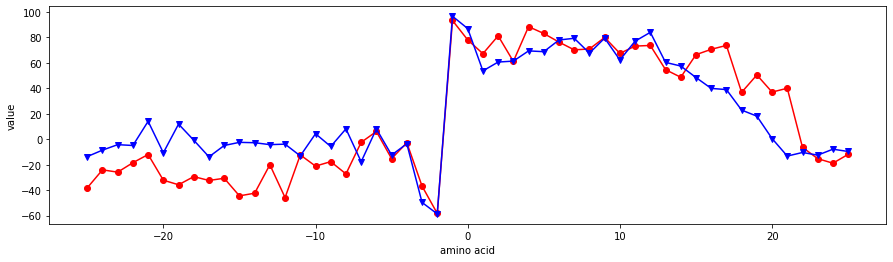

BROC820101


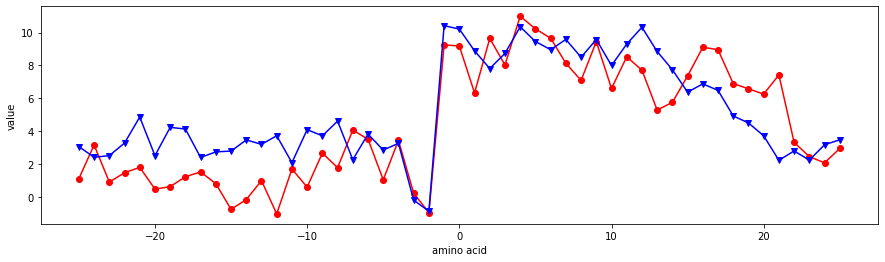

BROC820102


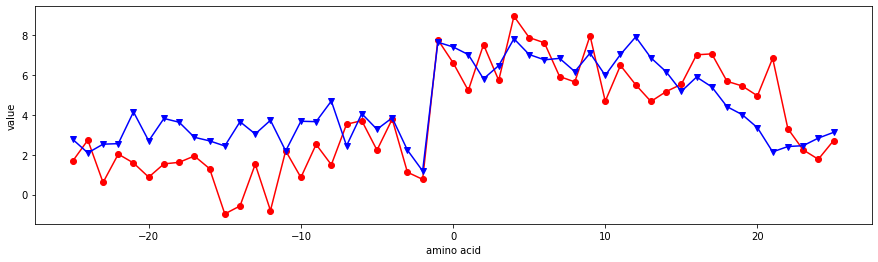

BULH740101


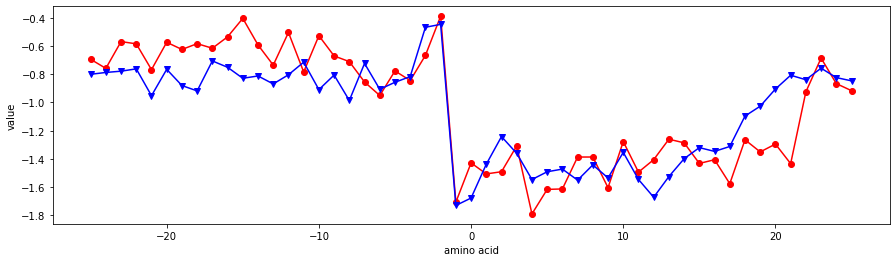

BULH740102


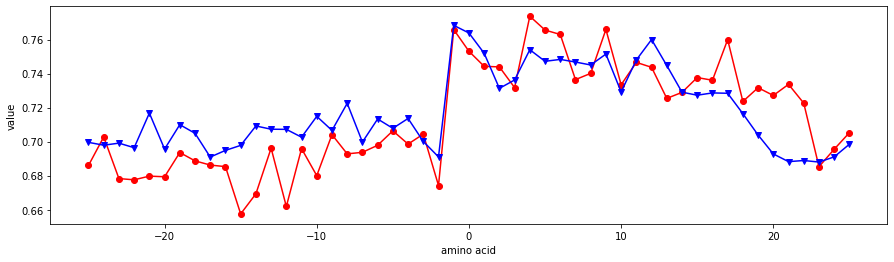

BUNA790101


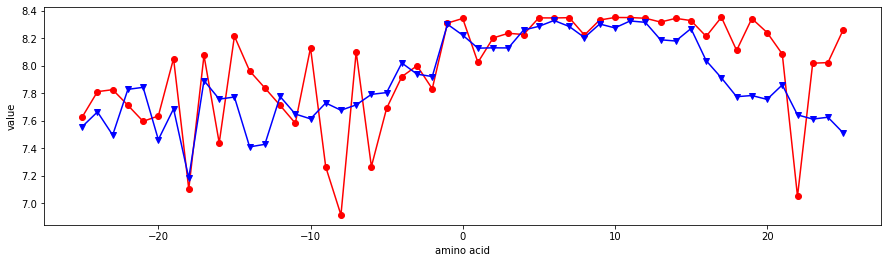

BUNA790102


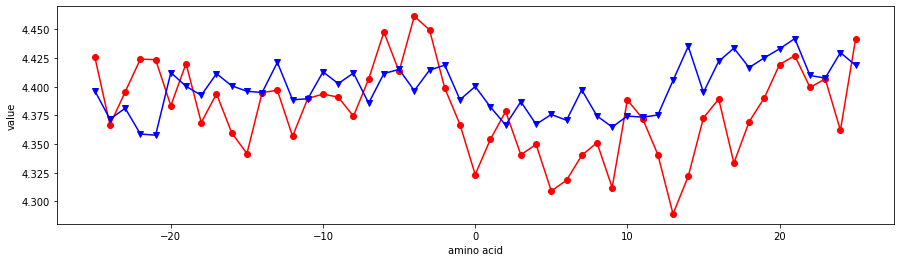

BUNA790103


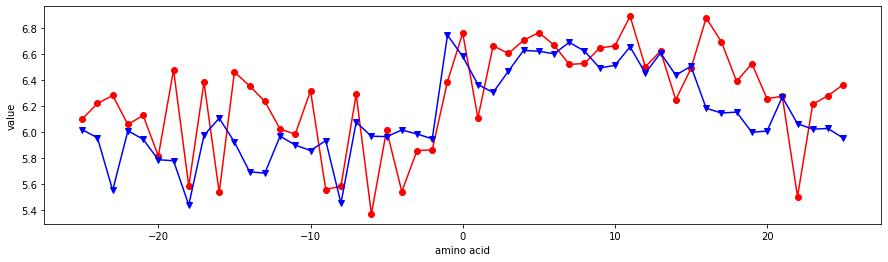

BURA740101


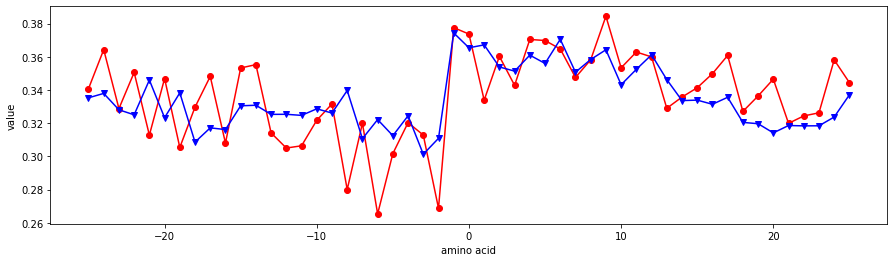

BURA740102


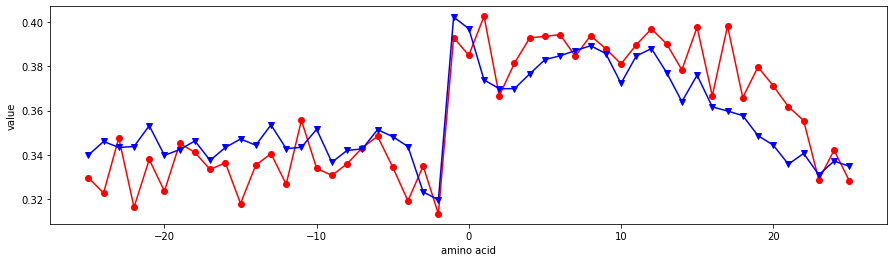

CHAM810101


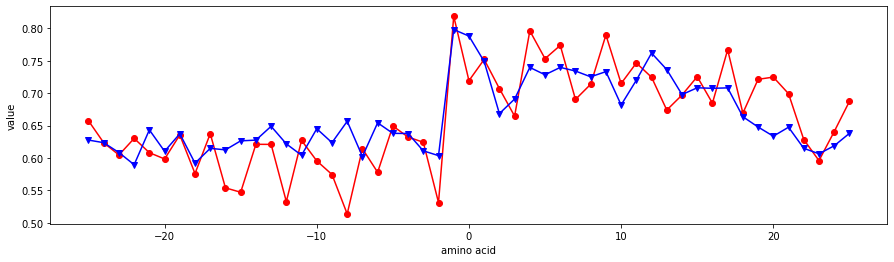

CHAM820101


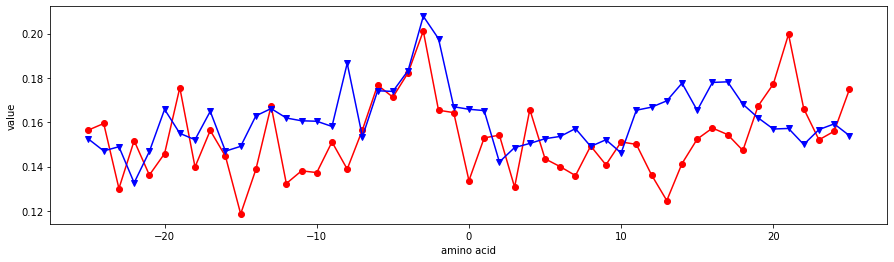

CHAM820102


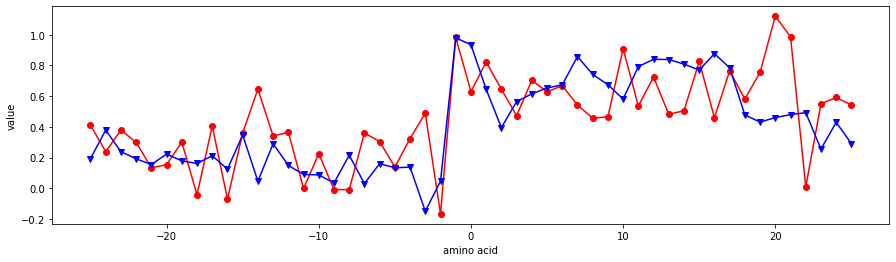

CHAM830101


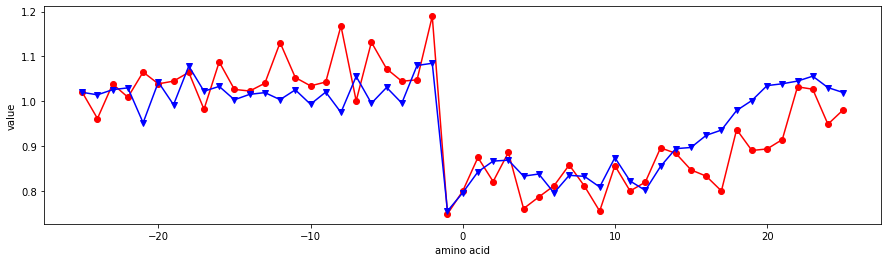

CHAM830102


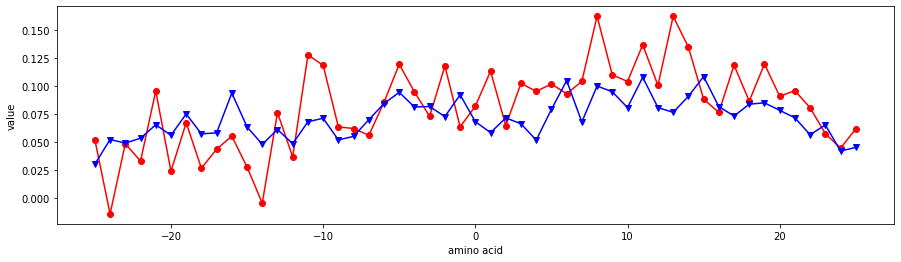

CHAM830103


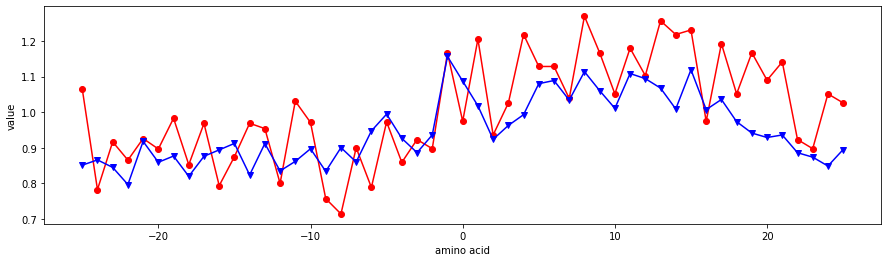

CHAM830104


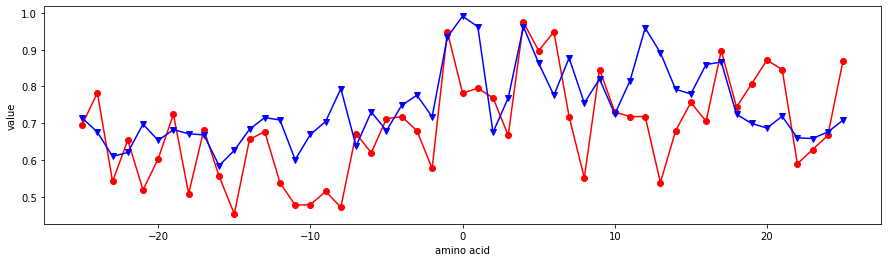

CHAM830105


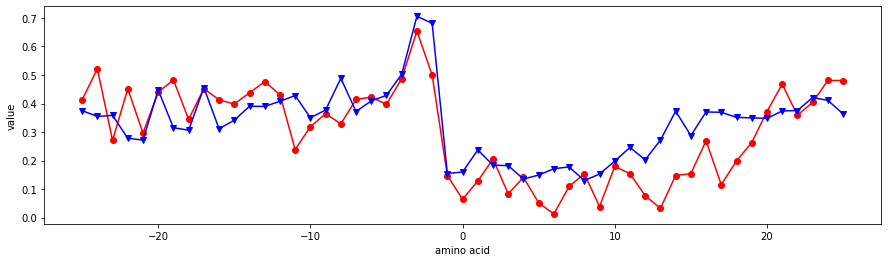

CHAM830106


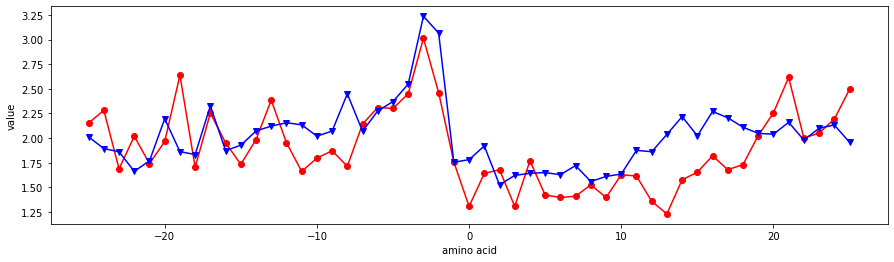

CHAM830107


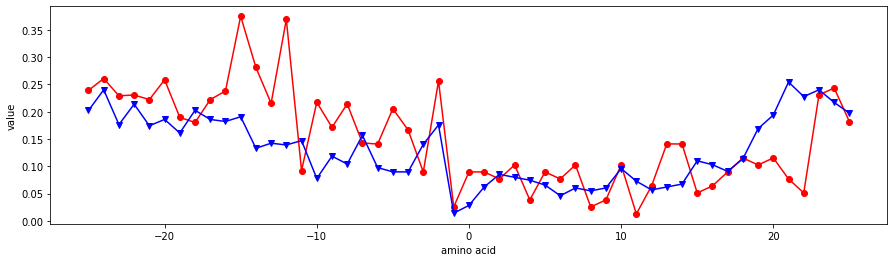

CHAM830108


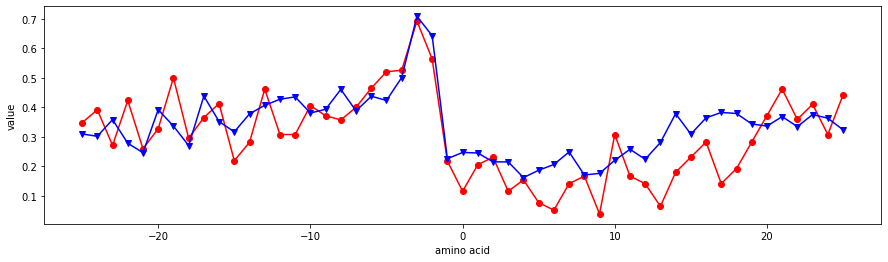

CHOC750101


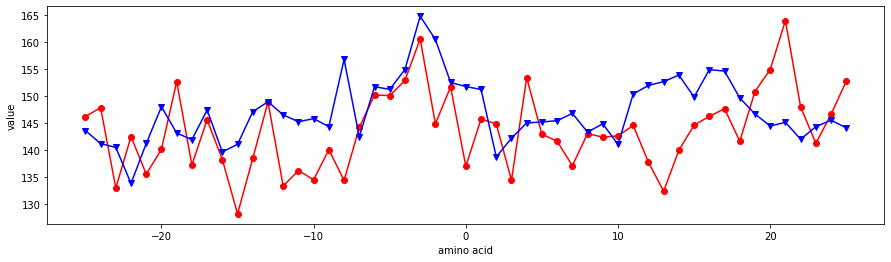

CHOC760101


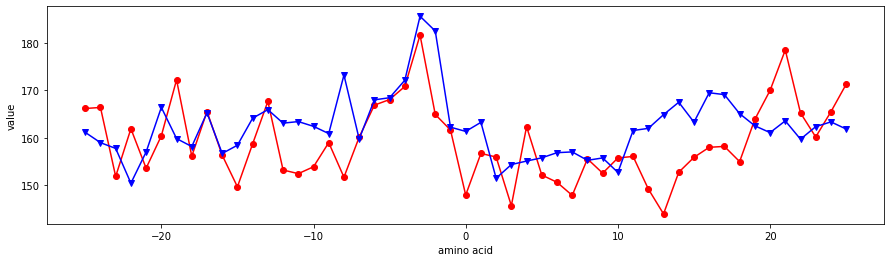

CHOC760102


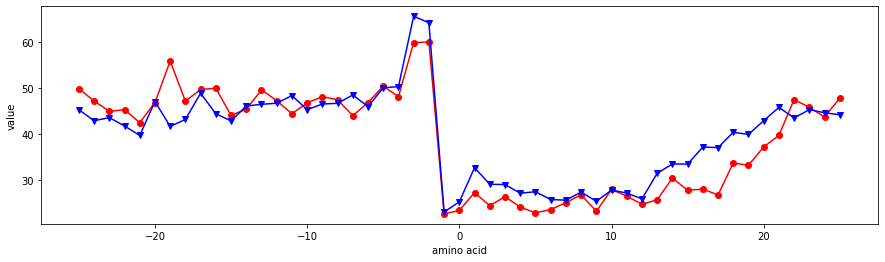

CHOC760103


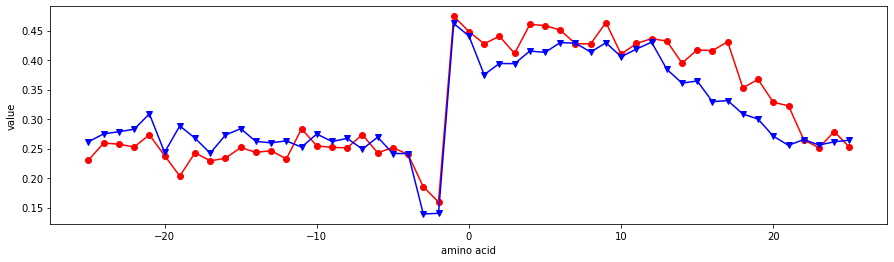

CHOC760104


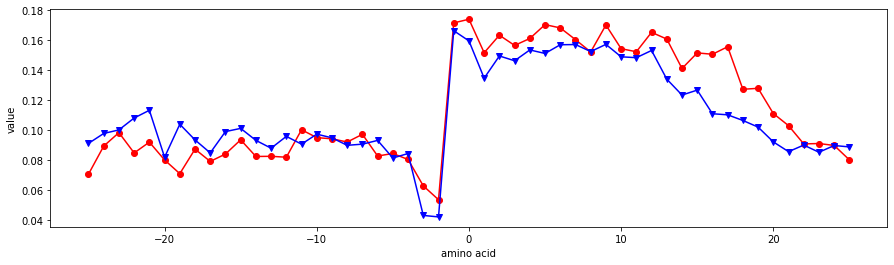

CHOP780101


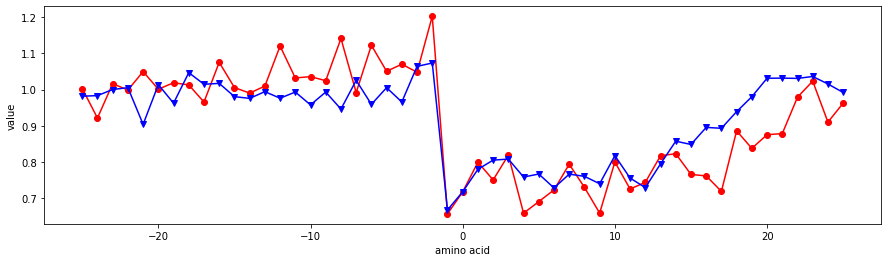

CHOP780201


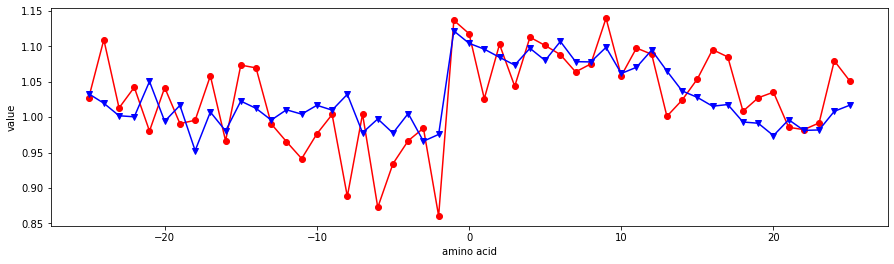

CHOP780202


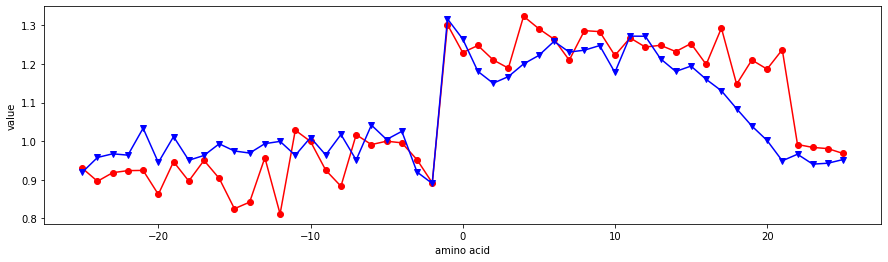

CHOP780203


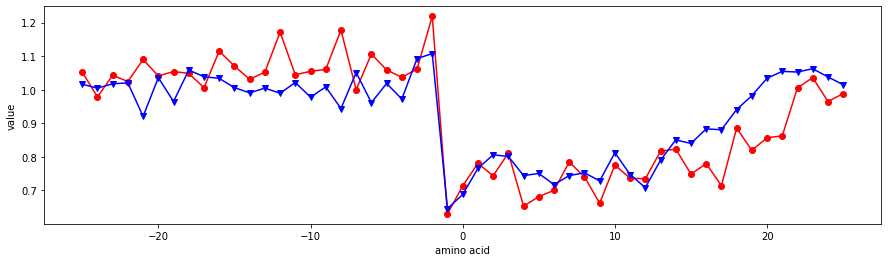

CHOP780204


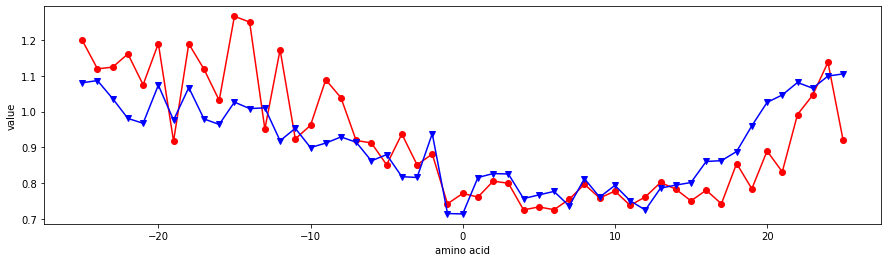

CHOP780205


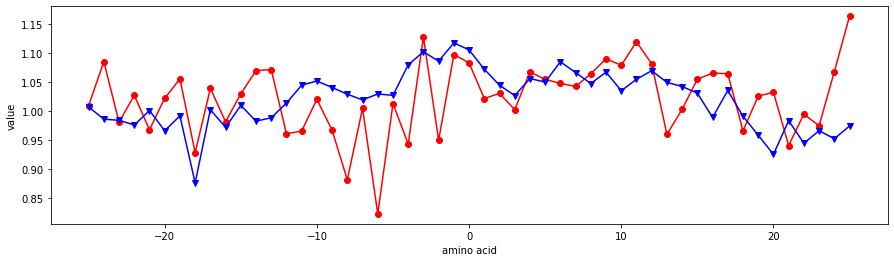

CHOP780206


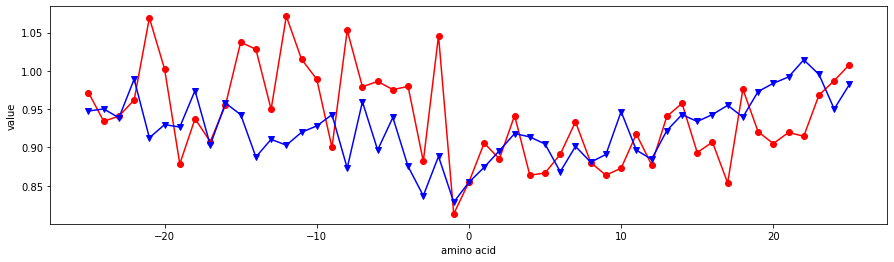

CHOP780207


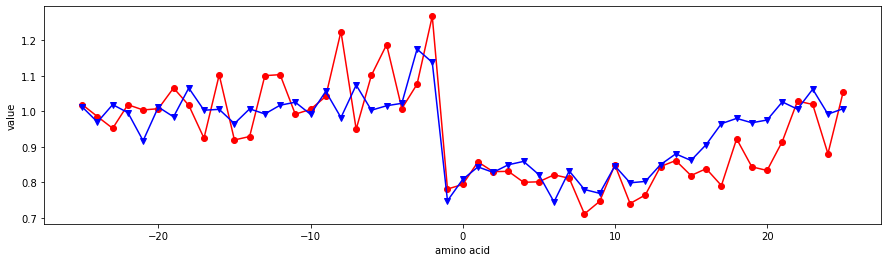

CHOP780208


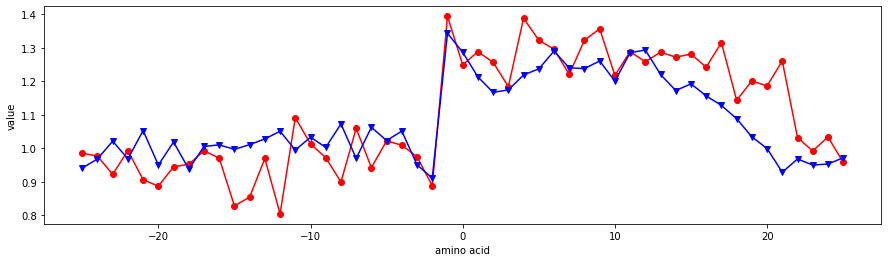

CHOP780209


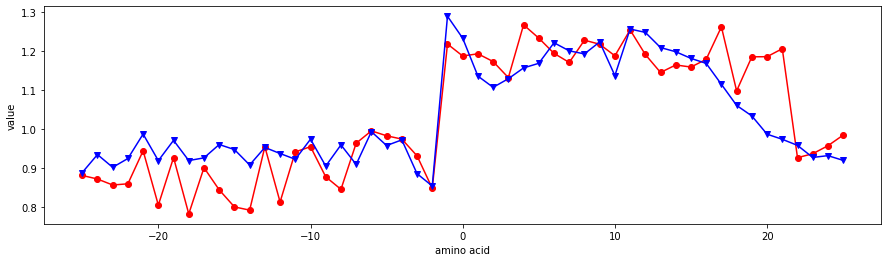

CHOP780210


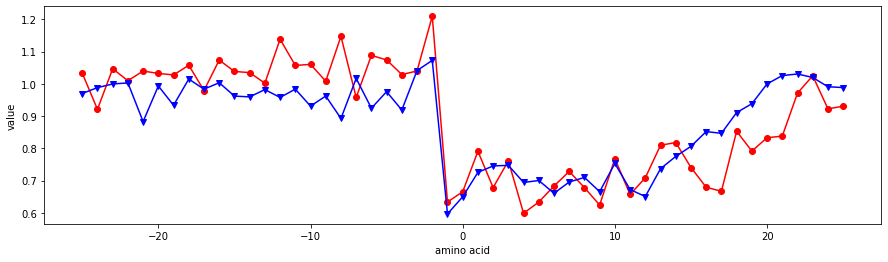

CHOP780211


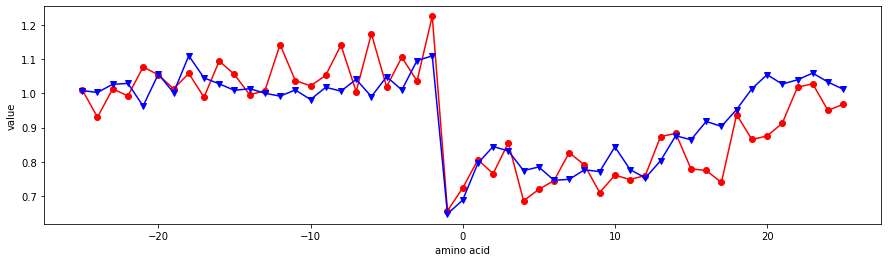

CHOP780212


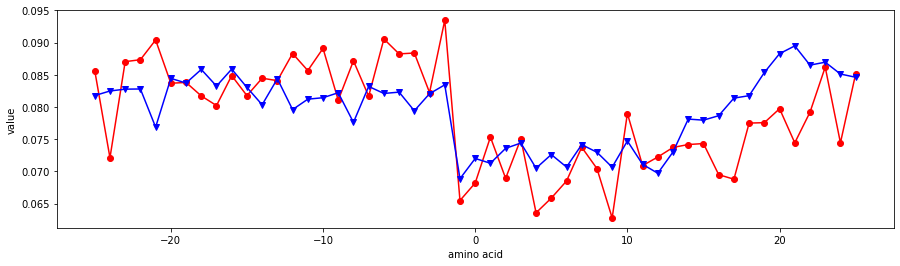

CHOP780213


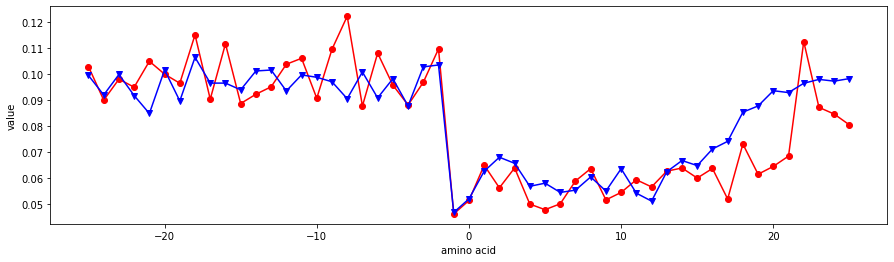

CHOP780214


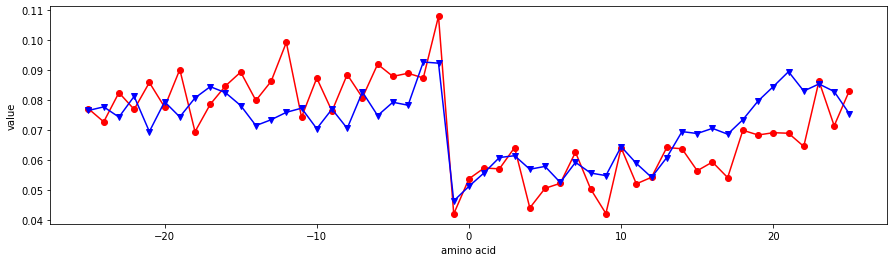

CHOP780215


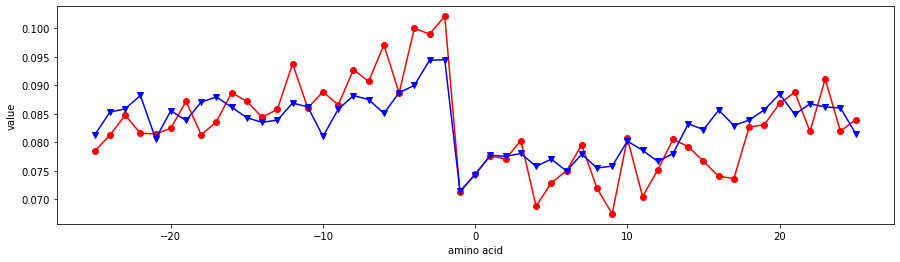

CHOP780216


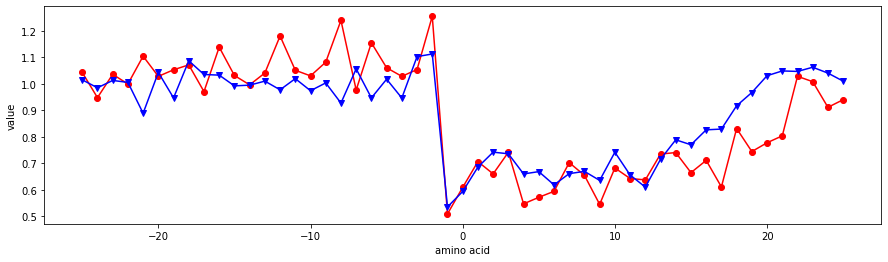

CIDH920101


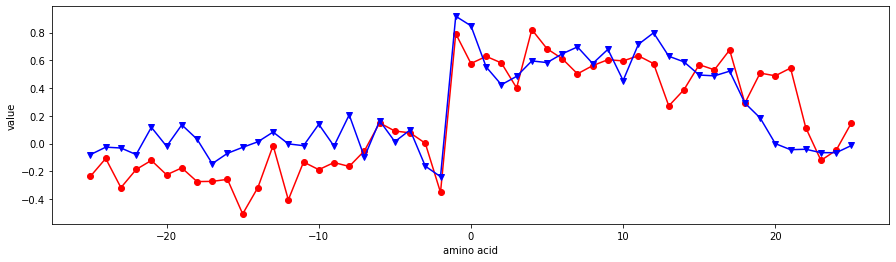

CIDH920102


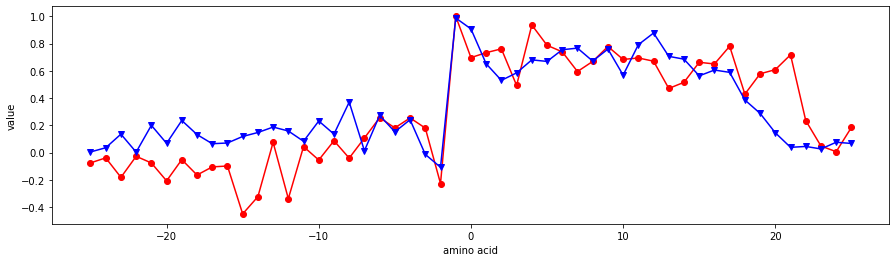

CIDH920103


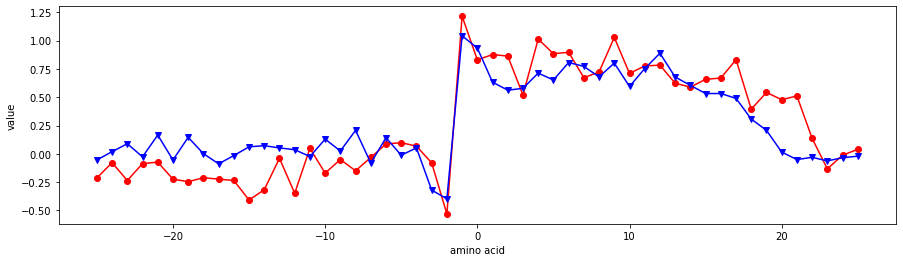

CIDH920104


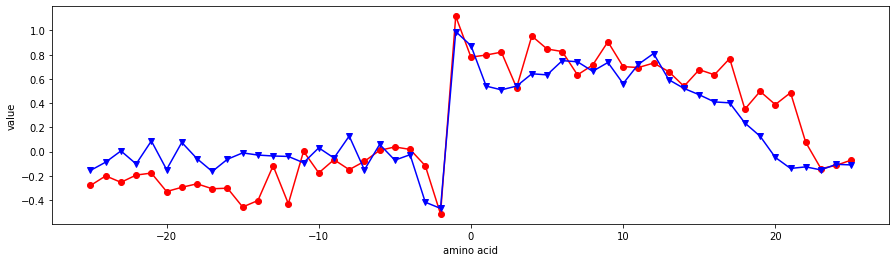

CIDH920105


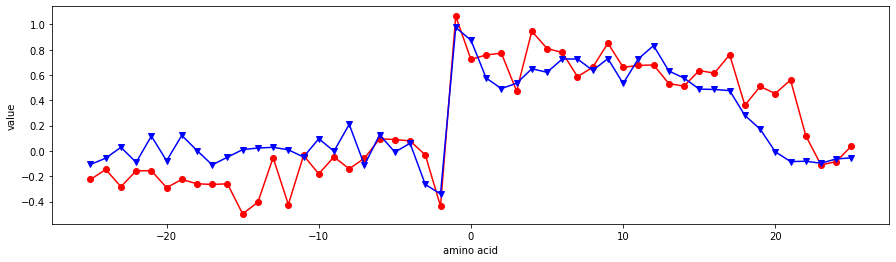

COHE430101


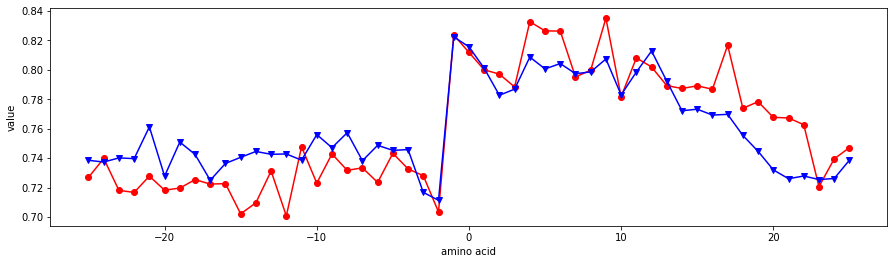

CRAJ730101


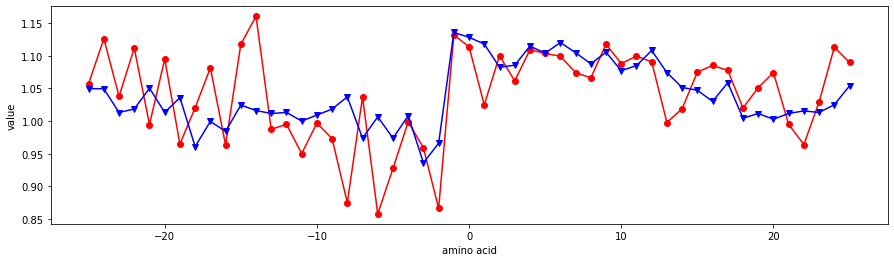

CRAJ730102


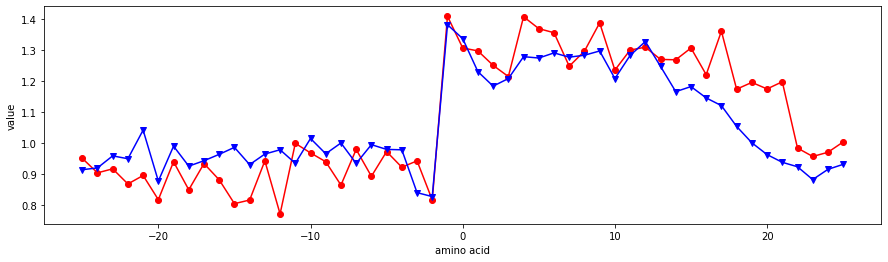

CRAJ730103


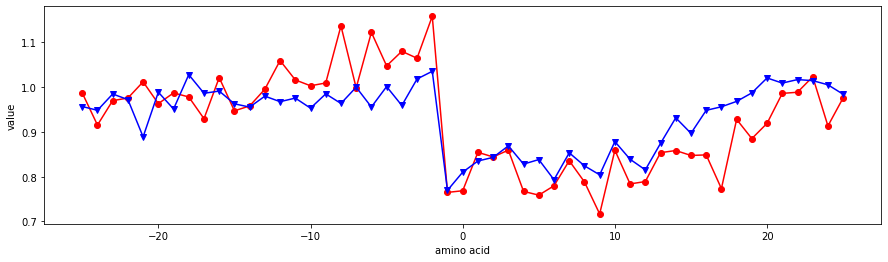

DAWD720101


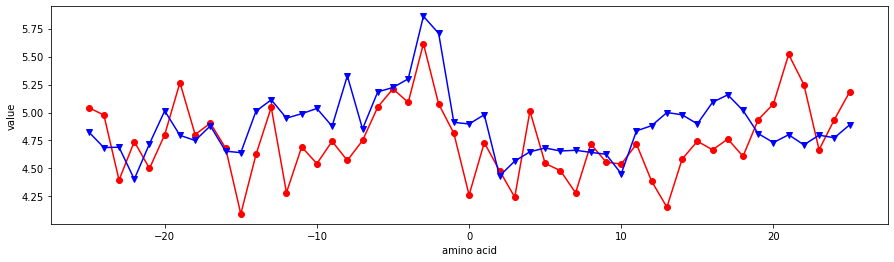

DAYM780101


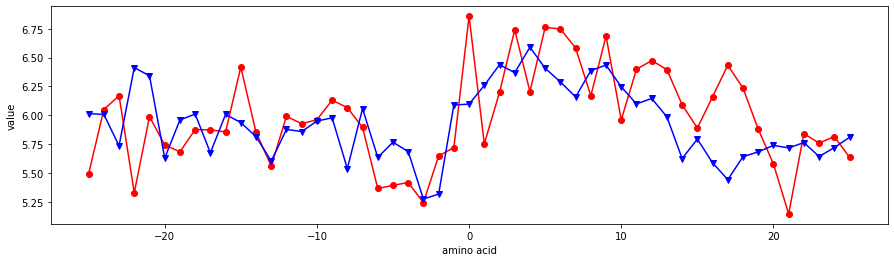

DAYM780201


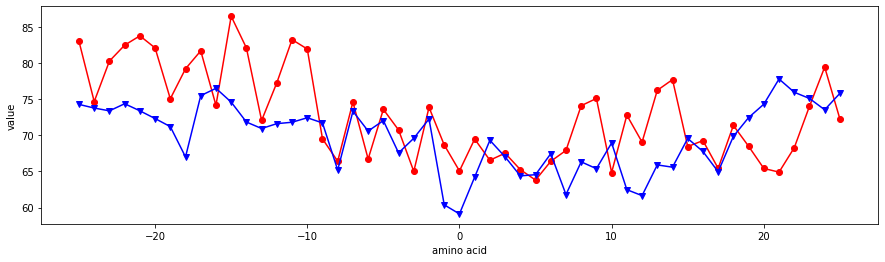

DESM900101


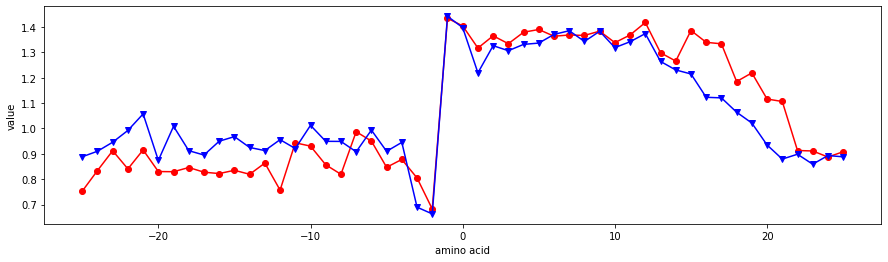

DESM900102


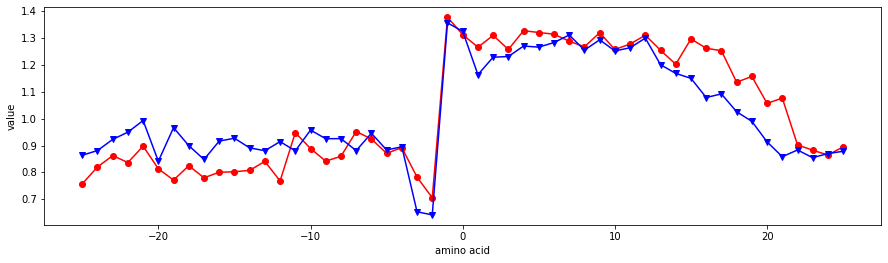

EISD840101


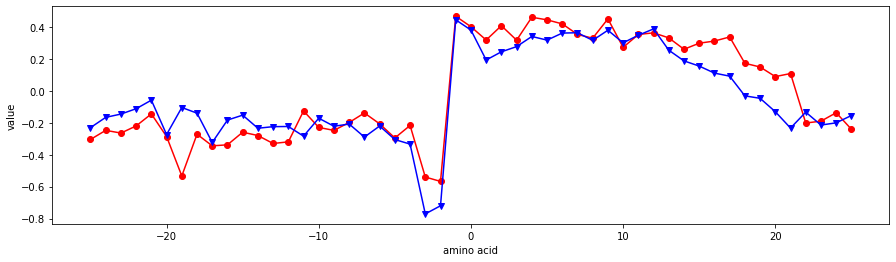

EISD860101


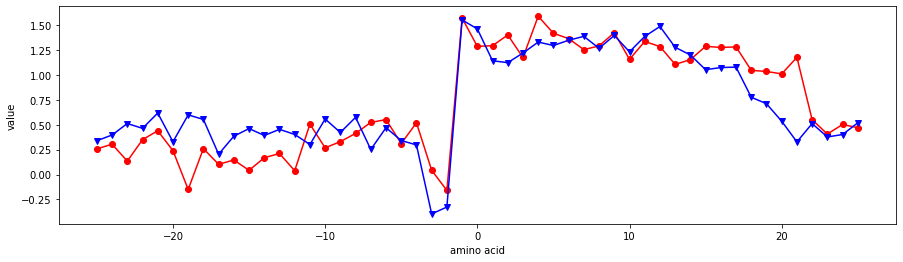

EISD860102


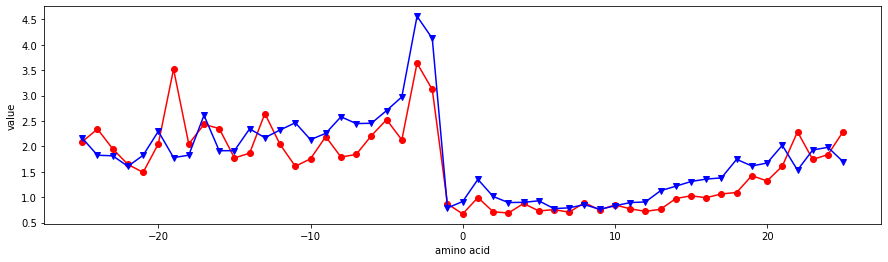

EISD860103


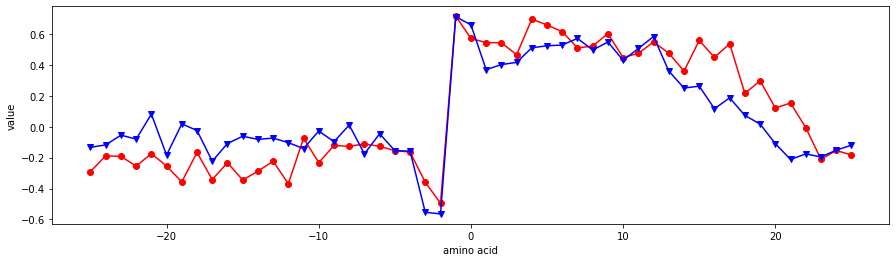

FASG760101


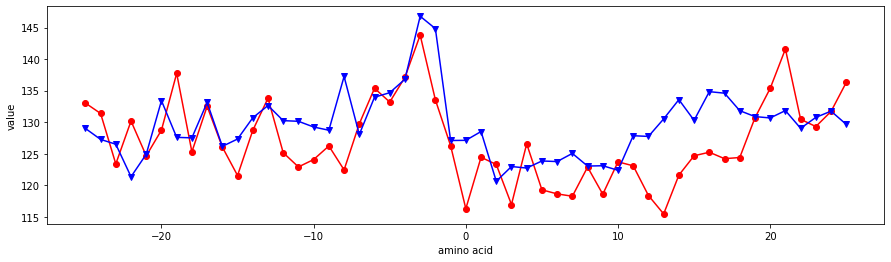

FASG760102


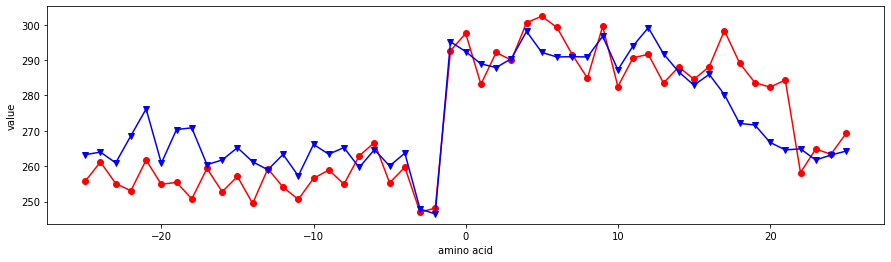

FASG760103


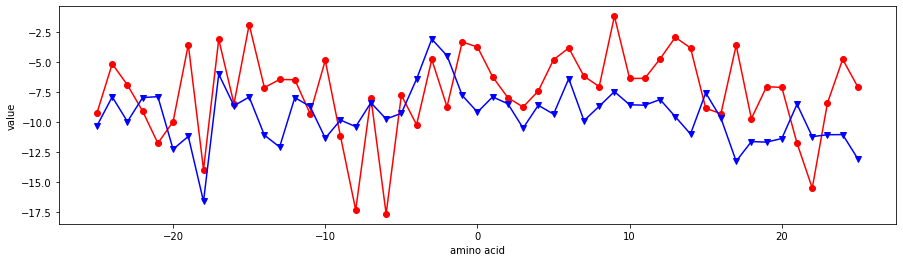

FASG760104


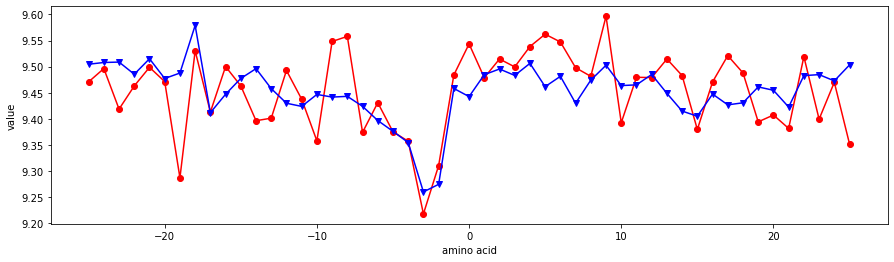

FASG760105


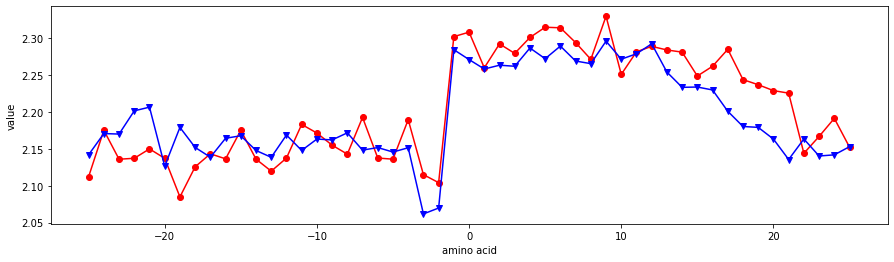

FAUJ830101


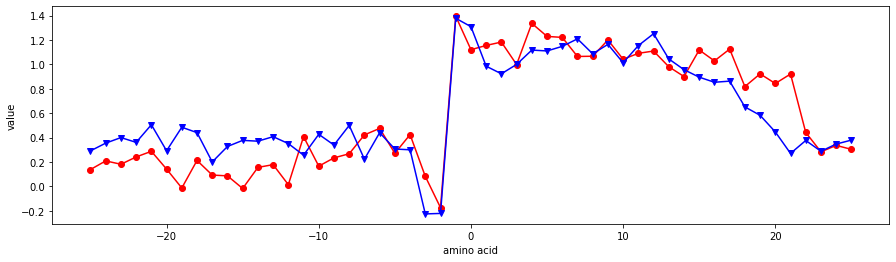

FAUJ880101


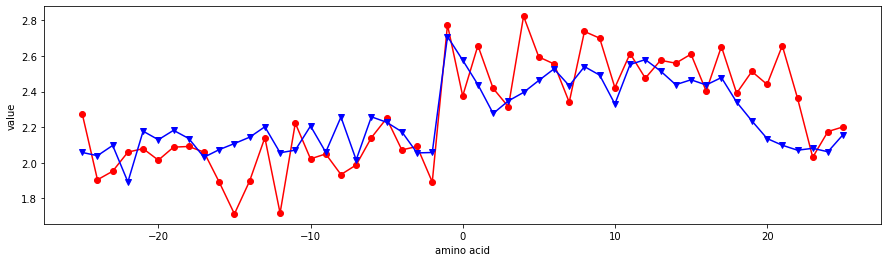

FAUJ880102


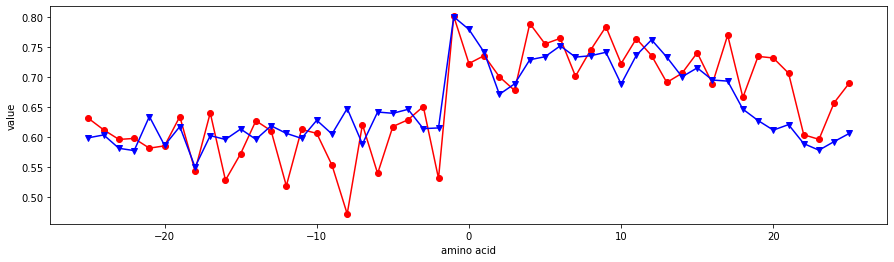

FAUJ880103


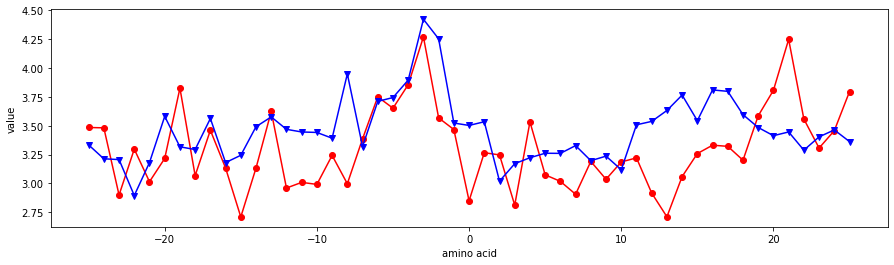

FAUJ880104


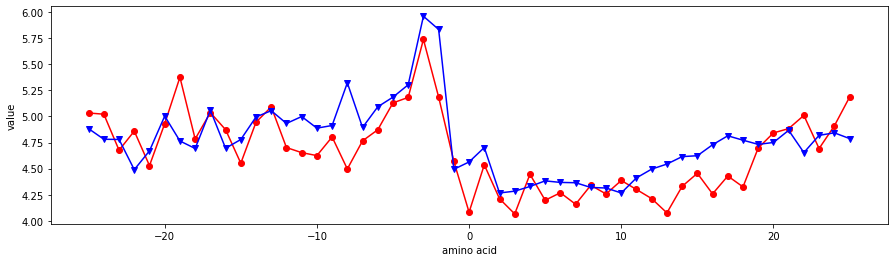

FAUJ880105


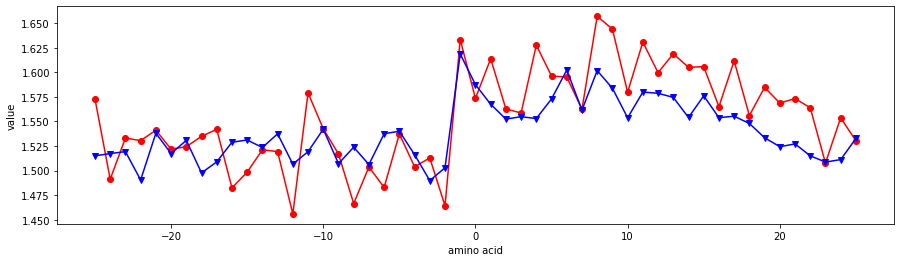

FAUJ880106


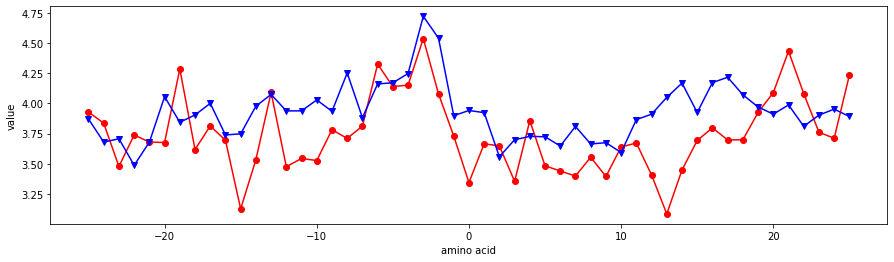

FAUJ880107


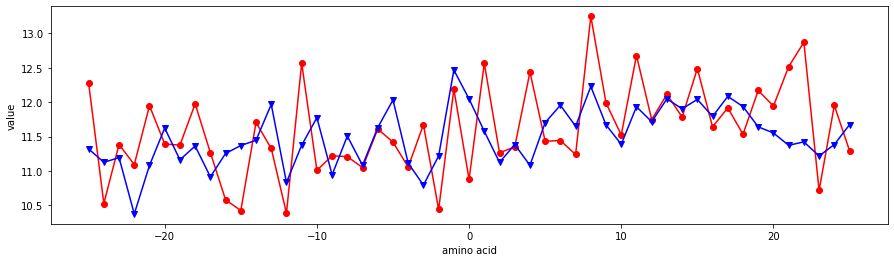

FAUJ880108


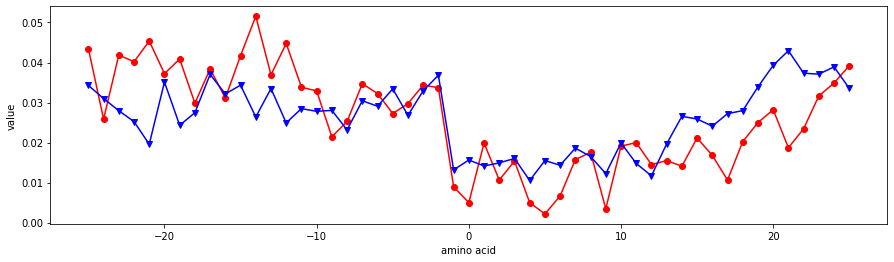

FAUJ880109


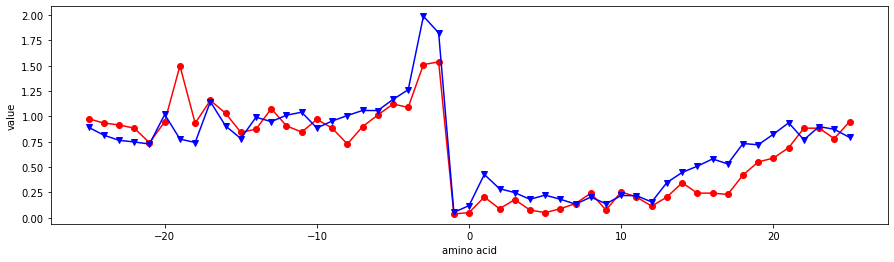

FAUJ880110


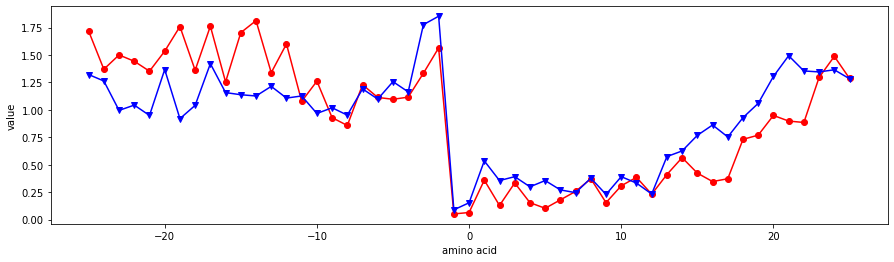

FAUJ880111


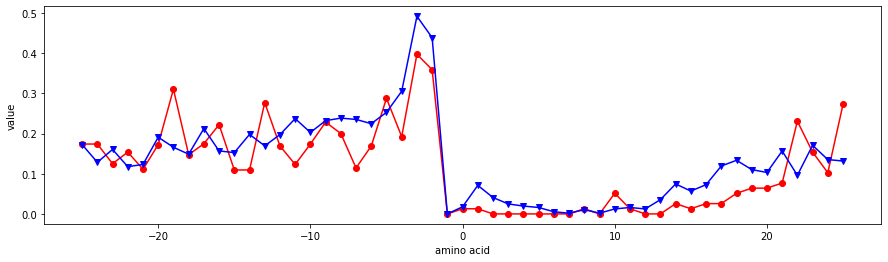

FAUJ880112


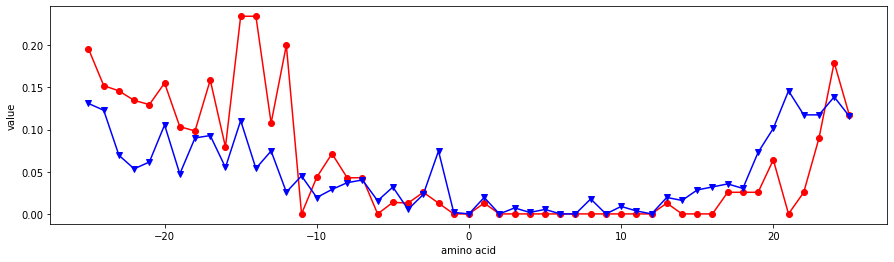

FAUJ880113


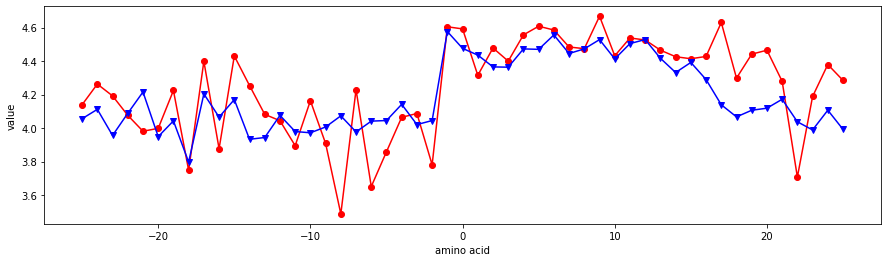

FINA770101


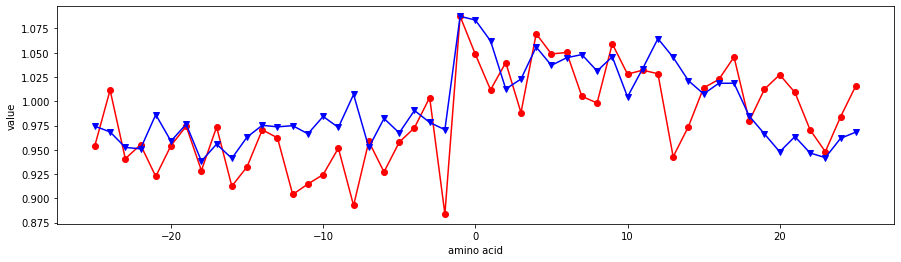

FINA910101


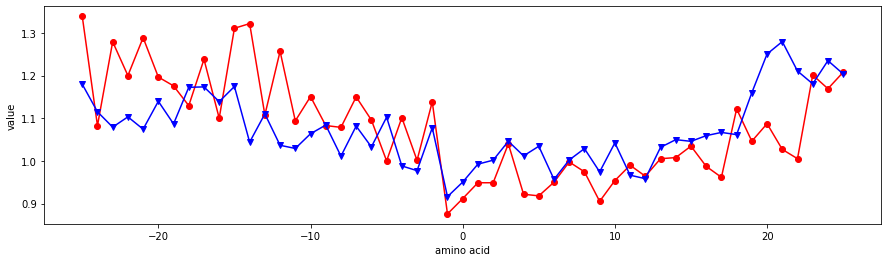

FINA910102


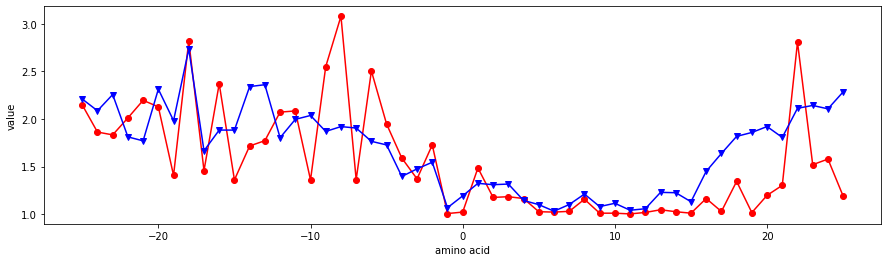

FINA910103


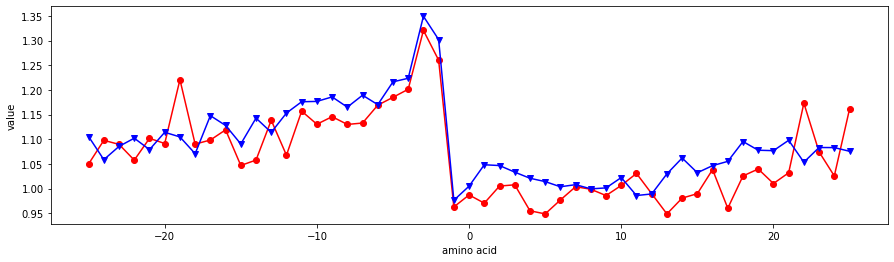

FINA910104


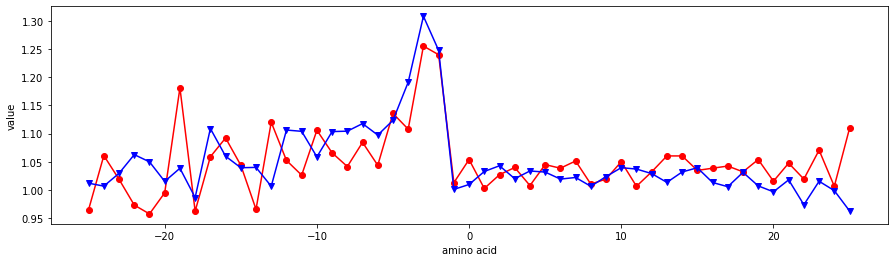

GARJ730101


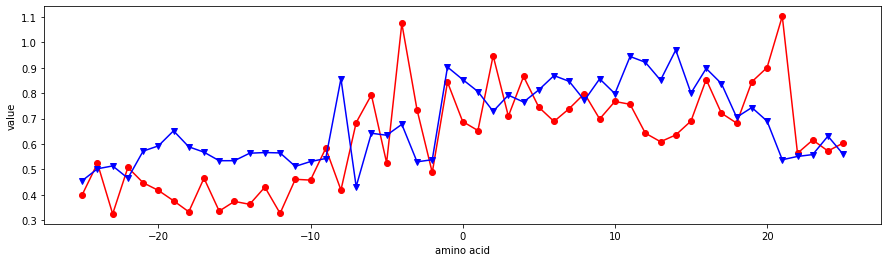

GEIM800101


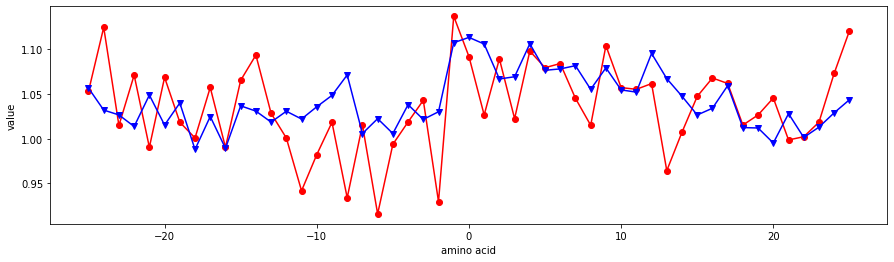

GEIM800102


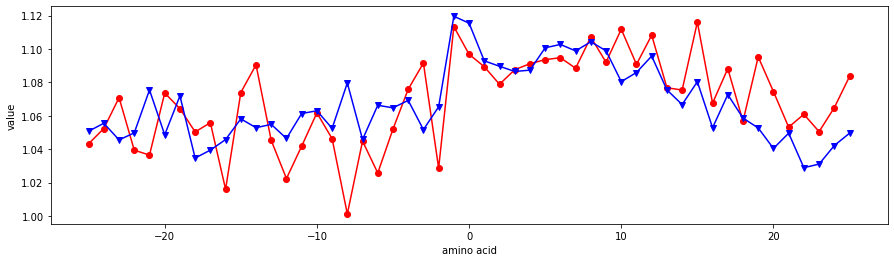

GEIM800103


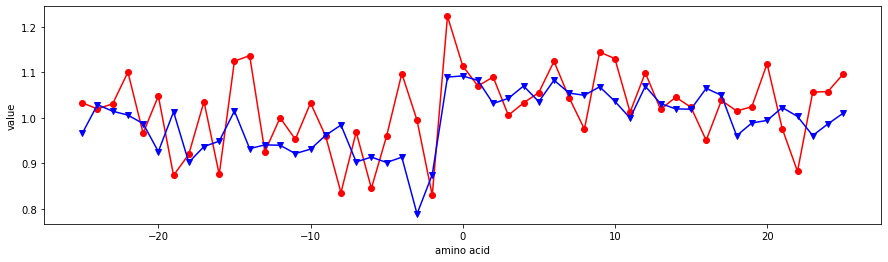

GEIM800104


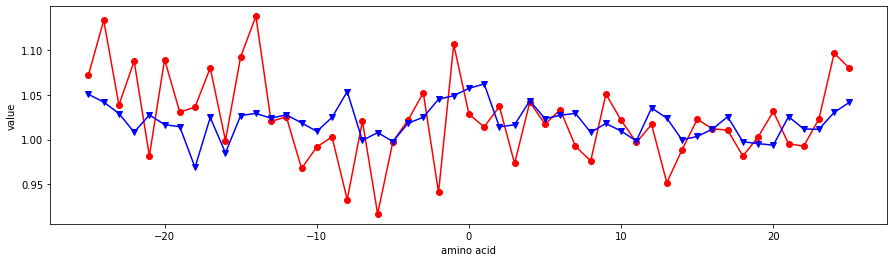

GEIM800105


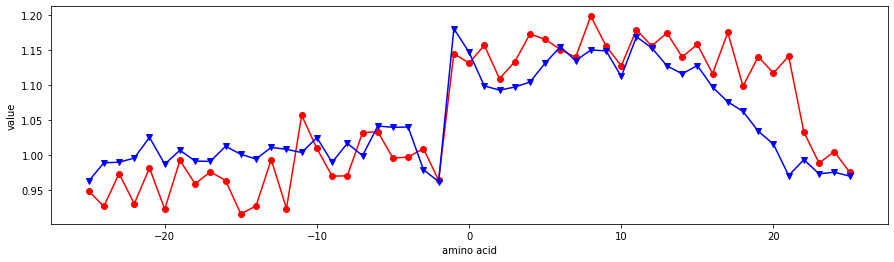

GEIM800106


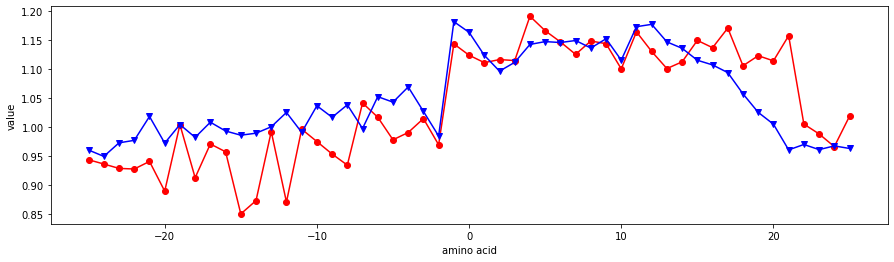

GEIM800107


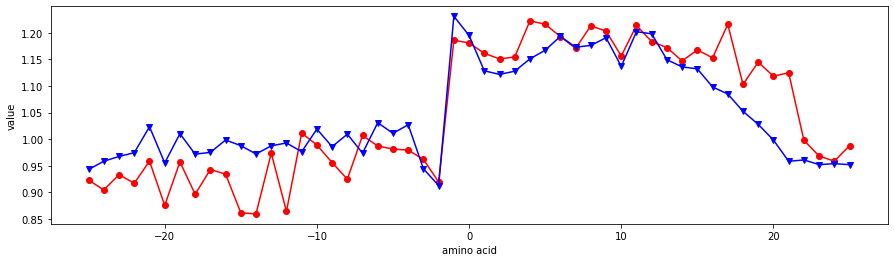

GEIM800108


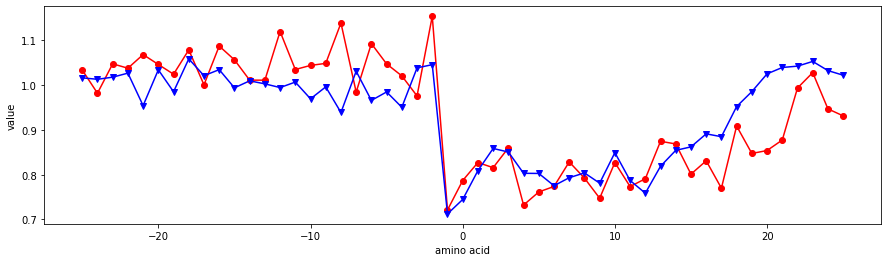

GEIM800109


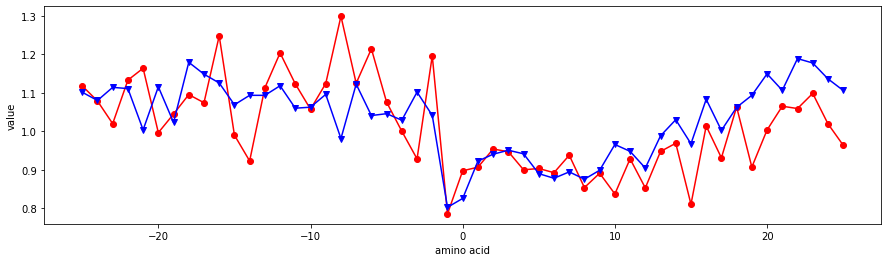

GEIM800110


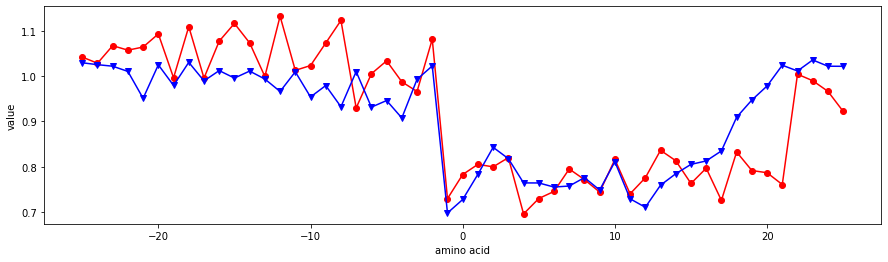

GEIM800111


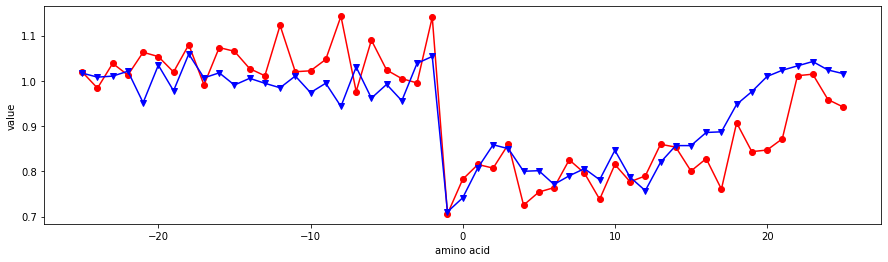

GOLD730101


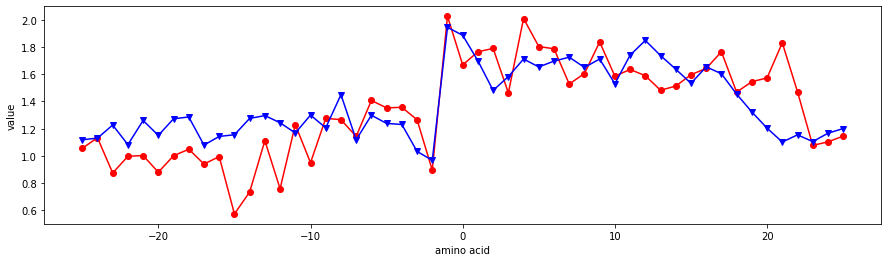

GOLD730102


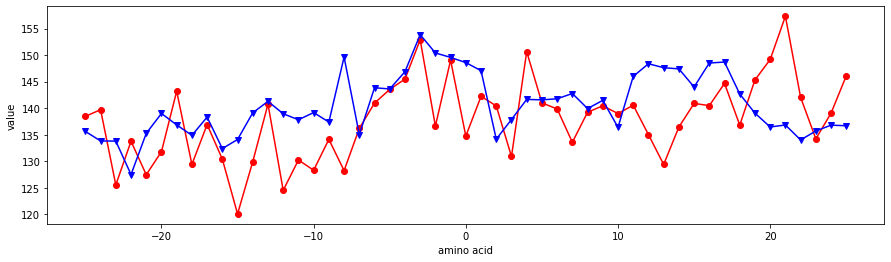

GRAR740101


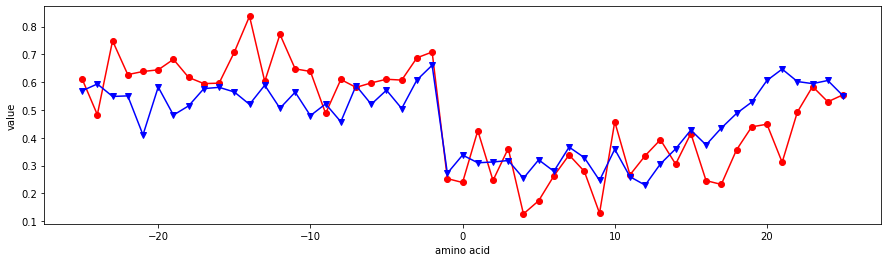

GRAR740102


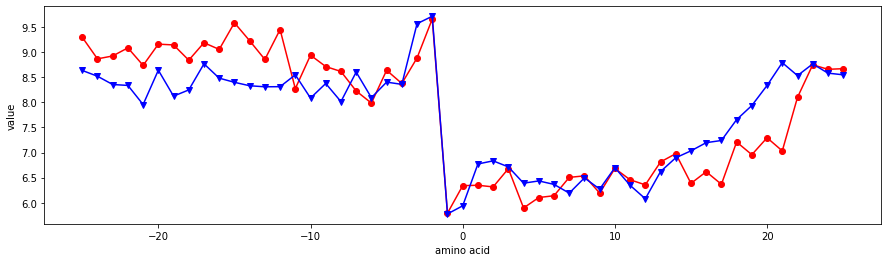

GRAR740103


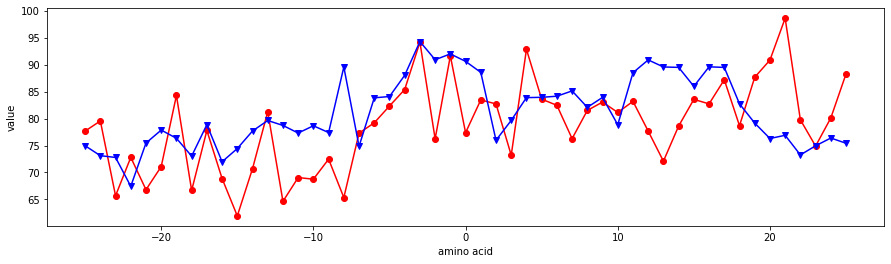

GUYH850101


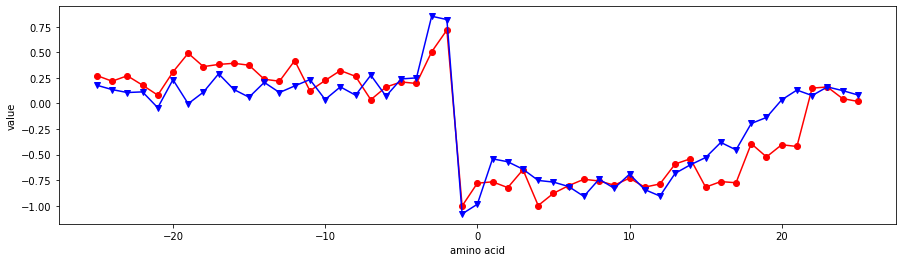

HOPA770101


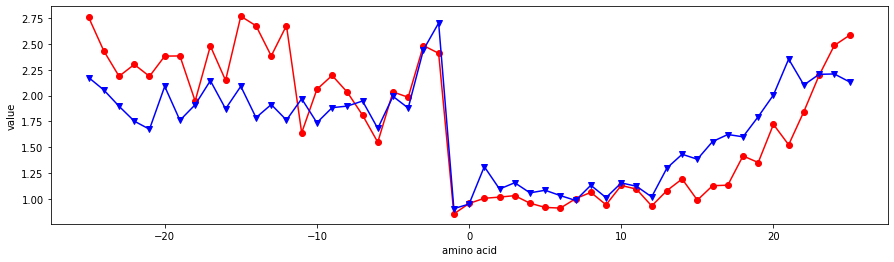

HOPT810101


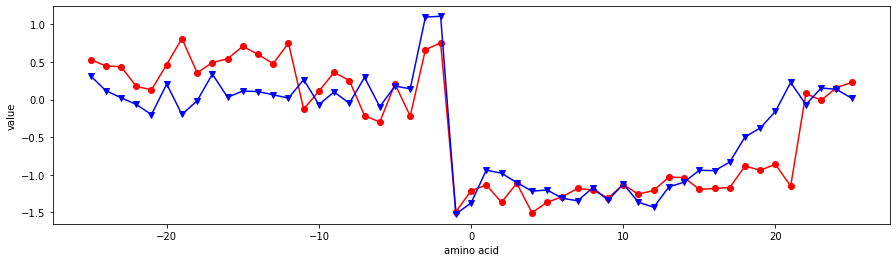

HUTJ700101


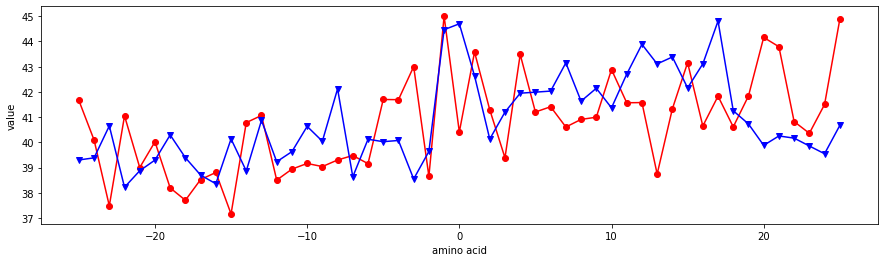

HUTJ700102


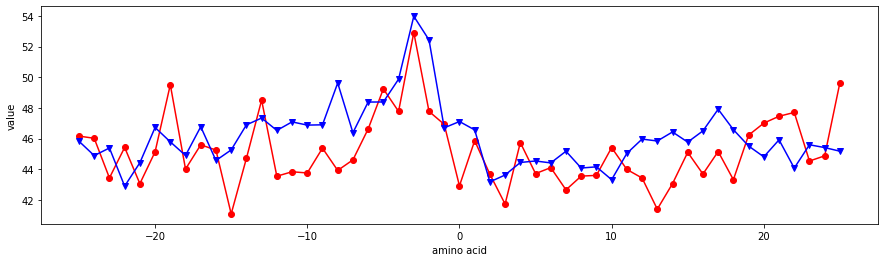

HUTJ700103


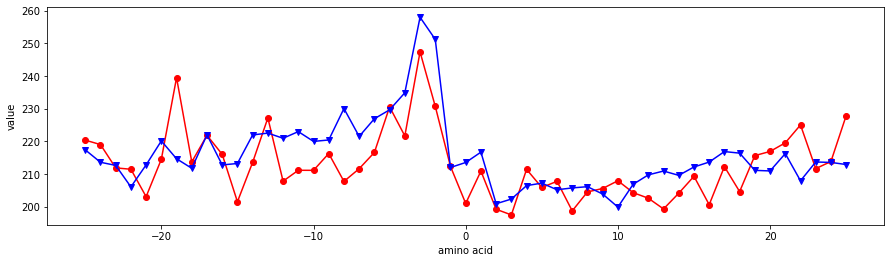

ISOY800101


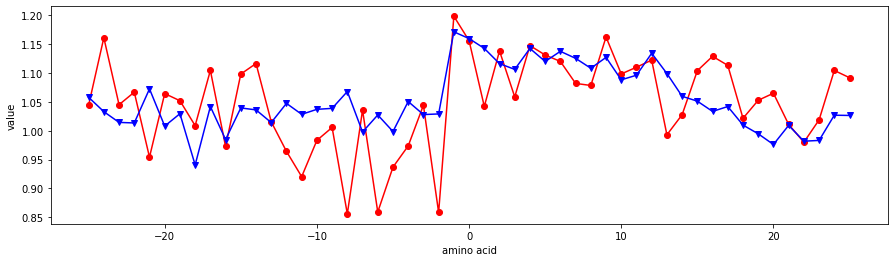

ISOY800102


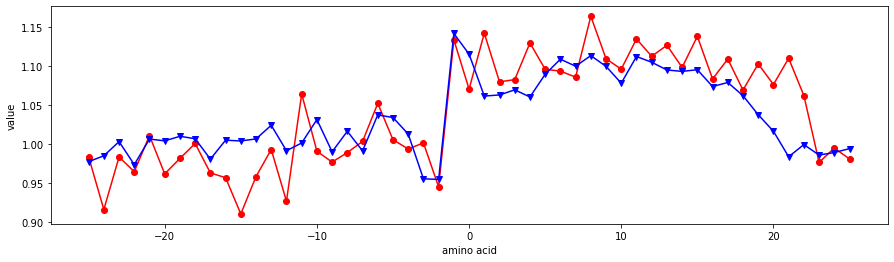

ISOY800103


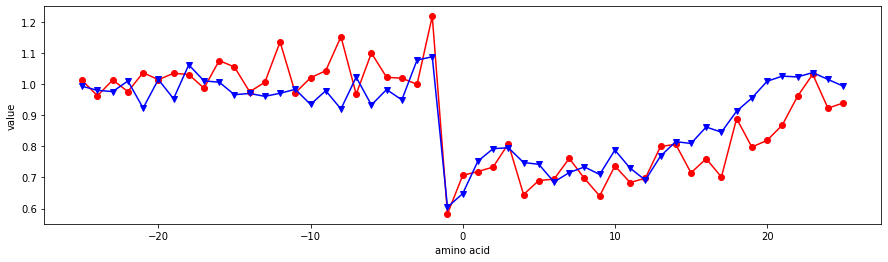

ISOY800104


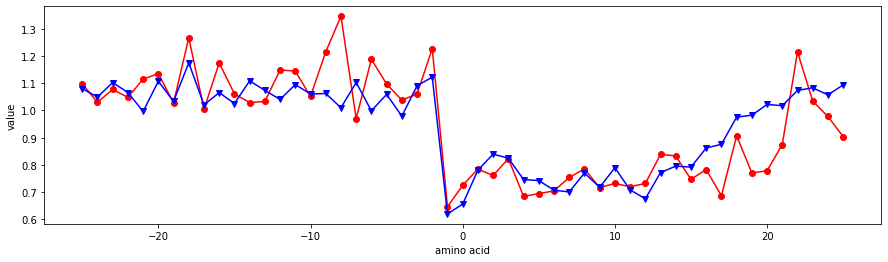

ISOY800105


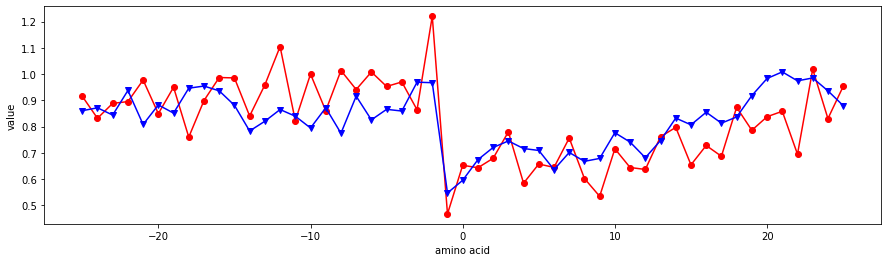

ISOY800106


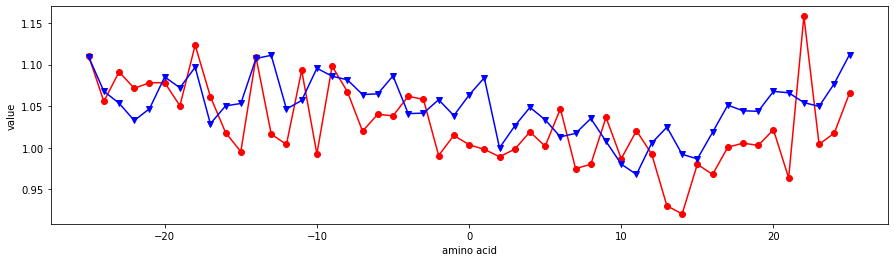

ISOY800107


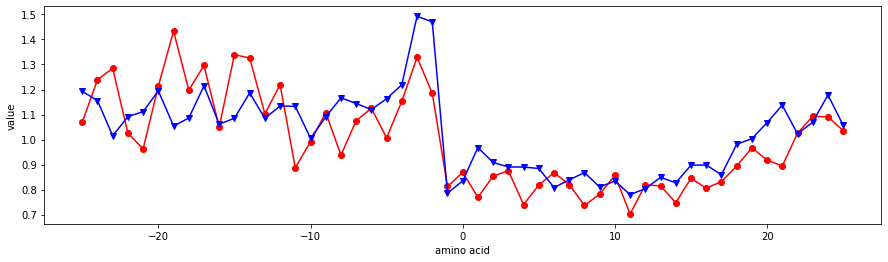

ISOY800108


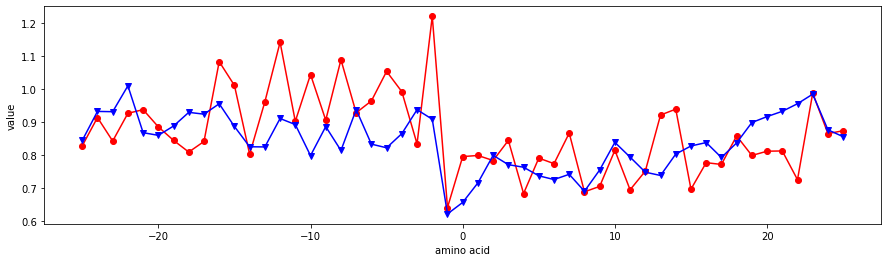

JANJ780101


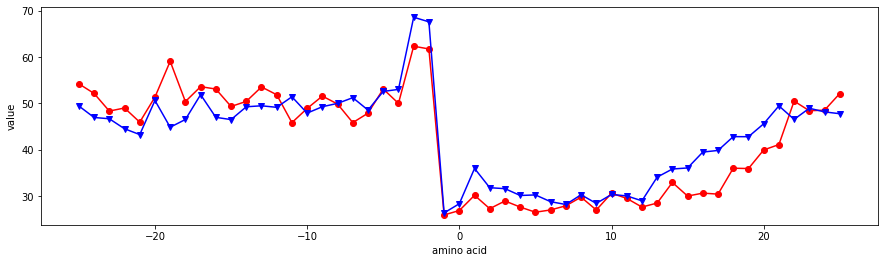

JANJ780102


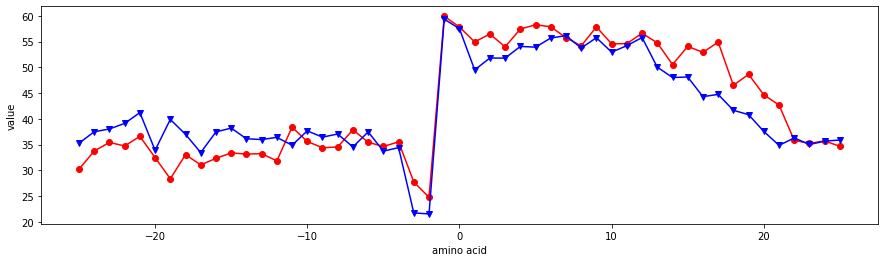

JANJ780103


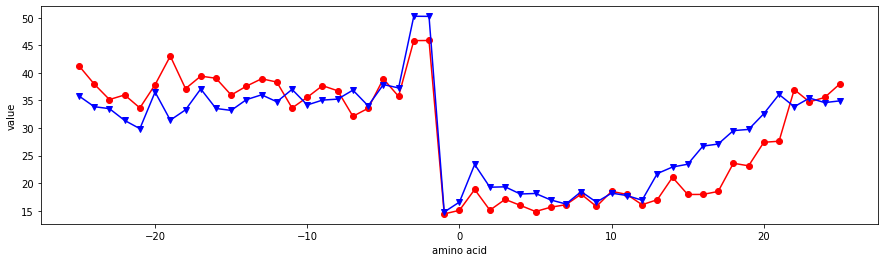

JANJ790101


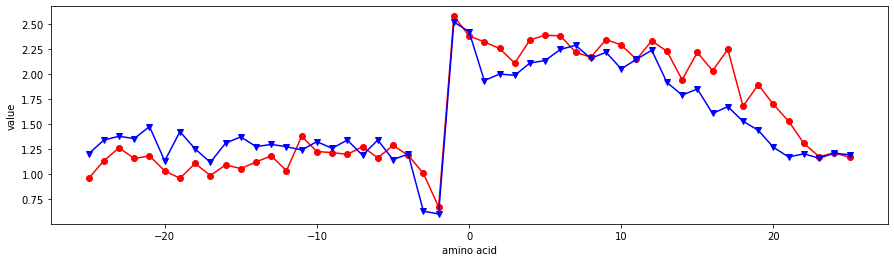

JANJ790102


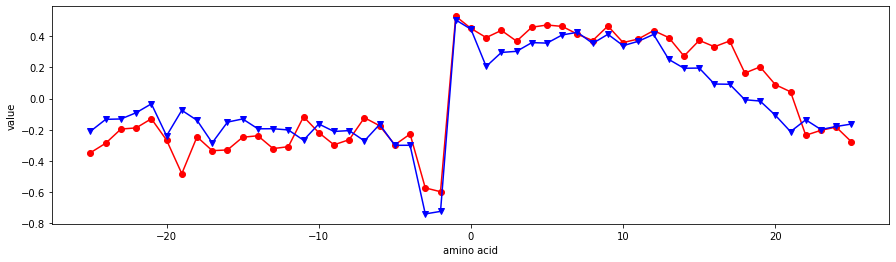

JOND750101


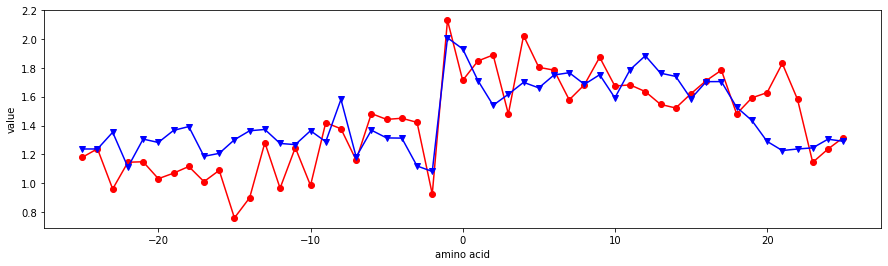

JOND750102


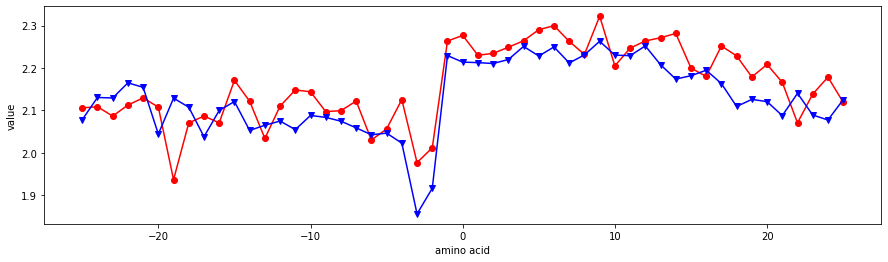

JOND920101


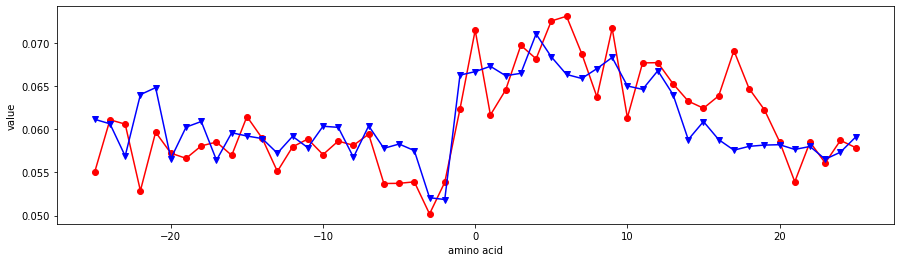

JOND920102


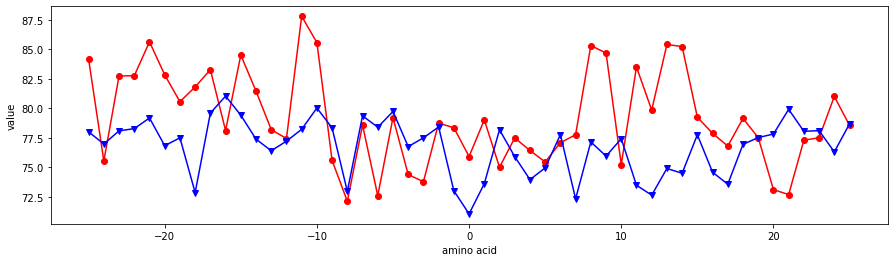

JUKT750101


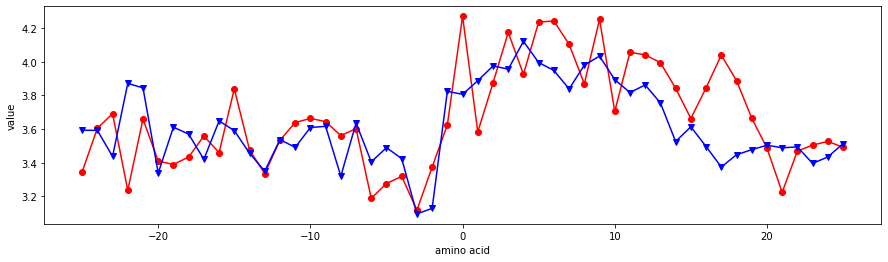

JUNJ780101


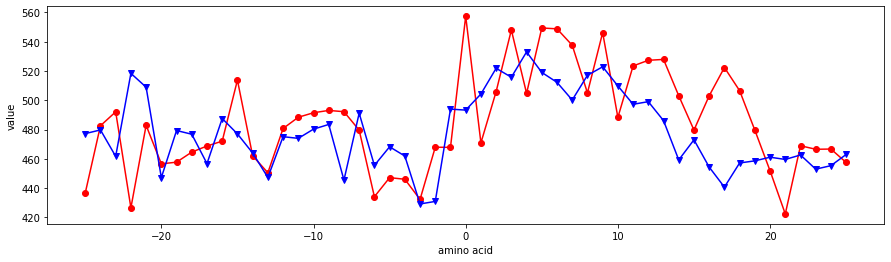

KANM800101


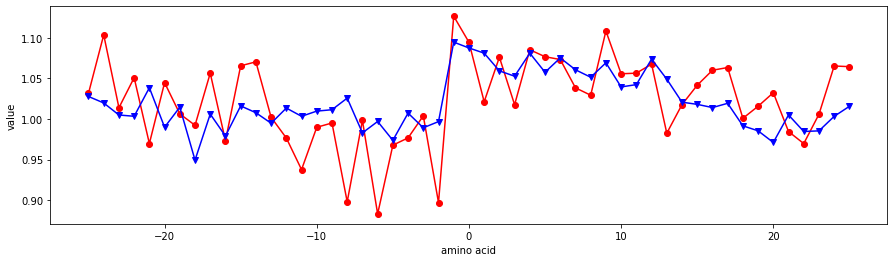

KANM800102


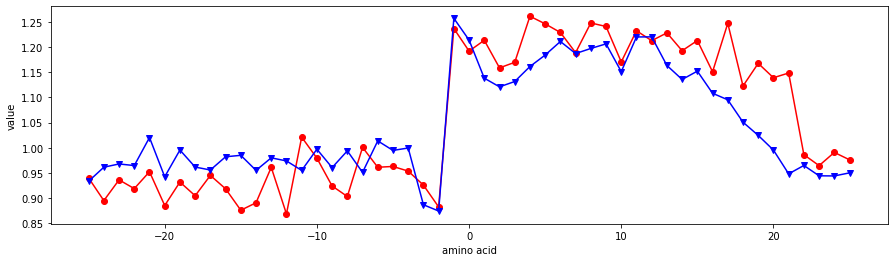

KANM800103


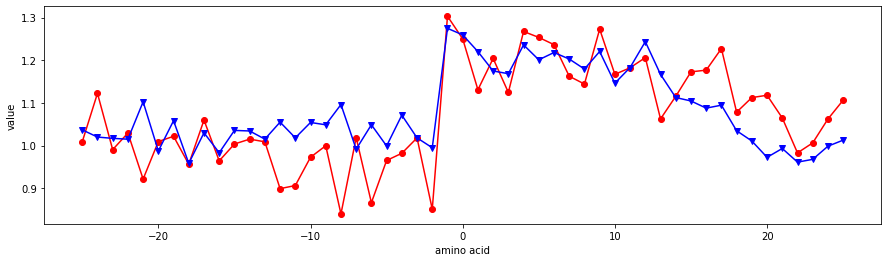

KANM800104


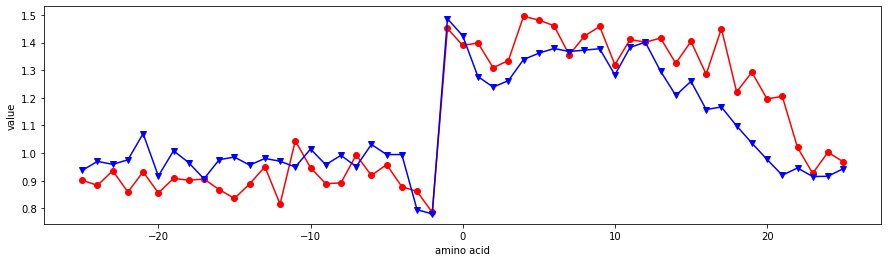

KARP850101


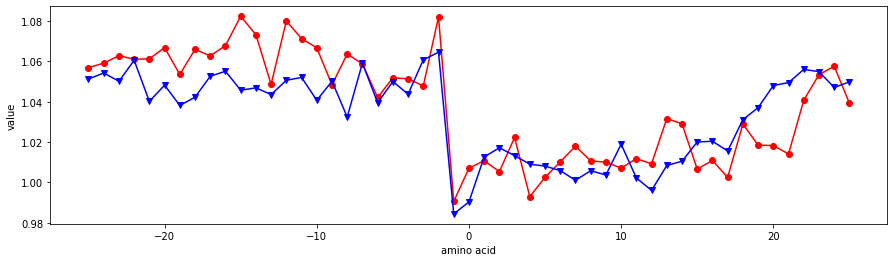

KARP850102


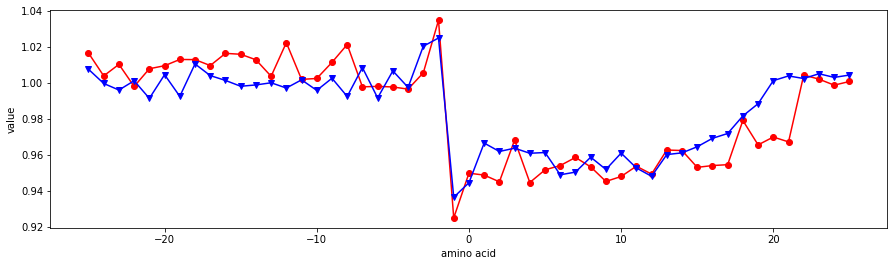

KARP850103


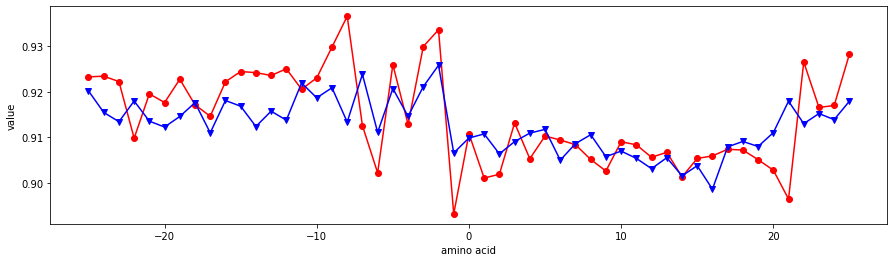

KHAG800101


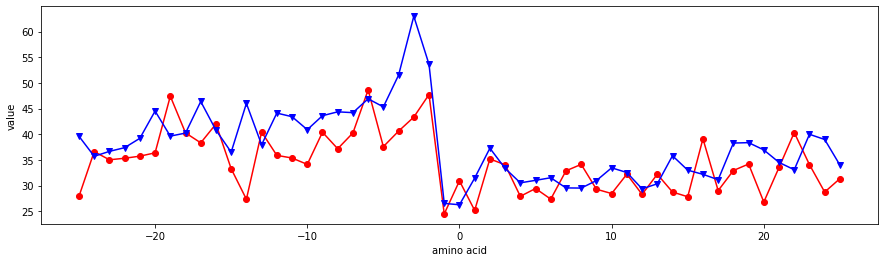

KLEP840101


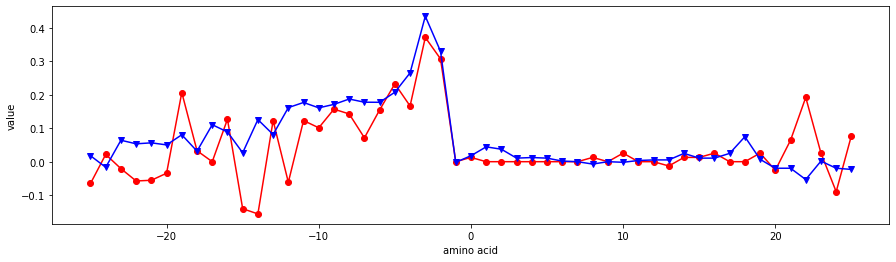

KRIW710101


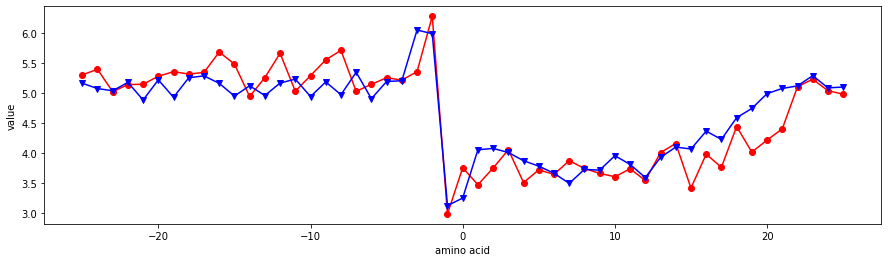

KRIW790101


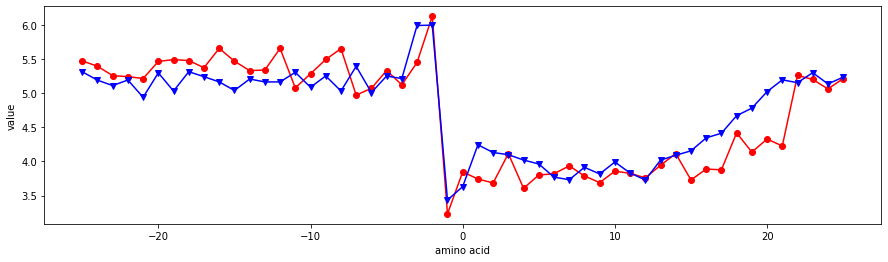

KRIW790102


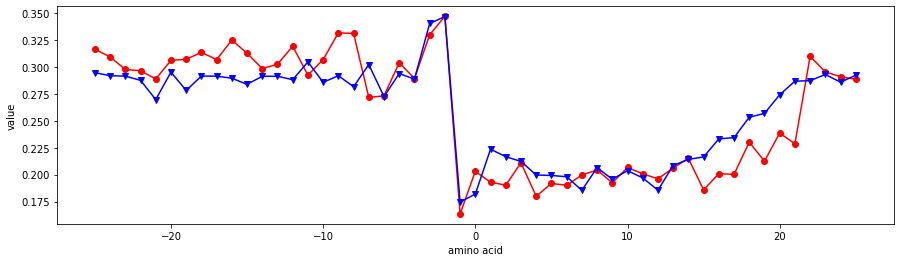

KRIW790103


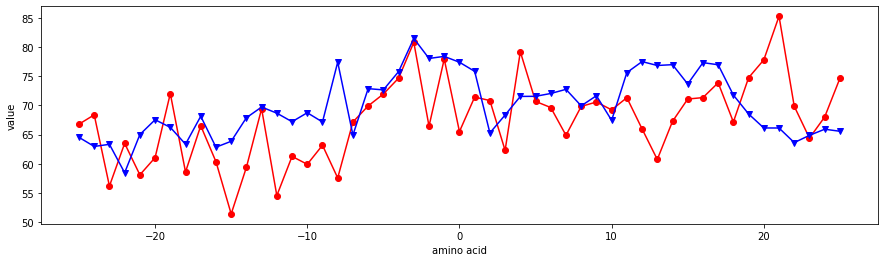

KYTJ820101


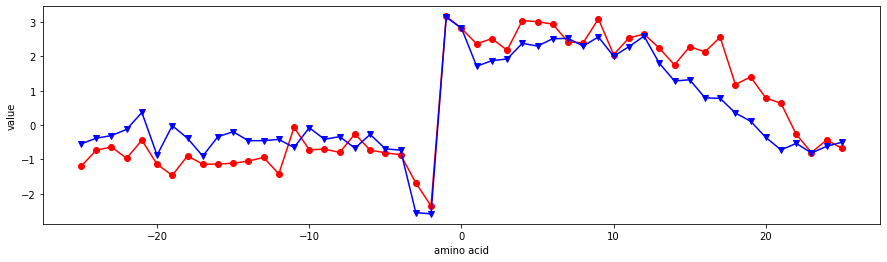

LAWE840101


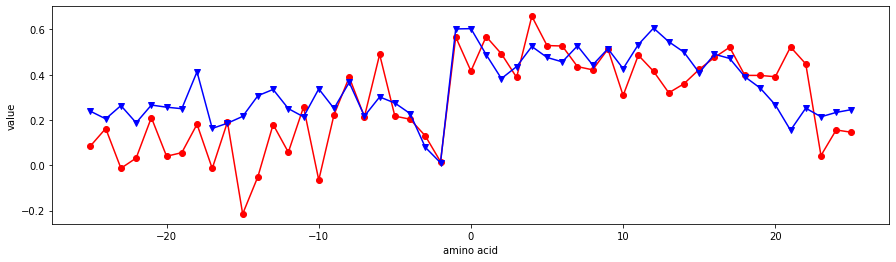

LEVM760101


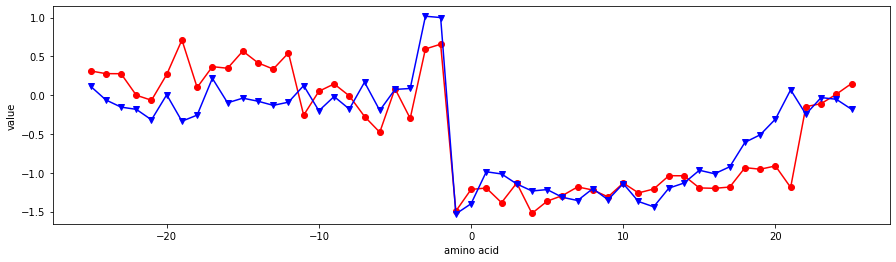

LEVM760102


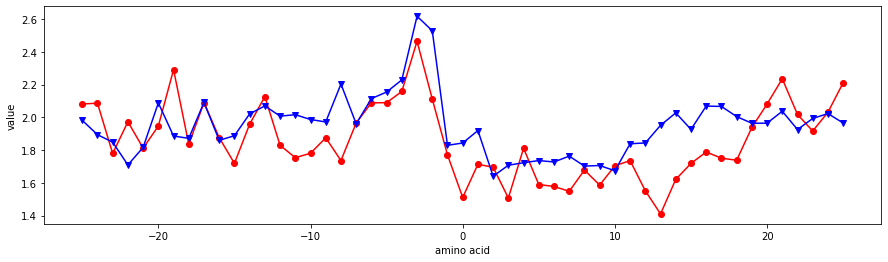

LEVM760103


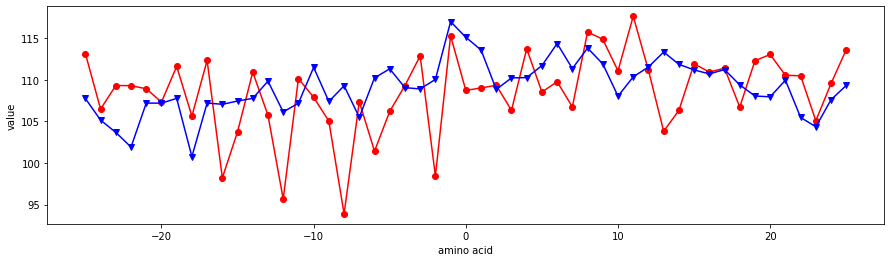

LEVM760104


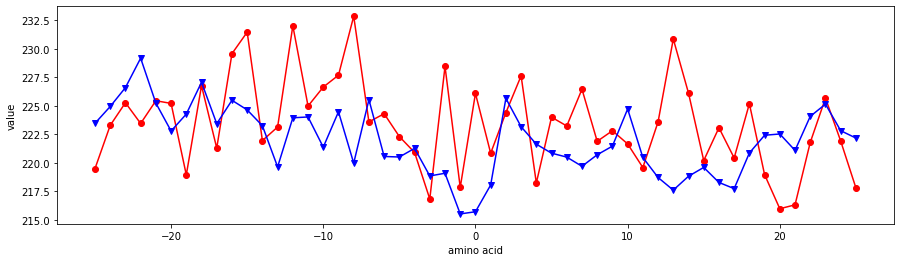

LEVM760105


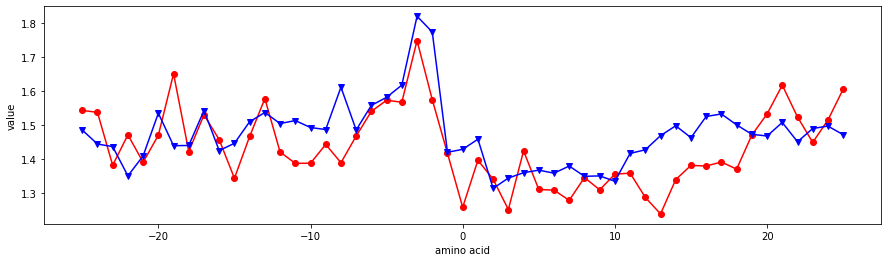

LEVM760106


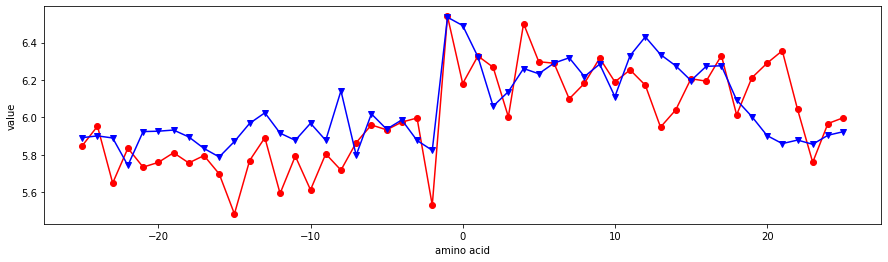

LEVM760107


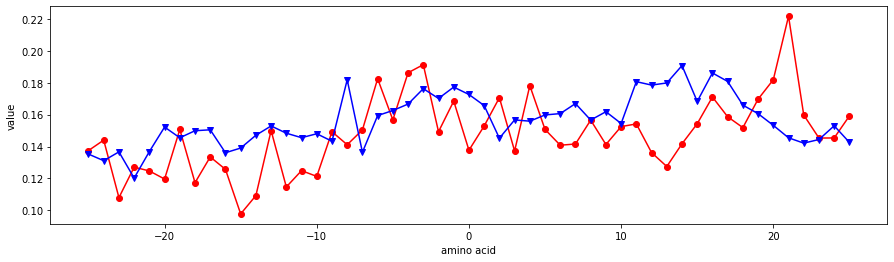

LEVM780101


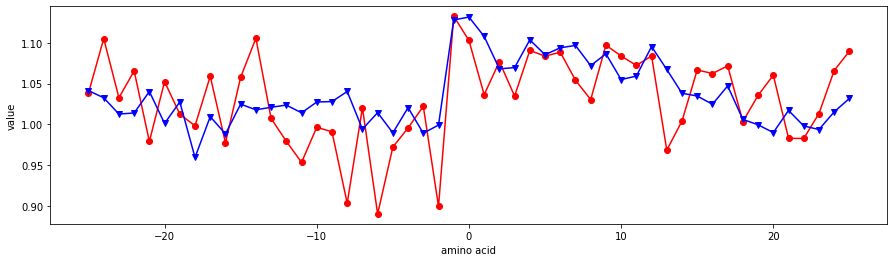

LEVM780102


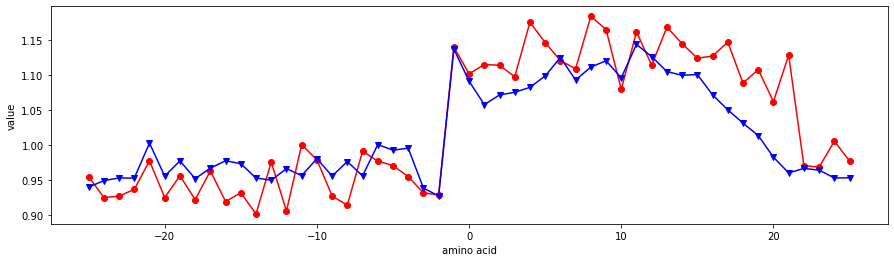

LEVM780103


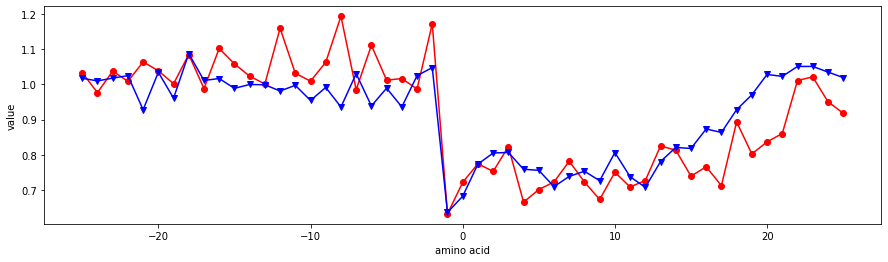

LEVM780104


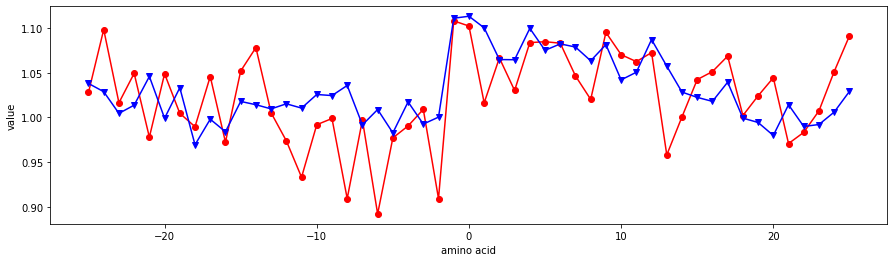

LEVM780105


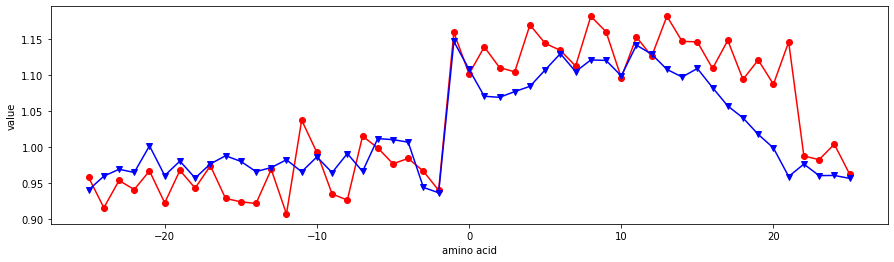

LEVM780106


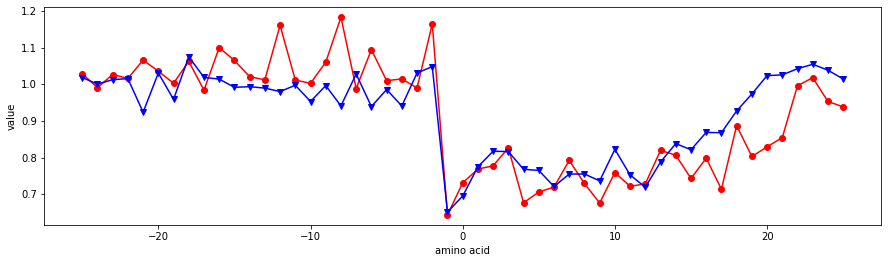

LEWP710101


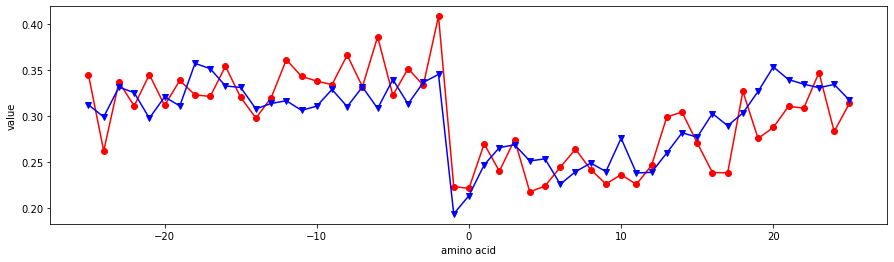

LIFS790101


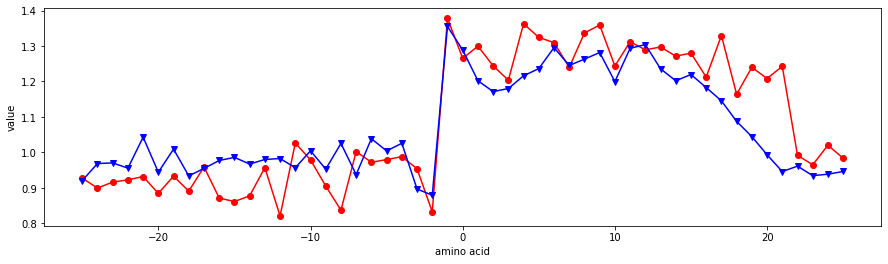

LIFS790102


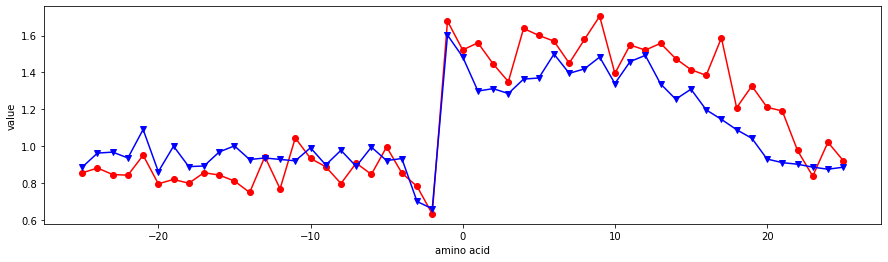

LIFS790103


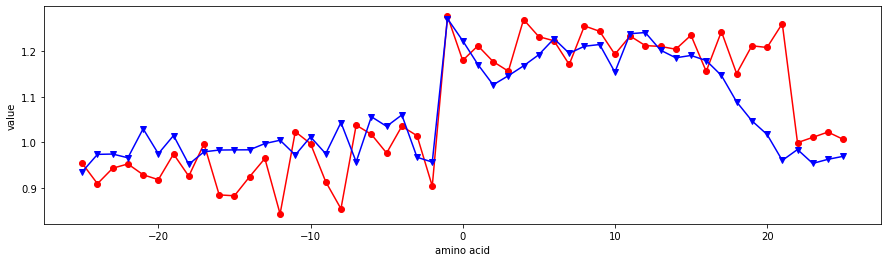

MANP780101


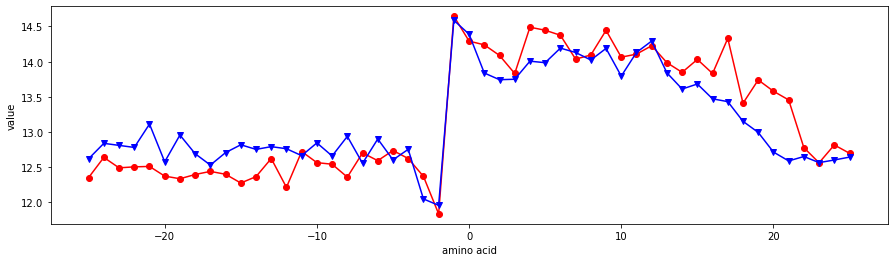

MAXF760101


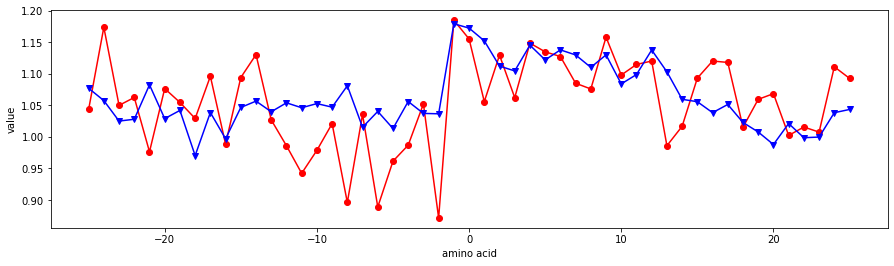

MAXF760102


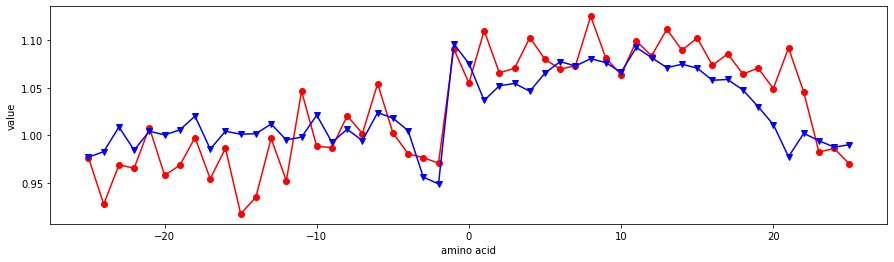

MAXF760103


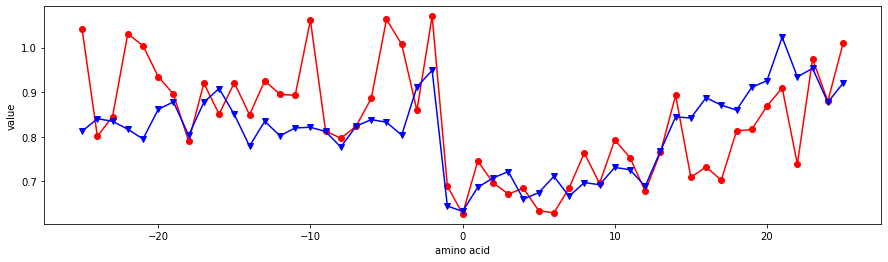

MAXF760104


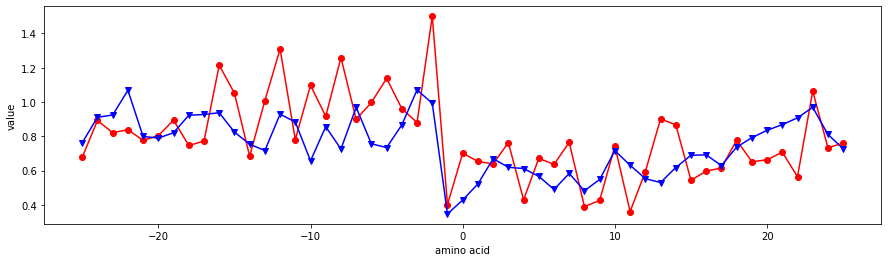

MAXF760105


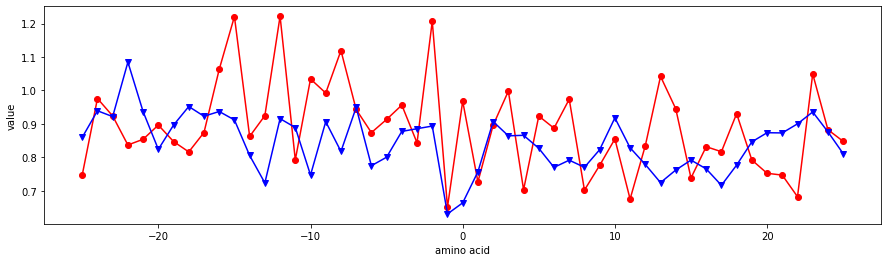

MAXF760106


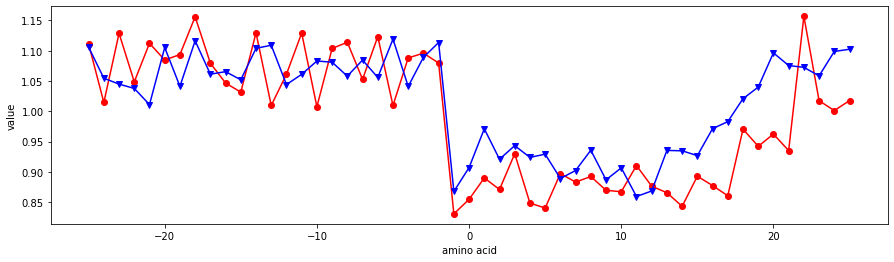

MCMT640101


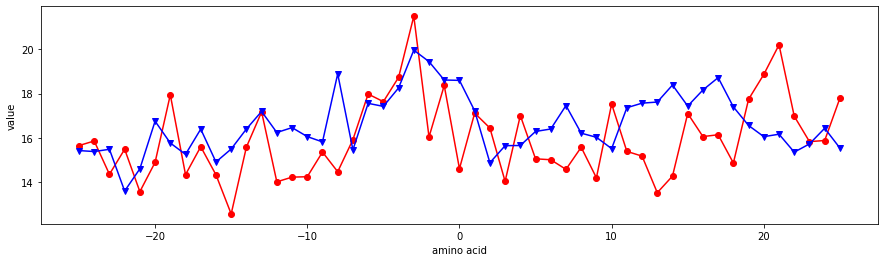

MEEJ800101


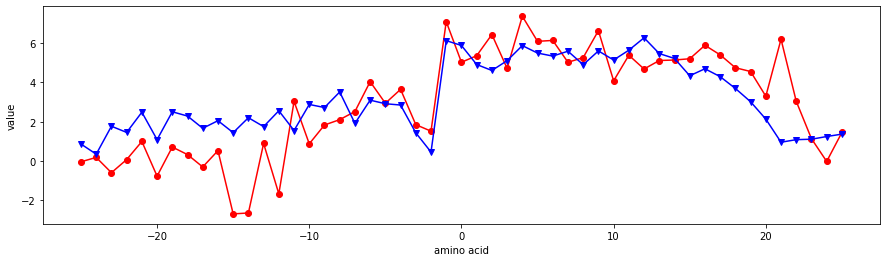

MEEJ800102


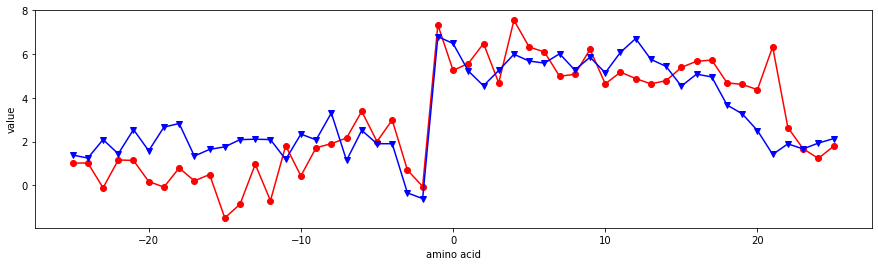

MEEJ810101


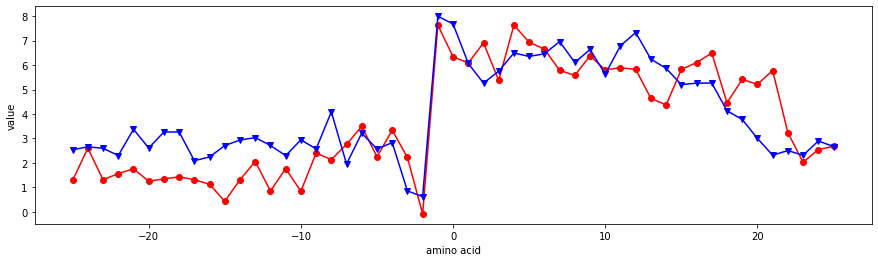

MEEJ810102


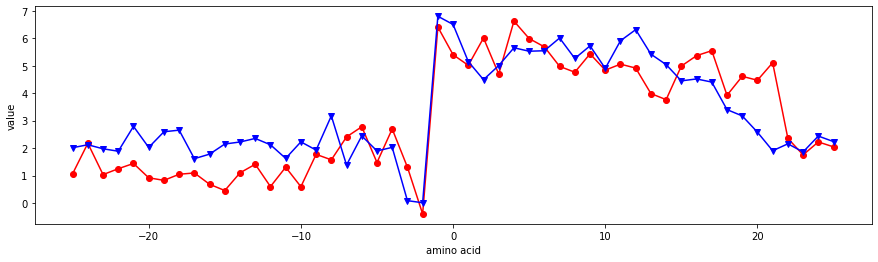

MEIH800101


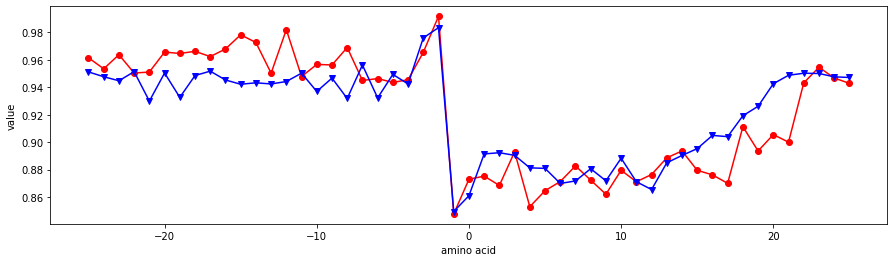

MEIH800102


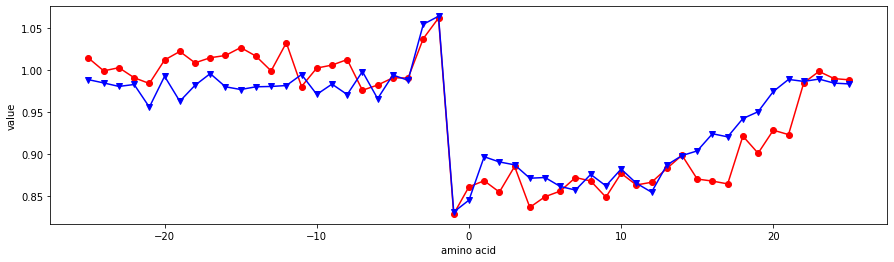

MEIH800103


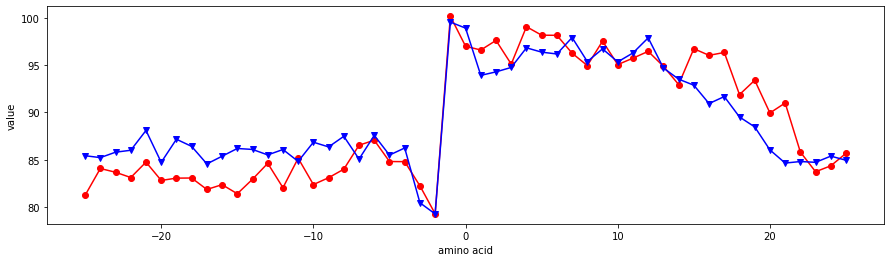

MIYS850101


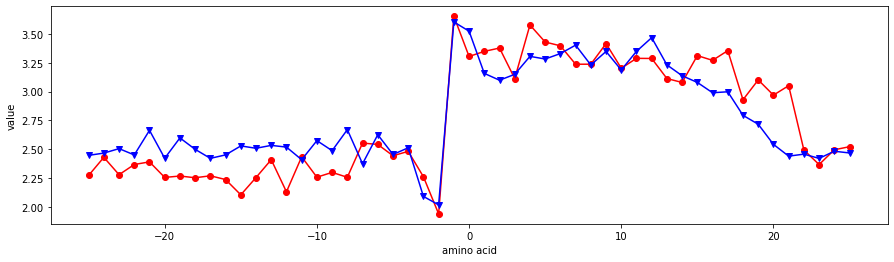

NAGK730101


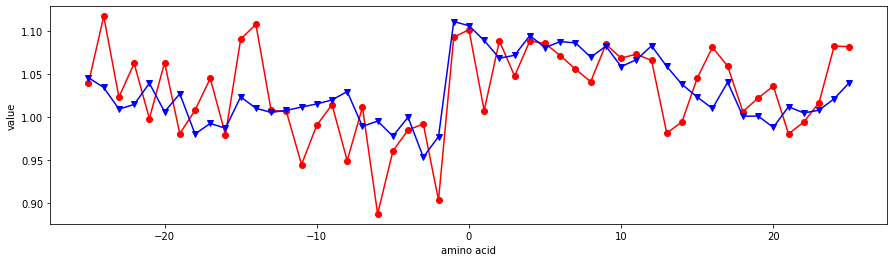

NAGK730102


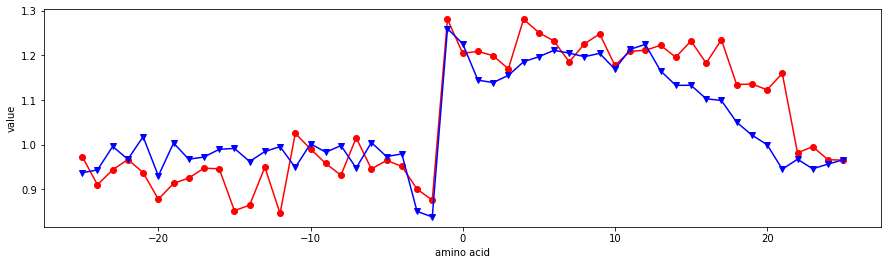

NAGK730103


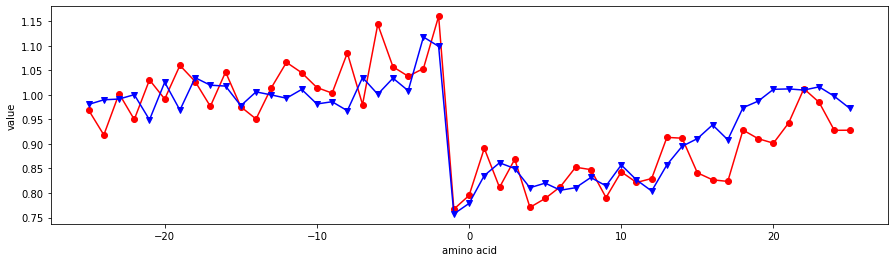

NAKH900101


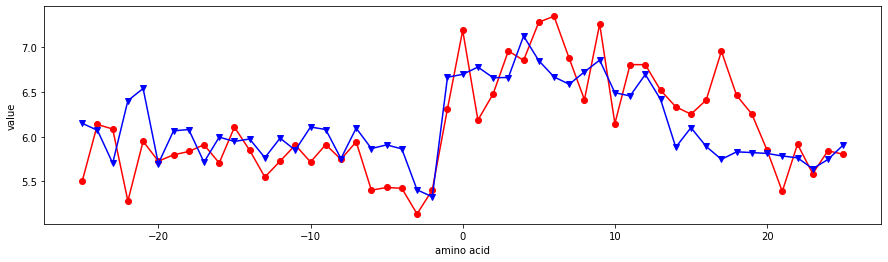

NAKH900102


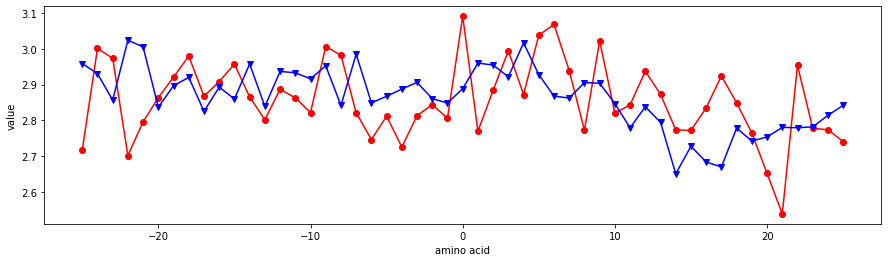

NAKH900103


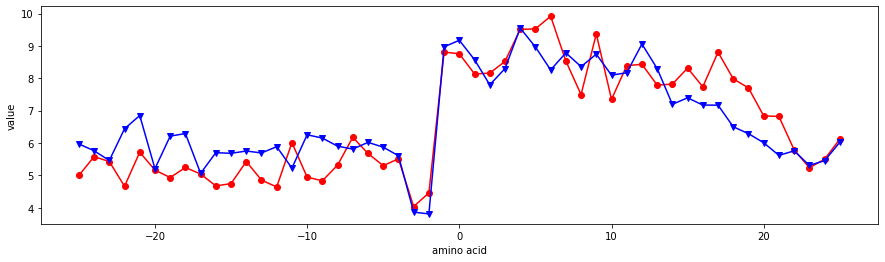

NAKH900104


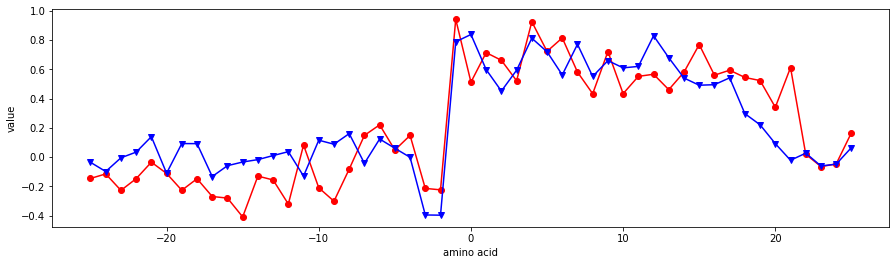

NAKH900105


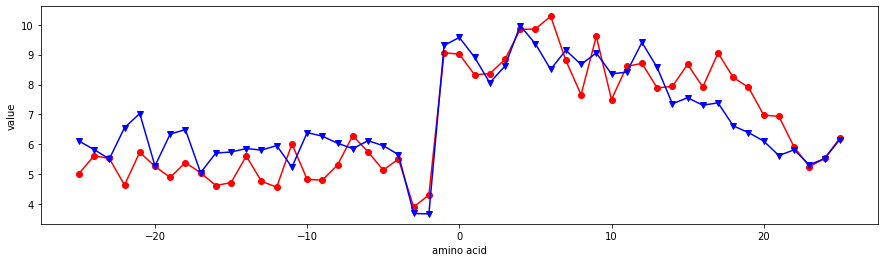

NAKH900106


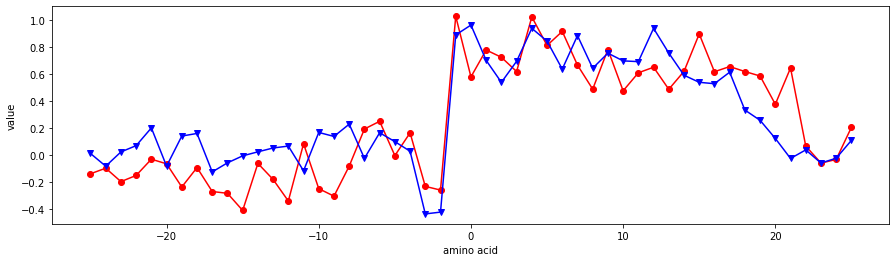

NAKH900107


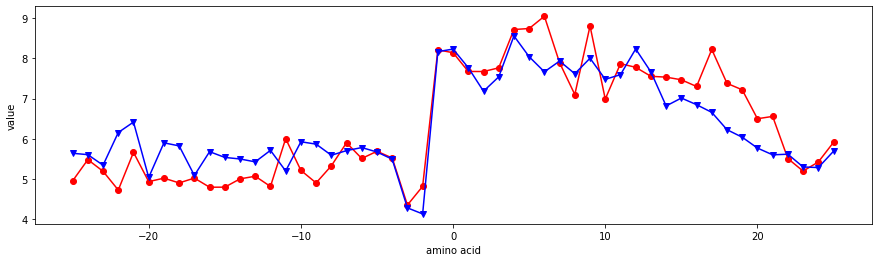

NAKH900108


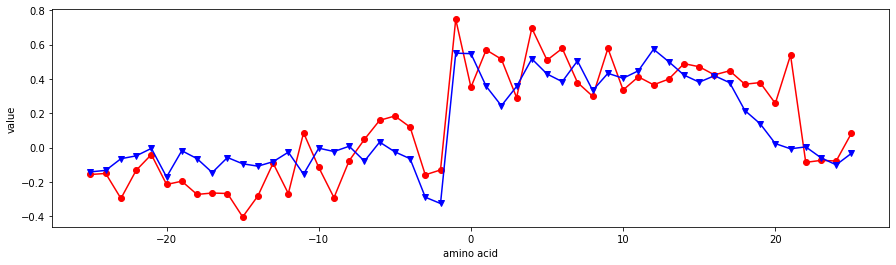

NAKH900109


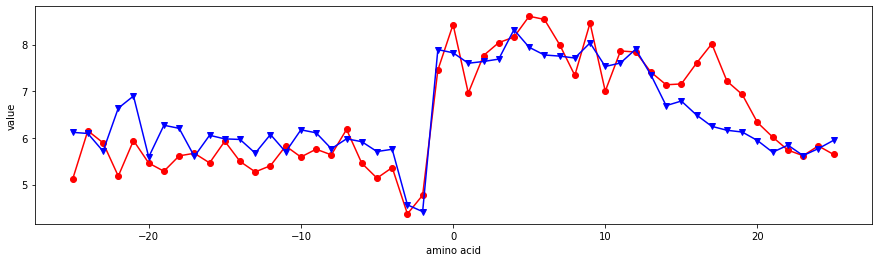

NAKH900110


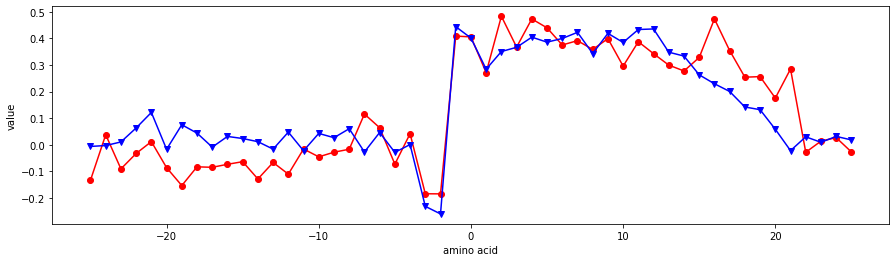

NAKH900111


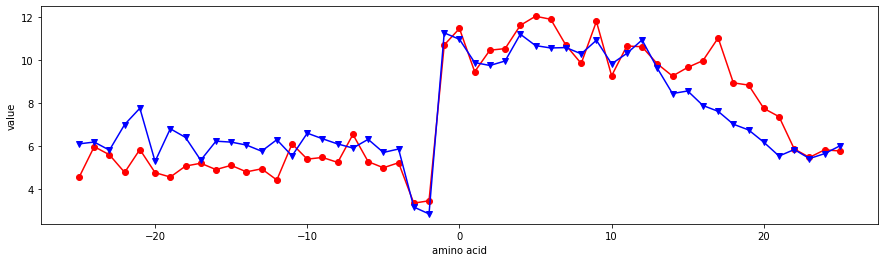

NAKH900112


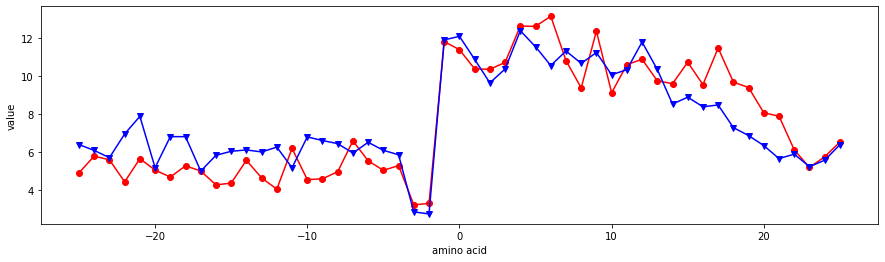

NAKH900113


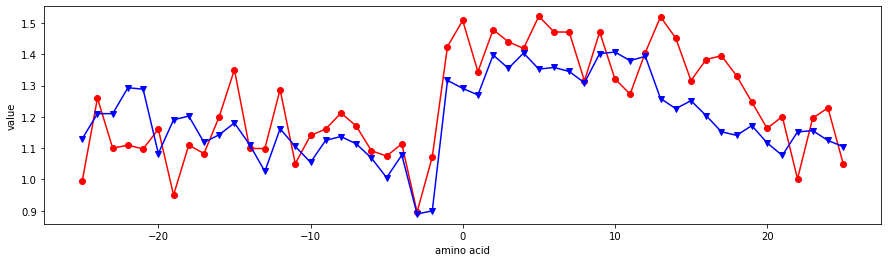

NAKH920101


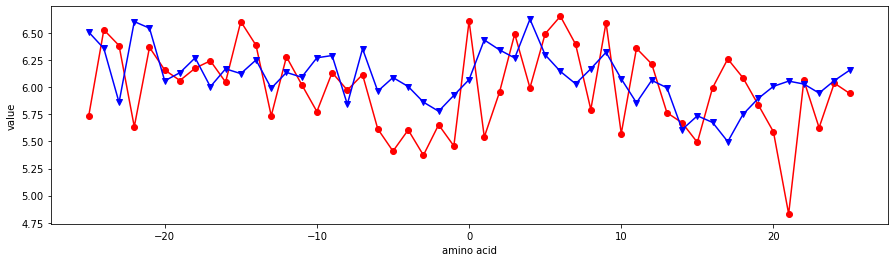

NAKH920102


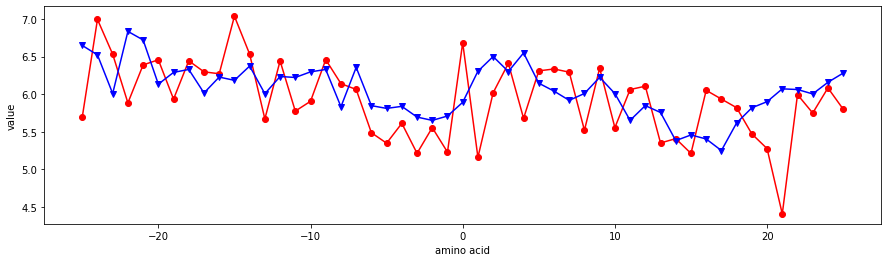

NAKH920103


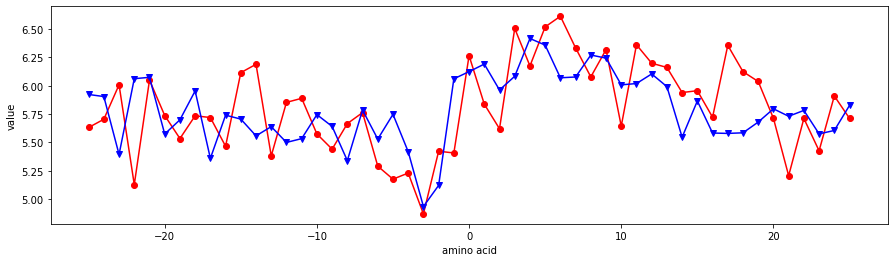

NAKH920104


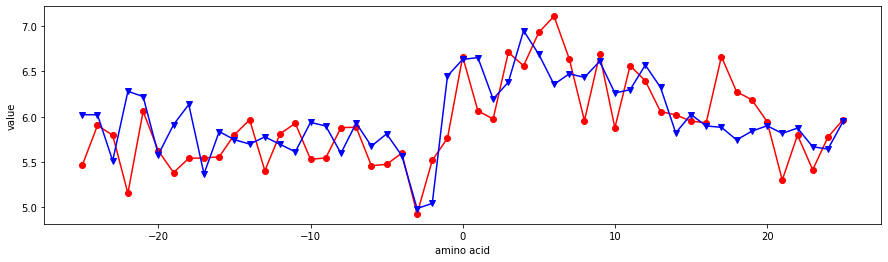

NAKH920105


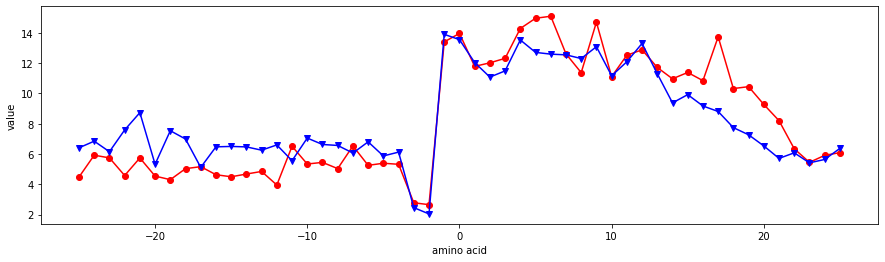

NAKH920106


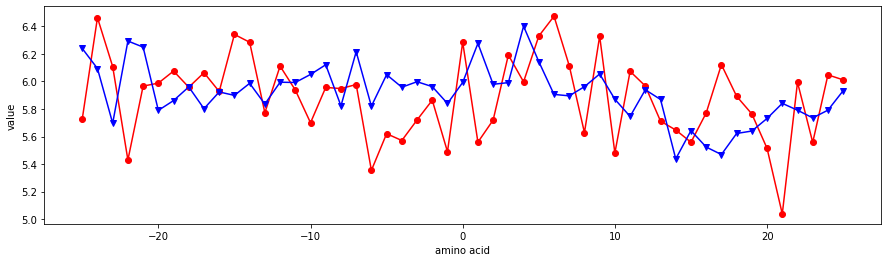

NAKH920107


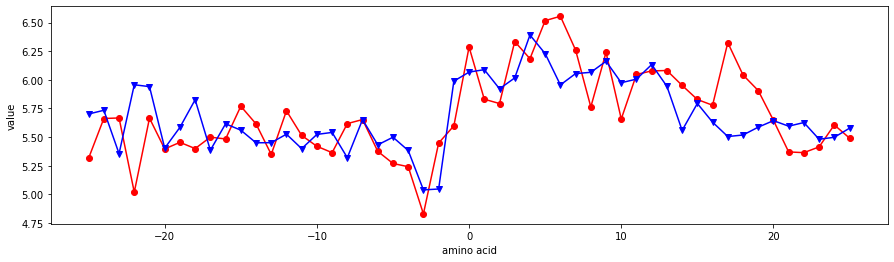

NAKH920108


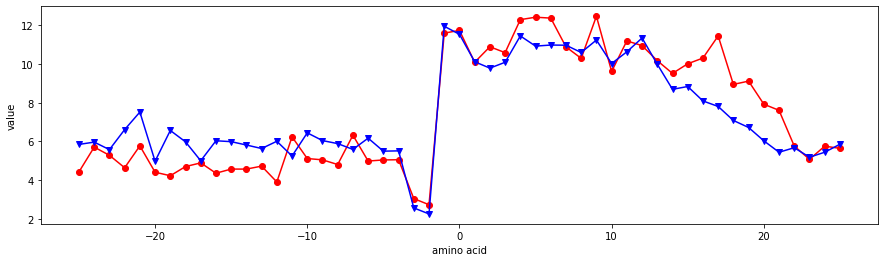

NISK800101


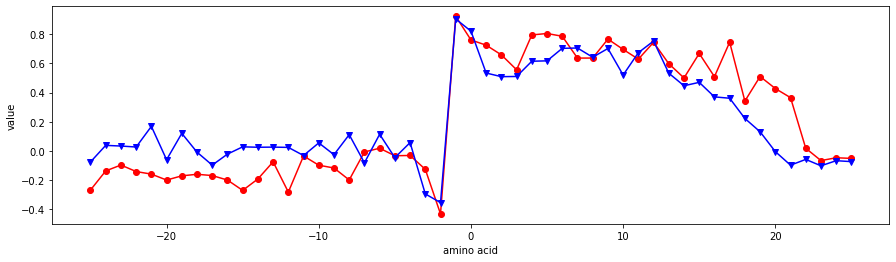

NISK860101


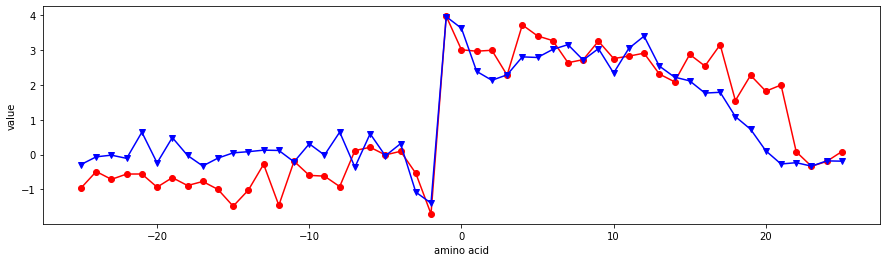

NOZY710101


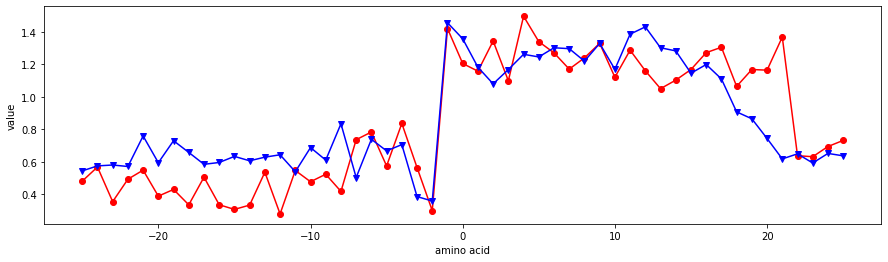

OOBM770101


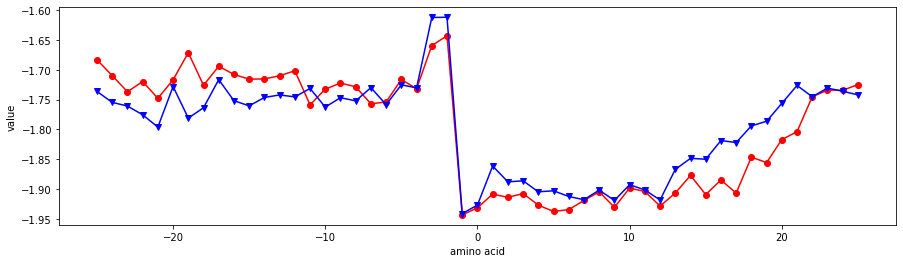

OOBM770102


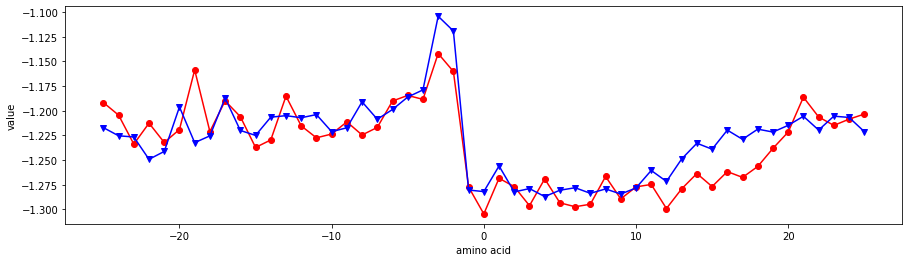

OOBM770103


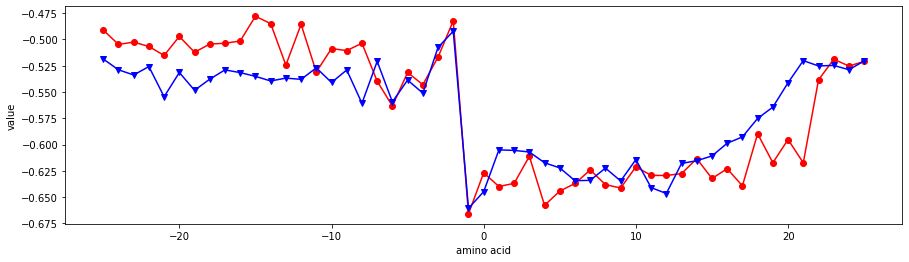

OOBM770104


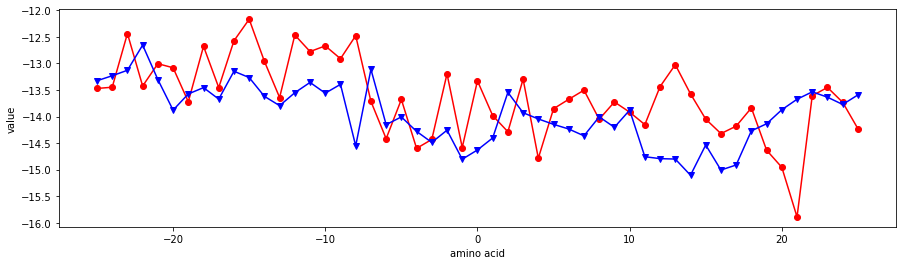

OOBM770105


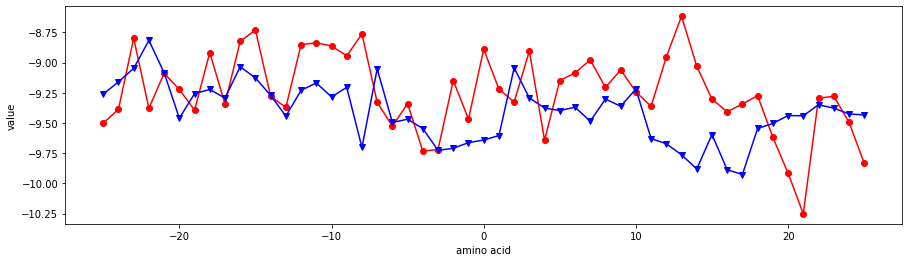

OOBM850101


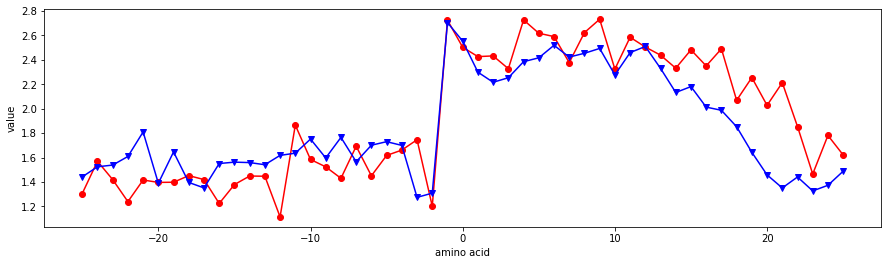

OOBM850102


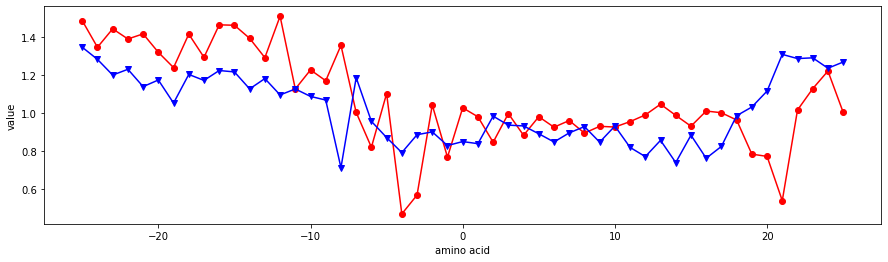

OOBM850103


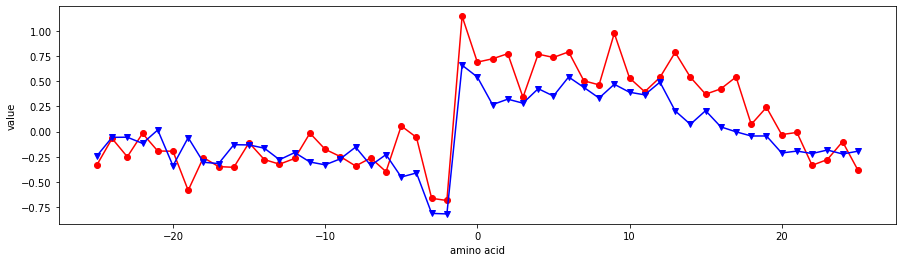

OOBM850104


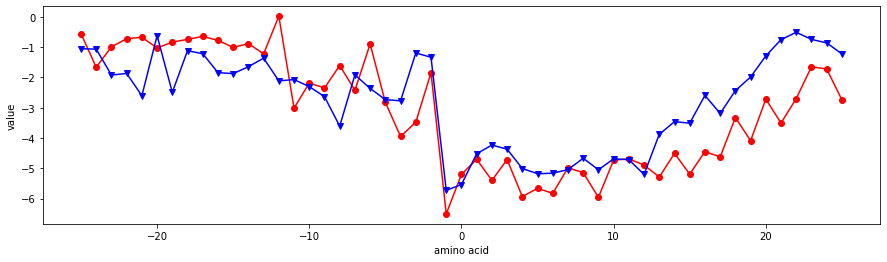

OOBM850105


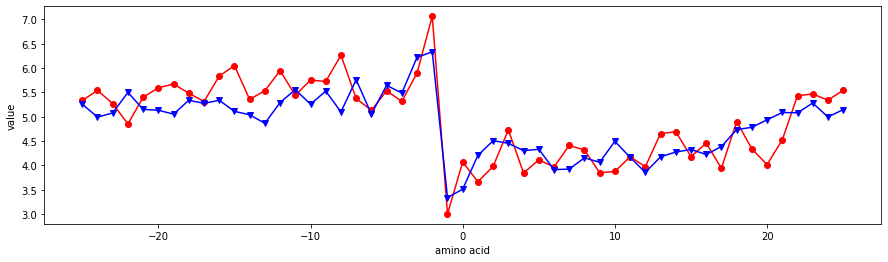

PALJ810101


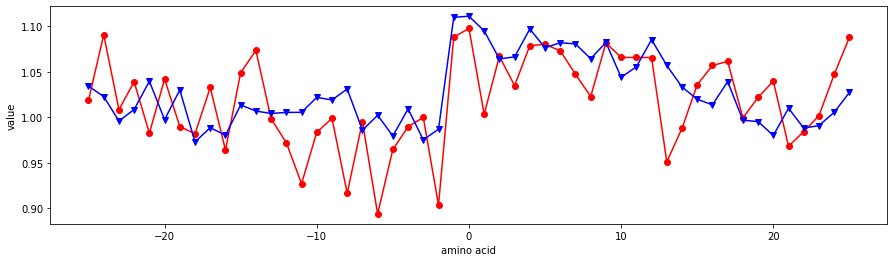

PALJ810102


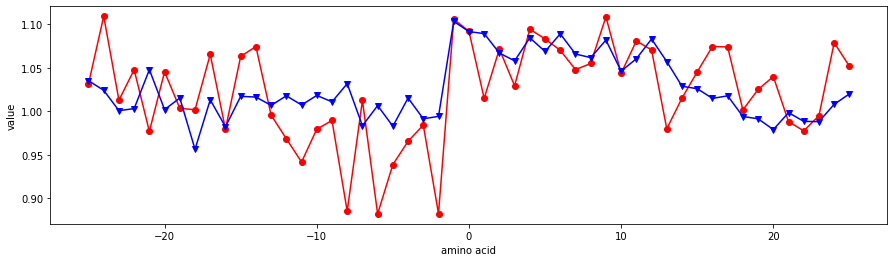

PALJ810103


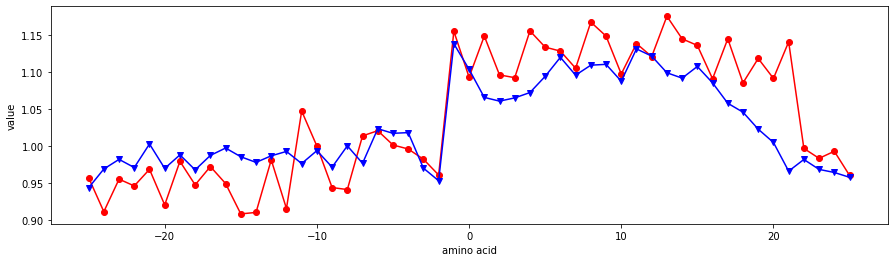

PALJ810104


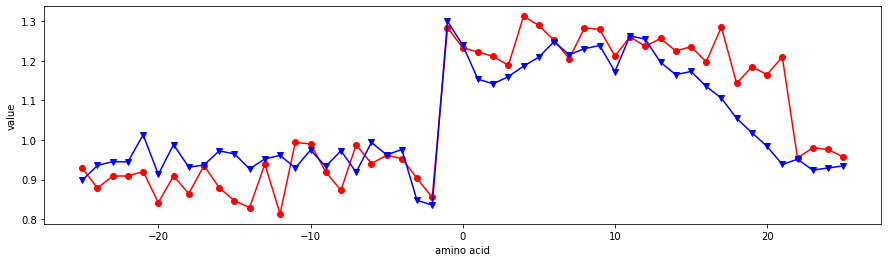

PALJ810105


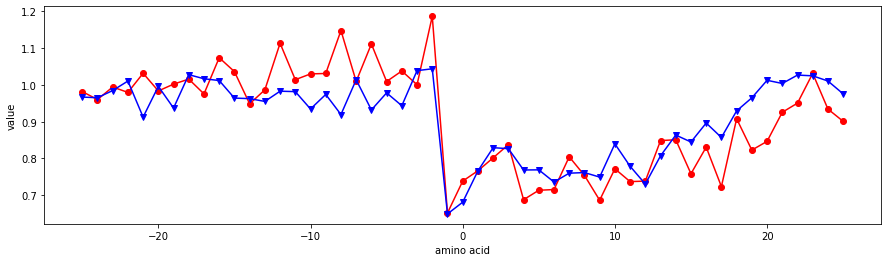

PALJ810106


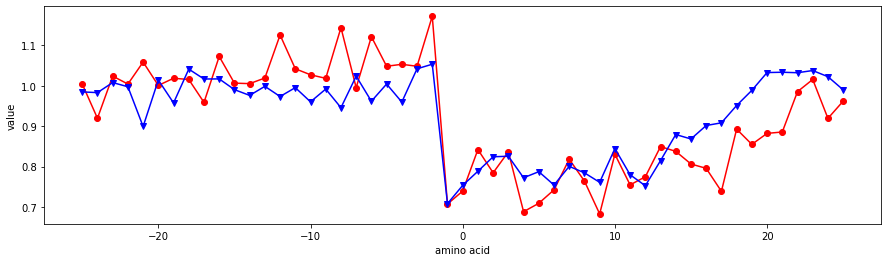

PALJ810107


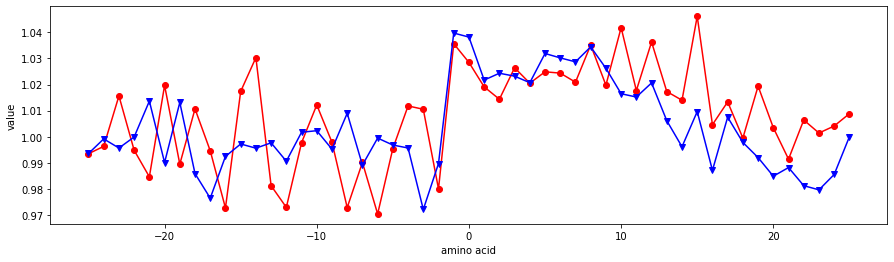

PALJ810108


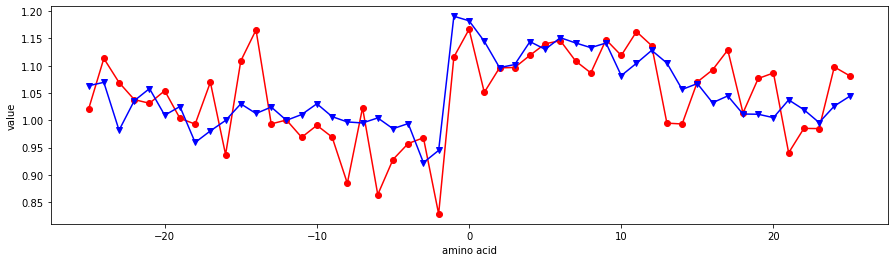

PALJ810109


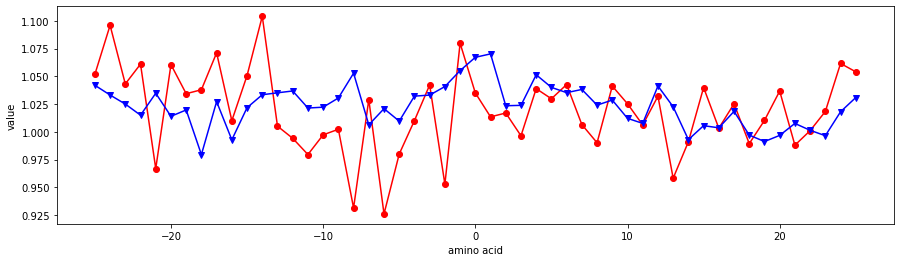

PALJ810110


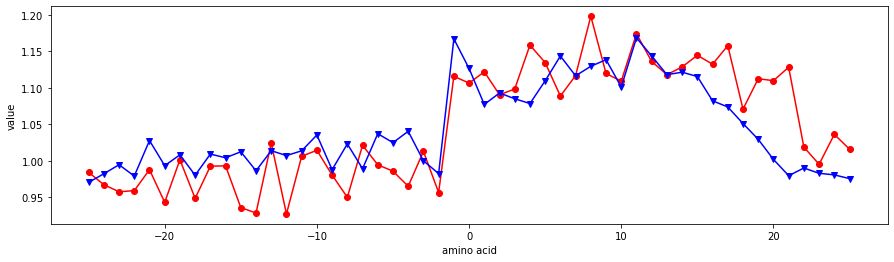

PALJ810111


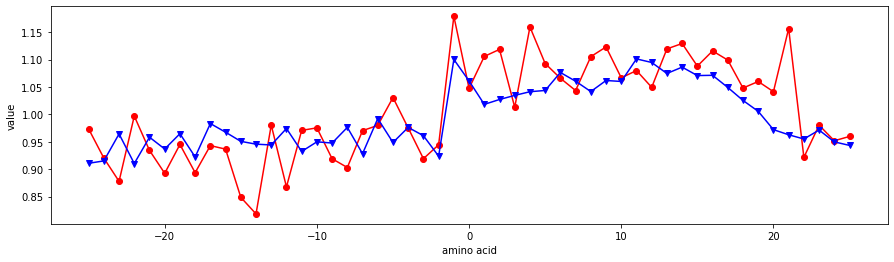

PALJ810112


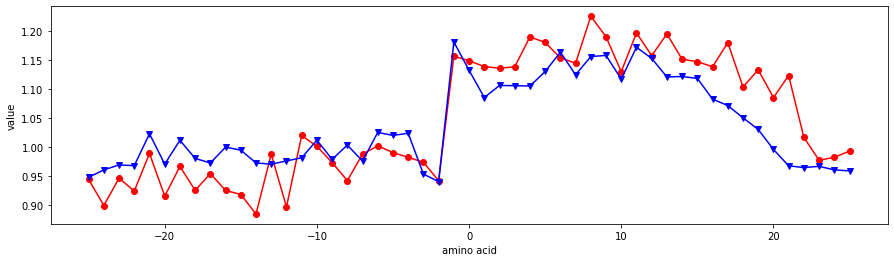

PALJ810113


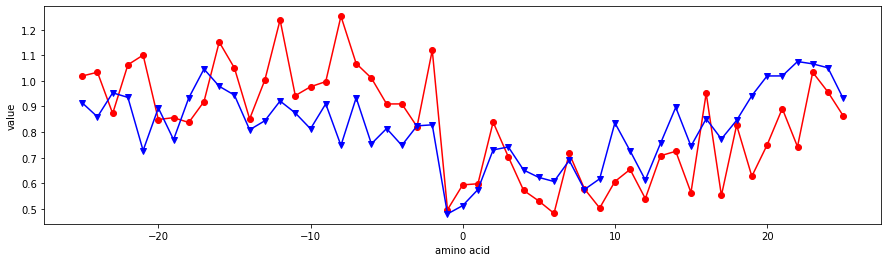

PALJ810114


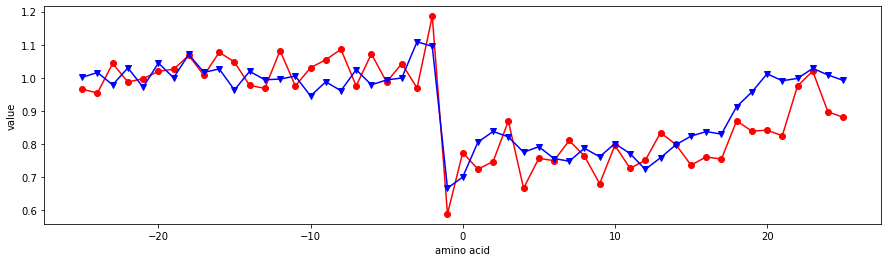

PALJ810115


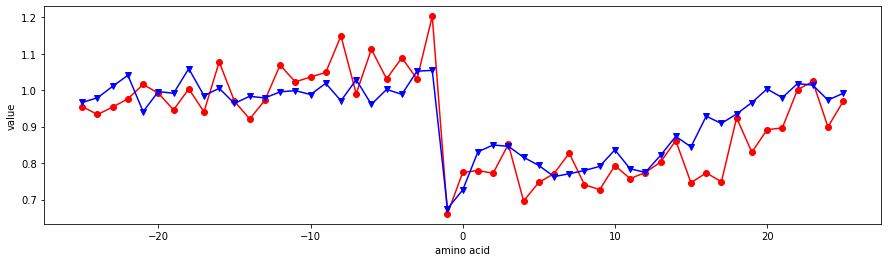

PALJ810116


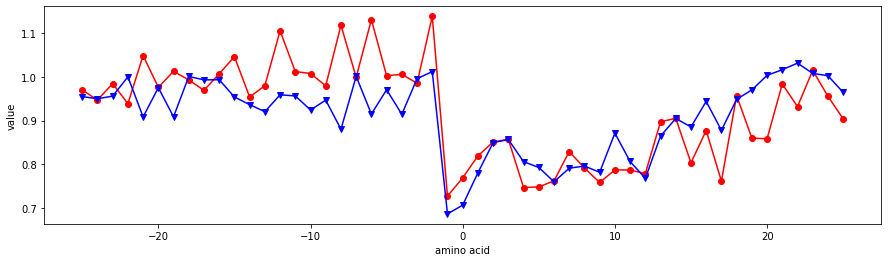

PARJ860101


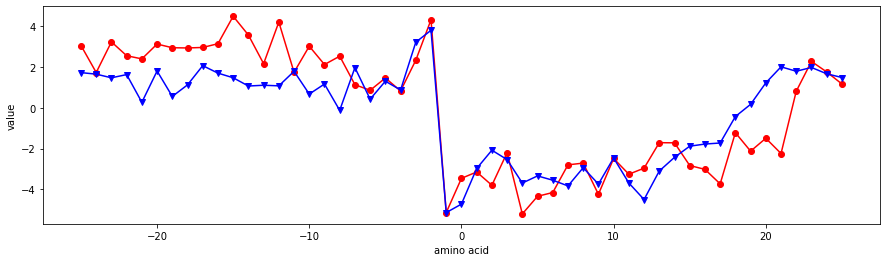

PLIV810101


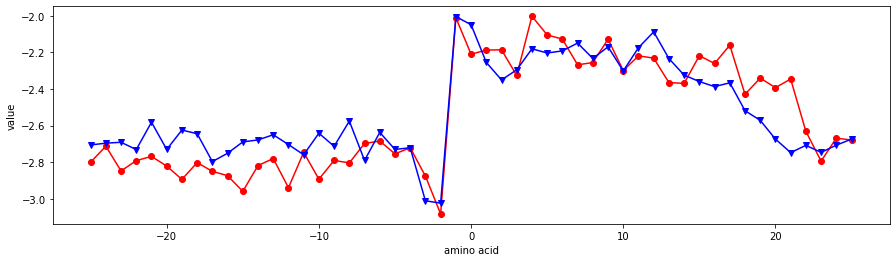

PONP800101


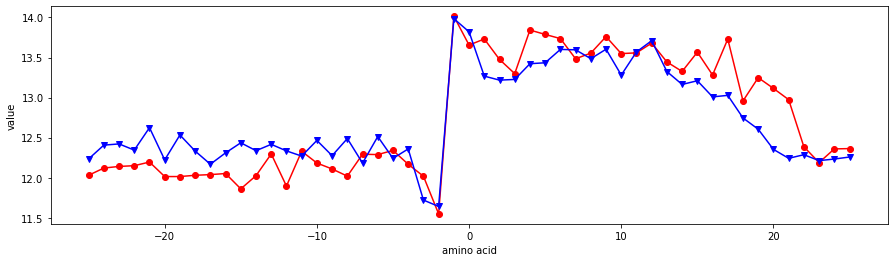

PONP800102


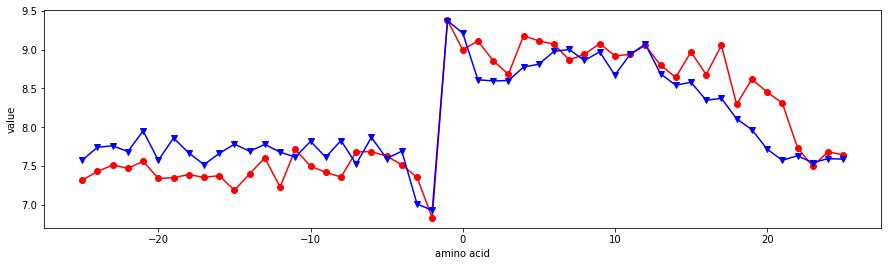

PONP800103


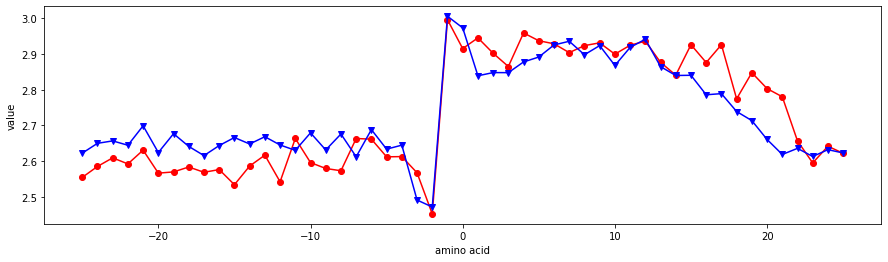

PONP800104


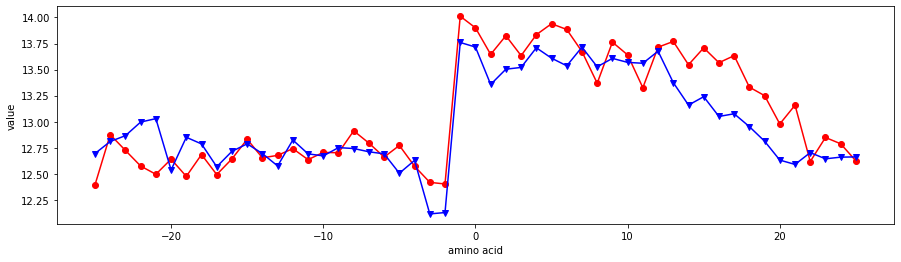

PONP800105


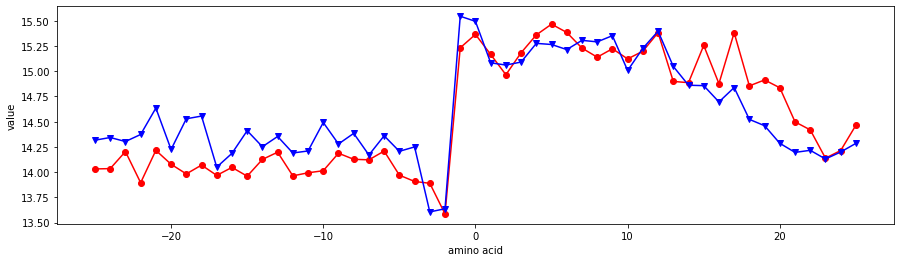

PONP800106


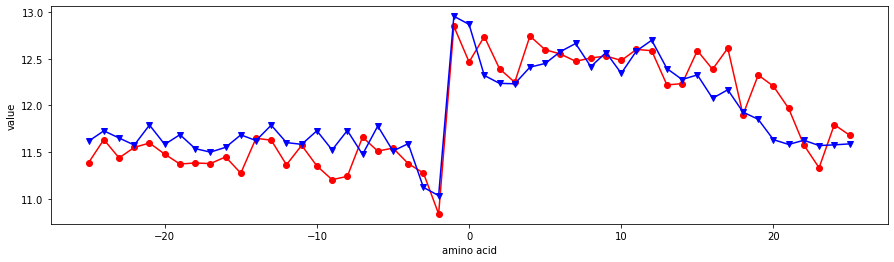

PONP800107


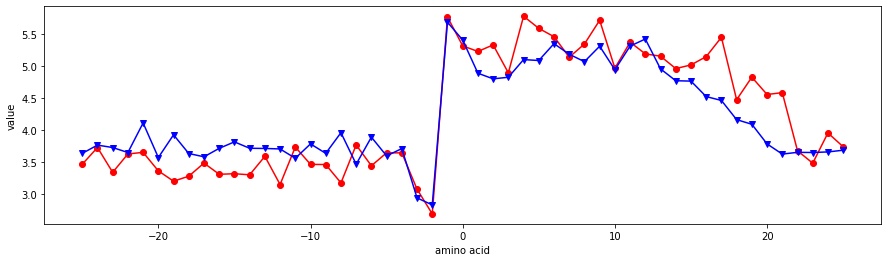

PONP800108


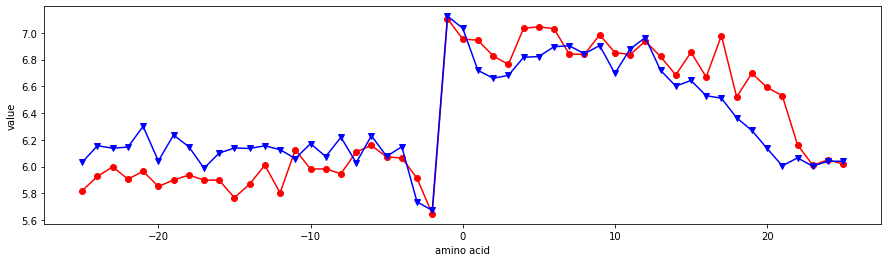

PRAM820101


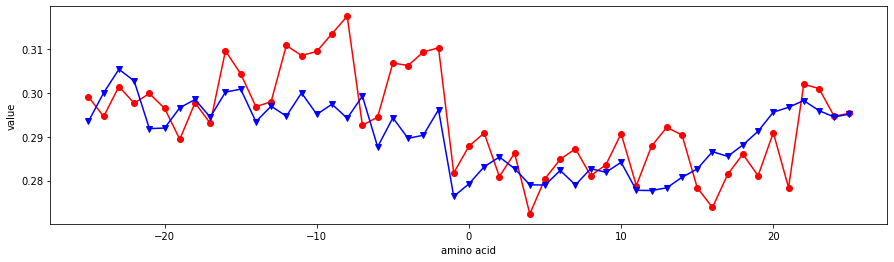

PRAM820102


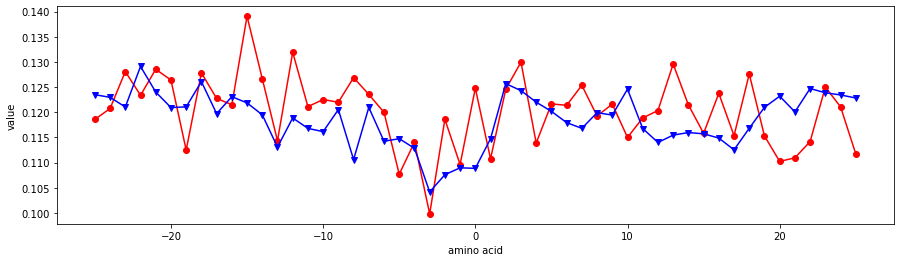

PRAM820103


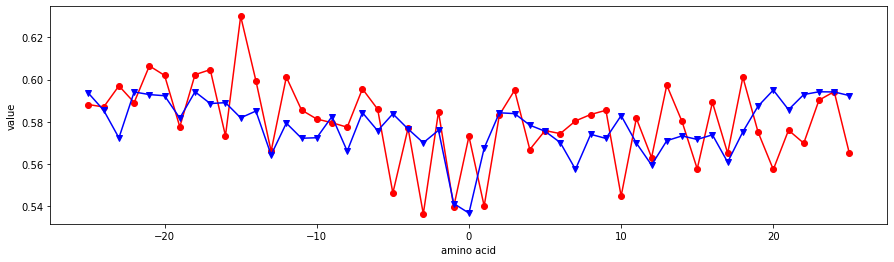

PRAM900101


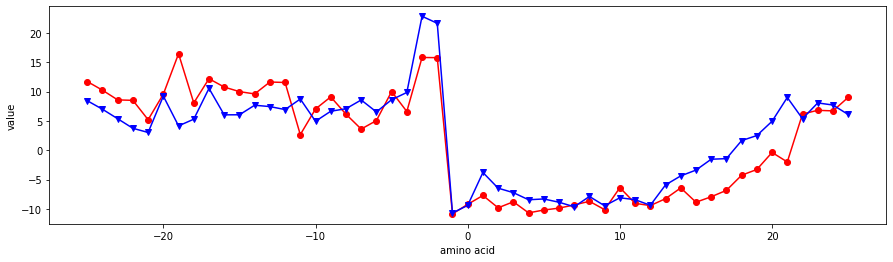

PRAM900102


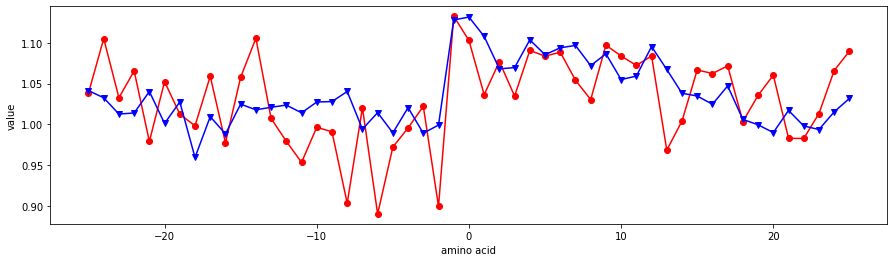

PRAM900103


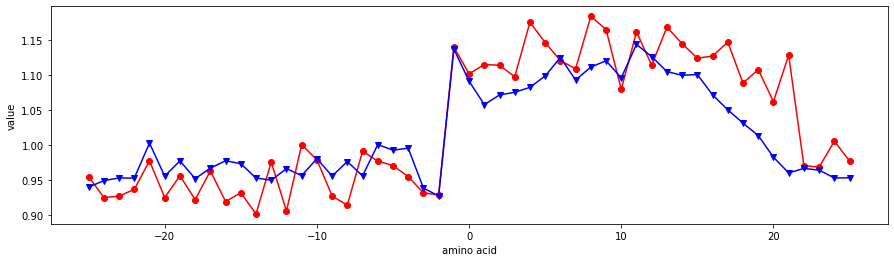

PRAM900104


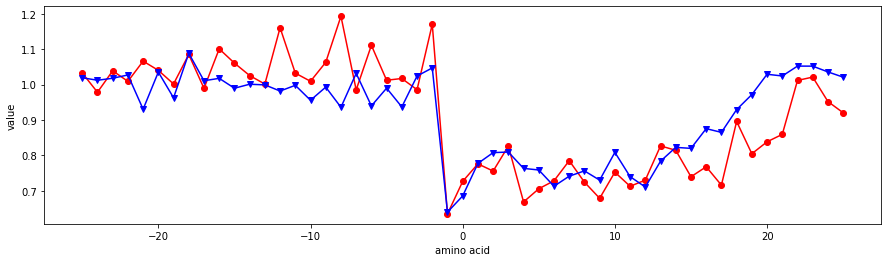

PTIO830101


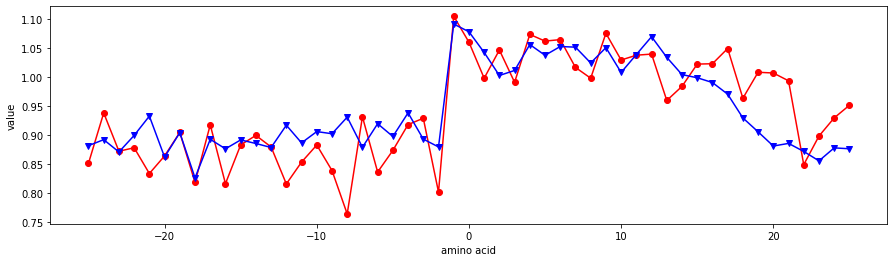

PTIO830102


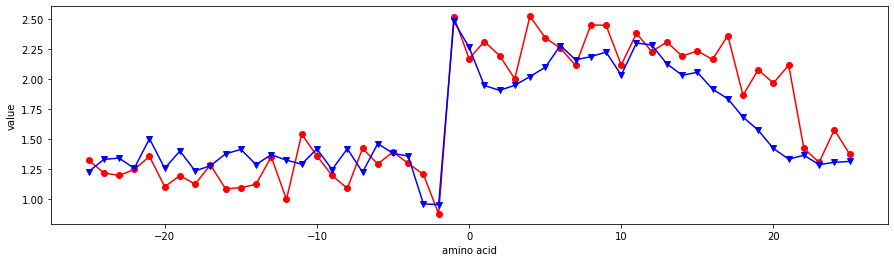

QIAN880101


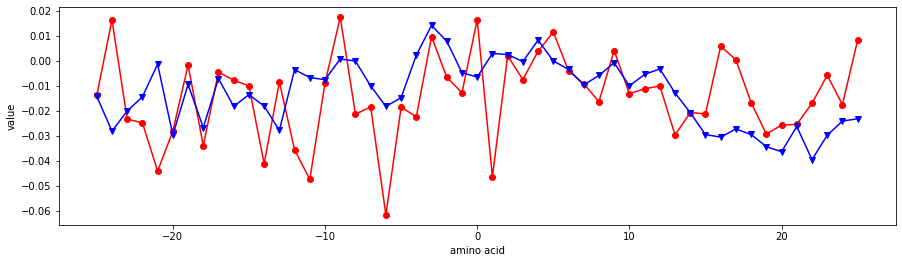

QIAN880102


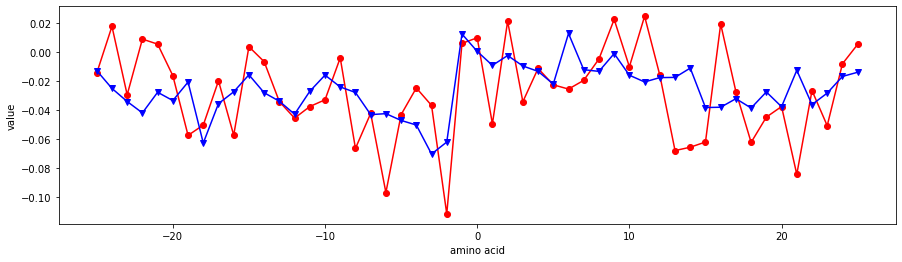

QIAN880103


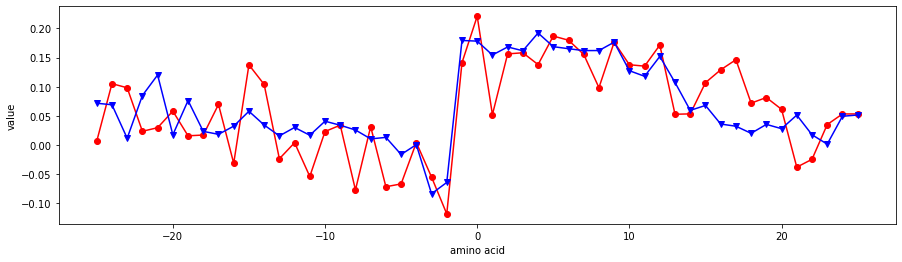

QIAN880104


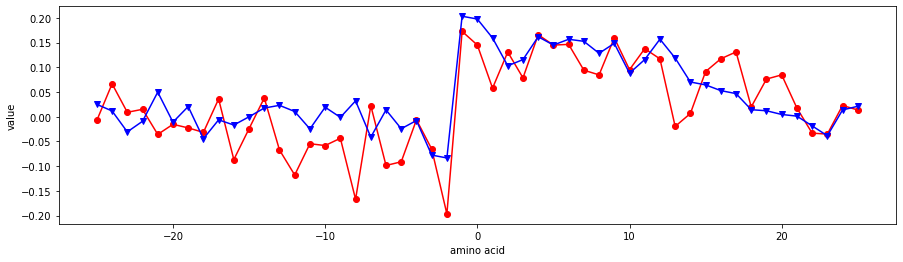

QIAN880105


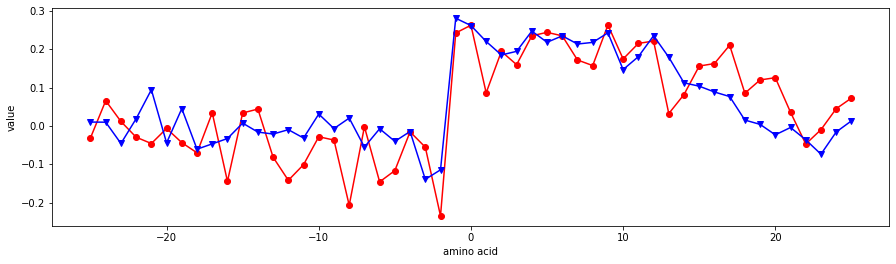

QIAN880106


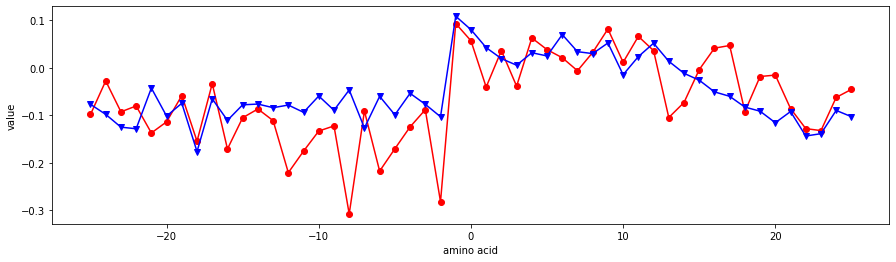

QIAN880107


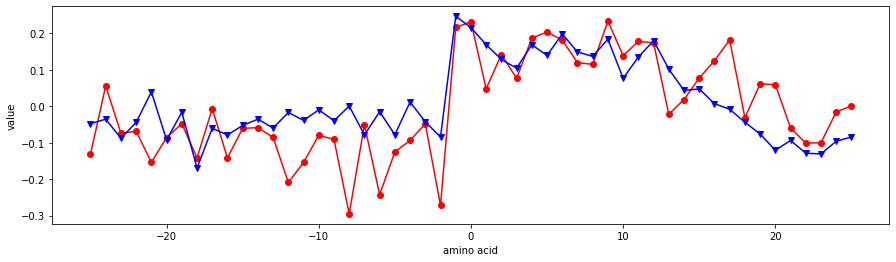

QIAN880108


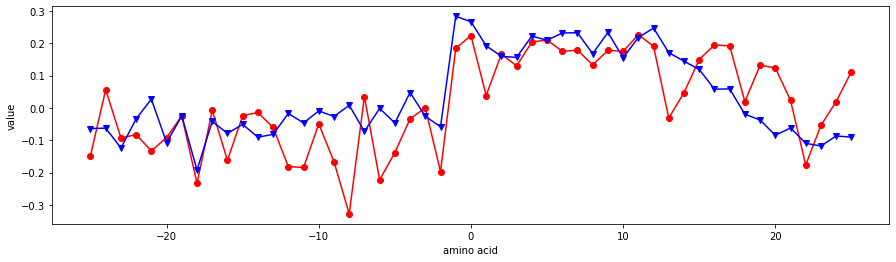

QIAN880109


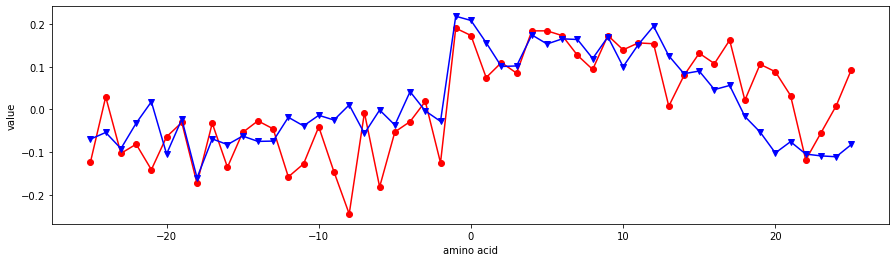

QIAN880110


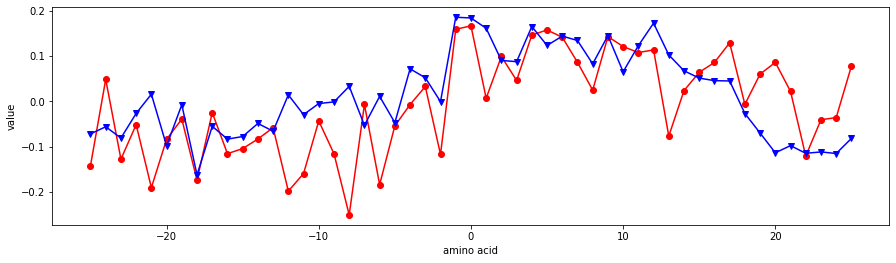

QIAN880111


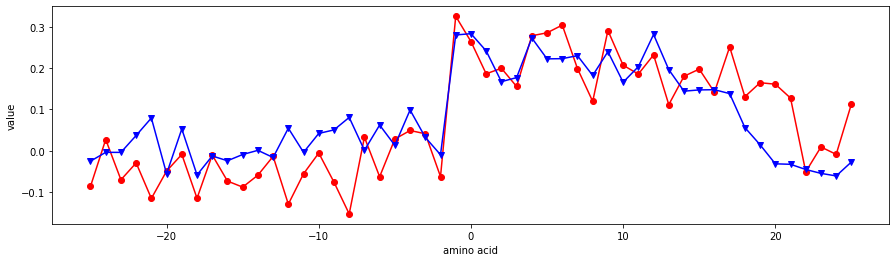

QIAN880112


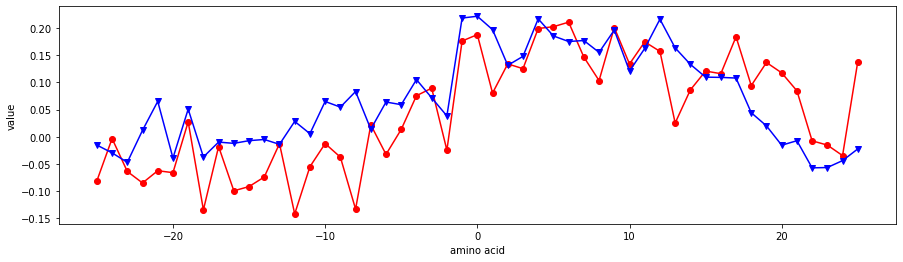

QIAN880113


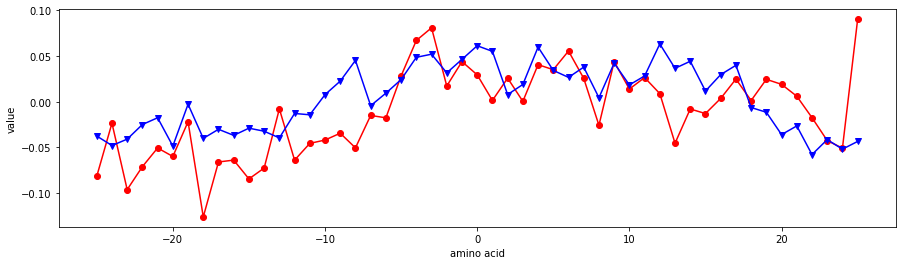

QIAN880114


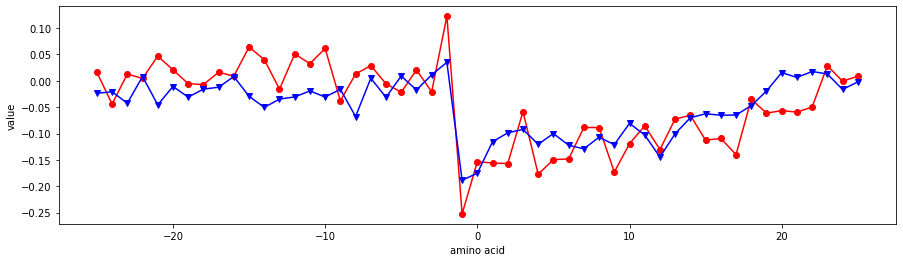

QIAN880115


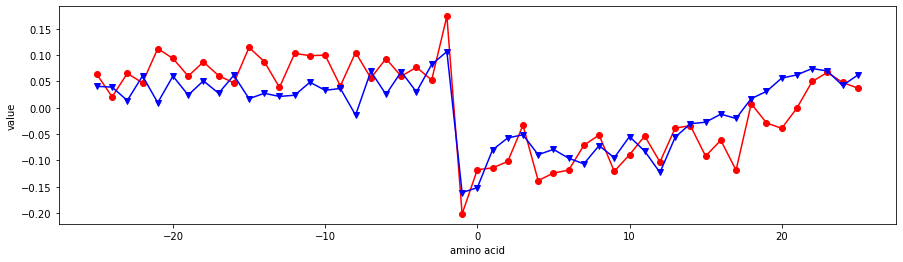

QIAN880116


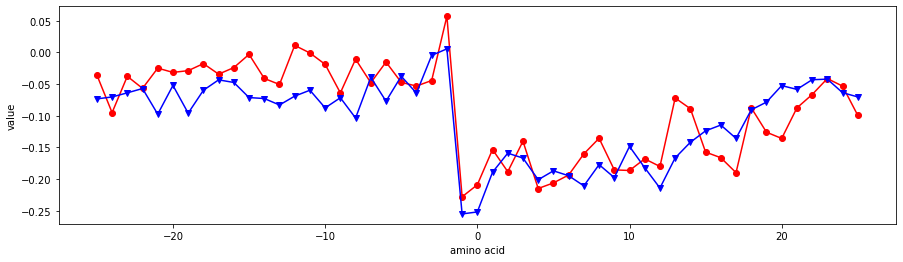

QIAN880117


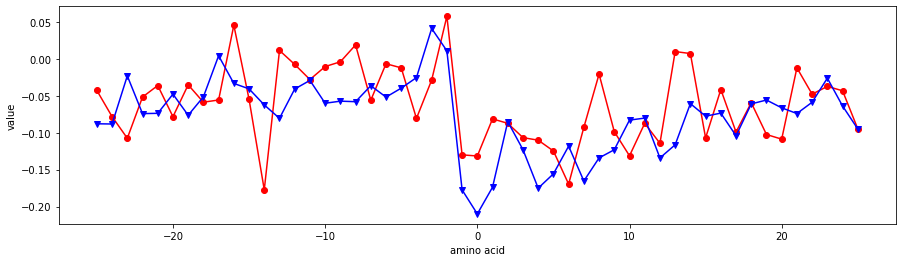

QIAN880118


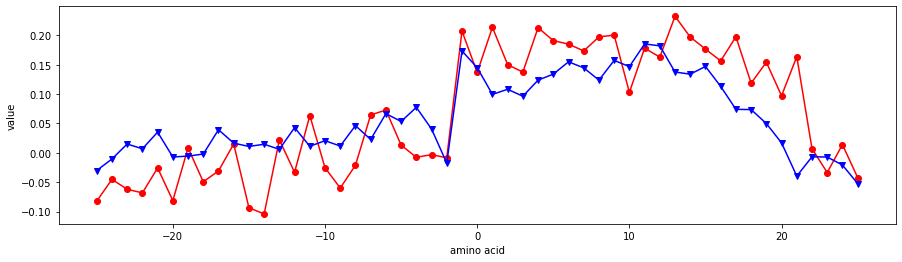

QIAN880119


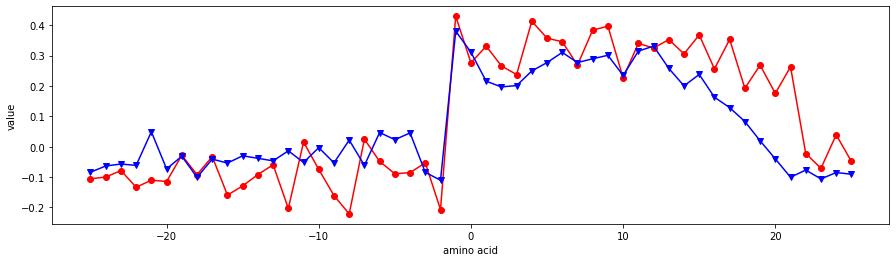

QIAN880120


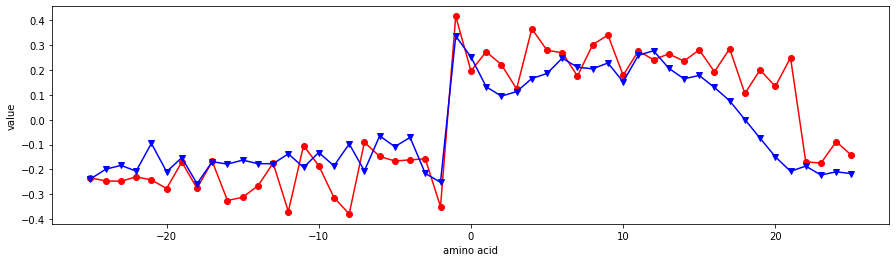

QIAN880121


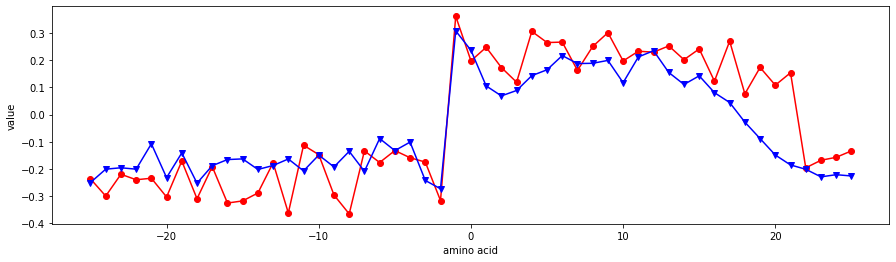

QIAN880122


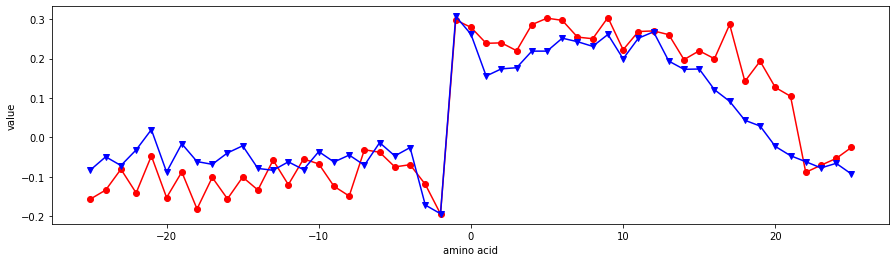

QIAN880123


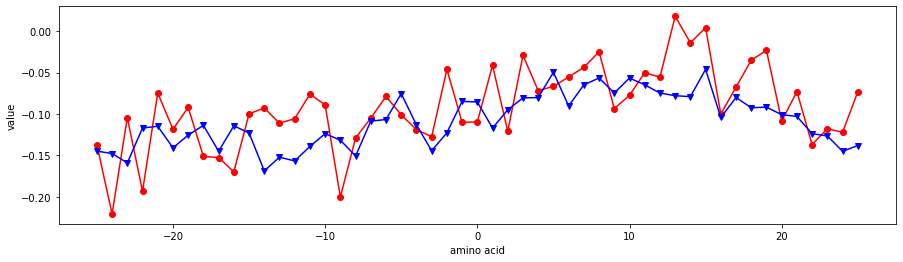

QIAN880124


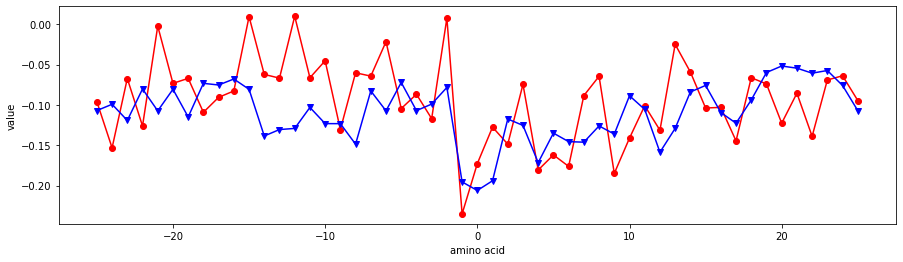

QIAN880125


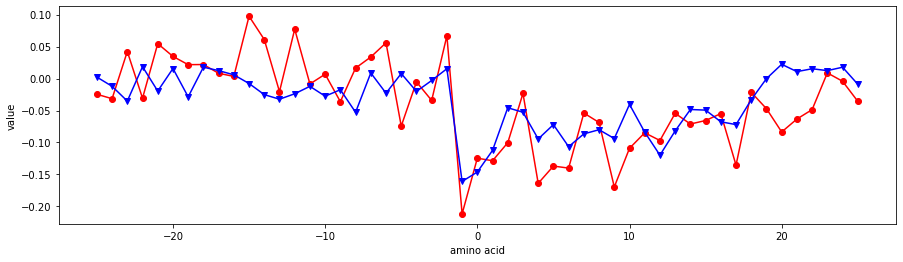

QIAN880126


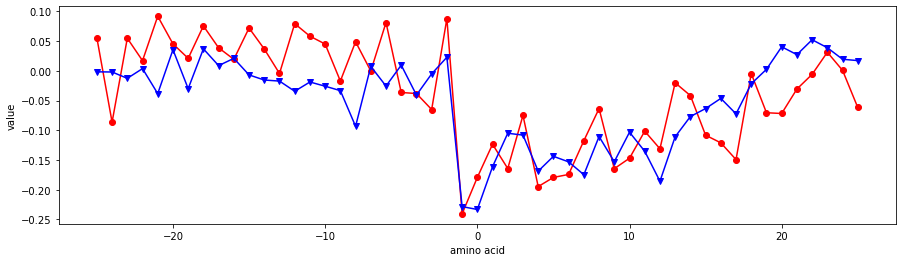

QIAN880127


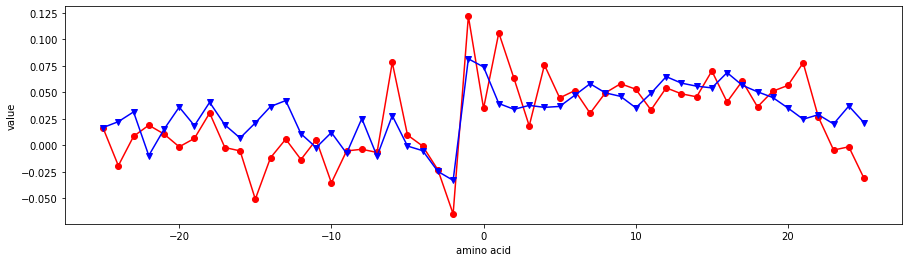

QIAN880128


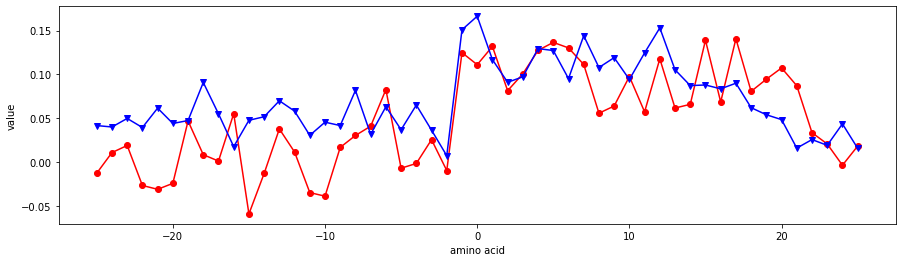

QIAN880129


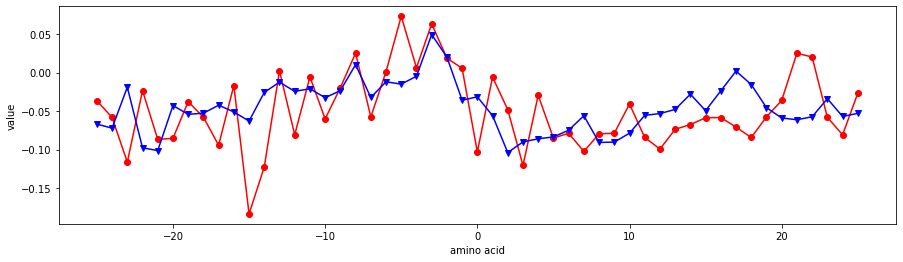

QIAN880130


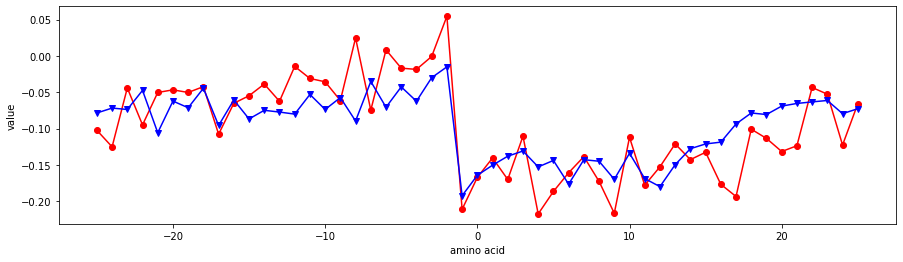

QIAN880131


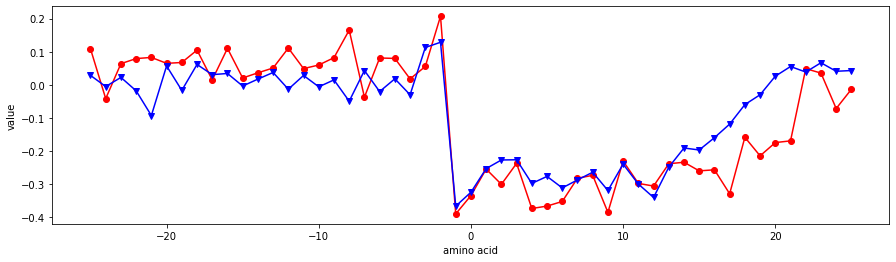

QIAN880132


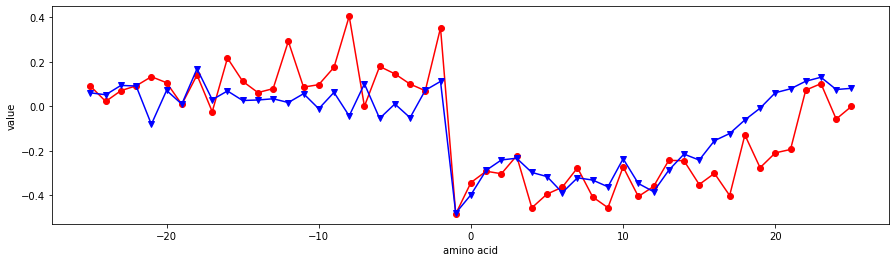

QIAN880133


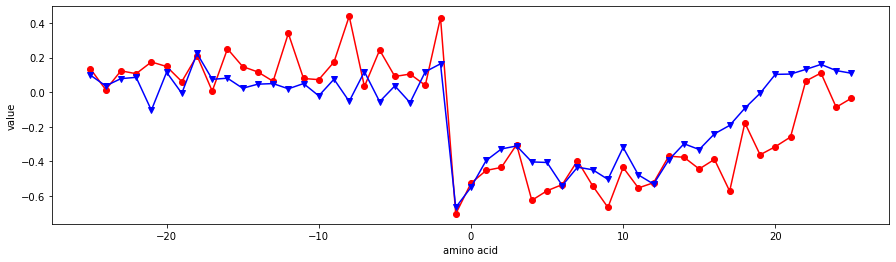

QIAN880134


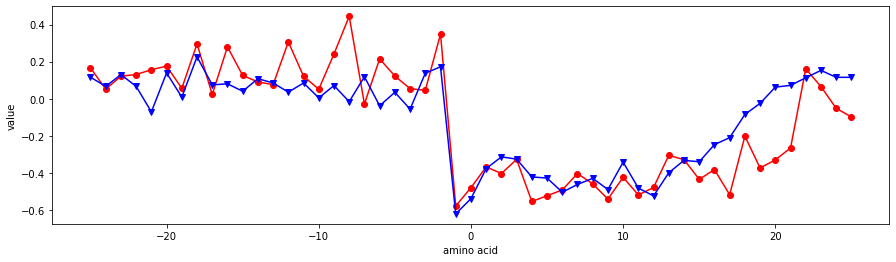

QIAN880135


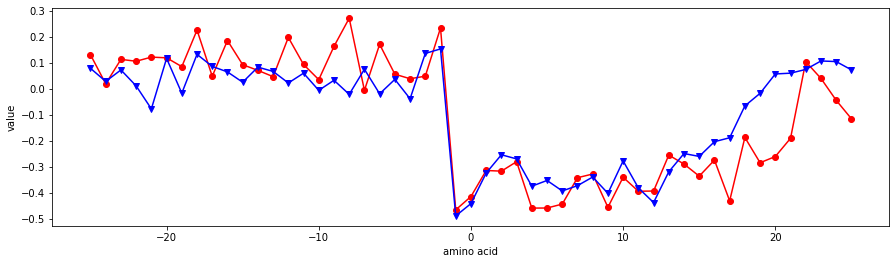

QIAN880136


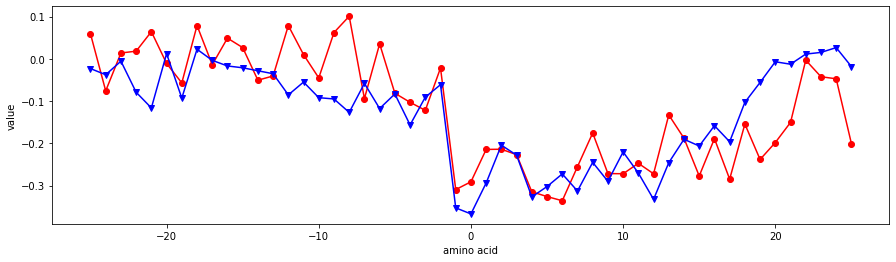

QIAN880137


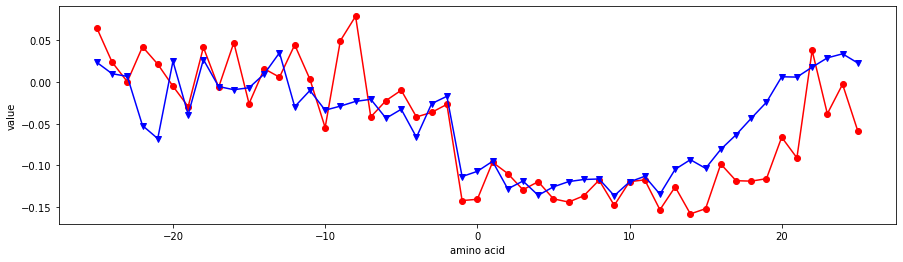

QIAN880138


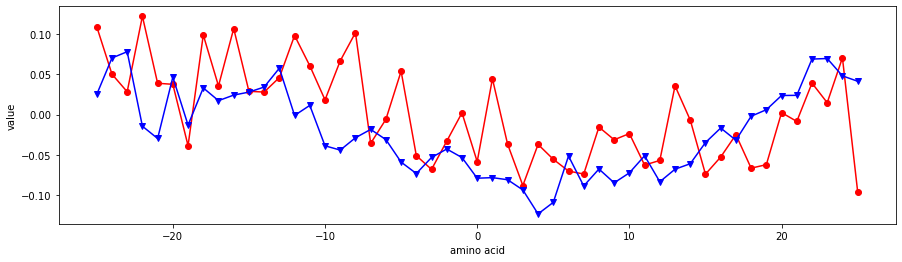

QIAN880139


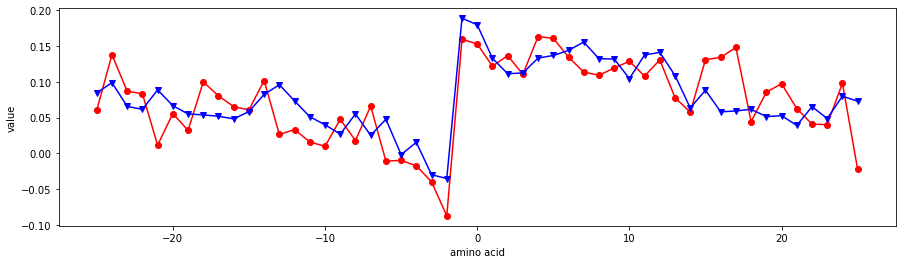

RACS770101


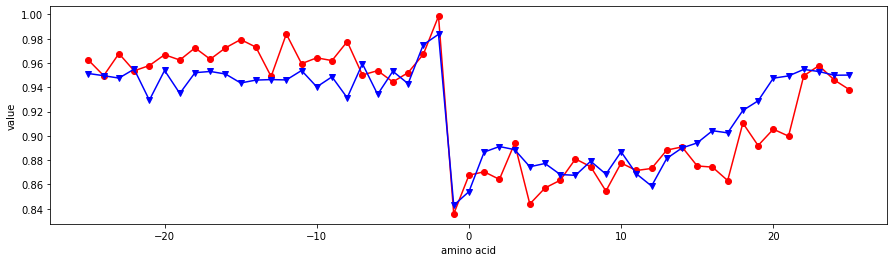

RACS770102


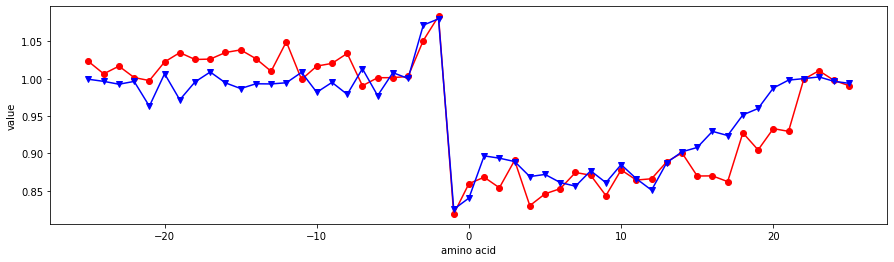

RACS770103


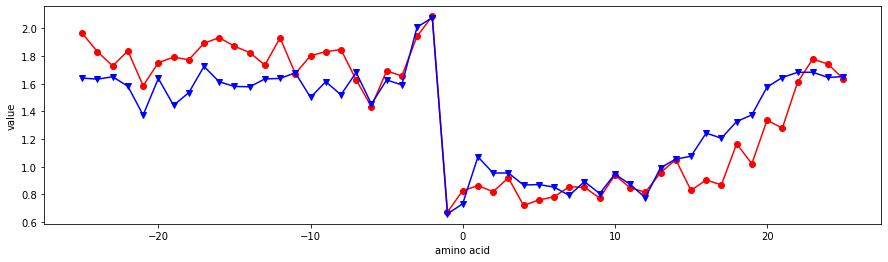

RACS820101


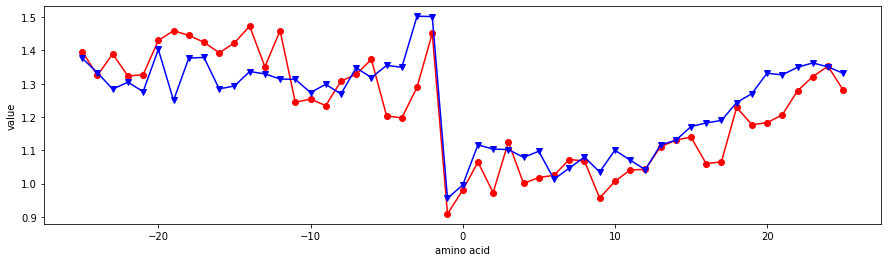

RACS820102


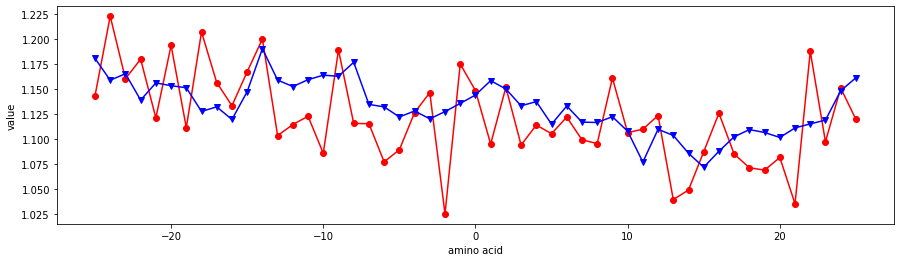

RACS820103


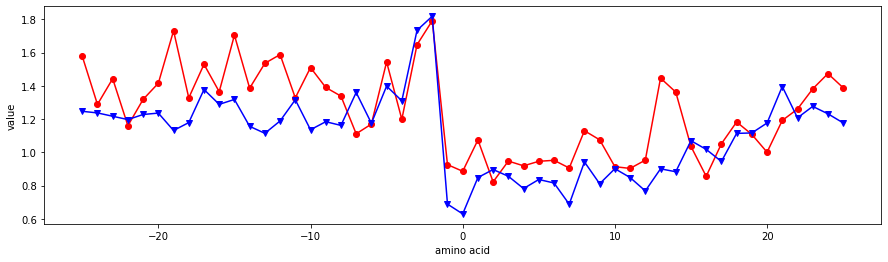

RACS820104


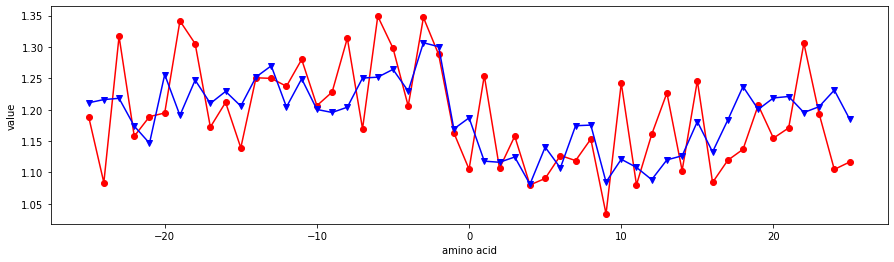

RACS820105


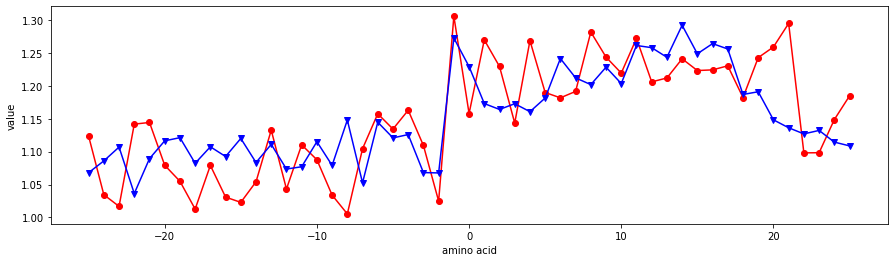

RACS820106


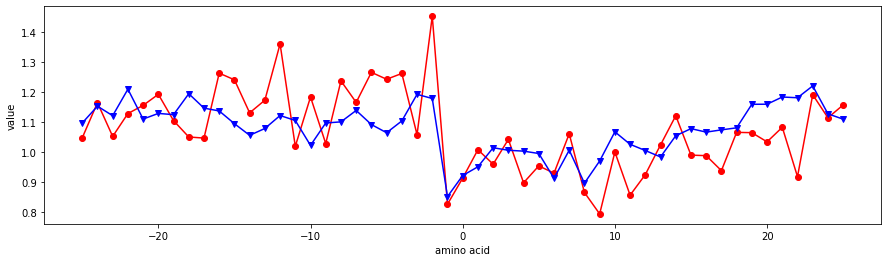

RACS820107


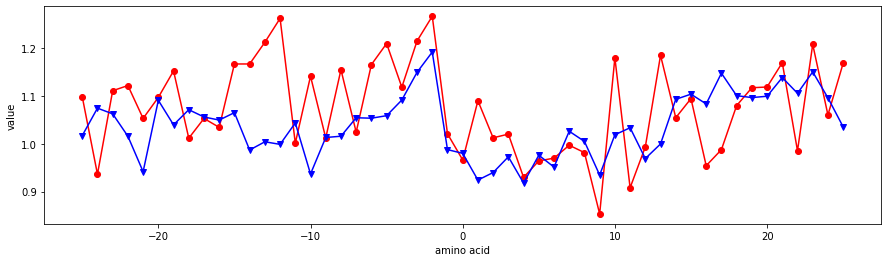

RACS820108


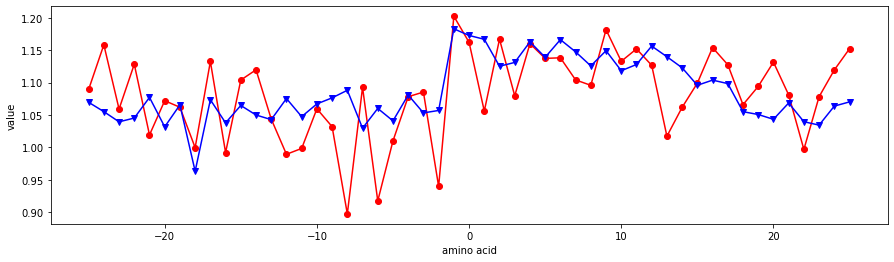

RACS820109


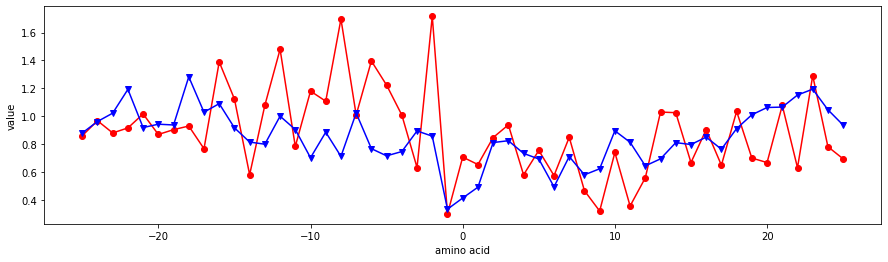

RACS820110


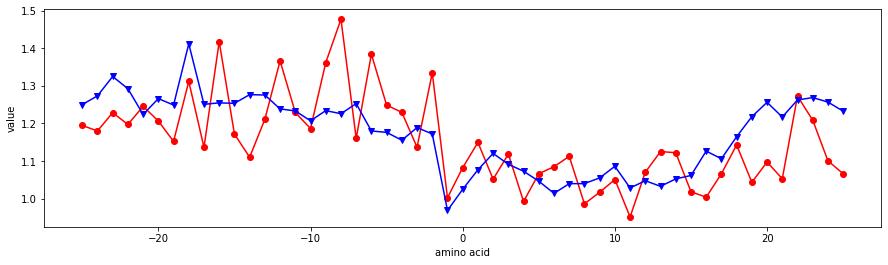

RACS820111


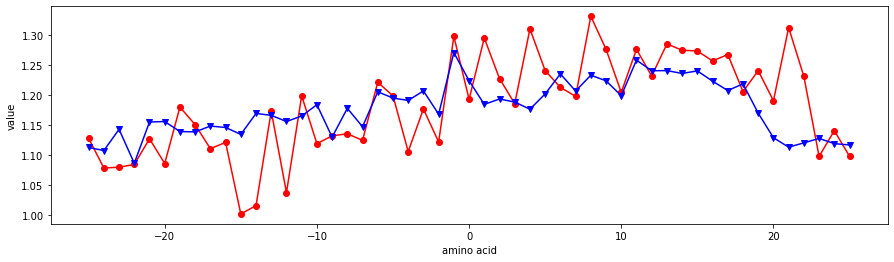

RACS820112


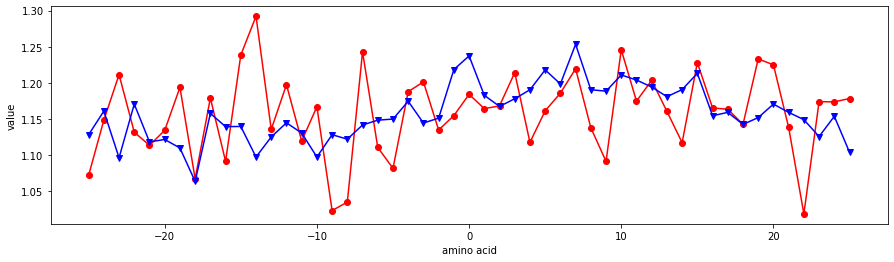

RACS820113


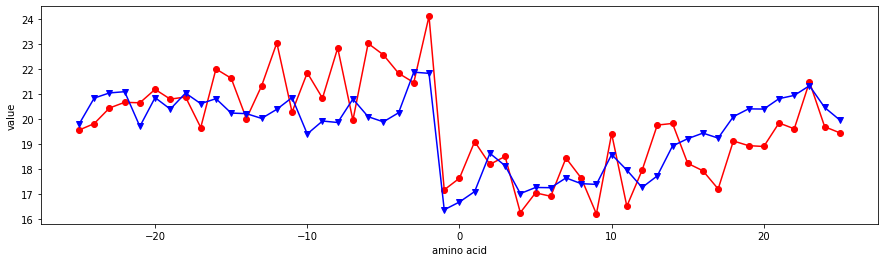

RACS820114


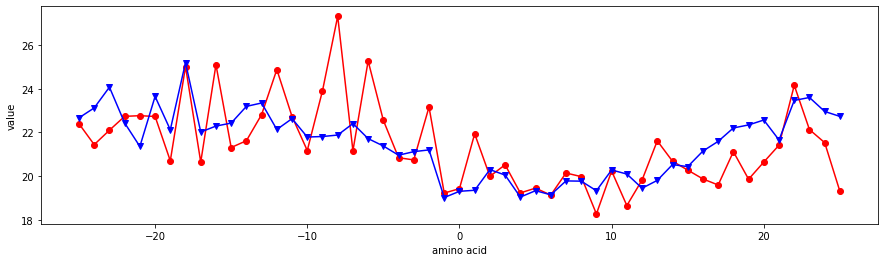

RADA880101


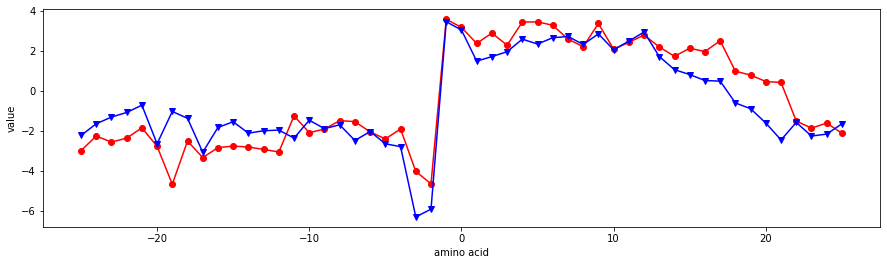

RADA880102


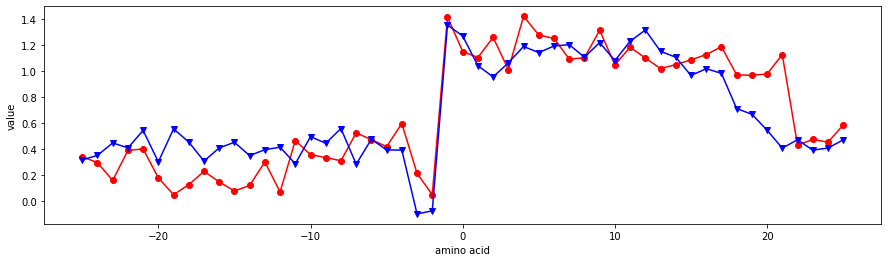

RADA880103


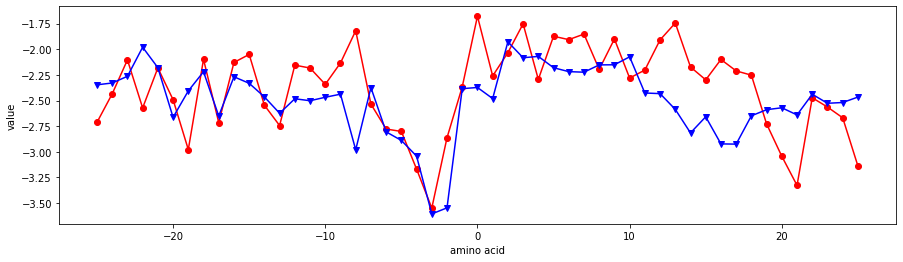

RADA880104


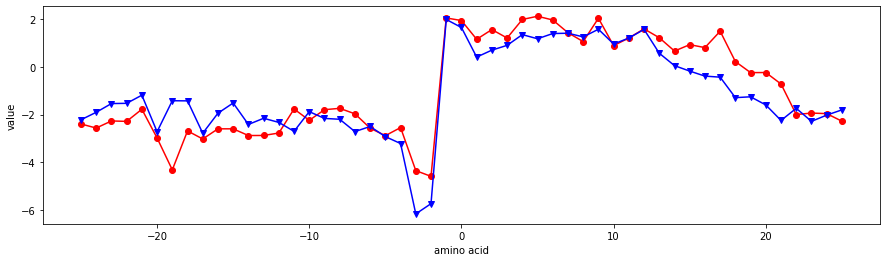

RADA880105


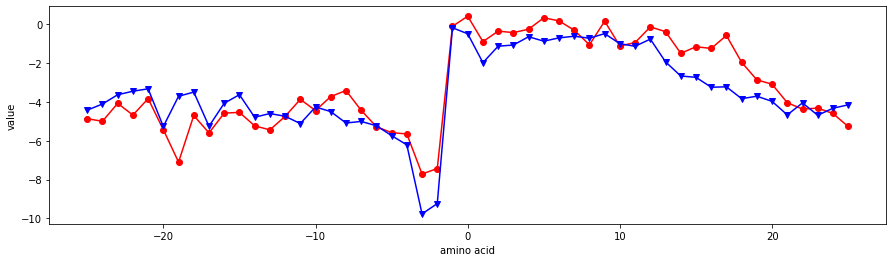

RADA880106


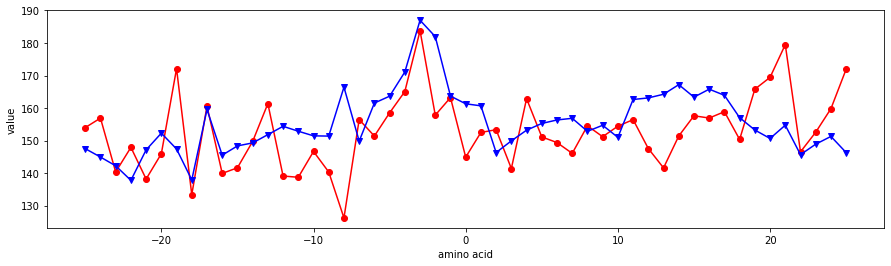

RADA880107


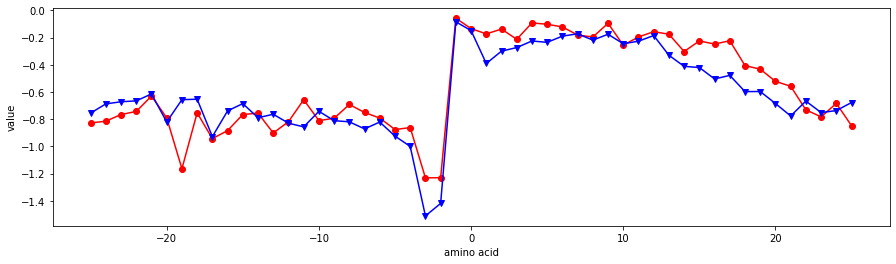

RADA880108


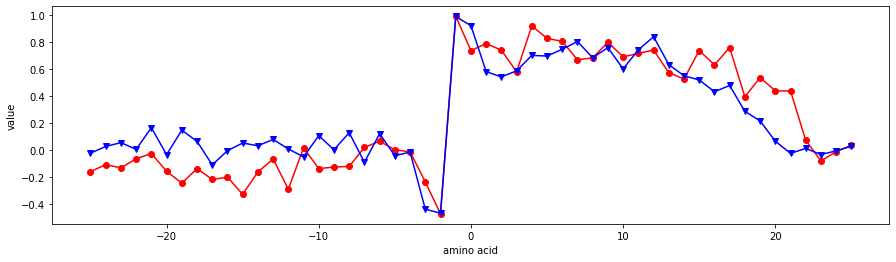

RICJ880101


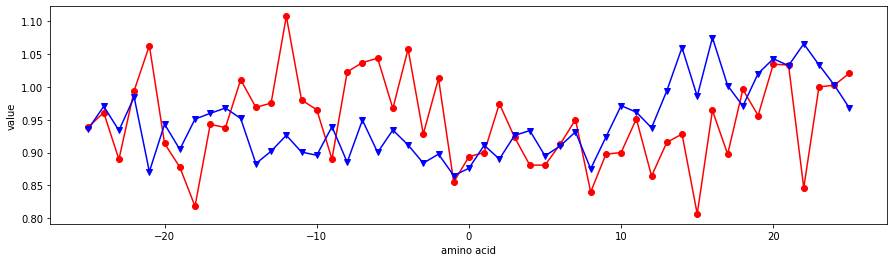

RICJ880102


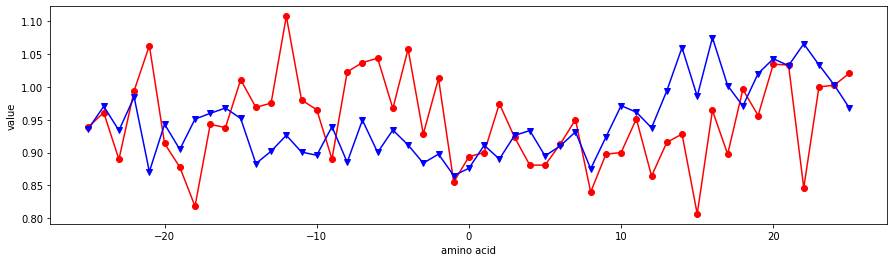

RICJ880103


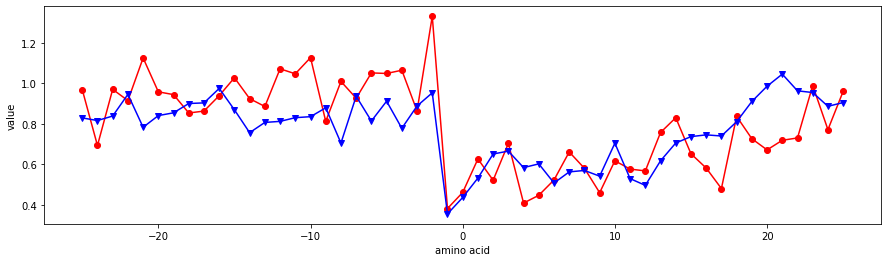

RICJ880104


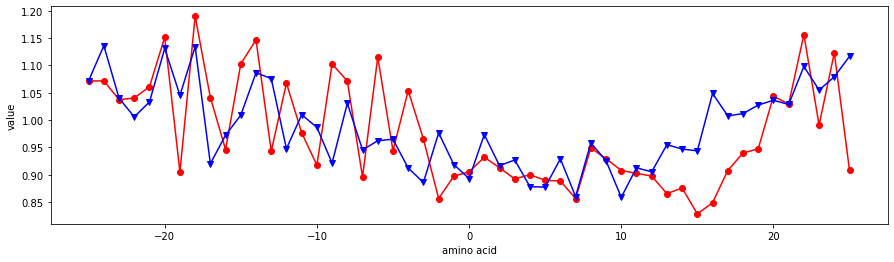

RICJ880105


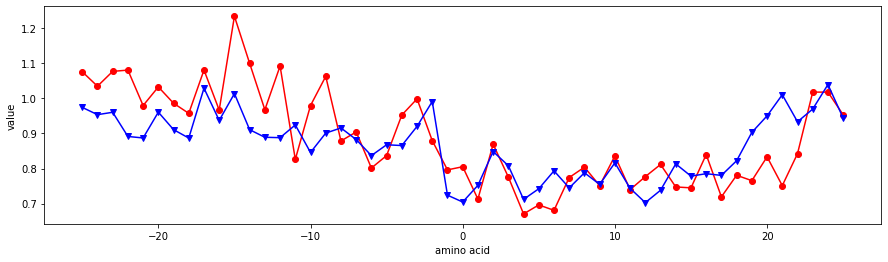

RICJ880106


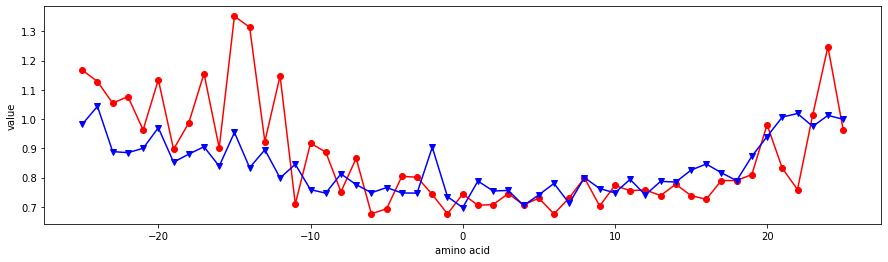

RICJ880107


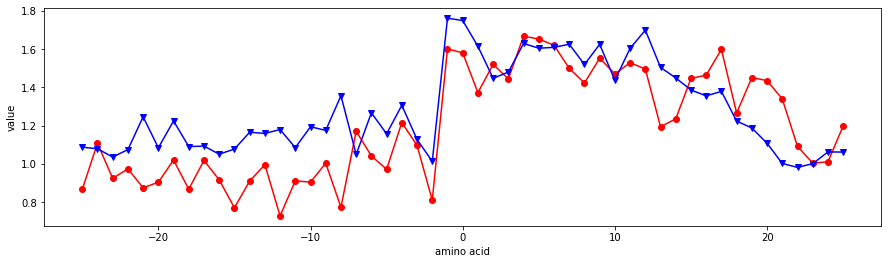

RICJ880108


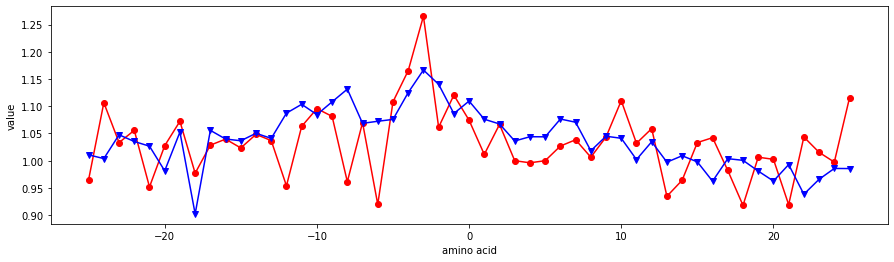

RICJ880109


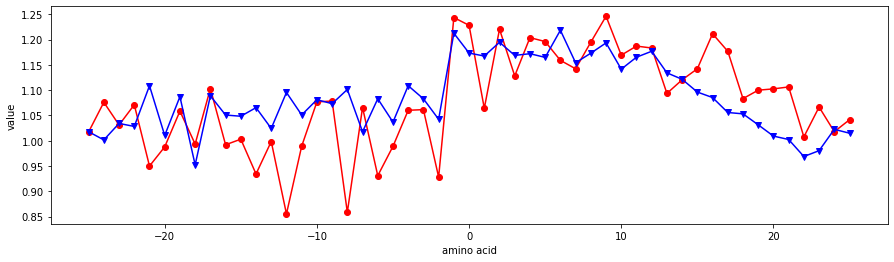

RICJ880110


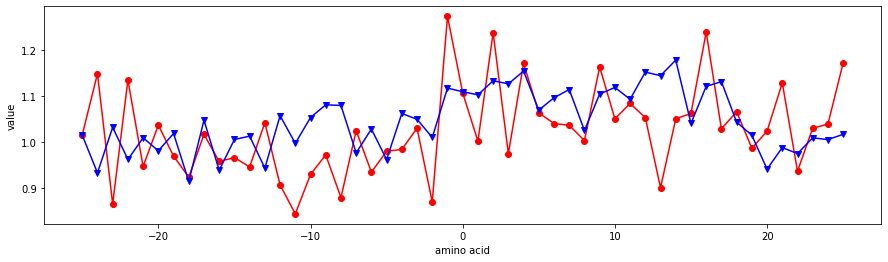

RICJ880111


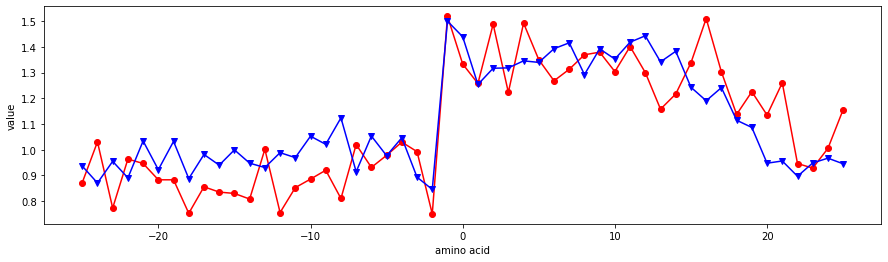

RICJ880112


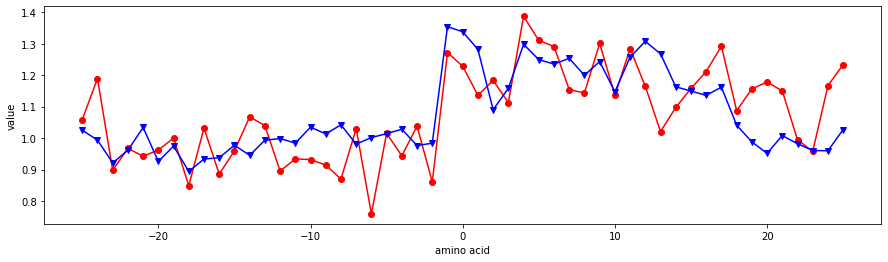

RICJ880113


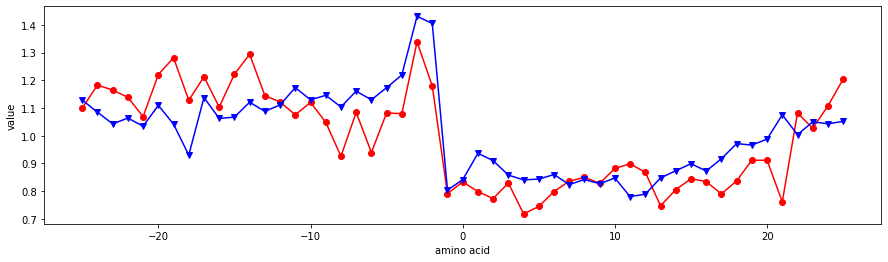

RICJ880114


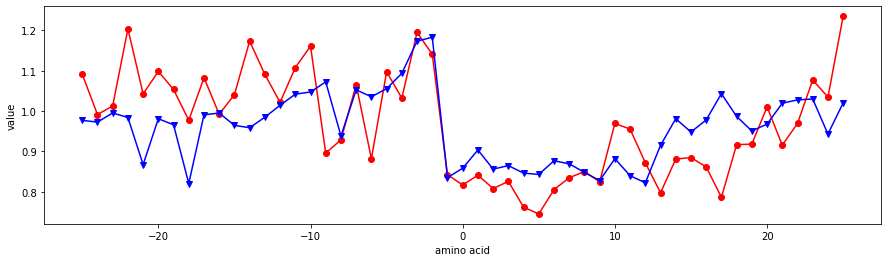

RICJ880115


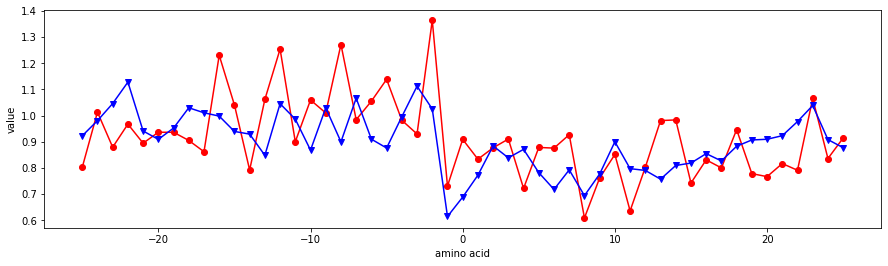

RICJ880116


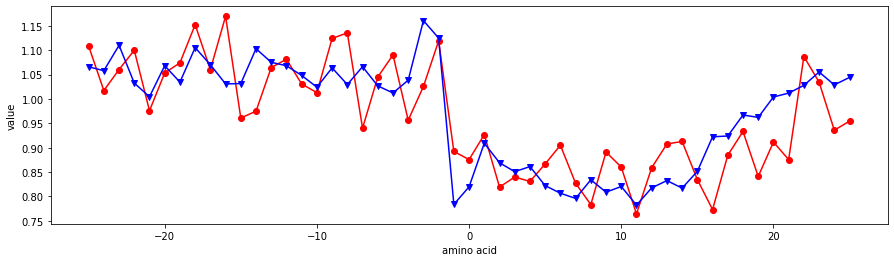

RICJ880117


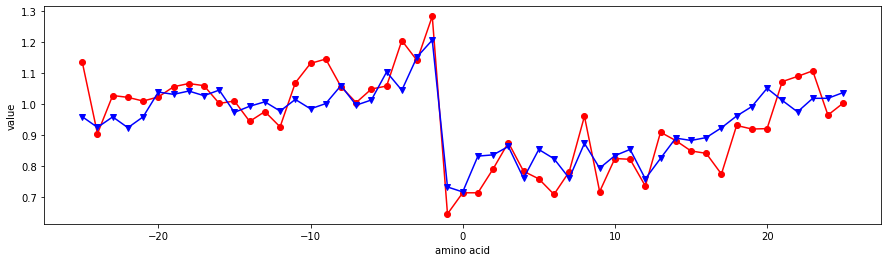

ROBB760101


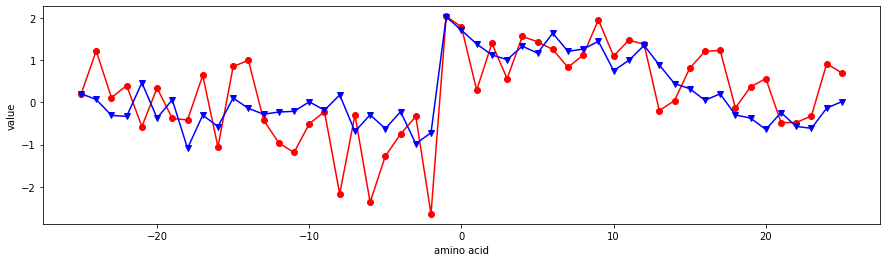

ROBB760102


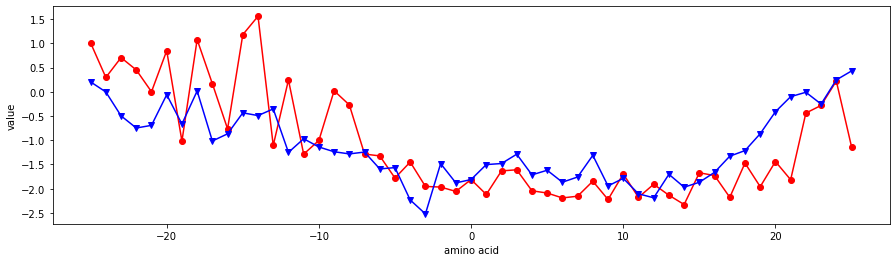

ROBB760103


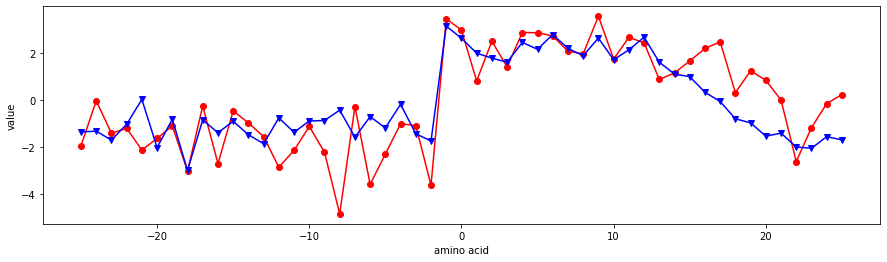

ROBB760104


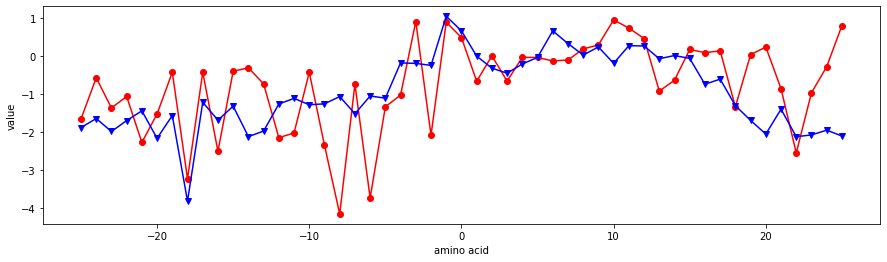

ROBB760105


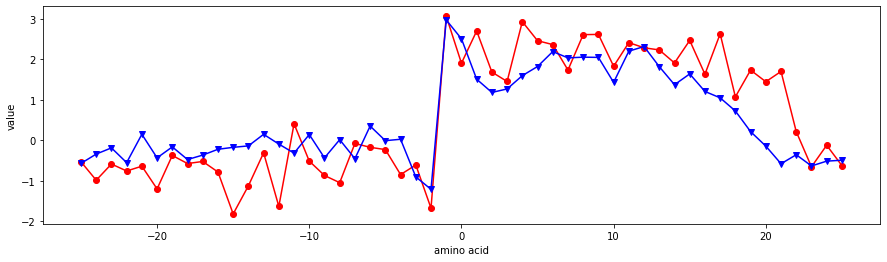

ROBB760106


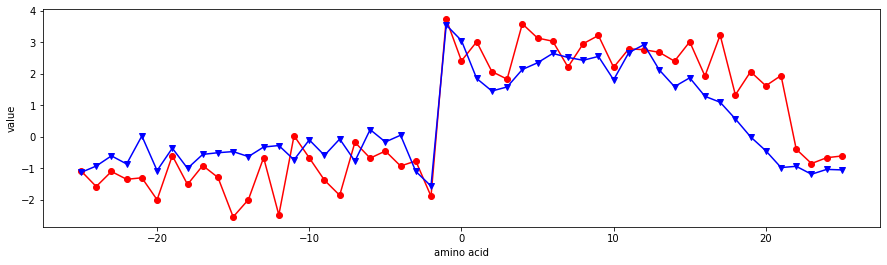

ROBB760107


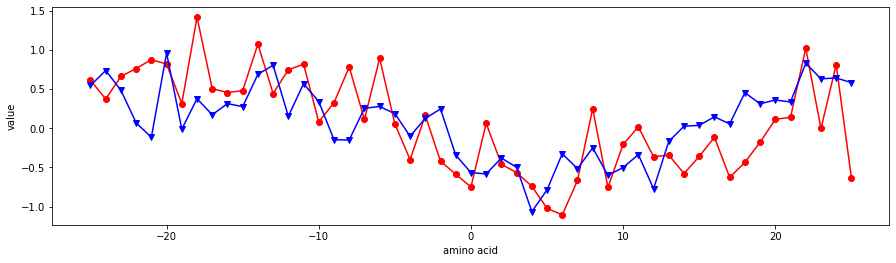

ROBB760108


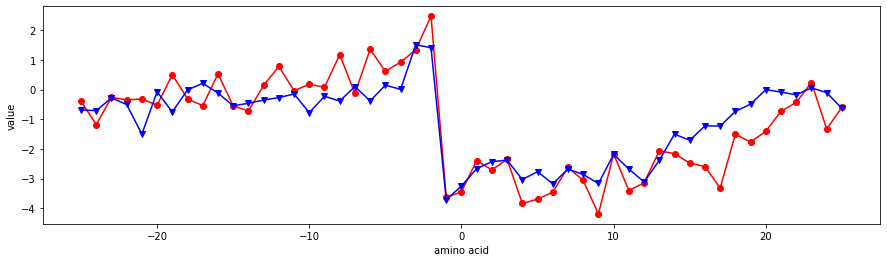

ROBB760109


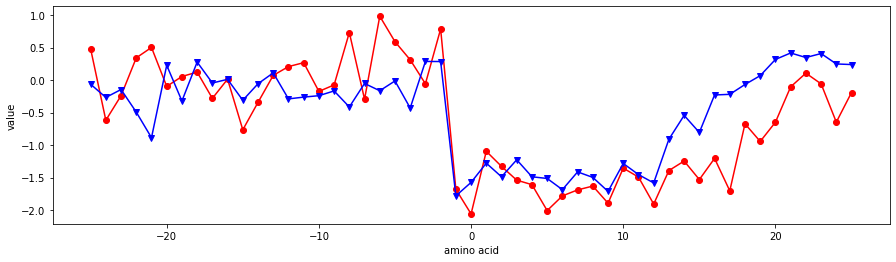

ROBB760110


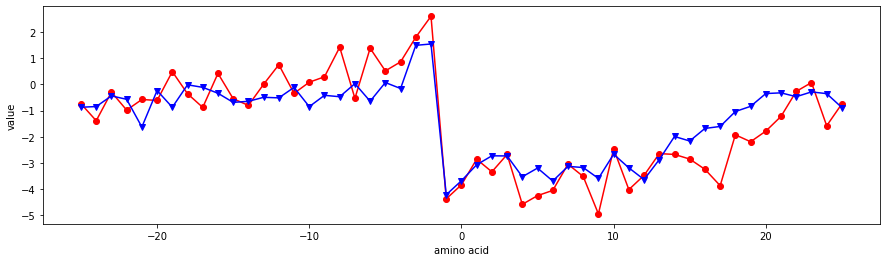

ROBB760111


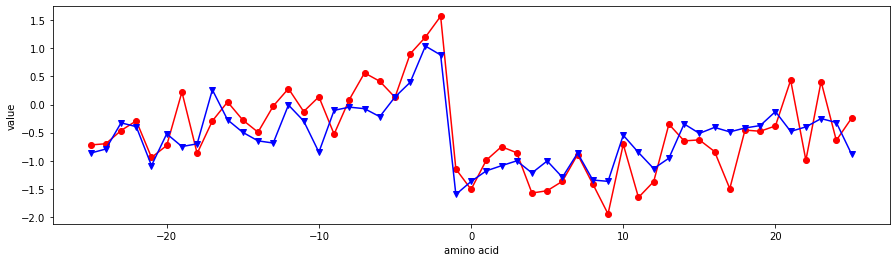

ROBB760112


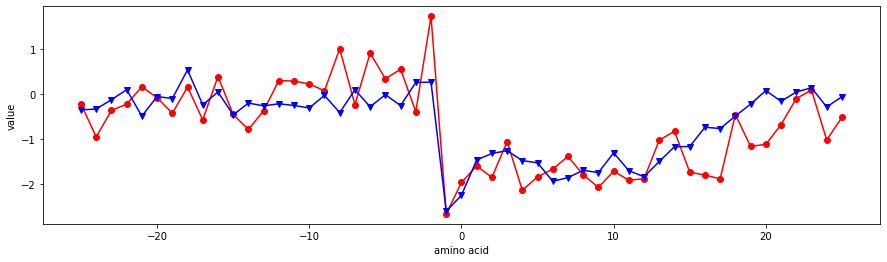

ROBB760113


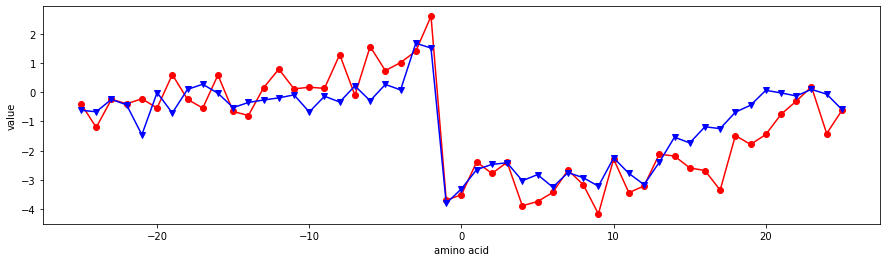

ROBB790101


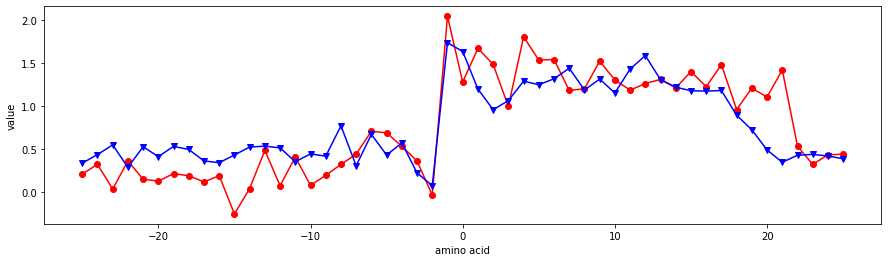

ROSG850101


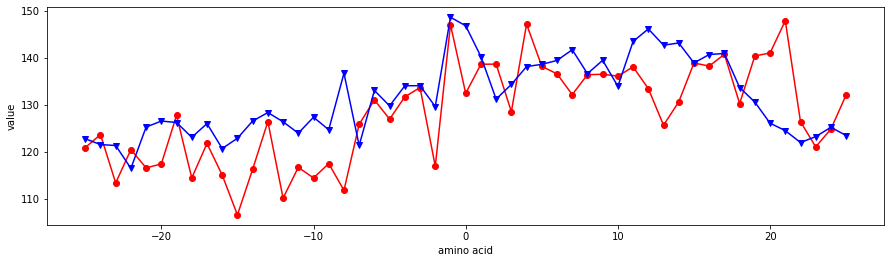

ROSG850102


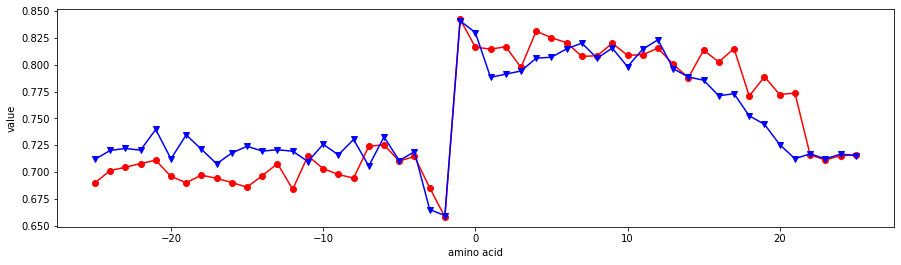

ROSM880101


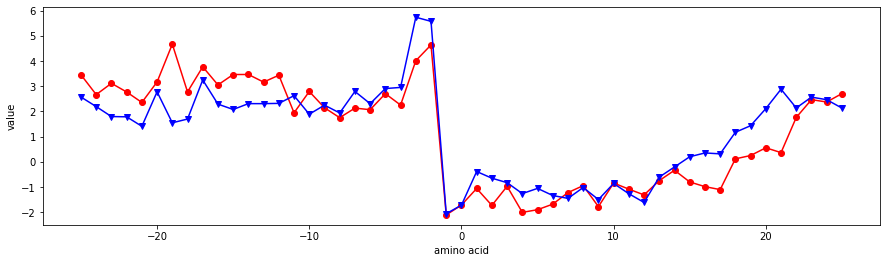

ROSM880102


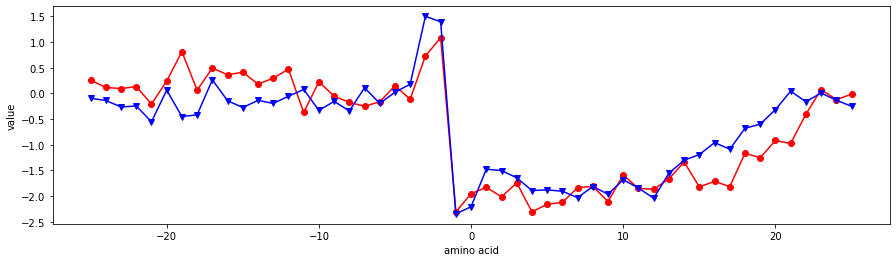

ROSM880103


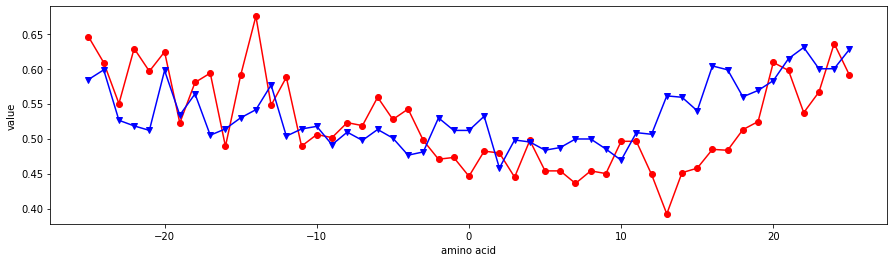

SIMZ760101


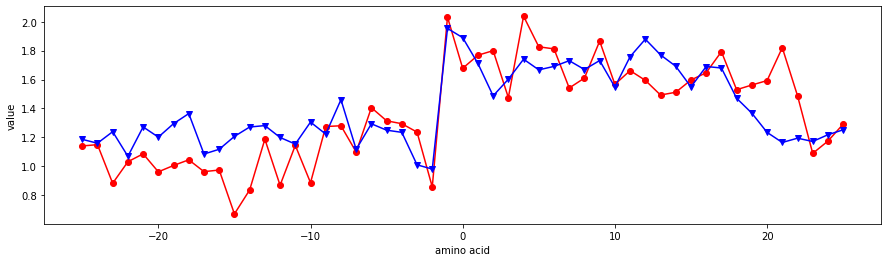

SNEP660101


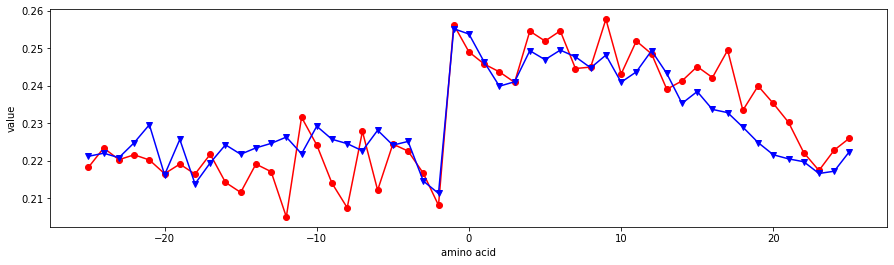

SNEP660102


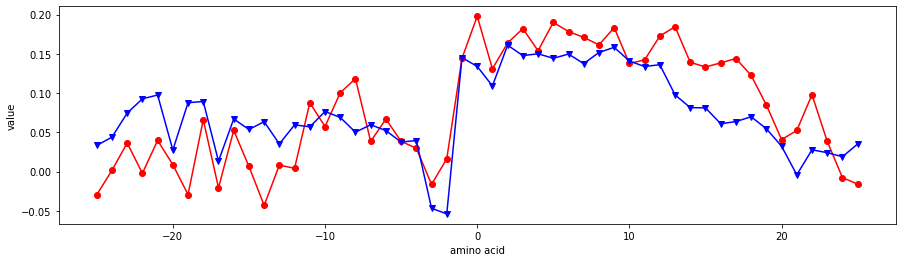

SNEP660103


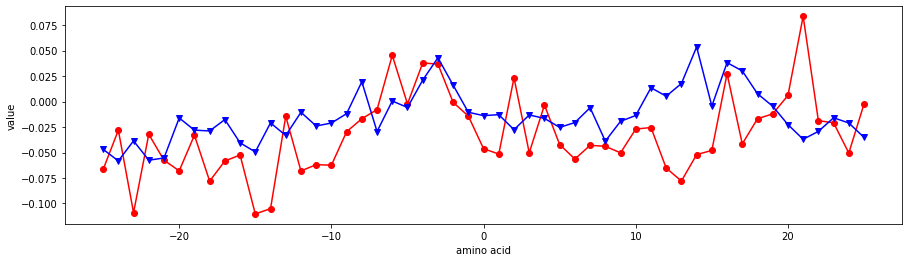

SNEP660104


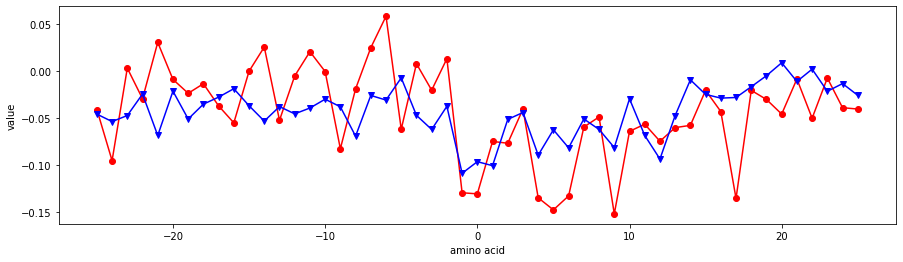

SUEM840101


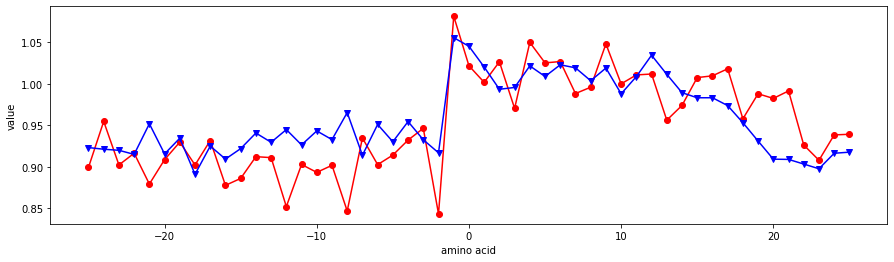

SUEM840102


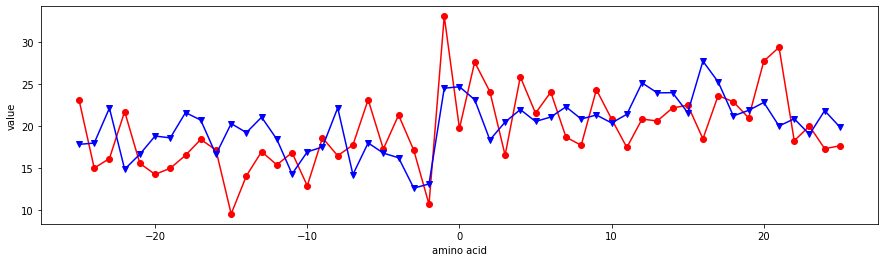

SWER830101


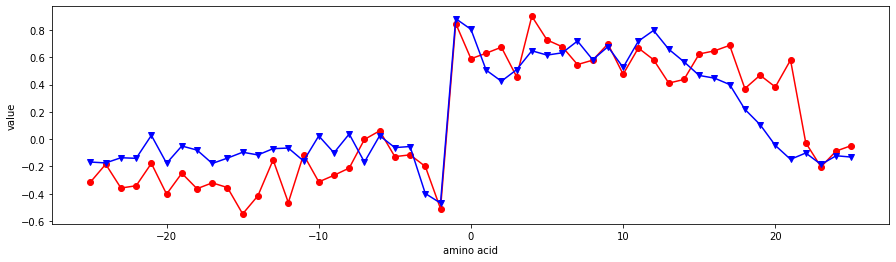

TANS770101


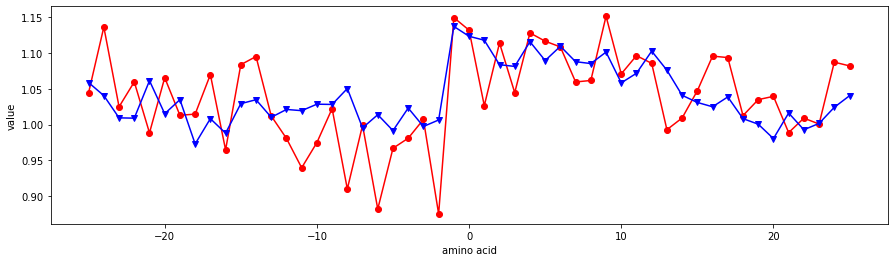

TANS770102


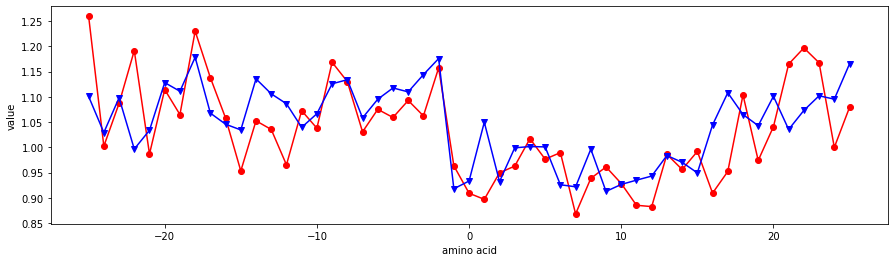

TANS770103


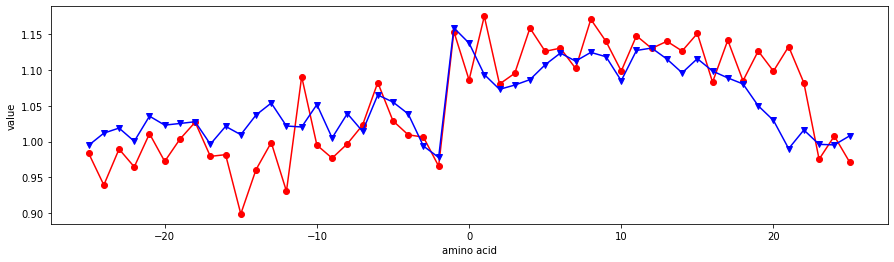

TANS770104


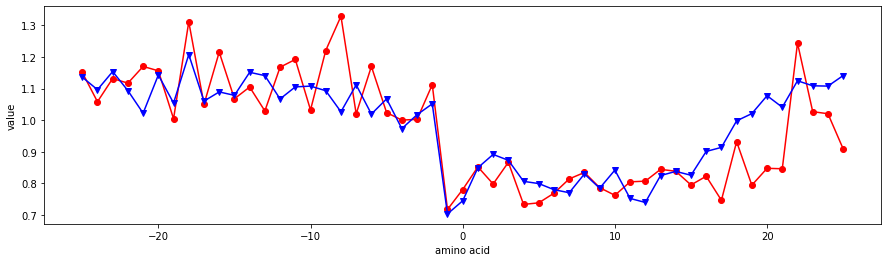

TANS770105


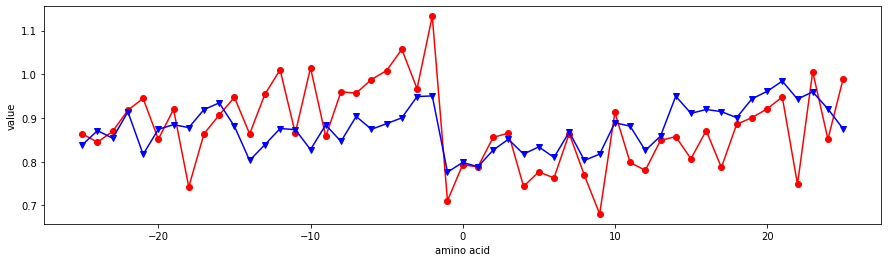

TANS770106


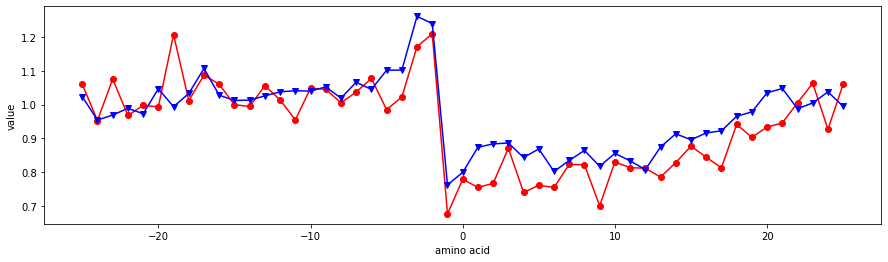

TANS770107


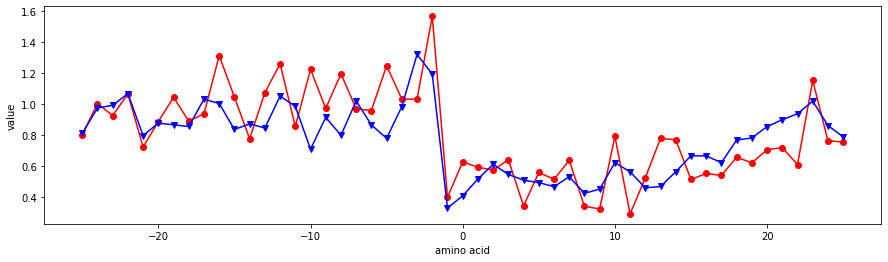

TANS770108


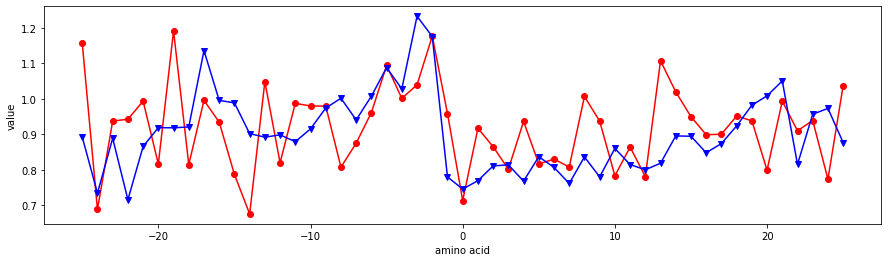

TANS770109


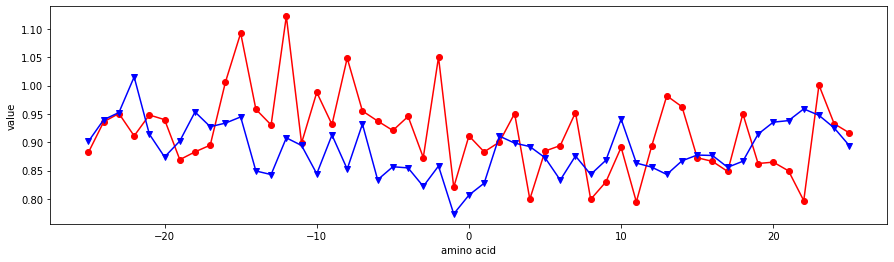

TANS770110


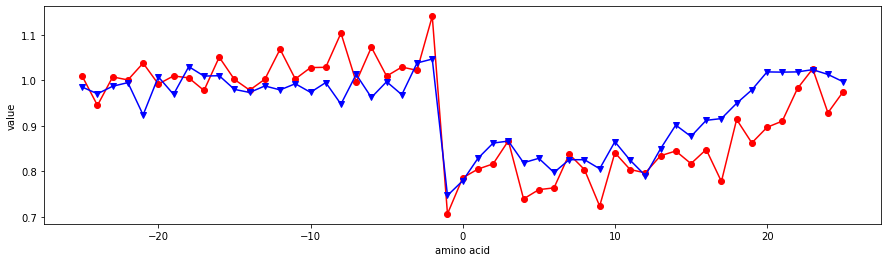

VASM830101


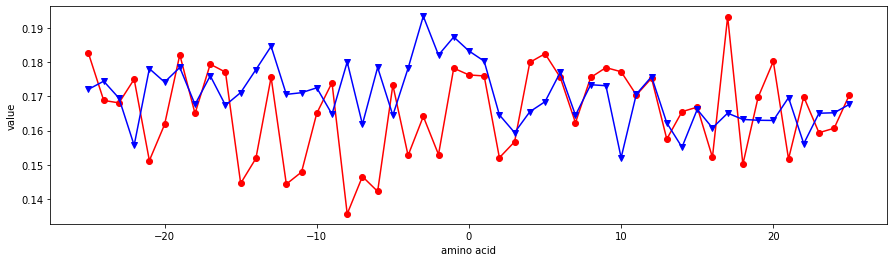

VASM830102


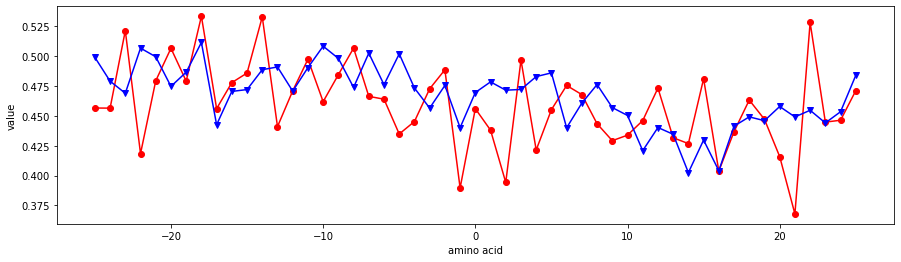

VASM830103


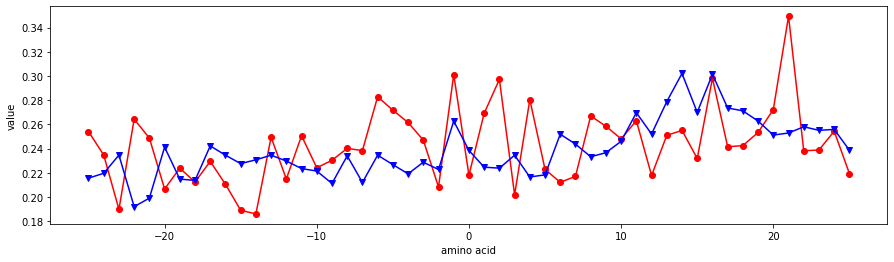

VELV850101


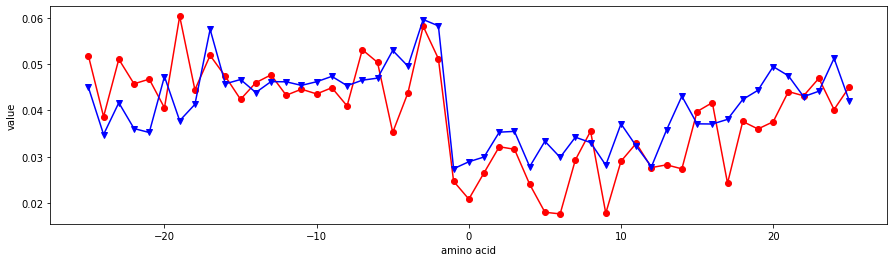

VENT840101


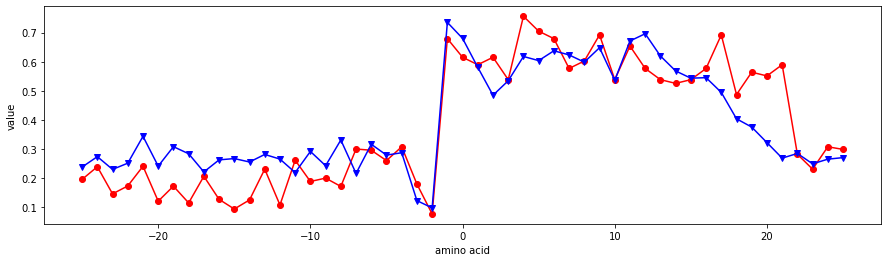

VHEG790101


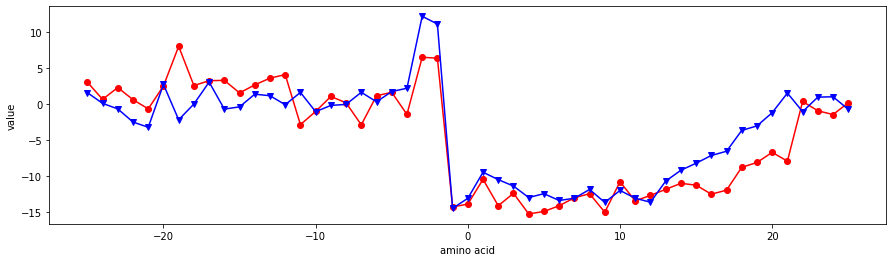

WARP780101


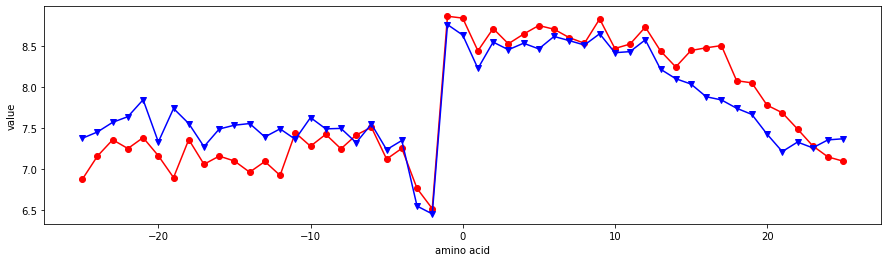

WEBA780101


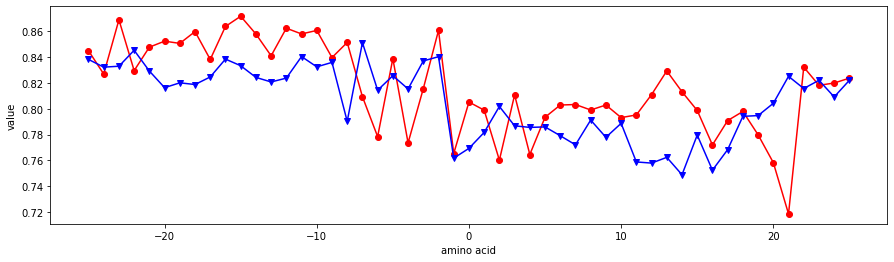

WERD780101


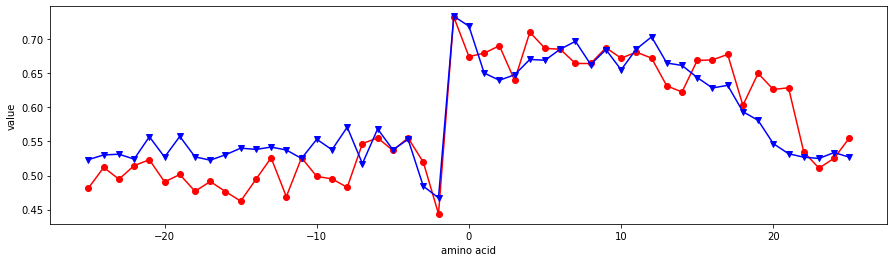

WERD780102


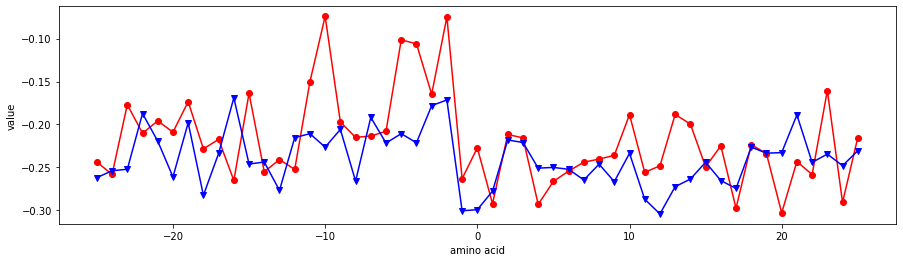

WERD780103


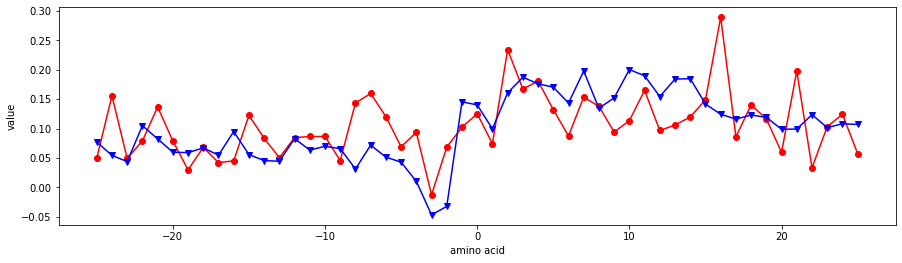

WERD780104


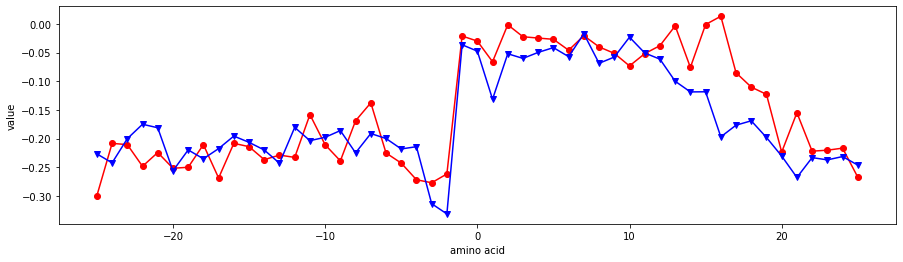

WOEC730101


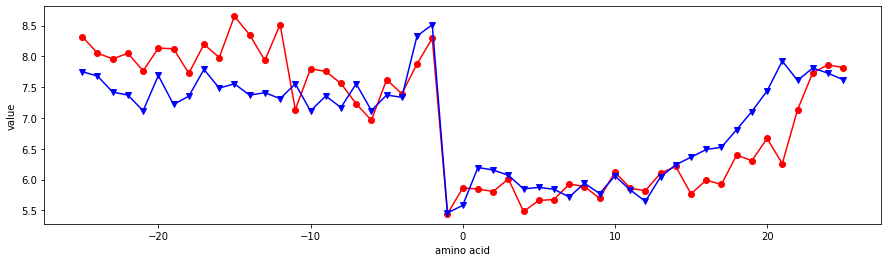

WOLR810101


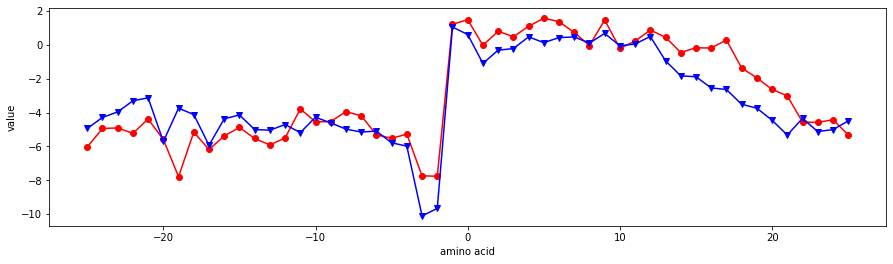

WOLS870101


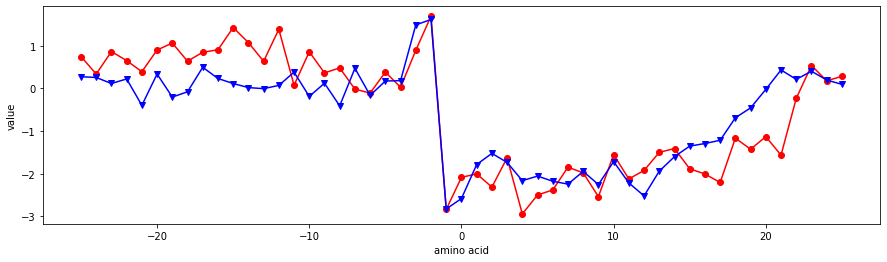

WOLS870102


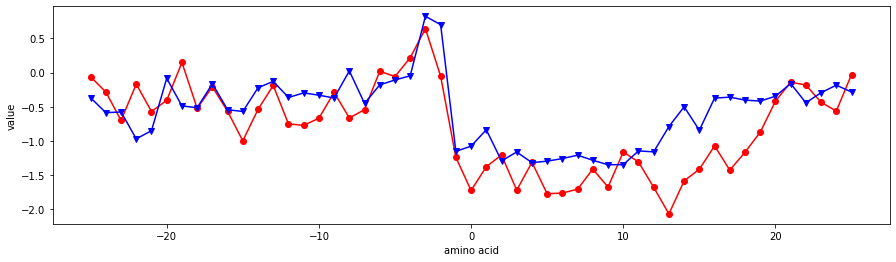

WOLS870103


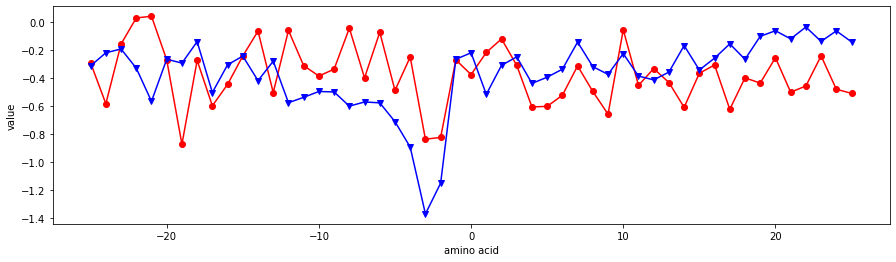

YUTK870101


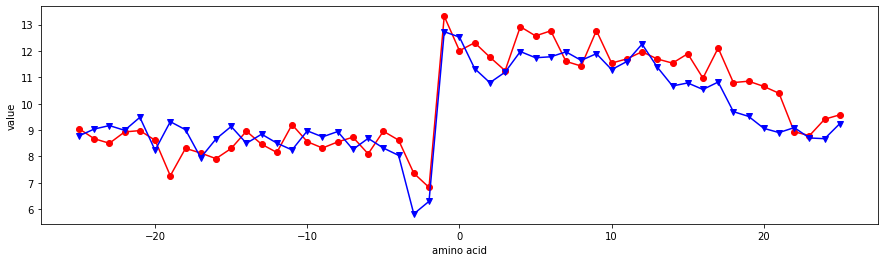

YUTK870102


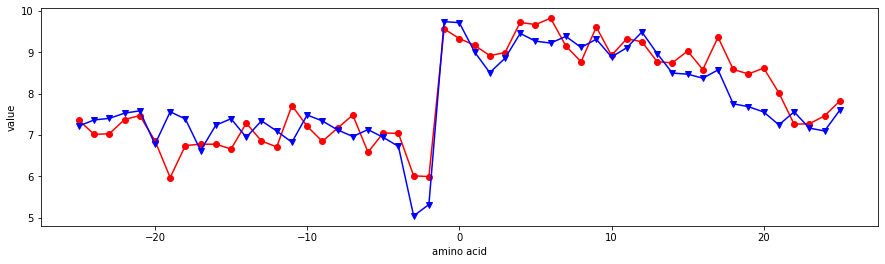

YUTK870103


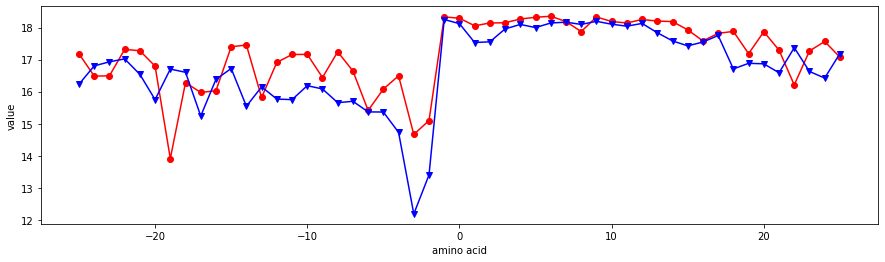

YUTK870104


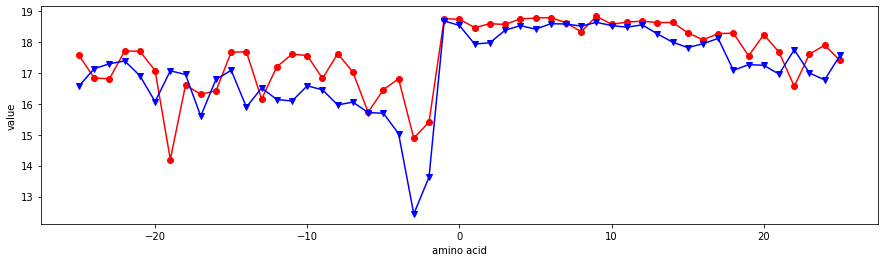

ZASB820101


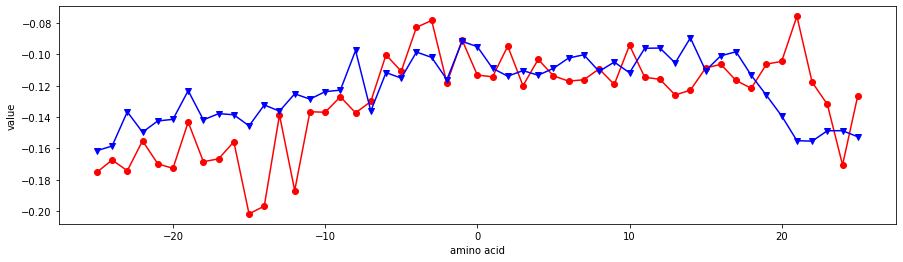

ZIMJ680101


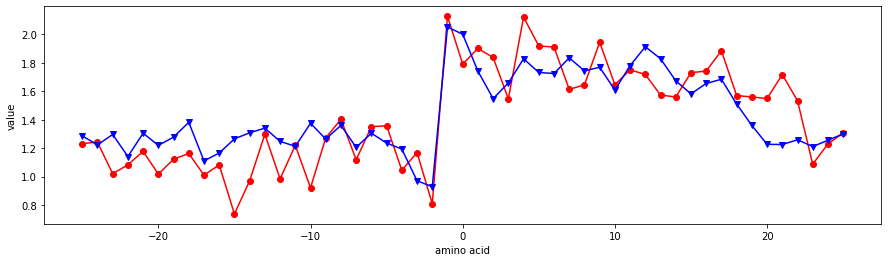

ZIMJ680102


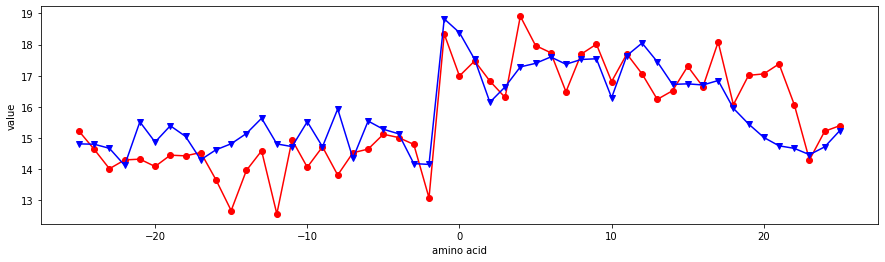

ZIMJ680103


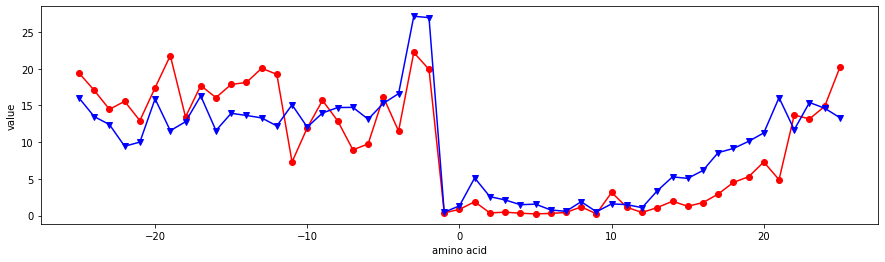

ZIMJ680104


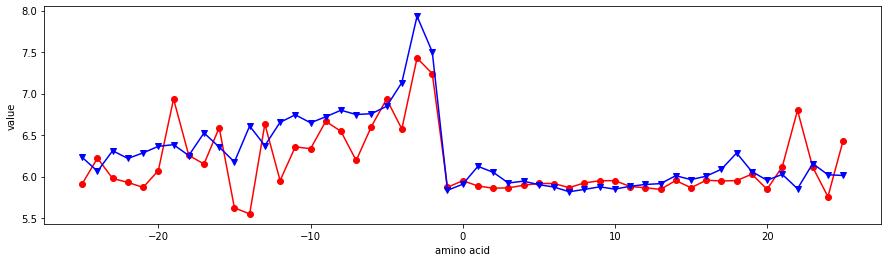

ZIMJ680105


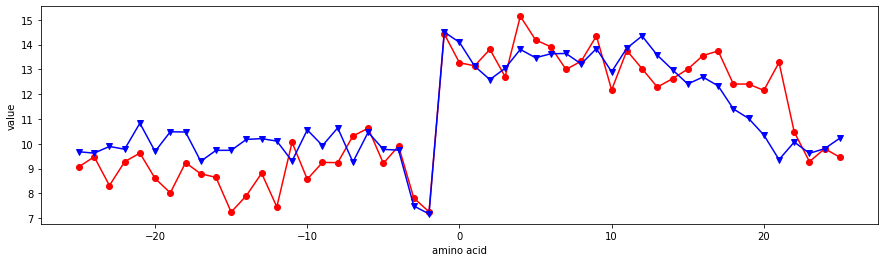

AURR980101


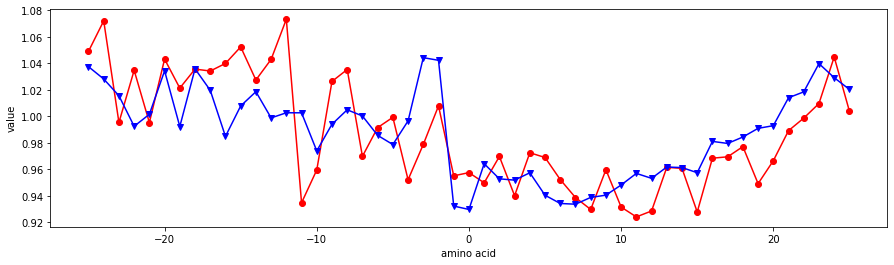

AURR980102


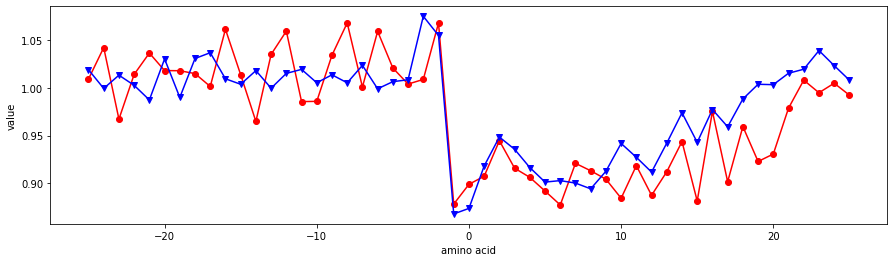

AURR980103


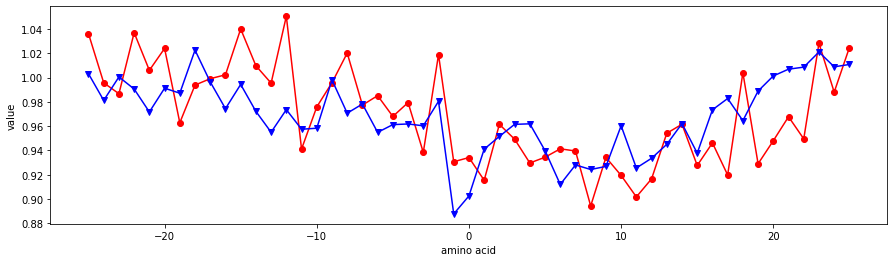

AURR980104


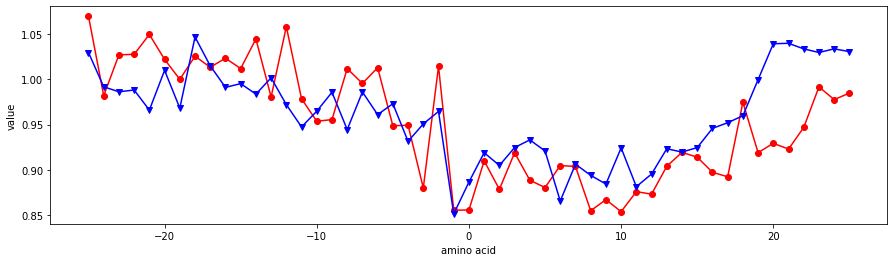

AURR980105


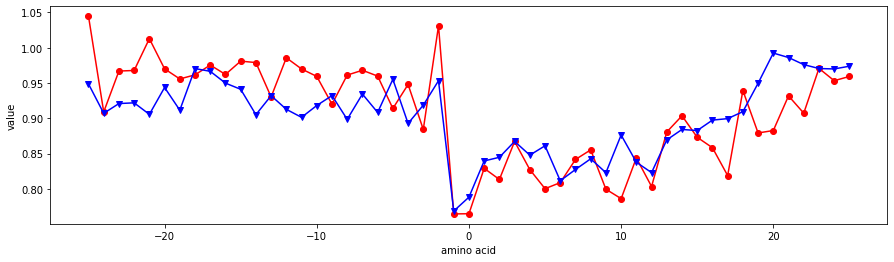

AURR980106


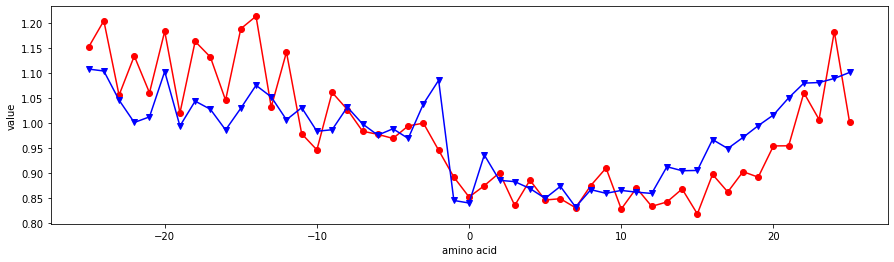

AURR980107


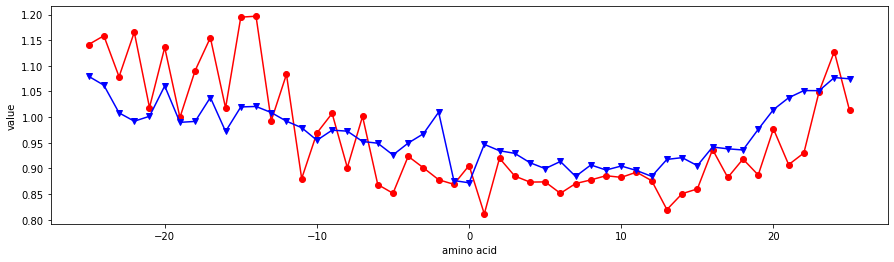

AURR980108


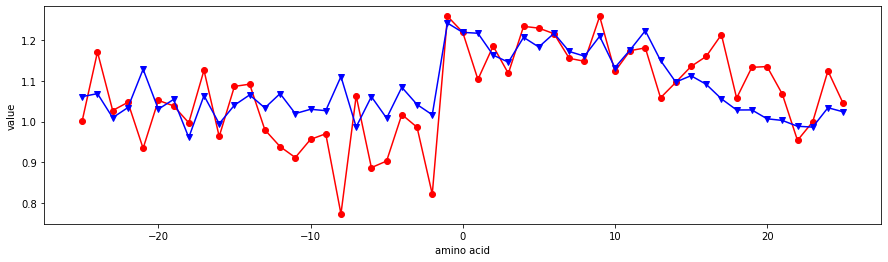

AURR980109


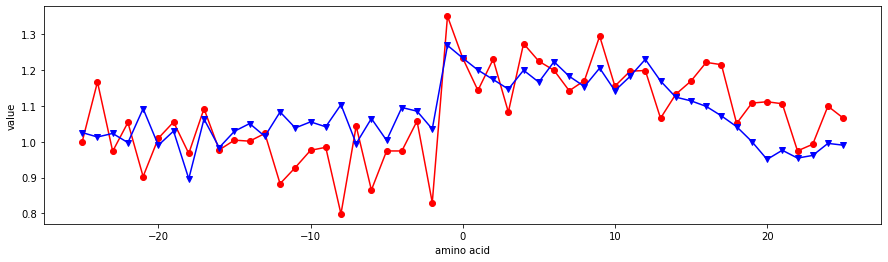

AURR980110


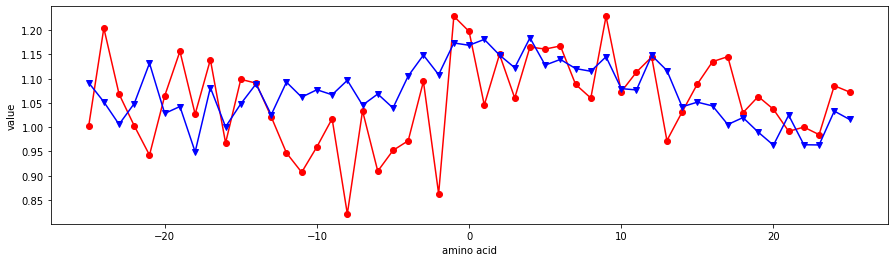

AURR980111


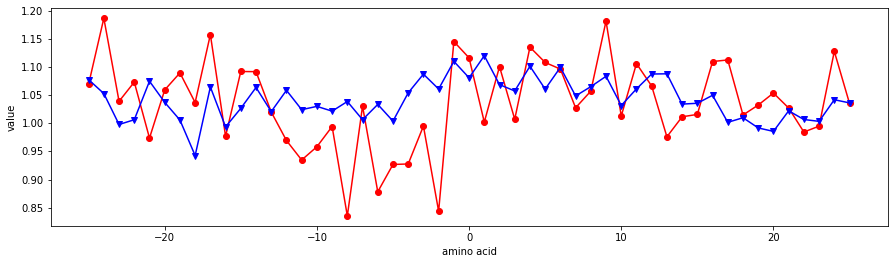

AURR980112


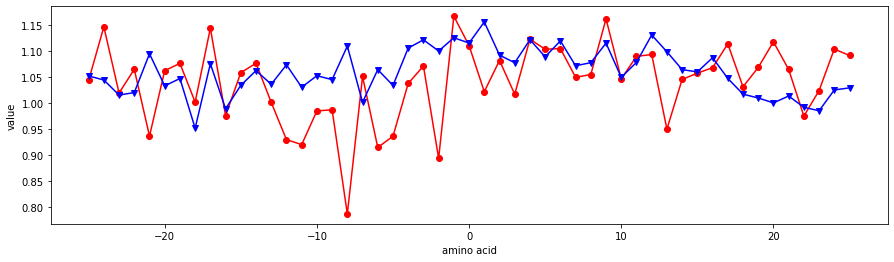

AURR980113


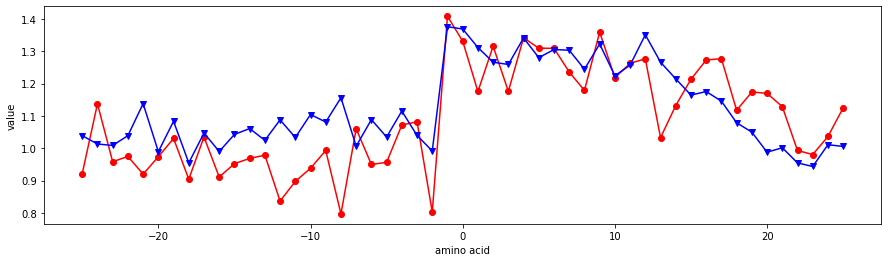

AURR980114


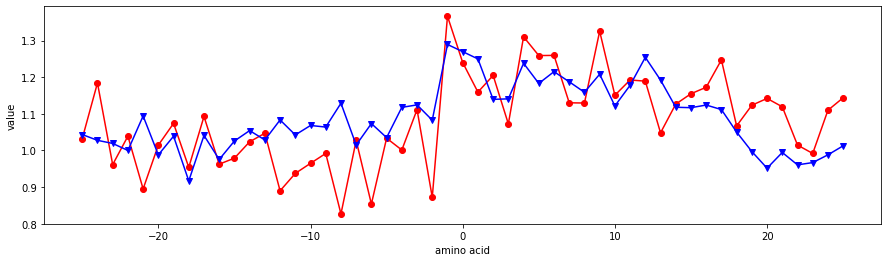

AURR980115


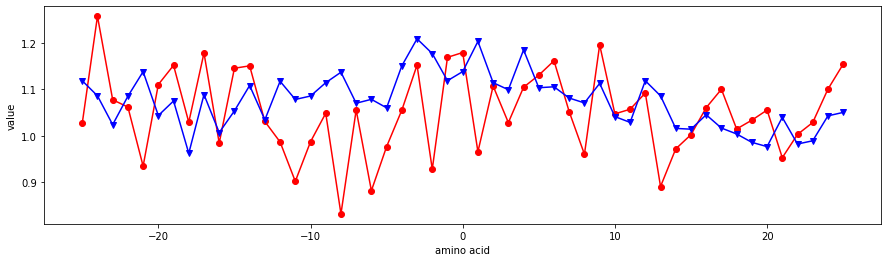

AURR980116


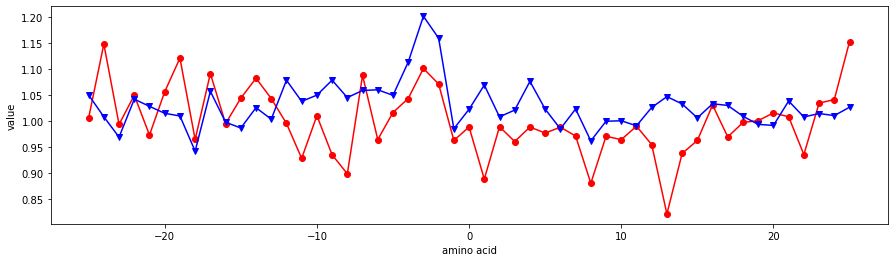

AURR980117


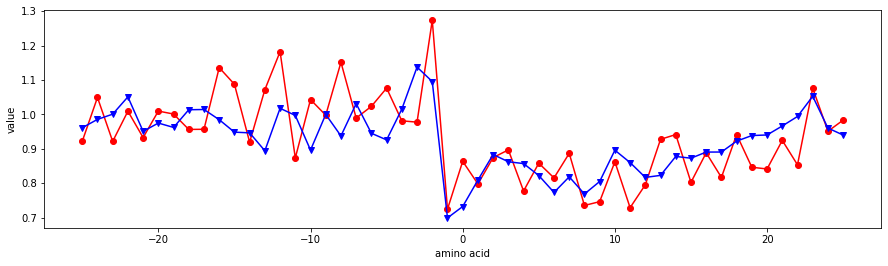

AURR980118


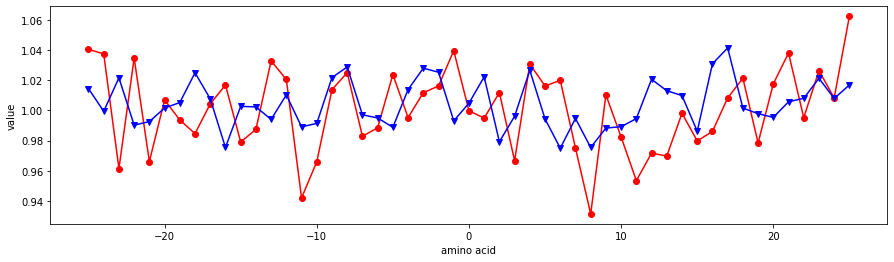

AURR980119


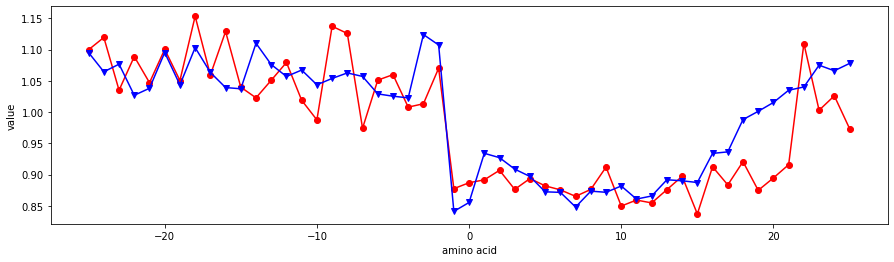

AURR980120


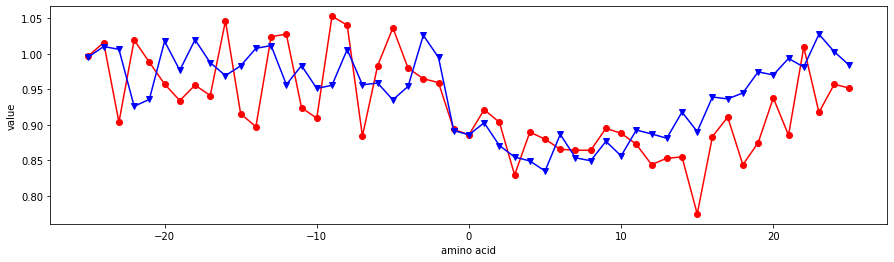

ONEK900101


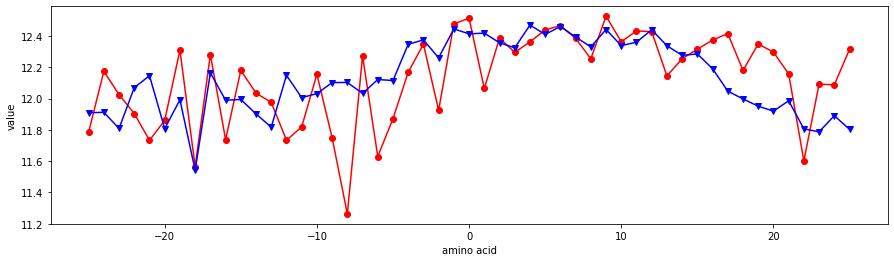

ONEK900102


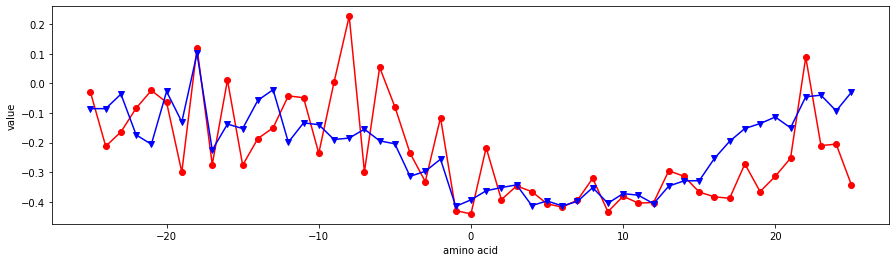

VINM940101


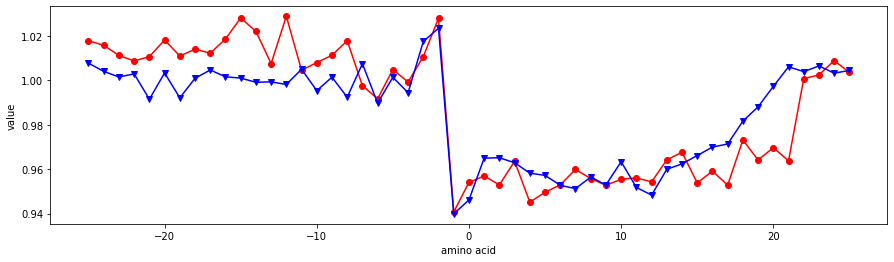

VINM940102


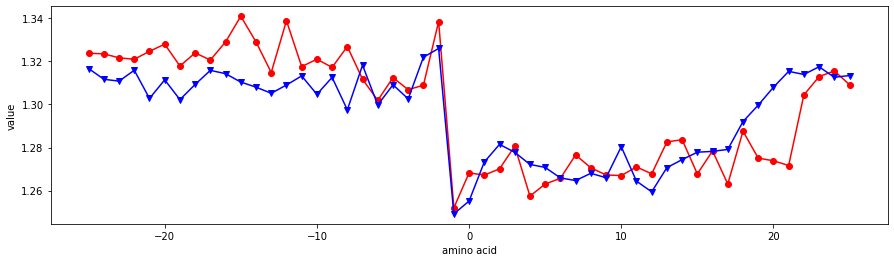

VINM940103


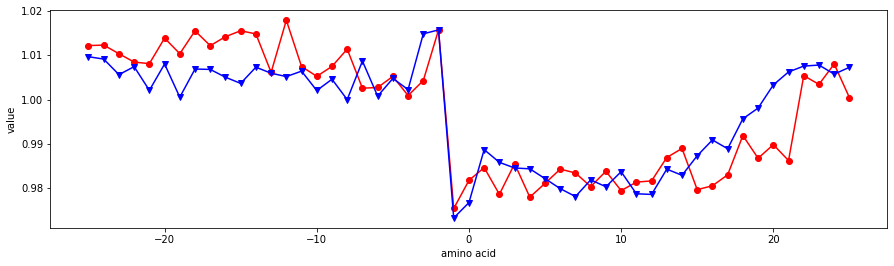

VINM940104


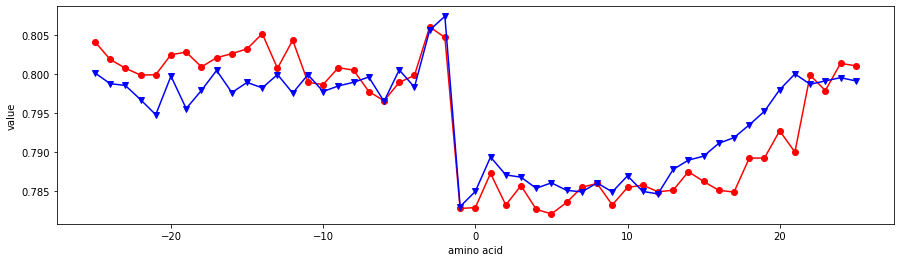

MUNV940101


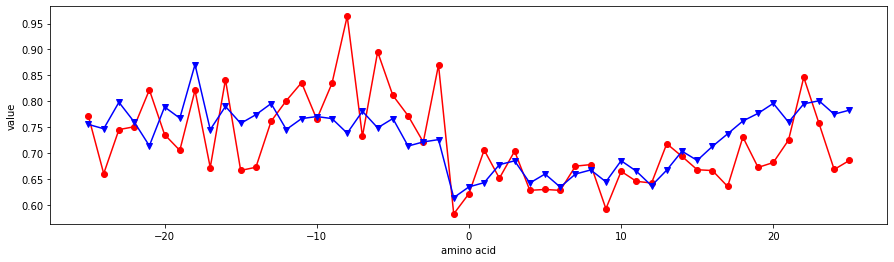

MUNV940102


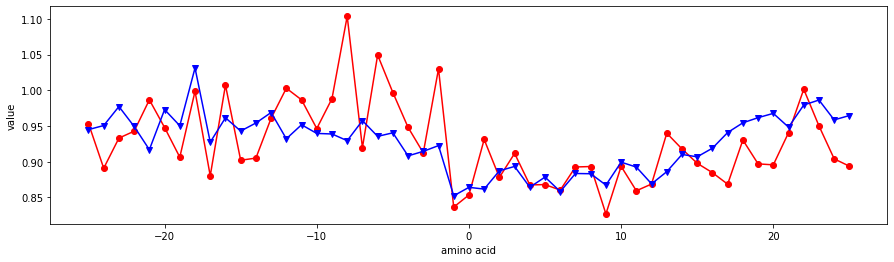

MUNV940103


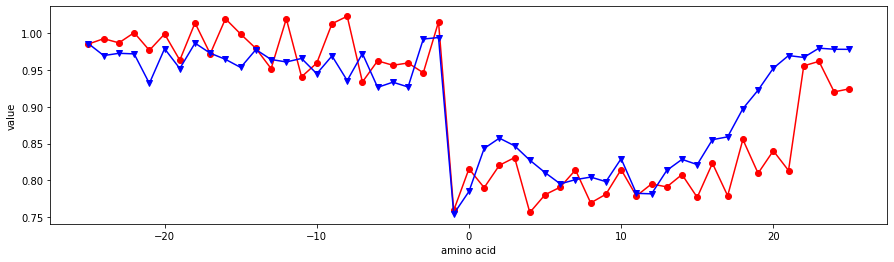

MUNV940104


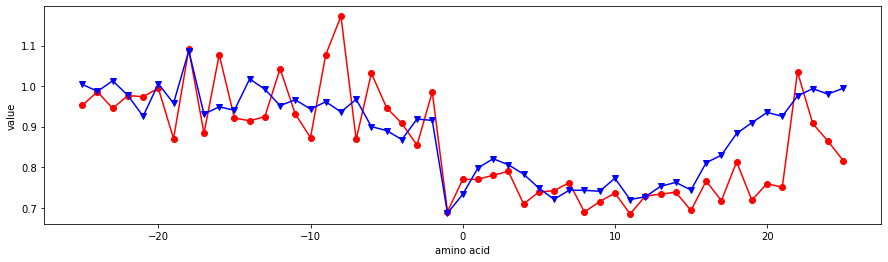

MUNV940105


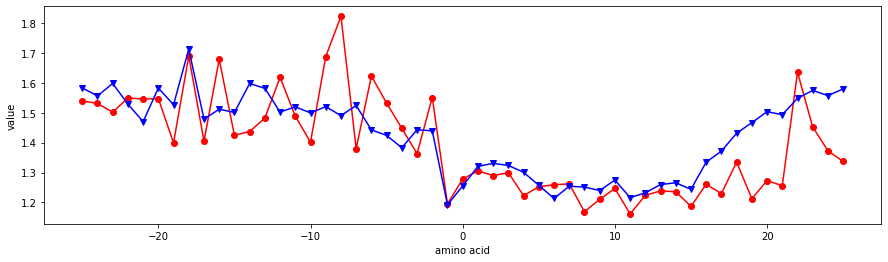

WIMW960101


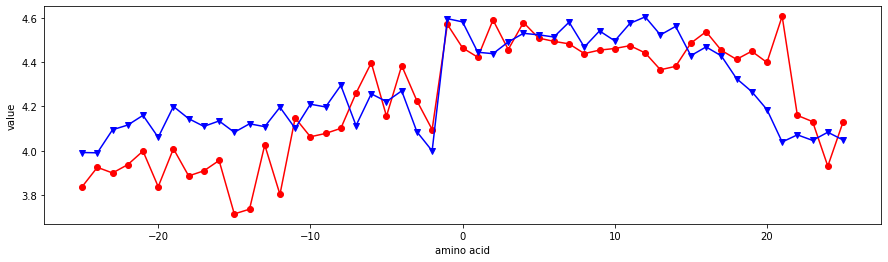

KIMC930101


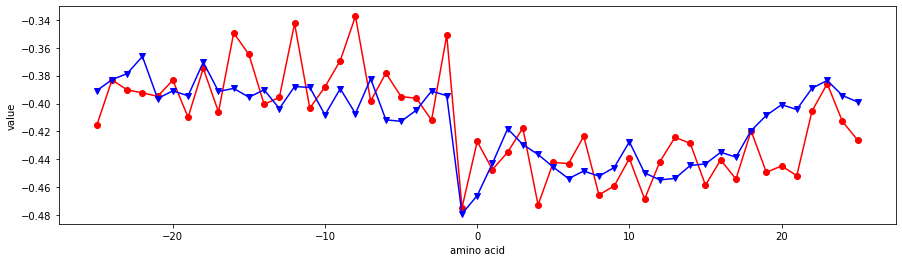

MONM990101


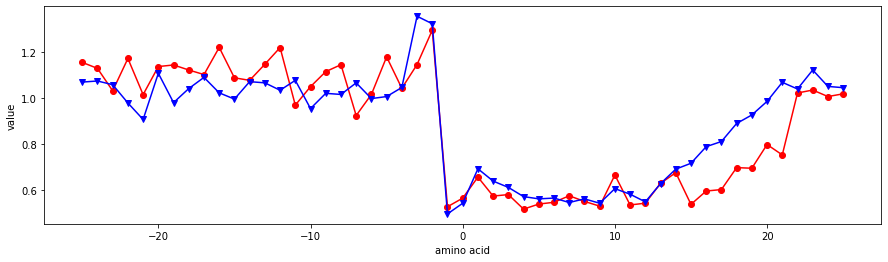

BLAM930101


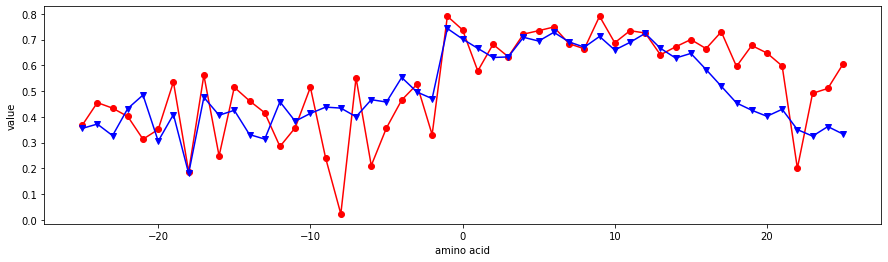

PARS000101


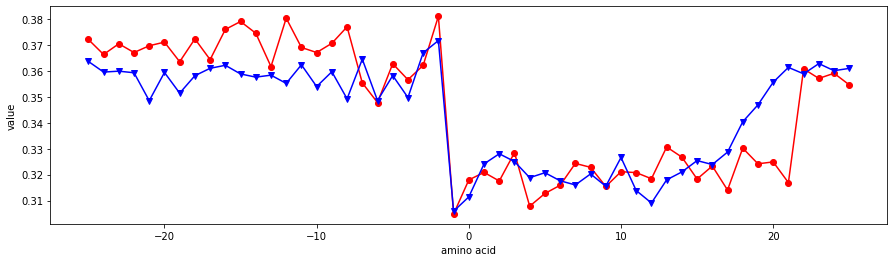

PARS000102


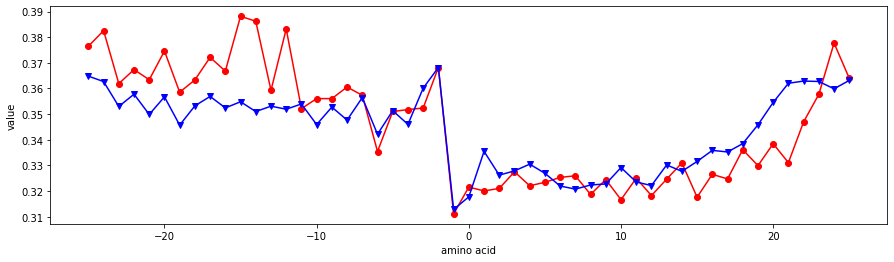

KUMS000101


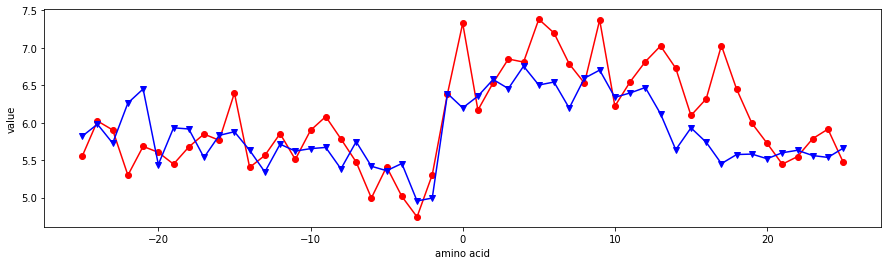

KUMS000102


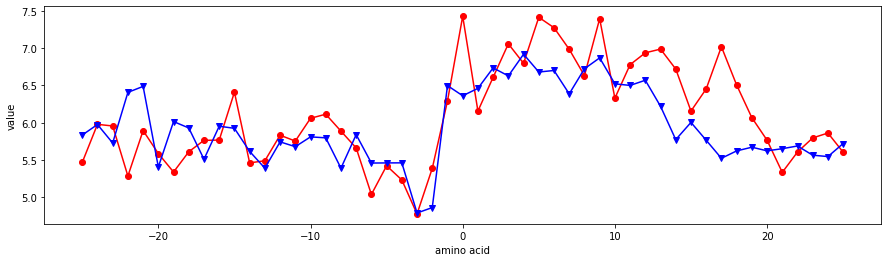

KUMS000103


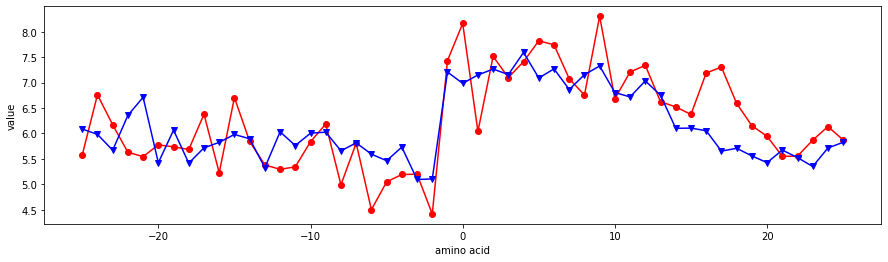

KUMS000104


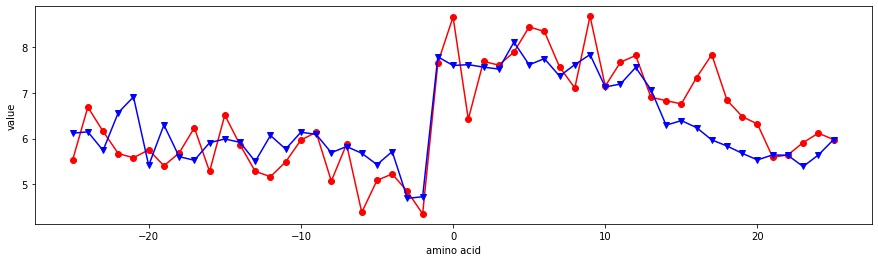

TAKK010101


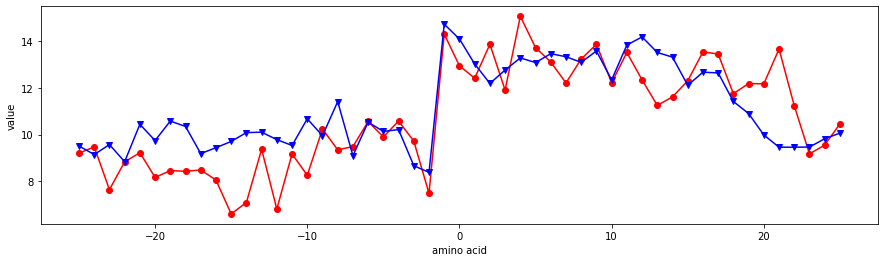

FODM020101


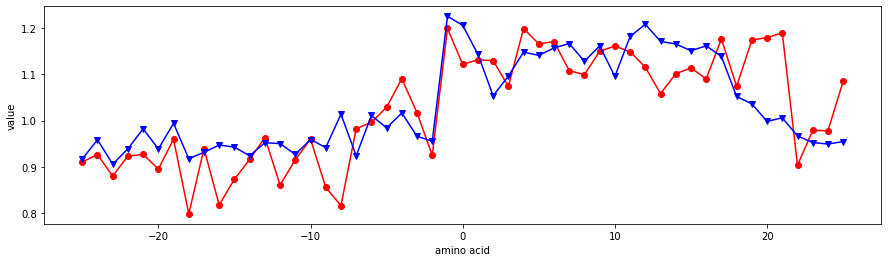

NADH010101


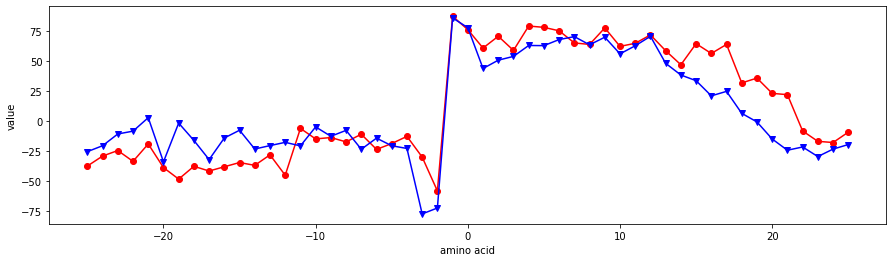

NADH010102


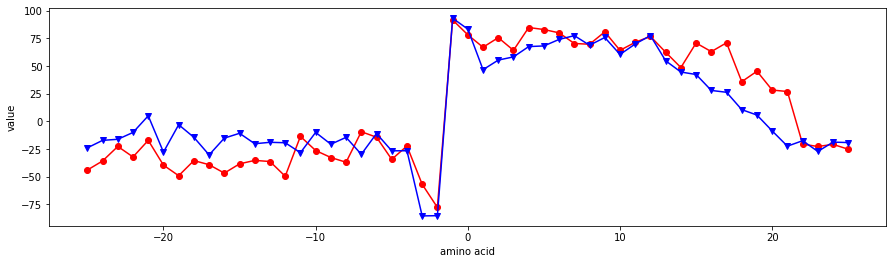

NADH010103


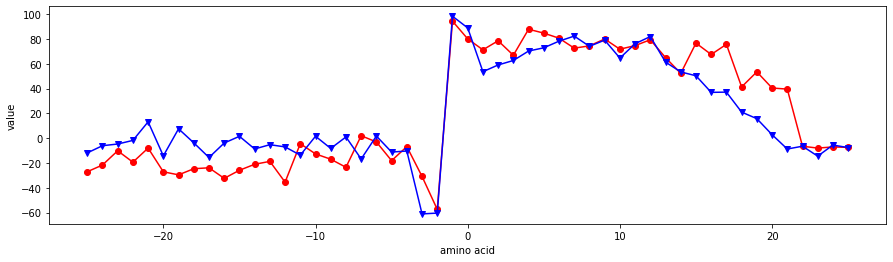

NADH010104


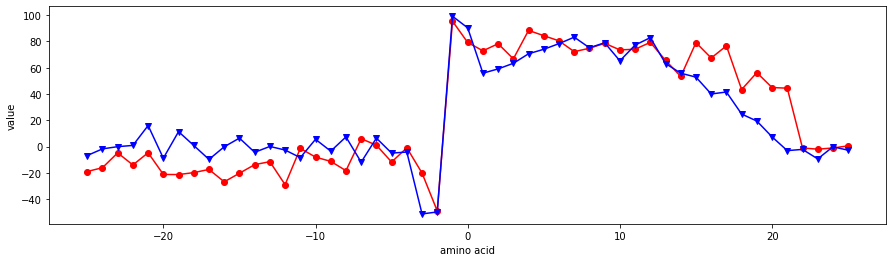

NADH010105


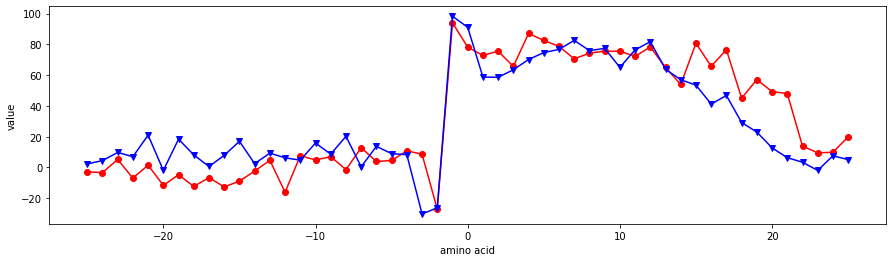

NADH010106


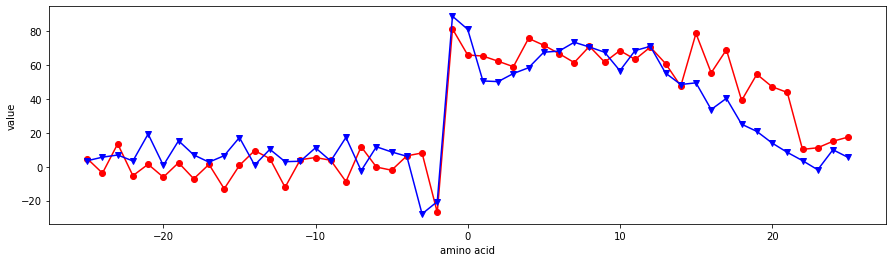

NADH010107


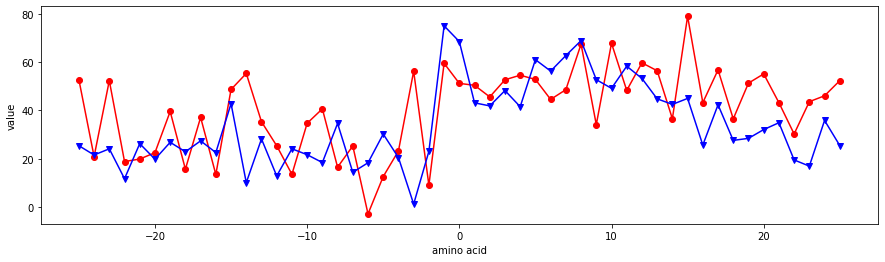

MONM990201


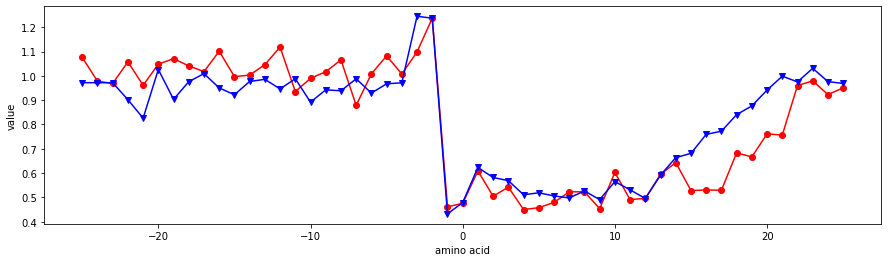

KOEP990101


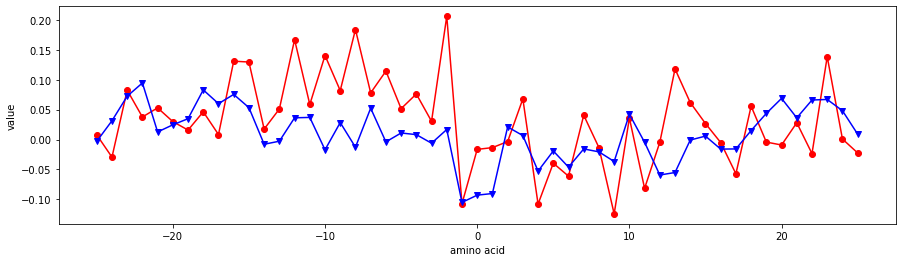

KOEP990102


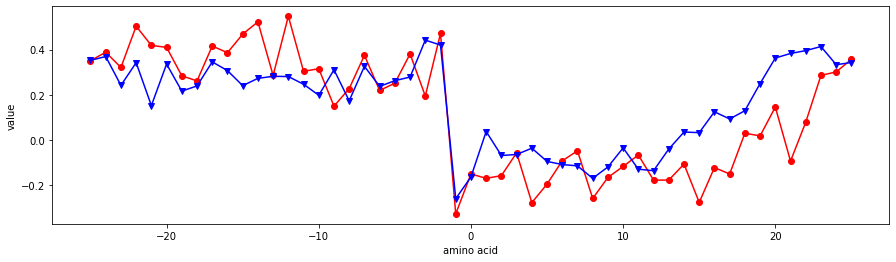

CEDJ970101


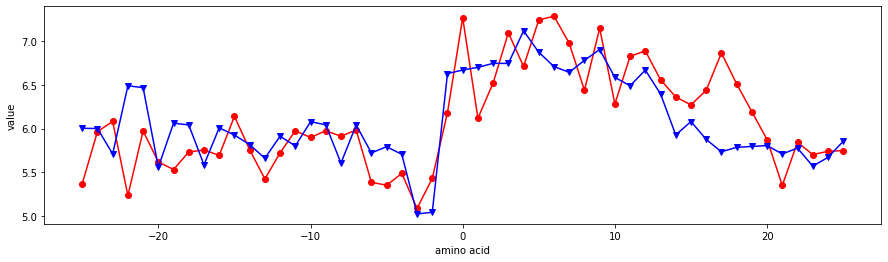

CEDJ970102


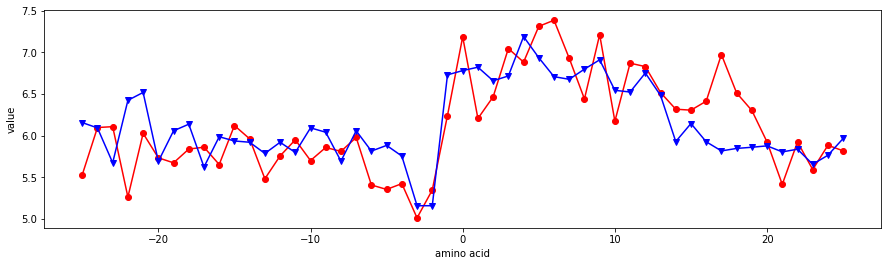

CEDJ970103


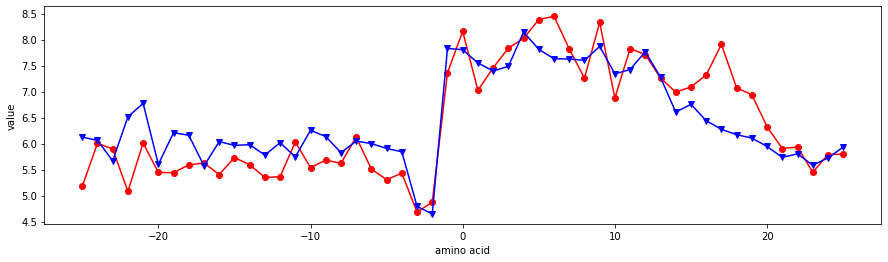

CEDJ970104


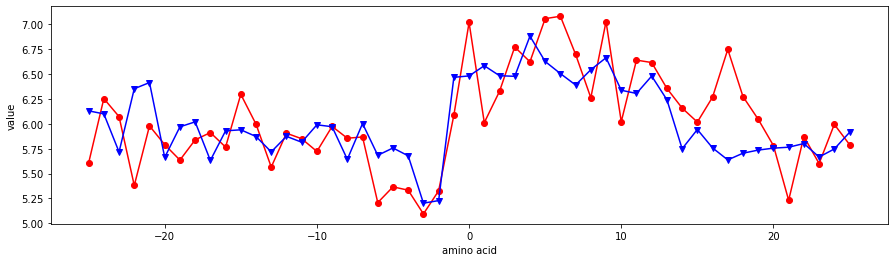

CEDJ970105


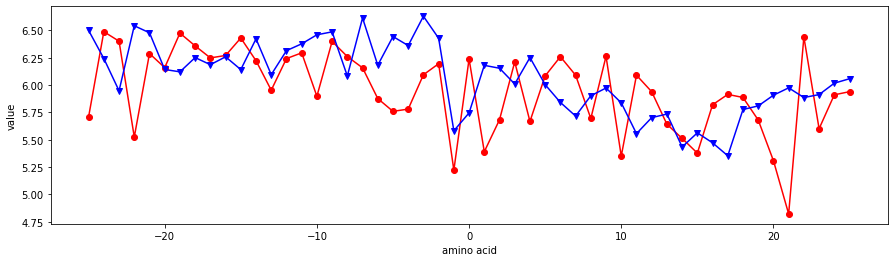

FUKS010101


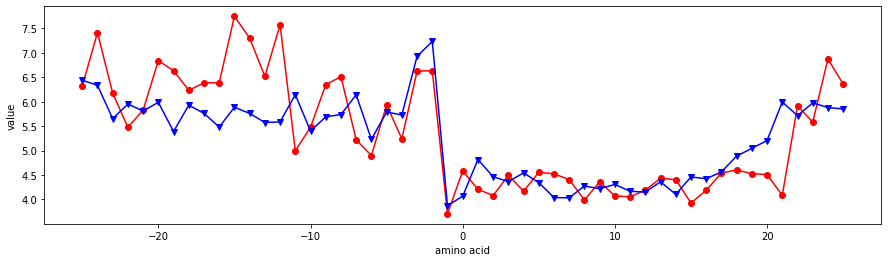

FUKS010102


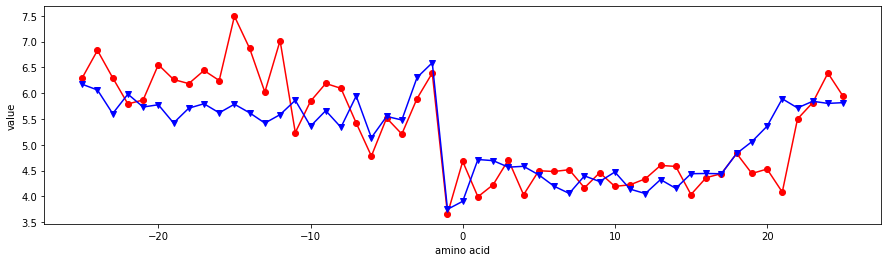

FUKS010103


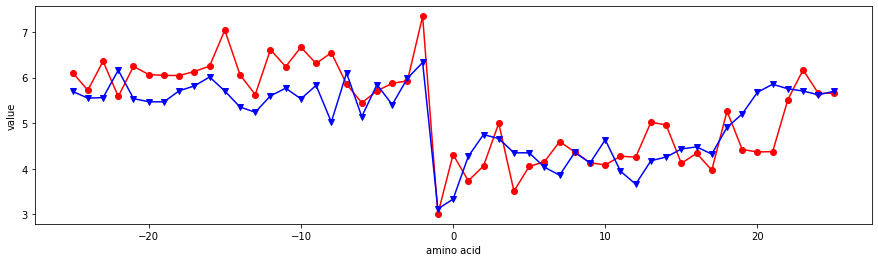

FUKS010104


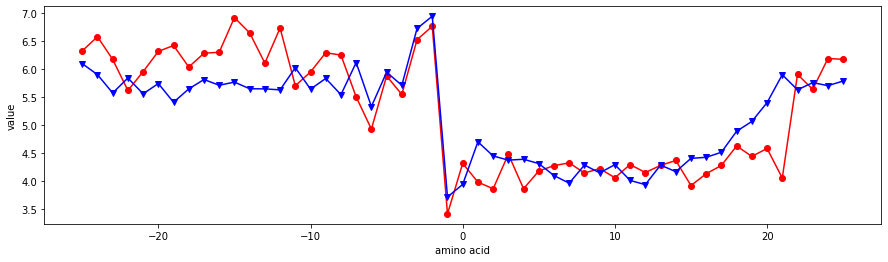

FUKS010105


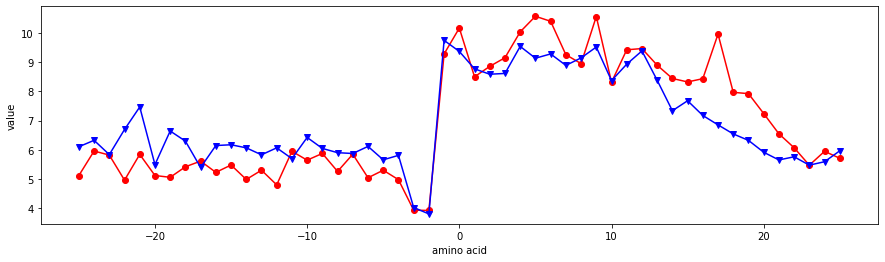

FUKS010106


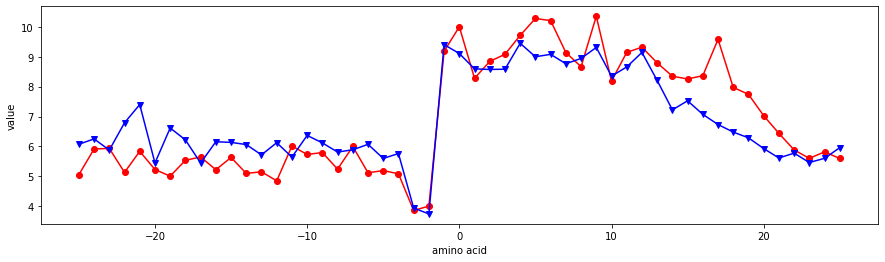

FUKS010107


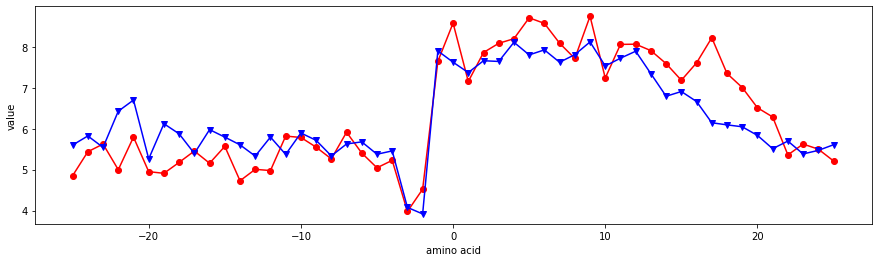

FUKS010108


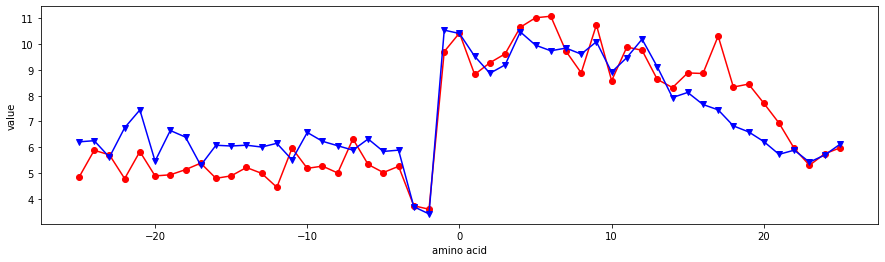

FUKS010109


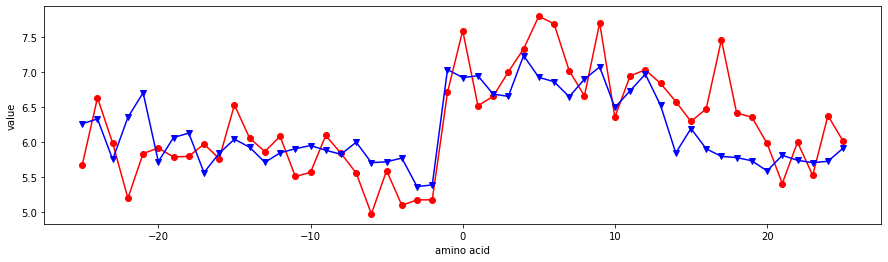

FUKS010110


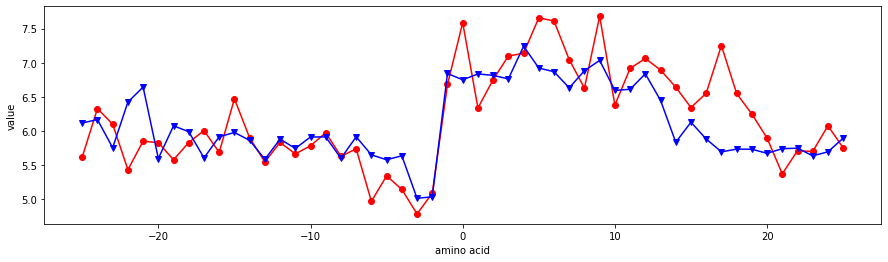

FUKS010111


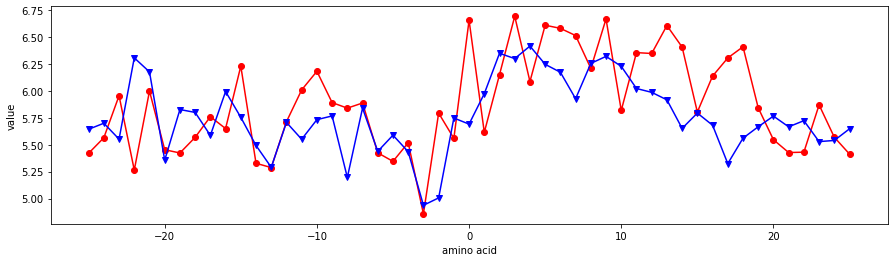

FUKS010112


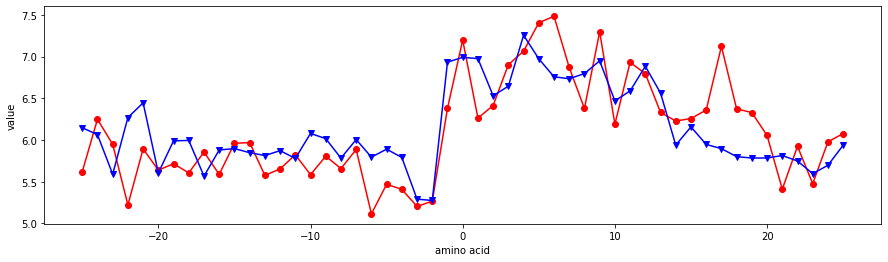

MITS020101


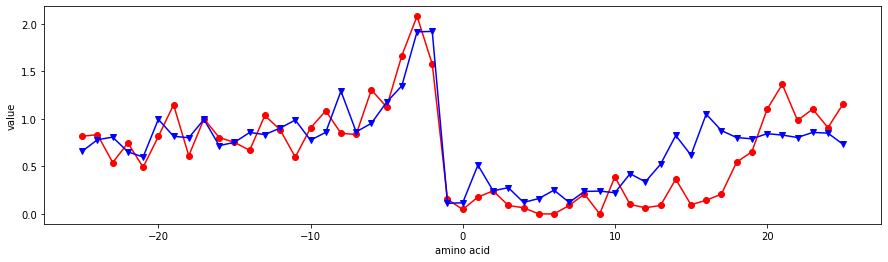

TSAJ990101


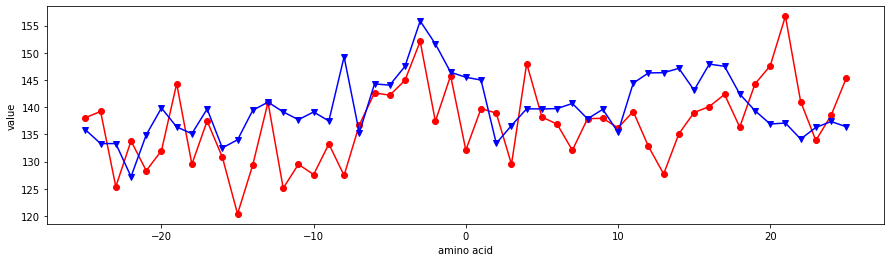

TSAJ990102


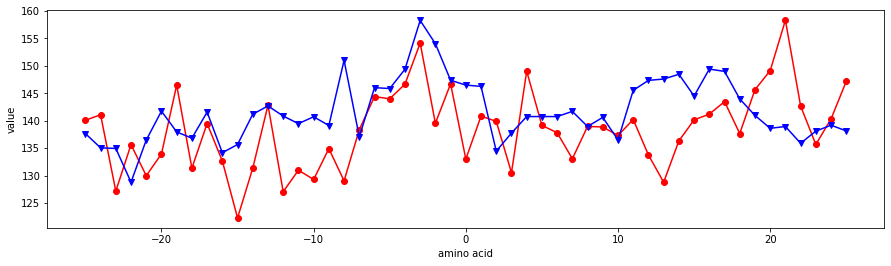

COSI940101


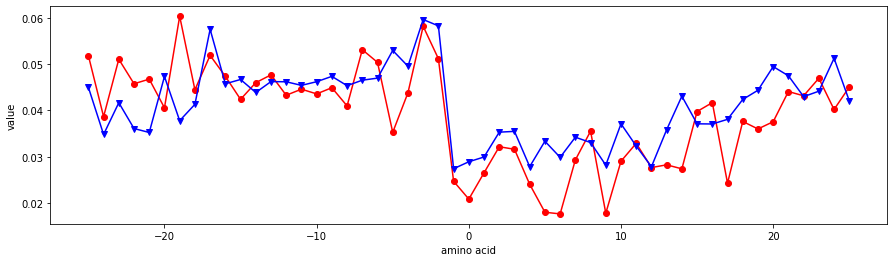

PONP930101


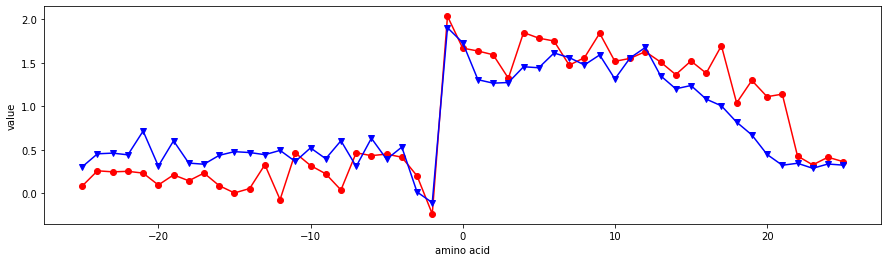

WILM950101


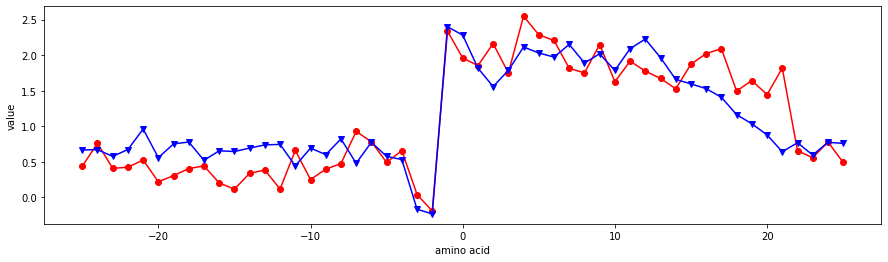

WILM950102


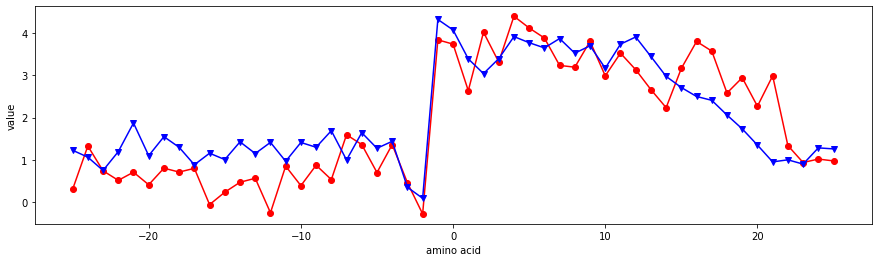

WILM950103


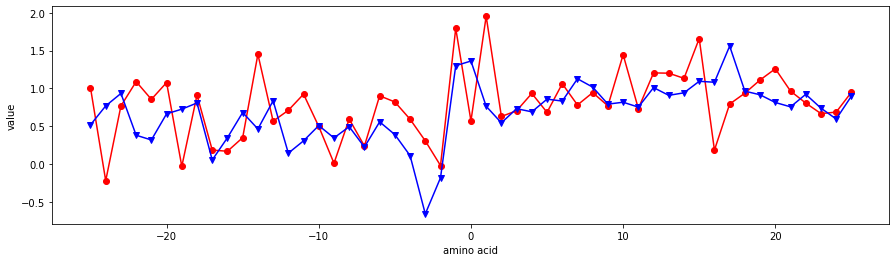

WILM950104


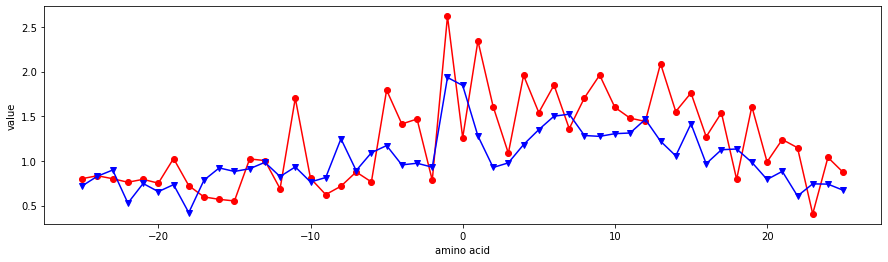

KUHL950101


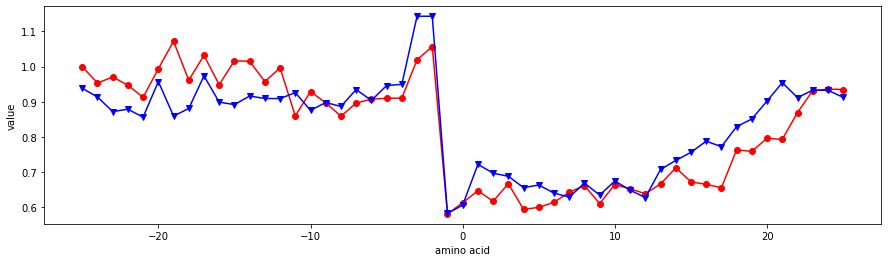

GUOD860101


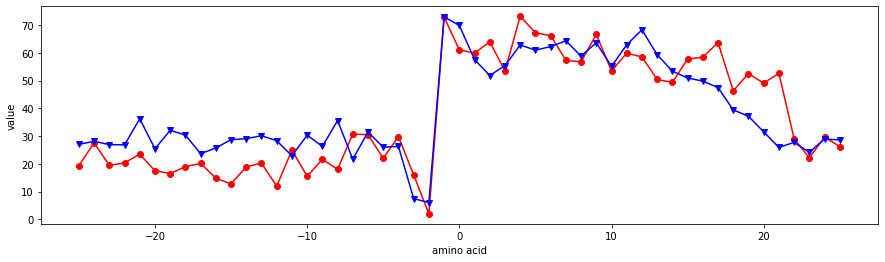

JURD980101


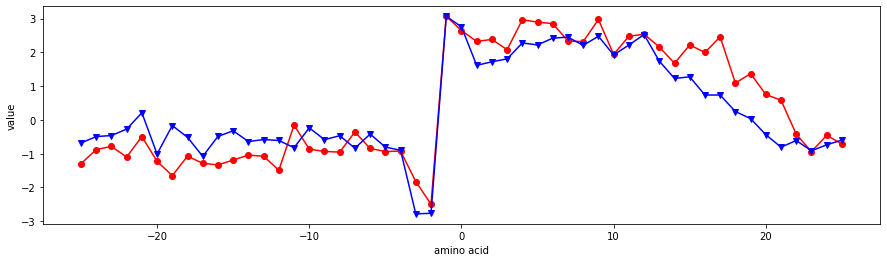

BASU050101


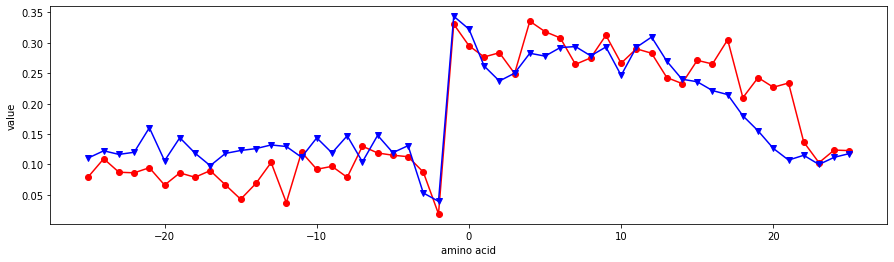

BASU050102


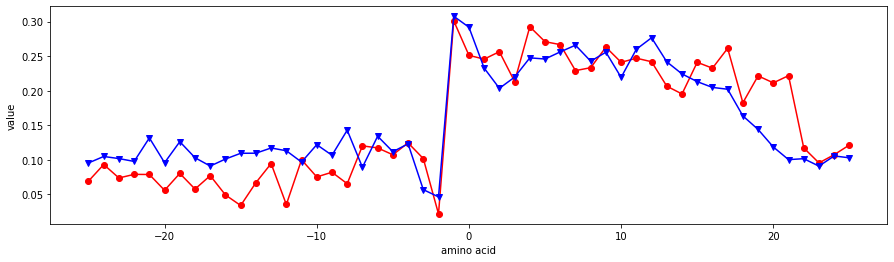

BASU050103


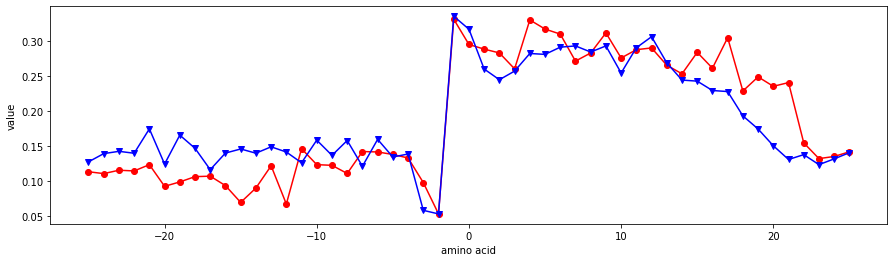

SUYM030101


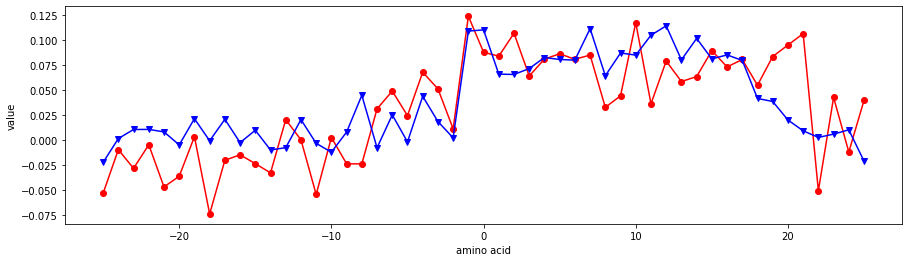

PUNT030101


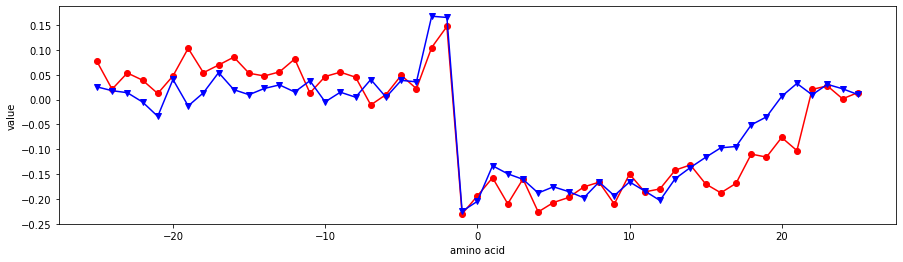

PUNT030102


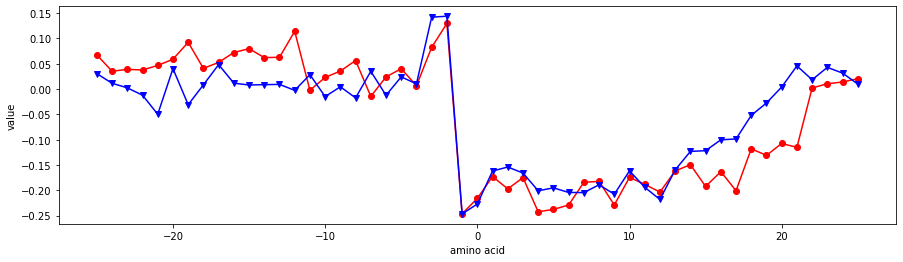

GEOR030101


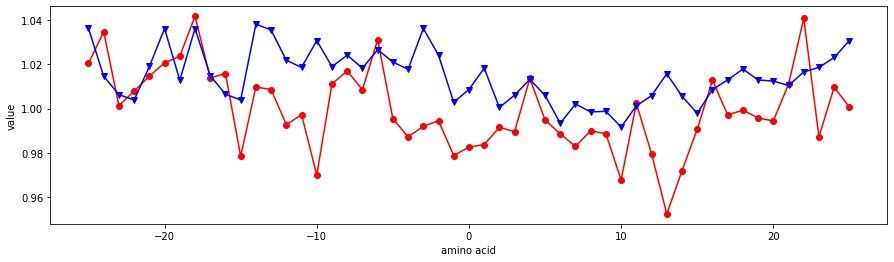

GEOR030102


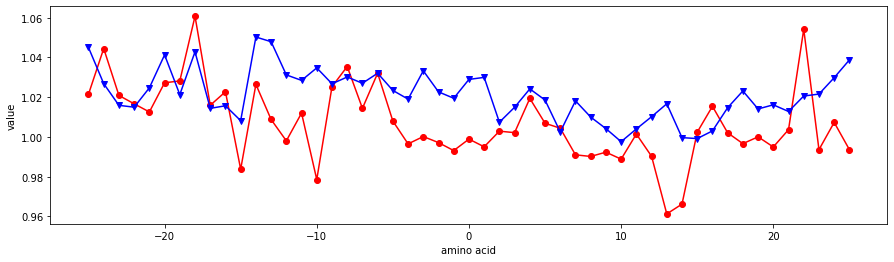

GEOR030103


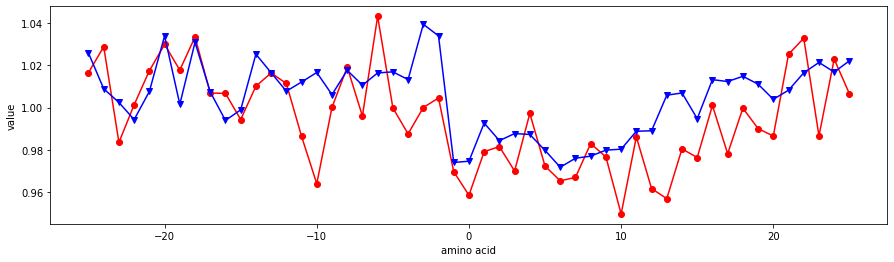

GEOR030104


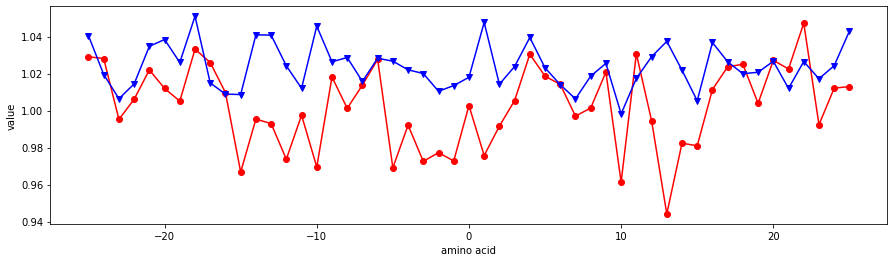

GEOR030105


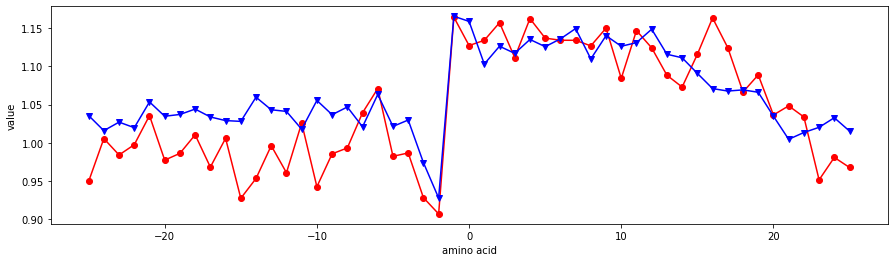

GEOR030106


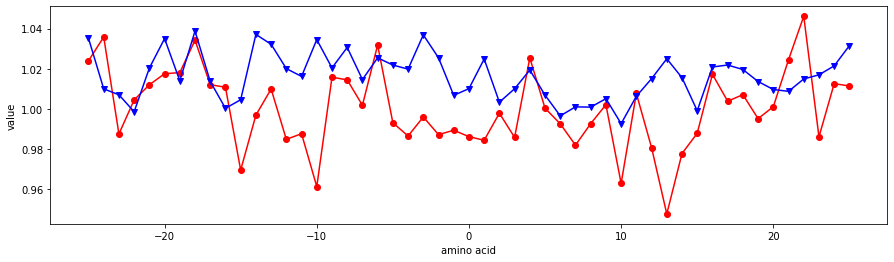

GEOR030107


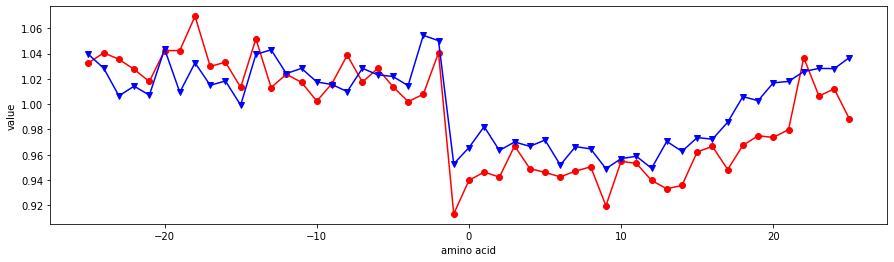

GEOR030108


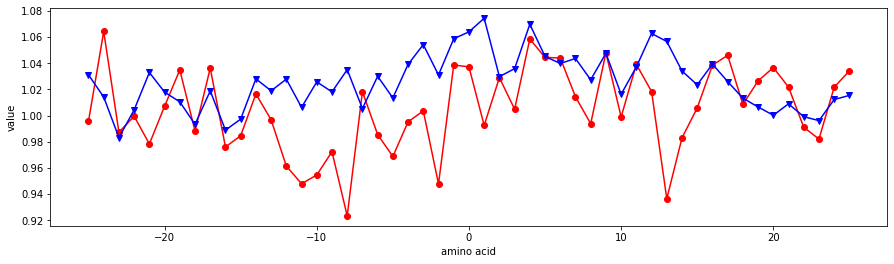

GEOR030109


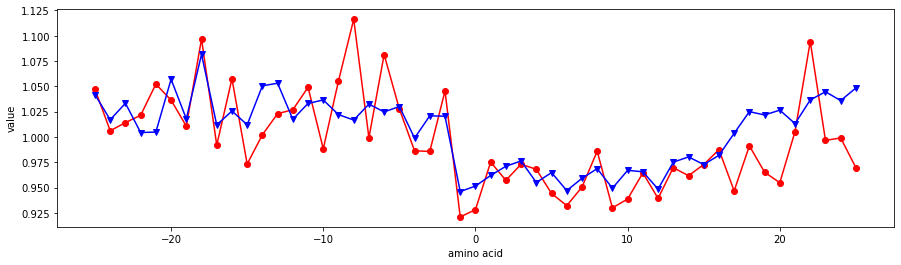

ZHOH040101


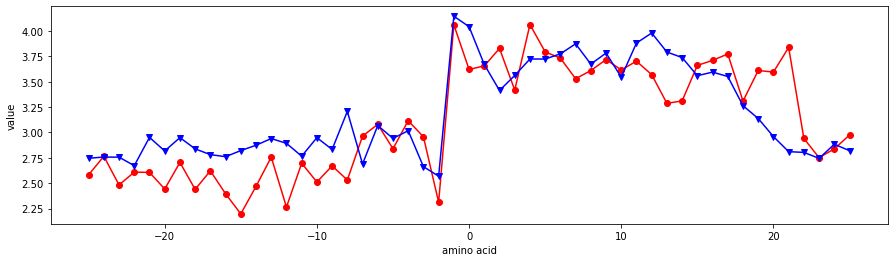

ZHOH040102


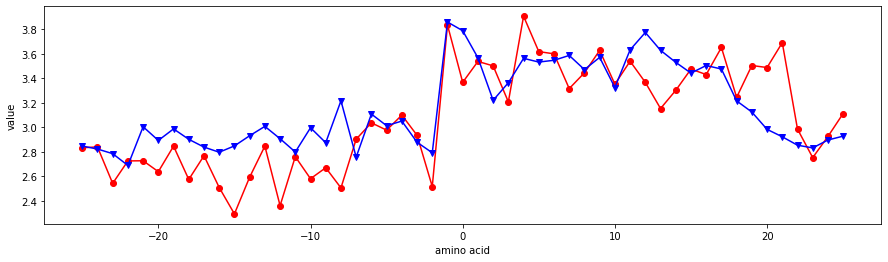

ZHOH040103


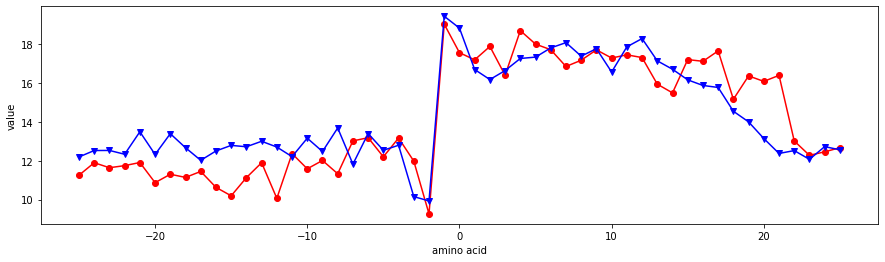

BAEK050101


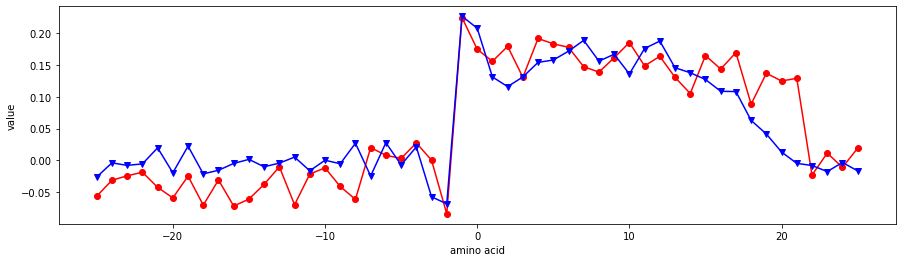

HARY940101


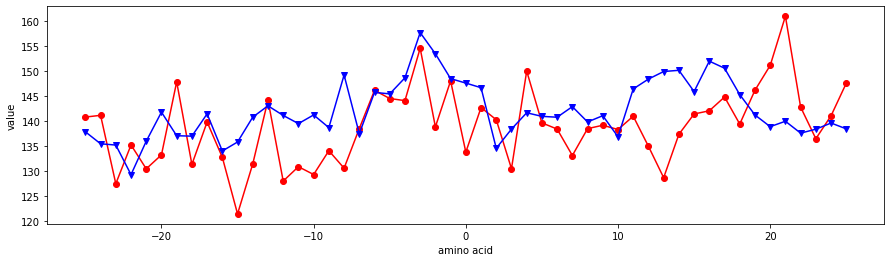

PONJ960101


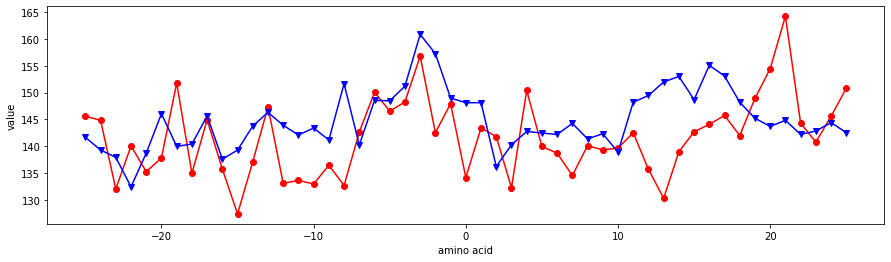

DIGM050101


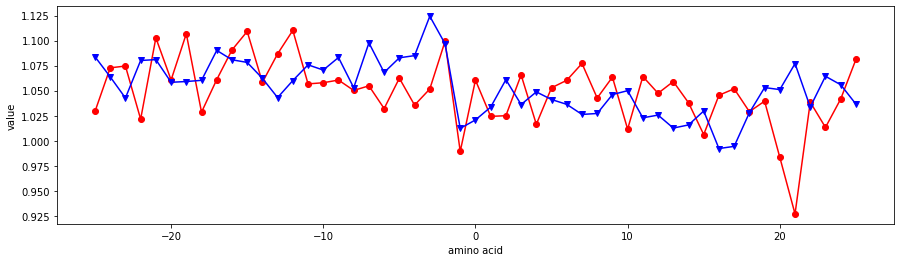

WOLR790101


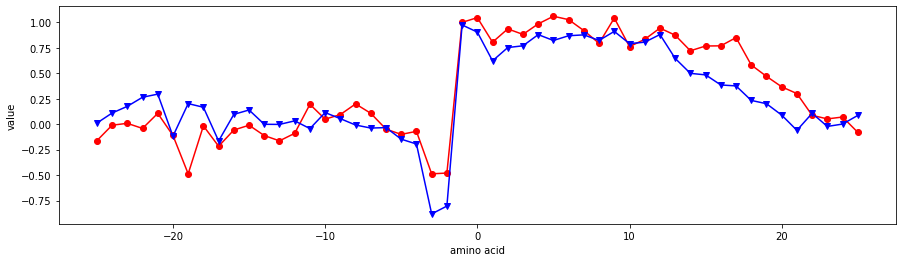

OLSK800101


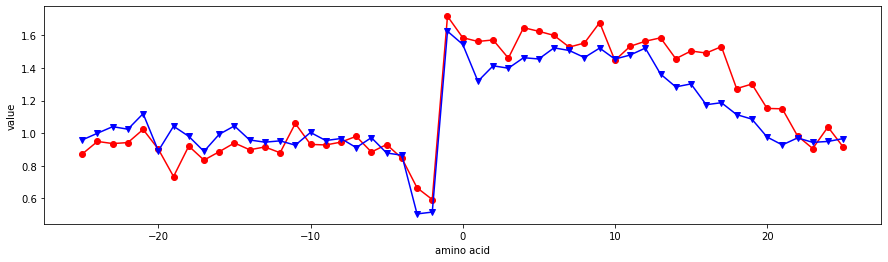

KIDA850101


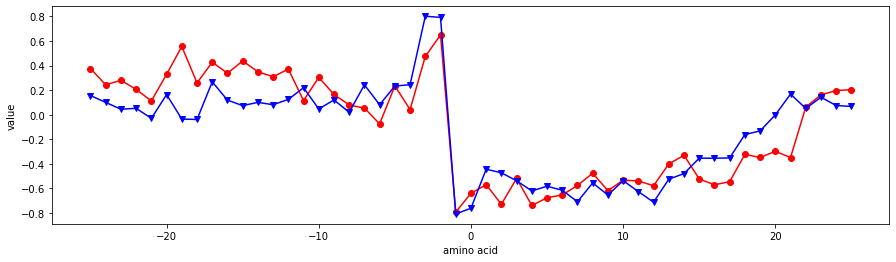

GUYH850102


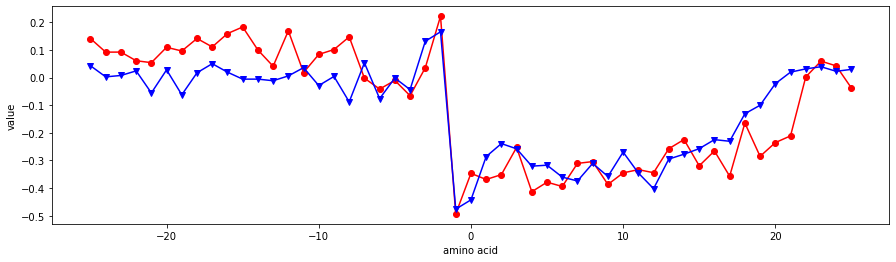

GUYH850104


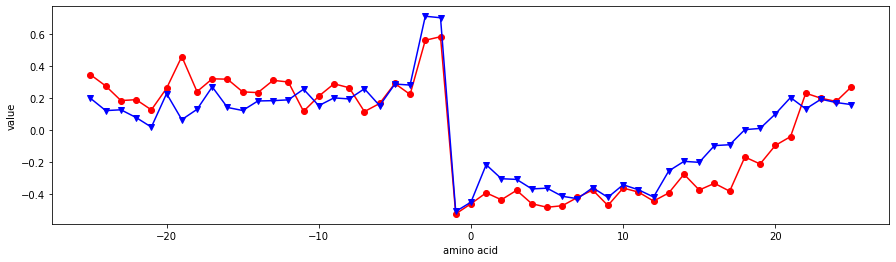

GUYH850105


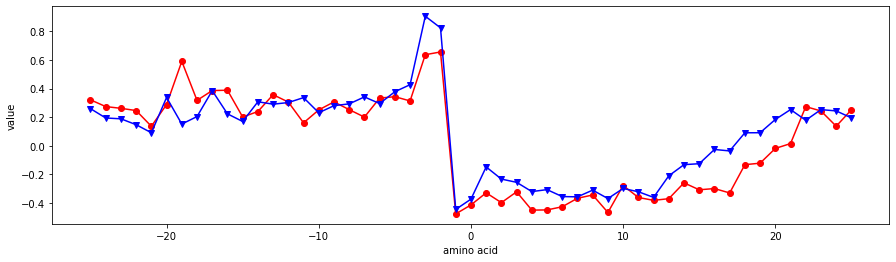

JACR890101


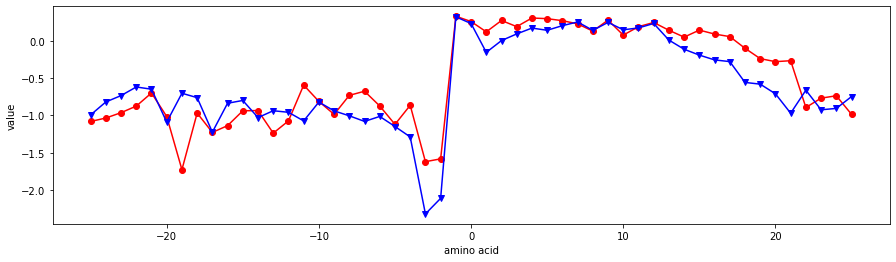

COWR900101


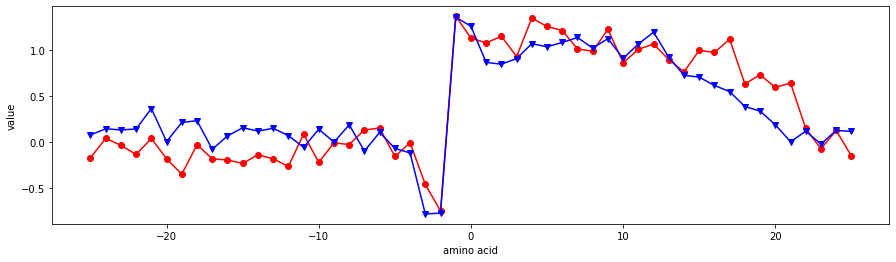

BLAS910101


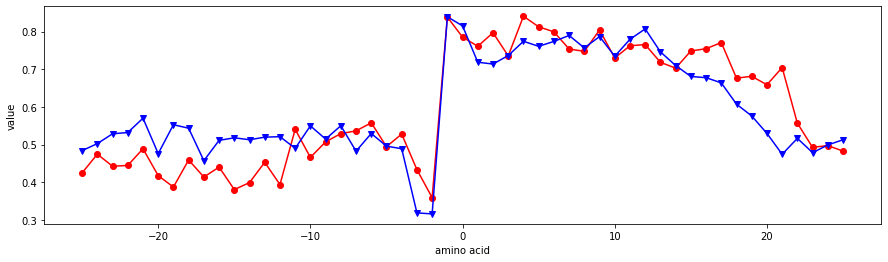

CASG920101


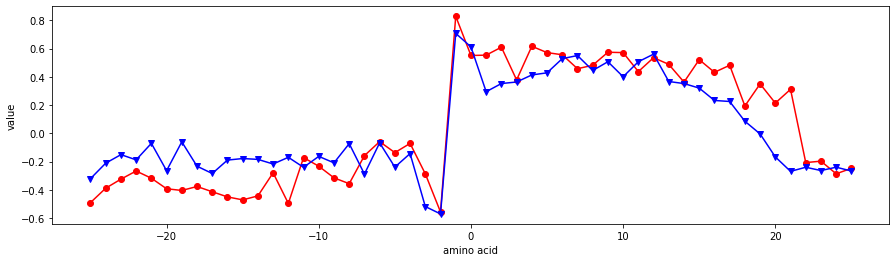

CORJ870101


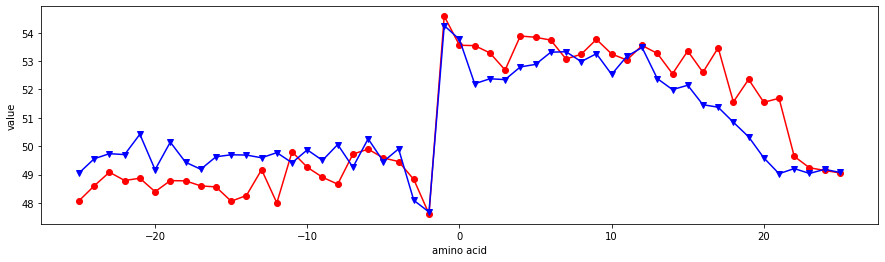

CORJ870102


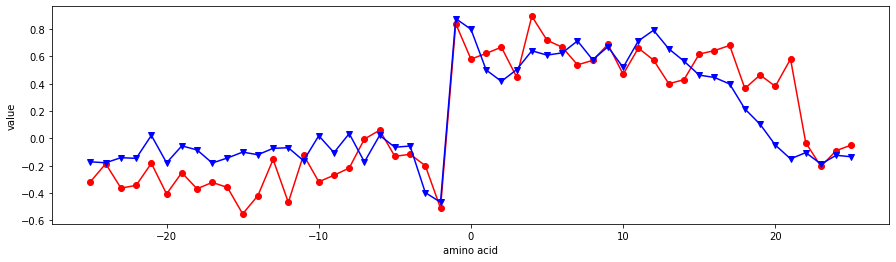

CORJ870103


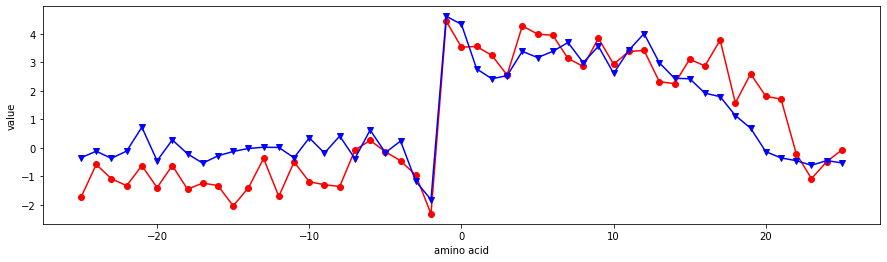

CORJ870104


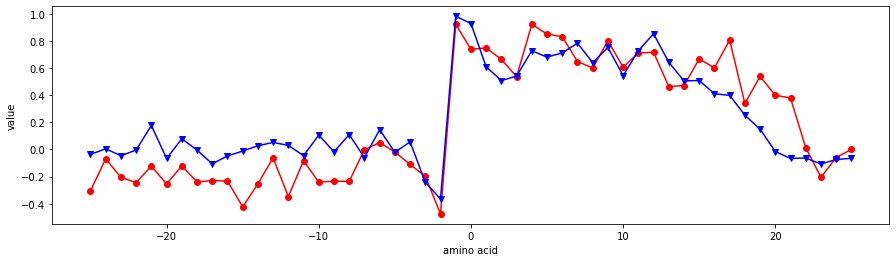

CORJ870105


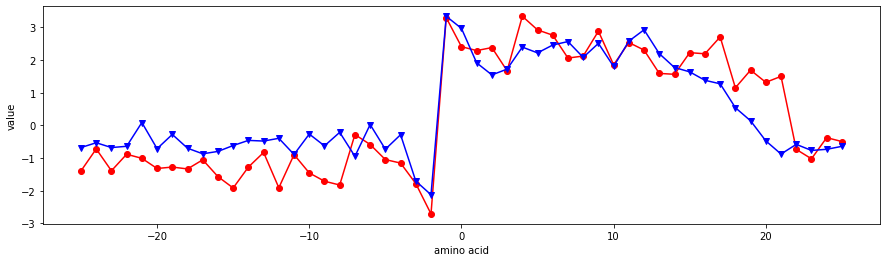

CORJ870106


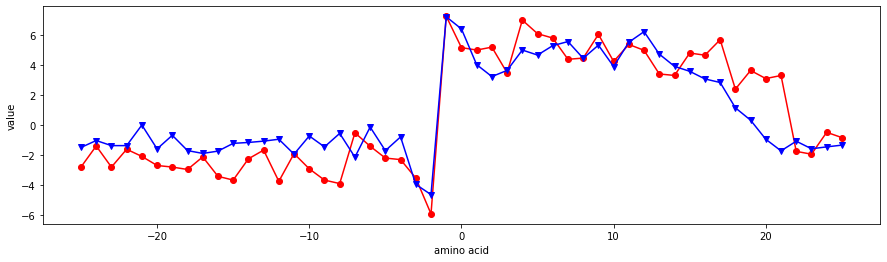

CORJ870107


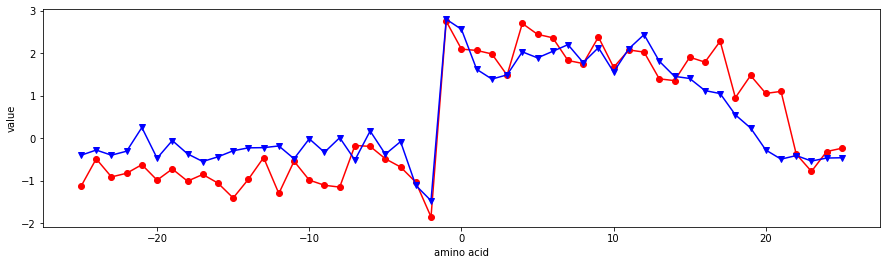

CORJ870108


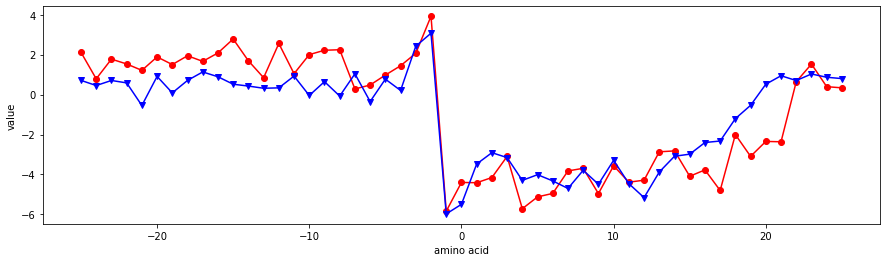

MIYS990101


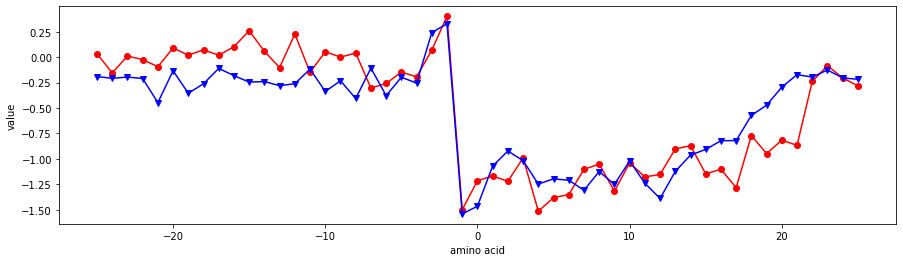

MIYS990102


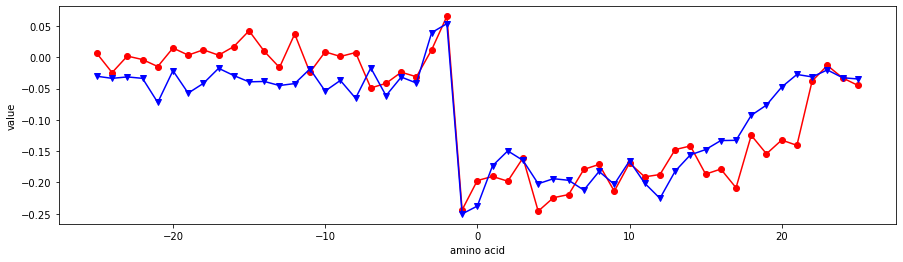

MIYS990103


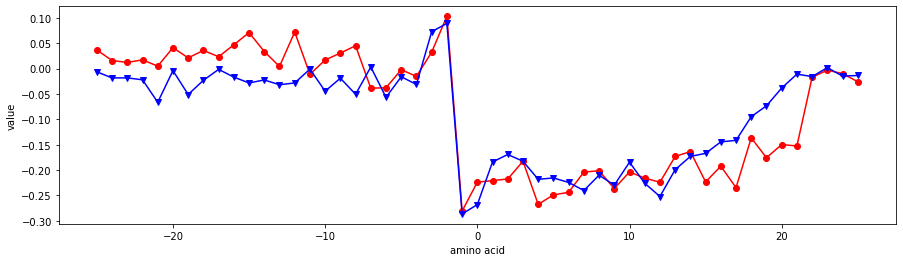

MIYS990104


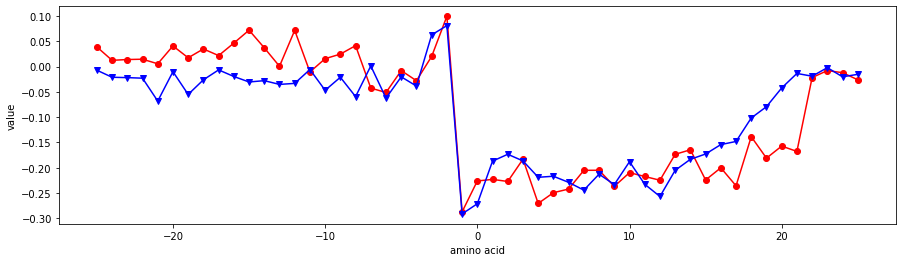

MIYS990105


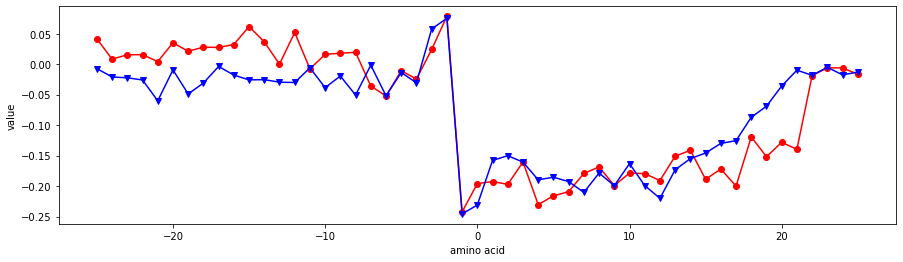

ENGD860101


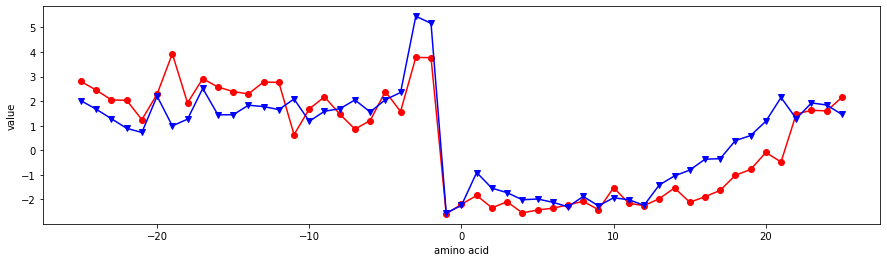

FASG890101


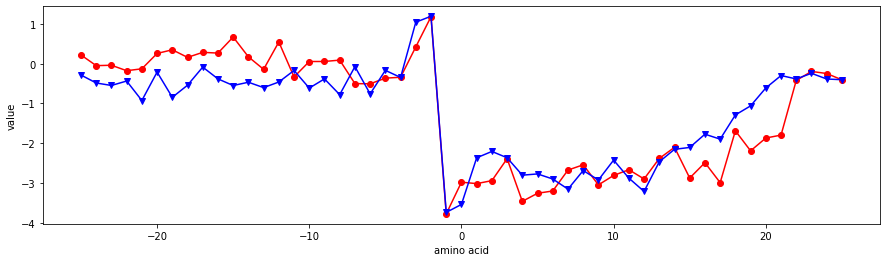

KARS160101


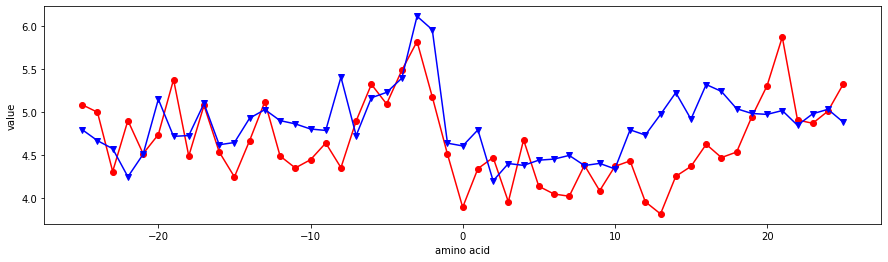

KARS160102


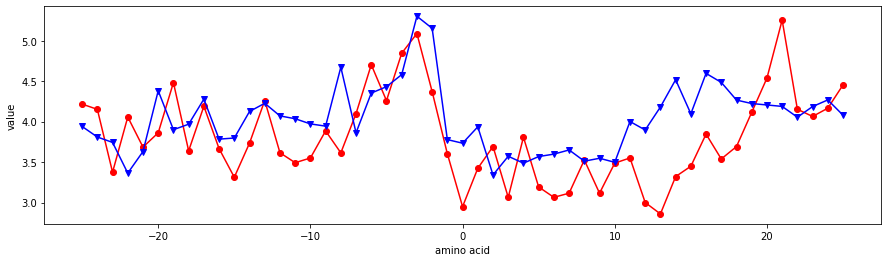

KARS160103


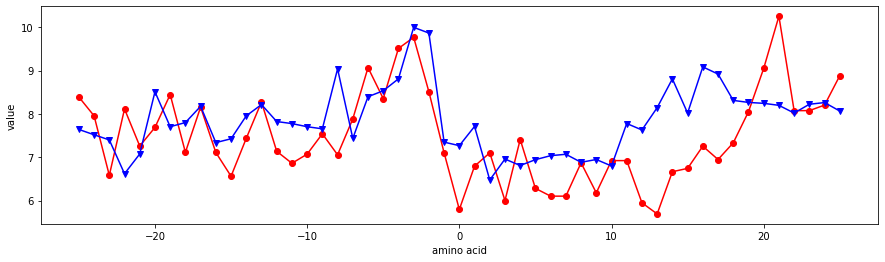

KARS160104


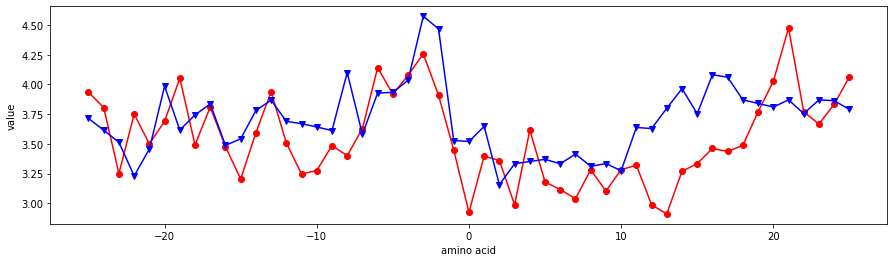

KARS160105


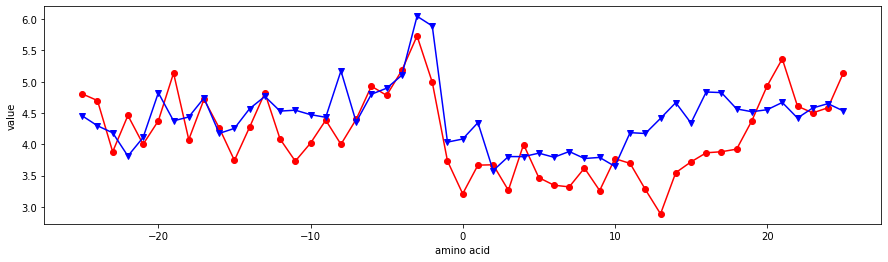

KARS160106


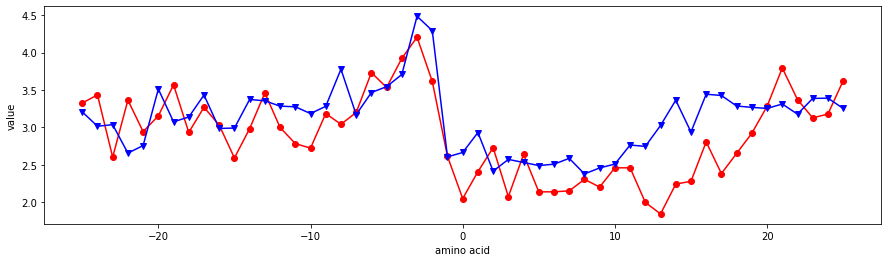

KARS160107


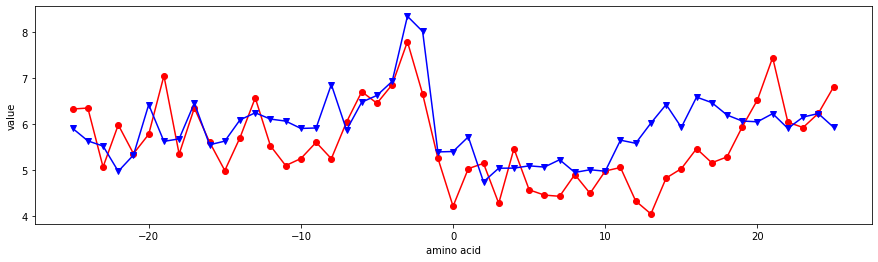

KARS160108


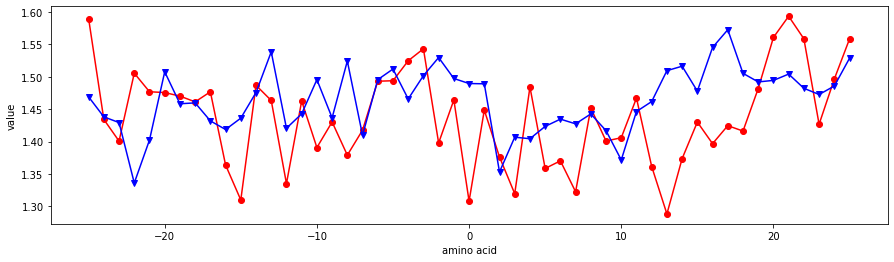

KARS160109


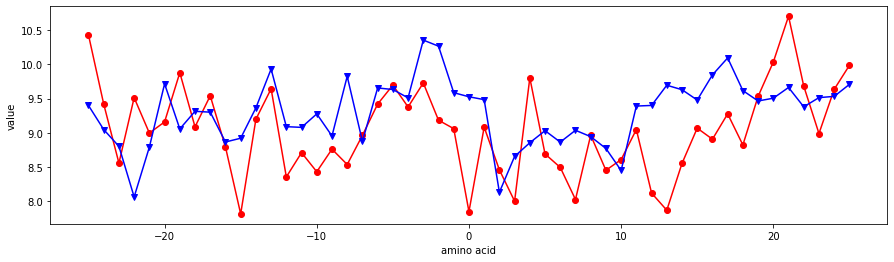

KARS160110


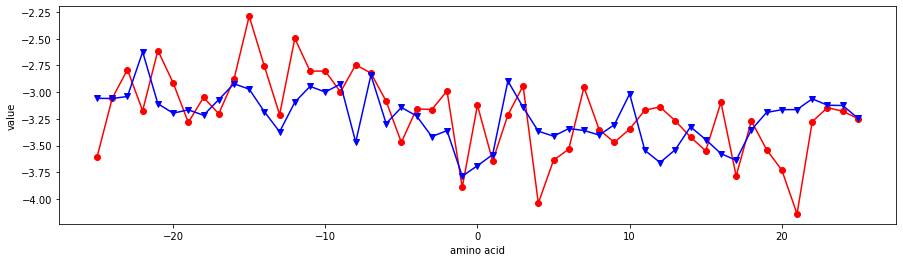

KARS160111


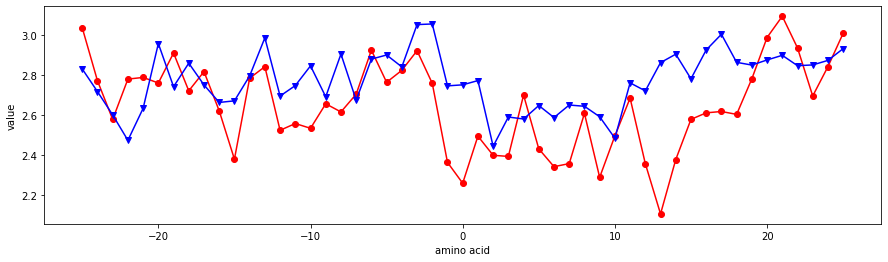

KARS160112


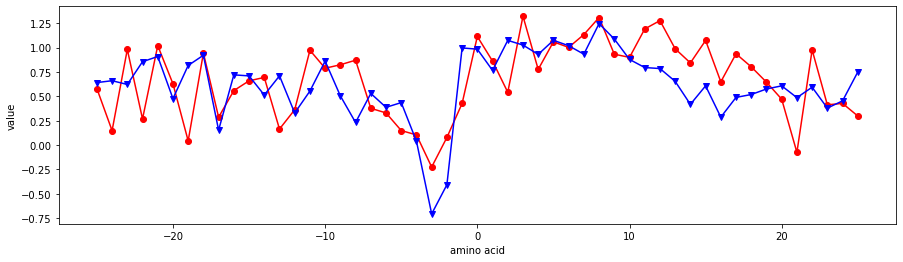

KARS160113


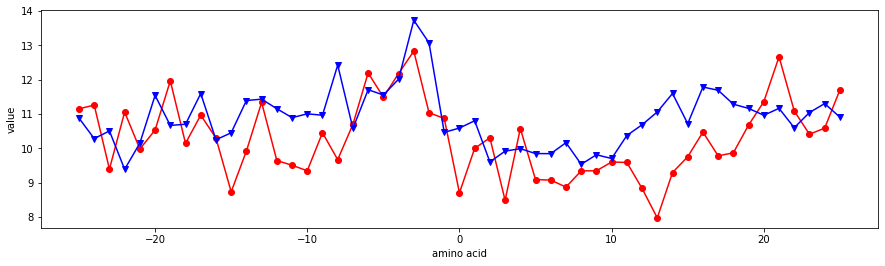

KARS160114


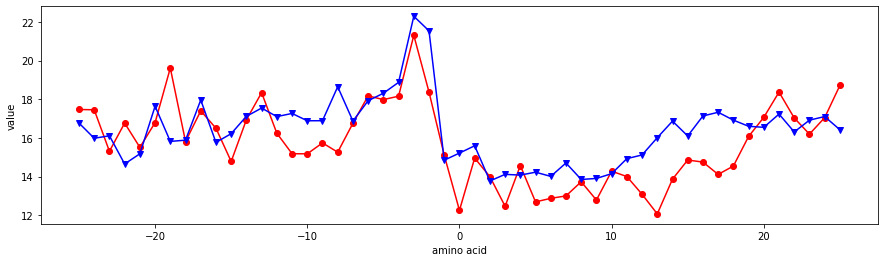

KARS160115


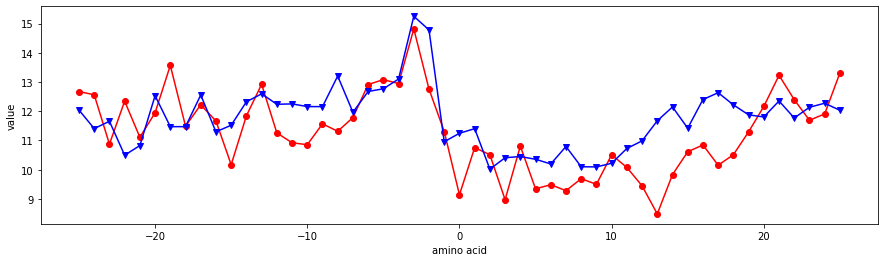

KARS160116


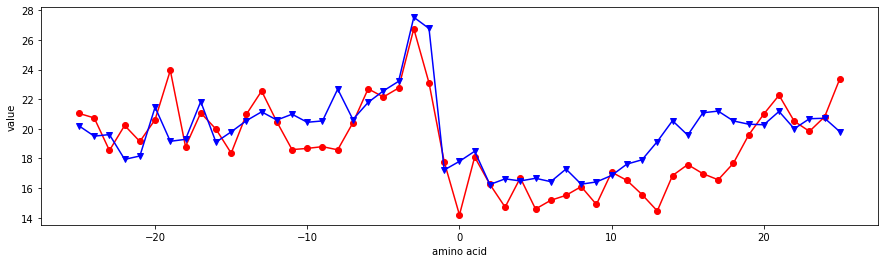

KARS160117


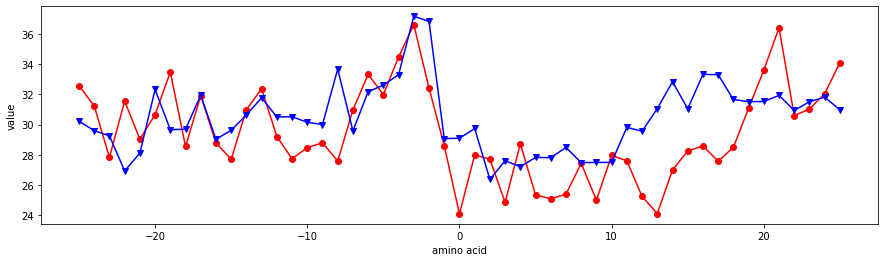

KARS160118


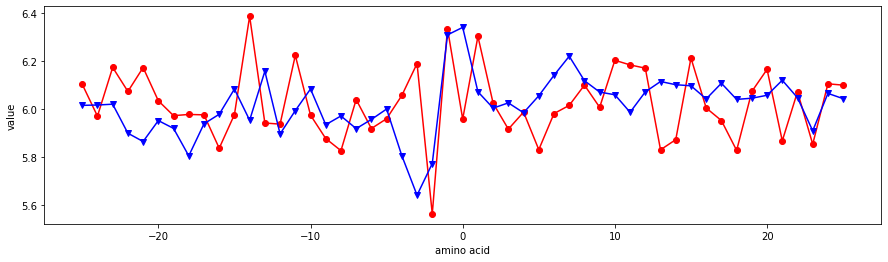

KARS160119


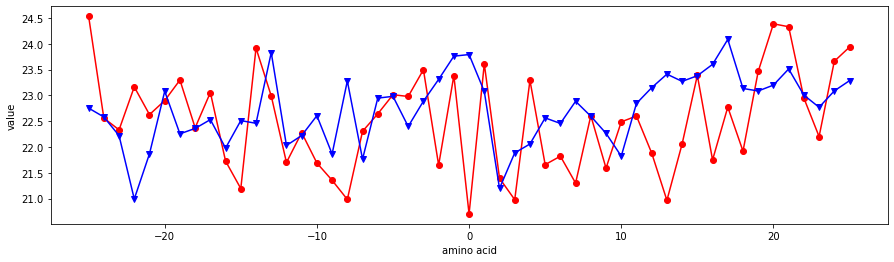

KARS160120


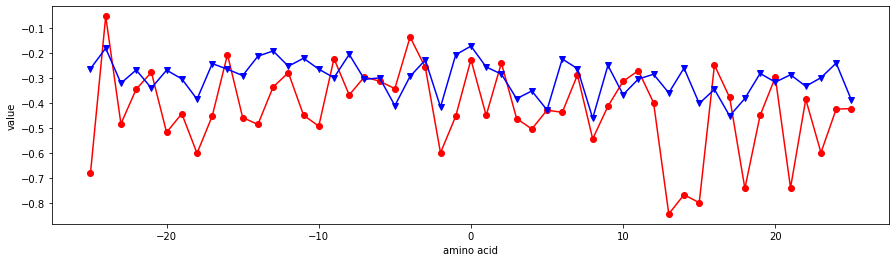

KARS160121


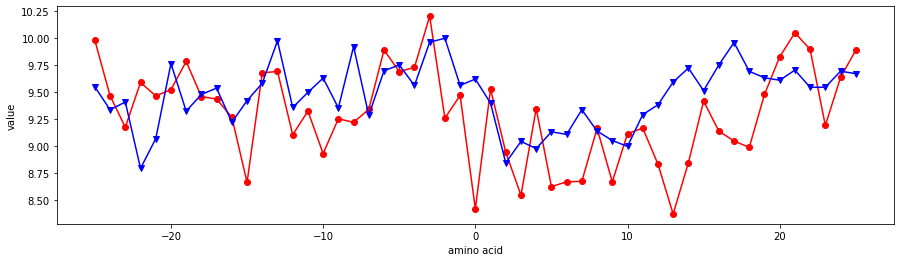

KARS160122


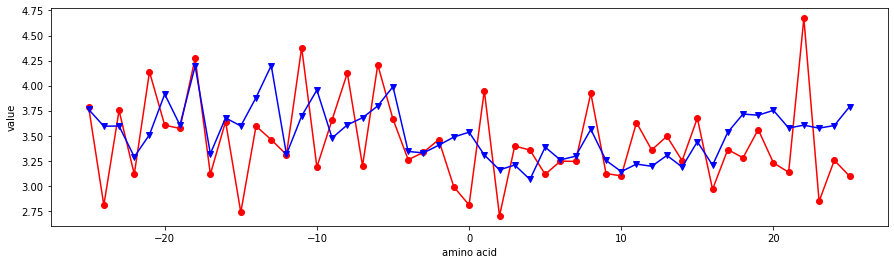

In [8]:
import matplotlib.pyplot as plt


for index_pm, row_pm in pmave.iterrows():
    for index_npm, row_npm in npmave.iterrows():
        if index_pm==index_npm:
            print (index_pm)
            plt.figure(figsize=(15,4))
            plt.plot(columns , row_pm  , color = 'red'  , marker = 'o' )
            plt.plot(columns , row_npm , color = 'blue' , marker = 'v' )
            plt.xlabel('amino acid')                    
            plt.ylabel('value')
            plt.show()
             